In [1]:
import os
import numpy as np
import requests
import math
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline
import sys
import timeit

import pyQEDA as pq
import load_Intensity_function as lif
import sys
sys.path.append("/Users/chenjie/pyQEDA/pyscripts")
import pyQEDA_function_cj as pf
import pyQEDA_potential as pqp
import normalization_function as nf
import makeUniqueUgVector_cj as mu
import makeUniqueUgVector_3D_cj as mu_3D

import tensorflow as tf
from tensorflow.keras import layers, Model, backend
#from tensorflow.keras import applications
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense, Input, Activation, Dropout

-------------------------------------------------------------------------------------------------------------------

# I. Data

1. Structure factor:

(0.1443143799603049-3.469446951953614e-17j)  real: 0.1443143799603049  imag: -3.469446951953614e-17
5


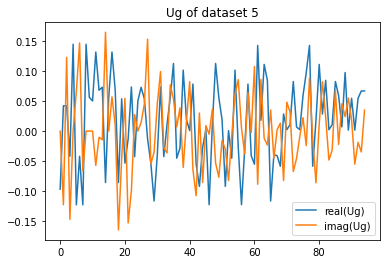

In [2]:
# load the structure vector Ug:
name = "normalized_ZnO_r8_test_makeunique_200"
File = "r8_test_makeunique"
Nx = 70

Ug = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_labels_" + name + ".csv", dtype=complex) 

dataset = 5
print(Ug[dataset,4],' real:',np.real(Ug[dataset,4]),' imag:',np.imag(Ug[dataset,4]))
re = np.real(Ug[dataset,:])
im = np.imag(Ug[dataset,:])

plt.plot(re,label='real(Ug)')
plt.plot(im,label='imag(Ug)')
plt.legend()
plt.title('Ug of dataset '+str(dataset))
np.imag(Ug[dataset,:])-np.imag(Ug[dataset+1,:])
print(dataset)

shape of Ug_2real: (200, 95, 2)


Text(0.5, 1.0, 'first 2 sets of imag.parts of the Ug')

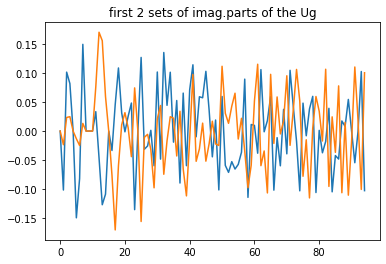

In [3]:
# Ug processing: convert complex to real
Ug_2real =[]
for i in range(0,len(Ug)):
    Ug_2real.append(np.concatenate((np.array(Ug[i].real,ndmin=2).T, np.array(Ug[i].imag,ndmin=2).T),axis=1))    
Ug_2real = np.asarray(Ug_2real)

numUg = Ug_2real.shape[1]
print('shape of Ug_2real:', Ug_2real.shape)

# Plot the first 2 sets of imaginary parts of the structure factors:
plt.plot(Ug_2real[0,:,1])
plt.plot(Ug_2real[1,:,1])
plt.title('first 2 sets of imag.parts of the Ug')

shape of Ug_2real: (200, 190)


Text(0.5, 1.0, 'Ug of dataset 5')

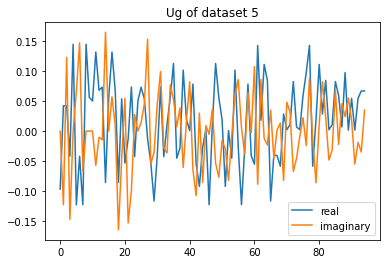

In [4]:
# combine real and imaginary numbers into one row:
# This interlaces real and imaginary numbers. 
Ug_2real = Ug_2real.reshape(-1,2*numUg)
print('shape of Ug_2real:',Ug_2real.shape)

plt.plot(Ug_2real[dataset,0:2*numUg:2],label='real')
plt.plot(Ug_2real[dataset,1:2*numUg:2],label='imaginary')
plt.legend()
plt.title('Ug of dataset '+str(dataset))

In [5]:
print(Ug_2real.max())

# Ug scaling
scaling = False
if scaling:
    scaling = Ug_2real[:,:].max()
    Ug_2real = Ug_2real/scaling
    print(scaling, Ug_2real[:,:].max(), Ug_2real[:,:].min(), Ug_2real[:,:].mean())
else:
    scaling = 1

0.2307201946715345


2. Thickness:

thickness of dataset 5: 987.0
thickness of dataset5: [0.987]


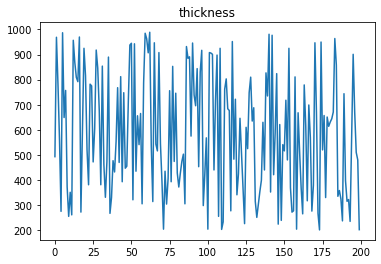

In [6]:
# load the thickness t:
t = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/My_thickness_" + name + ".csv", dtype=float) 
print('thickness of dataset '+str(dataset)+':', t[dataset])
plt.plot(t)
plt.title('thickness')

# normalize the thickness so that thickness belongs to (0,1)
t = t.astype('float32')
t = t/1000
t = t.reshape(-1,1)
print('thickness of dataset' +str(dataset) + ':', t[dataset])

In [7]:
# join Ug and t into Output(Y):
y = np.append(Ug_2real,t,axis=1)
print(y.dtype, y.shape)

float64 (200, 191)


3. Intensity:

Number of Tilts:  197
Number of Beams:  95
shape of exp_Intensity:  (197, 95)
shape of random_Intensity:  (200, 197, 95)
dtype and shape of X:  float64 (200, 18715)
dtype and shape of X_exp:  float64 (1, 18715)
0.9742549 0.97967776


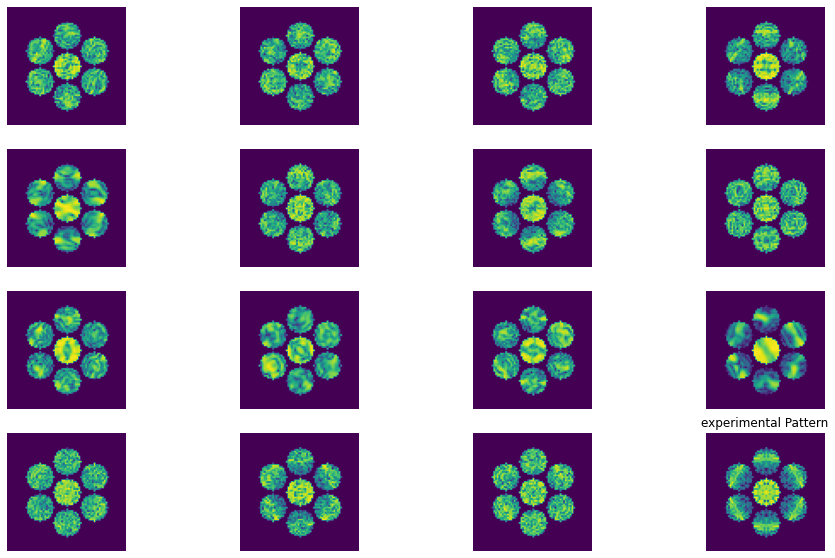

In [8]:
LoadIntensityAsInput = True  # LoadIntensityAsInput=True: load the Intensities in txt.files as Input
                              # LoadIntensityAsInput=False: use the integrated Intensities, which directly obtained from random diffraction, as Input

    
# load the intensities of experimental pattern & random diffraction pattern
# file = "ZnO_001_Th500A_T30mrad_r8_maxg_0_5_100kV"
tilt_num, beam_num, exp_Intensity, random_Intensity = lif.LoadIntensity(file = File, N_training_data=200)

# load the integrated intensitis of experimental pattern & random diffraction Pattern:
random_I = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/random_diffs_" + name + ".csv", dtype=float) 
exp_I = np.loadtxt("/Users/chenjie/pyQEDA/training_Data/diff_pattern_" + name + ".csv", dtype=float) 

if LoadIntensityAsInput == True:    
    X = random_Intensity
    X = X.reshape(-1, tilt_num*beam_num)
    X_exp = exp_Intensity
    X_exp = X_exp.reshape(1,-1)
else:
    X = random_I
    X_exp = exp_I
    X_exp= X_exp.reshape(1,-1)
    

def nlogf(x):
    return np.log(1+1000*x)
nlog = np.vectorize(nlogf)
nlogf_random_I = nlogf(random_I.reshape(-1,Nx,Nx,1))
# plot first few Diffraction Pattern:
Ncol = 4
Nrow = 4
fig,ax=plt.subplots(Nrow,Ncol,figsize=(16,10))
for j in range(Ncol*Nrow):
    plt.subplot(Nrow,Ncol,j+1)
    plt.imshow(nlogf_random_I[j])
    plt.axis('off')
        
nlogf_exp_I = nlogf(exp_I.reshape(-1,Nx,Nx,1))
plt.imshow(nlogf_exp_I[0])
plt.title('experimental Pattern')
    
print("dtype and shape of X: ", X.dtype, X.shape)    
print("dtype and shape of X_exp: ", X_exp.dtype, X_exp.shape)
print(X_exp.max(), X.max())

In [9]:
# define the size of dataset
trainsize = 150
testsize = 50
X_train = X[:trainsize,]
X_test = X[trainsize:trainsize+testsize,]
y_train = y[:trainsize,]
y_test = y[trainsize:trainsize+testsize,]

In [10]:
# check
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)
print(X_exp.shape)

(150, 18715) (150, 191)
(50, 18715) (50, 191)
(1, 18715)


---------------------------------------------------------------------------------------------------------------

# II. Neural Network

In [11]:
backend.clear_session()

target_num = y_train.shape[1]
hidden_num = int((2/3)*X_train.shape[1])

intensity_input = Input(shape=(X_train.shape[1],))
x = Dense(units=hidden_num, activation="tanh")(intensity_input)
x = Dense(units=int((1/2)*hidden_num), activation="tanh")(x)
x = Dense(units=target_num, activation="tanh")(x)
x = Dense(units=target_num, activation="tanh")(x)

model = Model(inputs=intensity_input, outputs=x)
model.summary()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 18715)]           0         
_________________________________________________________________
dense (Dense)                (None, 12476)             233500816 
_________________________________________________________________
dense_1 (Dense)              (None, 6238)              77831526  
_________________________________________________________________
dense_2 (Dense)              (None, 191)               1191649   
_________________________________________________________________
dense_3 (Dense)              (None, 191)               36672     
Total params: 312,560,663
Trainable params: 312,560,663
Non-trainable params: 0
_________________________________________________________________


In [12]:
opt = tf.keras.optimizers.Adam(lr=0.001) 
model.compile(loss='mse', optimizer=opt, metrics='acc')

#save the model
model.save(name+"_ANN.h5")

_________________________________________________________________________________________________________________

# III. Replace the initial training set with new training set

>>>train the initial training set:
Epoch 1/20
8/8 [==============================] - 7s 751ms/step - loss: 0.3060 - acc: 0.1333 - val_loss: 0.1910 - val_acc: 0.0000e+00
Epoch 2/20
8/8 [==============================] - 6s 695ms/step - loss: 0.1281 - acc: 0.0000e+00 - val_loss: 0.0816 - val_acc: 0.0000e+00
Epoch 3/20
8/8 [==============================] - 6s 691ms/step - loss: 0.0635 - acc: 0.0000e+00 - val_loss: 0.0427 - val_acc: 0.0000e+00
Epoch 4/20
8/8 [==============================] - 6s 698ms/step - loss: 0.0351 - acc: 0.0000e+00 - val_loss: 0.0229 - val_acc: 0.0000e+00
Epoch 5/20
8/8 [==============================] - 6s 703ms/step - loss: 0.0198 - acc: 0.0000e+00 - val_loss: 0.0160 - val_acc: 0.0000e+00
Epoch 6/20
8/8 [==============================] - 6s 697ms/step - loss: 0.0136 - acc: 0.0000e+00 - val_loss: 0.0096 - val_acc: 0.9800
Epoch 7/20
8/8 [==============================] - 6s 698ms/step - loss: 0.0079 - acc: 1.0000 - val_loss: 0.0072 - val_acc: 0.9800
Epoch 8/20
8/8 

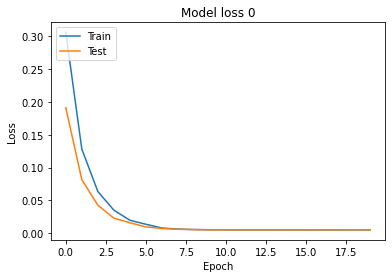

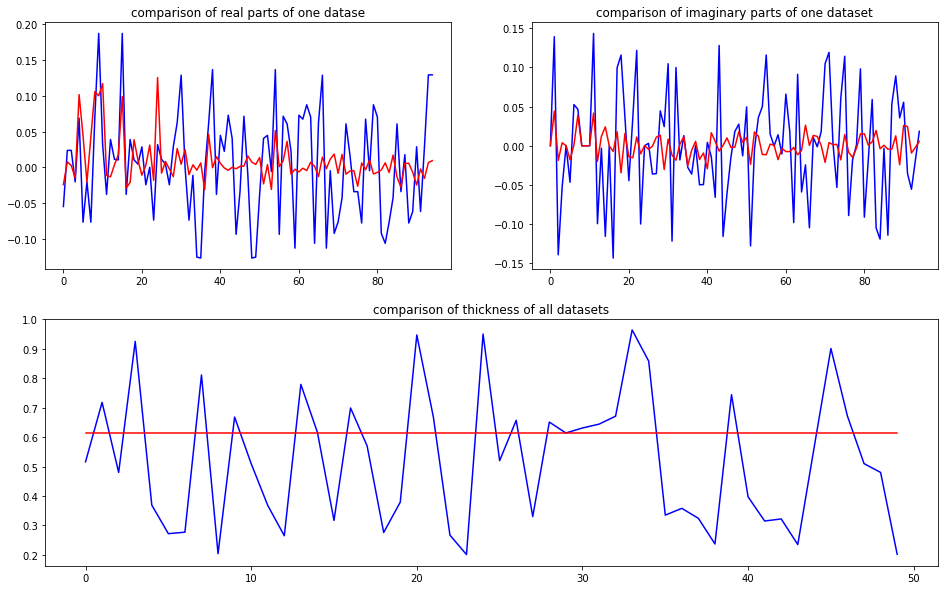

predicted thickness: 0.61329025


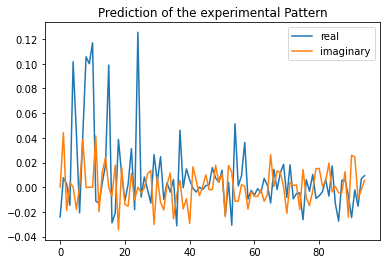

Applied shift of unit cell origin (fractional coordinates): -0.00017809803170314178 -0.48681650012785765 -0.22373844737980464
Ug[ 0 ]: 0.02404 3.14159  =>  0.02404 3.14159
Ug[ 1 ]: 0.03188 1.40579  =>  0.03188 -0.0
Ug[ 2 ]: 0.03188 -1.40579  =>  0.03188 0.0
Ug[ 3 ]: 0.01776 3.05876  =>  0.01776 0.0
Ug[ 4 ]: 0.10361 0.00185  =>  0.10361 1.82049
Ug[ 5 ]: 0.05193 -0.57667  =>  0.05193 -2.22964
Ug[ 6 ]: 0.01776 -3.05876  =>  0.01776 -0.0
Ug[ 7 ]: 0.05193 0.57667  =>  0.05193 2.22964
Ug[ 8 ]: 0.10361 -0.00185  =>  0.10361 -1.82049
Ug[ 9 ]: 0.09947 0.00112  =>  0.09947 0.0
Ug[ 10 ]: 0.12123 -0.00048  =>  0.12123 -1.40739
Ug[ 11 ]: 0.03159 2.25759  =>  0.03159 -2.62093
Ug[ 12 ]: 0.02539 -2.30622  =>  0.02539 0.75142
Ug[ 13 ]: 0.00858 1.83642  =>  0.00858 -2.79492
Ug[ 14 ]: 0.04074 0.80419  =>  0.04074 -1.01557
Ug[ 15 ]: 0.09947 -0.00112  =>  0.09947 -0.0
Ug[ 16 ]: 0.03159 -2.25759  =>  0.03159 2.62093
Ug[ 17 ]: 0.02539 2.30622  =>  0.02539 -0.75142
Ug[ 18 ]: 0.04074 -0.80419  =>  0.04074 1.01

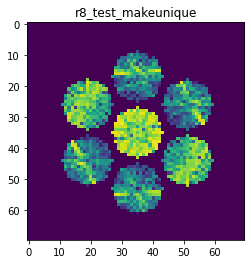

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9257047960624225
>>>replaced the 1. dataset and train: 
Epoch 1/5
8/8 [==============================] - 8s 738ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 5s 690ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 5s 690ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 1.0000


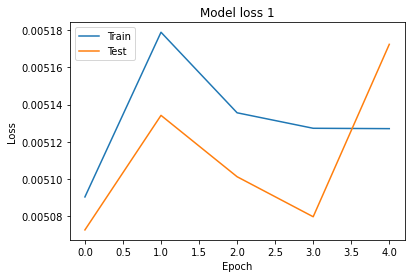

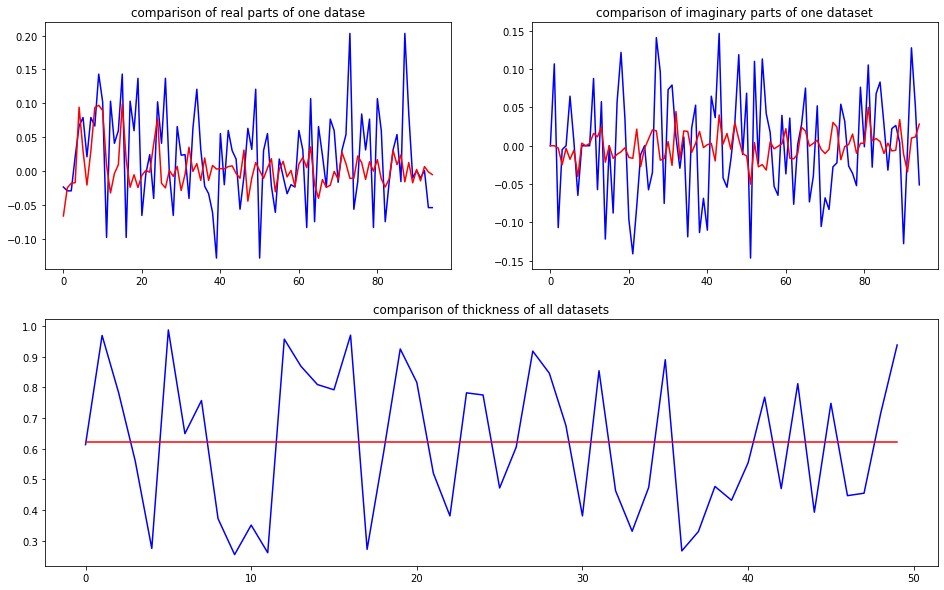

predicted thickness: 0.6205444


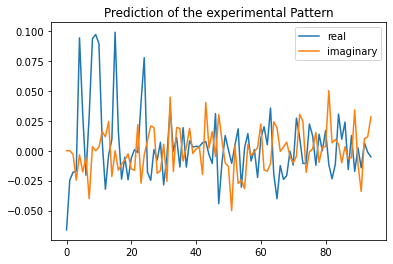

Applied shift of unit cell origin (fractional coordinates): -3.1250416285466517e-07 0.4259749618837364 -0.48864344231812745
Ug[ 0 ]: 0.06617 3.14159  =>  0.06617 3.14159
Ug[ 1 ]: 0.02135 3.07024  =>  0.02135 -0.0
Ug[ 2 ]: 0.02135 -3.07024  =>  0.02135 0.0
Ug[ 3 ]: 0.02102 -2.67648  =>  0.02102 -0.0
Ug[ 4 ]: 0.09403 -0.03585  =>  0.09403 -0.4296
Ug[ 5 ]: 0.03211 0.35632  =>  0.03211 -0.18015
Ug[ 6 ]: 0.02102 2.67648  =>  0.02102 0.0
Ug[ 7 ]: 0.03211 -0.35632  =>  0.03211 0.18015
Ug[ 8 ]: 0.09403 0.03585  =>  0.09403 0.4296
Ug[ 9 ]: 0.09798 0.0  =>  0.09798 0.0
Ug[ 10 ]: 0.0836 0.03842  =>  0.0836 -3.03182
Ug[ 11 ]: 0.02043 0.91799  =>  0.02043 -2.29496
Ug[ 12 ]: 0.03021 2.75598  =>  0.03021 0.0795
Ug[ 13 ]: 0.01336 2.51155  =>  0.01336 3.04801
Ug[ 14 ]: 0.00708 -1.28317  =>  0.00708 -0.88941
Ug[ 15 ]: 0.09798 -0.0  =>  0.09798 0.0
Ug[ 16 ]: 0.02043 -0.91799  =>  0.02043 2.29496
Ug[ 17 ]: 0.03021 -2.75598  =>  0.03021 -0.0795
Ug[ 18 ]: 0.00708 1.28317  =>  0.00708 0.88941
Ug[ 19 ]: 0.027

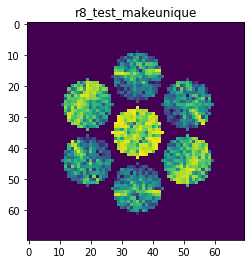

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8937935190512672
>>>replaced the 2. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 783ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 700ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000


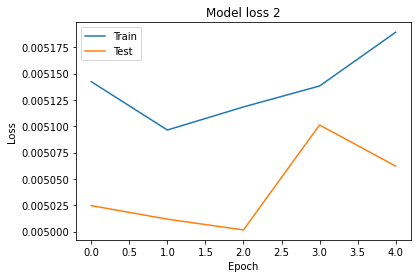

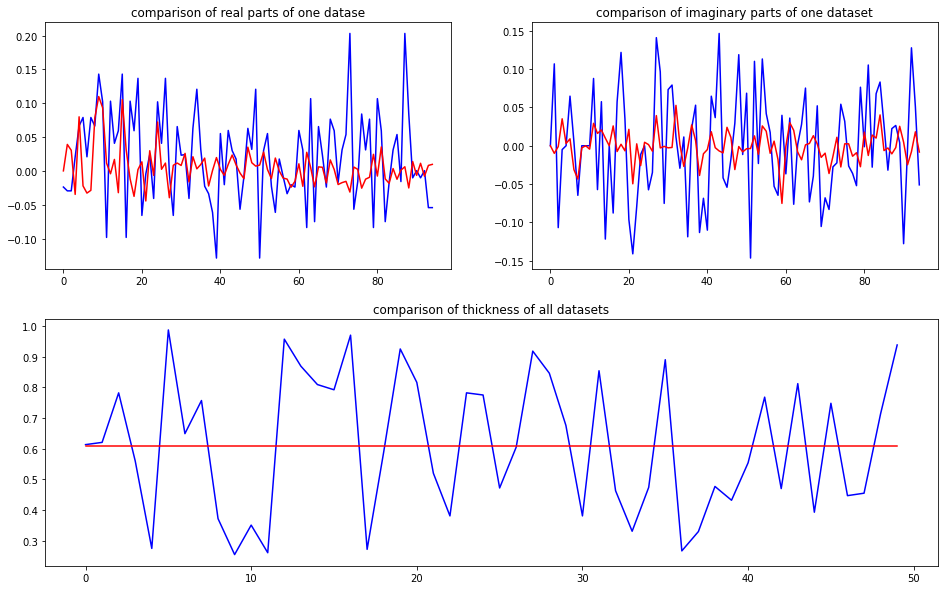

predicted thickness: 0.6094902


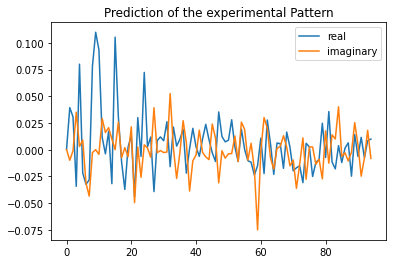

Applied shift of unit cell origin (fractional coordinates): 1.9087419928944648e-07 -0.37566252221581664 0.020008709905691938
Ug[ 0 ]: 0.00034 0.0  =>  0.00034 0.0
Ug[ 1 ]: 0.03529 -0.12572  =>  0.03529 0.0
Ug[ 2 ]: 0.03529 0.12572  =>  0.03529 0.0
Ug[ 3 ]: 0.04702 2.36036  =>  0.04702 0.0
Ug[ 4 ]: 0.0792 0.03581  =>  0.0792 -2.19883
Ug[ 5 ]: 0.03631 2.33283  =>  0.03631 -0.15325
Ug[ 6 ]: 0.04702 -2.36036  =>  0.04702 -0.0
Ug[ 7 ]: 0.03631 -2.33283  =>  0.03631 0.15325
Ug[ 8 ]: 0.0792 -0.03581  =>  0.0792 2.19883
Ug[ 9 ]: 0.10765 -0.0  =>  0.10765 0.0
Ug[ 10 ]: 0.08301 -0.05397  =>  0.08301 0.07175
Ug[ 11 ]: 0.02137 0.07892  =>  0.02137 -0.0468
Ug[ 12 ]: 0.01408 2.14771  =>  0.01408 -1.77512
Ug[ 13 ]: 0.01377 0.76331  =>  0.01377 -3.0338
Ug[ 14 ]: 0.03478 3.02634  =>  0.03478 -1.02221
Ug[ 15 ]: 0.10765 0.0  =>  0.10765 -0.0
Ug[ 16 ]: 0.02137 -0.07892  =>  0.02137 0.0468
Ug[ 17 ]: 0.01408 -2.14771  =>  0.01408 1.77512
Ug[ 18 ]: 0.03478 -3.02634  =>  0.03478 1.02221
Ug[ 19 ]: 0.00704 0.03

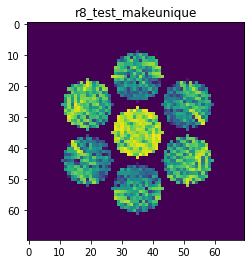

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9321503232287495
>>>replaced the 3. dataset and train: 
Epoch 1/5
8/8 [==============================] - 9s 758ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000


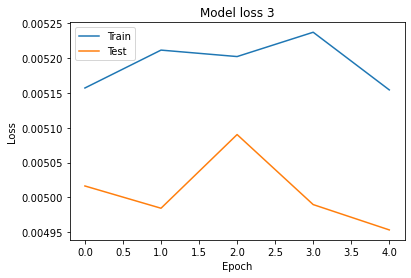

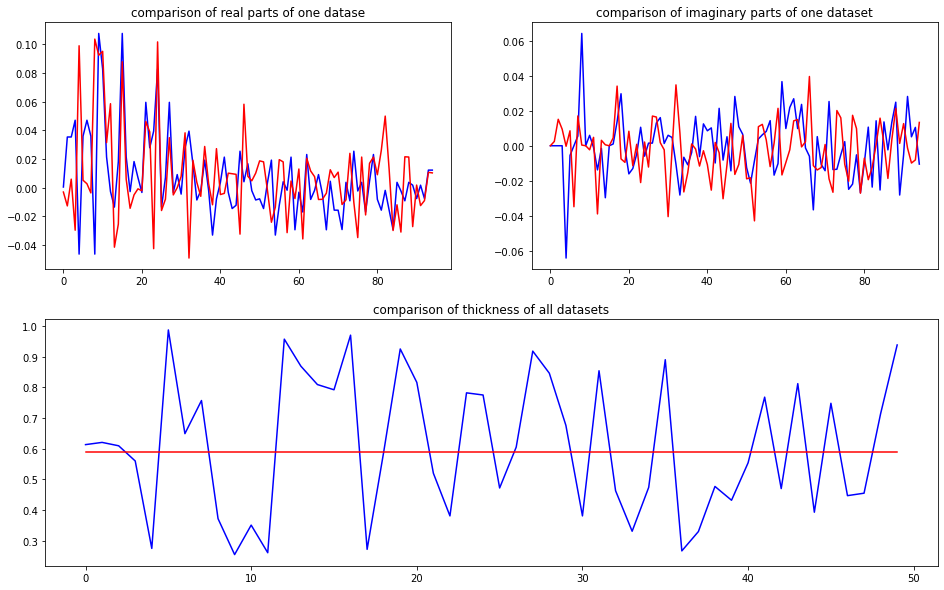

predicted thickness: 0.5907443


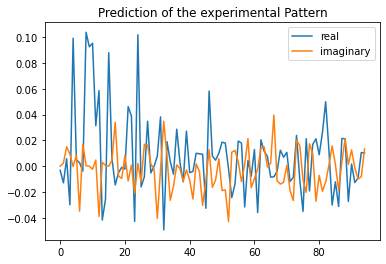

Applied shift of unit cell origin (fractional coordinates): -2.946276498846047e-06 -0.33770195976093276 0.3305469961693875
Ug[ 0 ]: 0.00318 3.14159  =>  0.00318 3.14159
Ug[ 1 ]: 0.00724 -2.07689  =>  0.00724 -0.0
Ug[ 2 ]: 0.00724 2.07689  =>  0.00724 0.0
Ug[ 3 ]: 0.02597 2.12184  =>  0.02597 0.0
Ug[ 4 ]: 0.10136 -0.00333  =>  0.10136 -0.04829
Ug[ 5 ]: 0.00428 -1.41701  =>  0.00428 0.66744
Ug[ 6 ]: 0.02597 -2.12184  =>  0.02597 -0.0
Ug[ 7 ]: 0.00428 1.41701  =>  0.00428 -0.66744
Ug[ 8 ]: 0.10136 0.00333  =>  0.10136 0.04829
Ug[ 9 ]: 0.09015 2e-05  =>  0.09015 0.0
Ug[ 10 ]: 0.09845 -0.02253  =>  0.09845 2.05434
Ug[ 11 ]: 0.01856 0.0085  =>  0.01856 -2.06841
Ug[ 12 ]: 0.0426 -1.02758  =>  0.0426 1.09424
Ug[ 13 ]: 0.02987 2.88351  =>  0.02987 0.79904
Ug[ 14 ]: 0.01586 2.88489  =>  0.01586 2.92983
Ug[ 15 ]: 0.09015 -2e-05  =>  0.09015 -0.0
Ug[ 16 ]: 0.01856 -0.0085  =>  0.01856 2.06841
Ug[ 17 ]: 0.0426 1.02758  =>  0.0426 -1.09424
Ug[ 18 ]: 0.01586 -2.88489  =>  0.01586 -2.92983
Ug[ 19 ]: 0

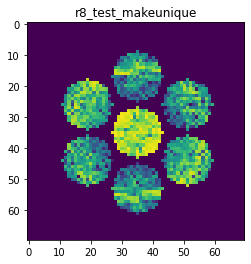

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8898400802530632
>>>replaced the 4. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 722ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 702ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0050 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000


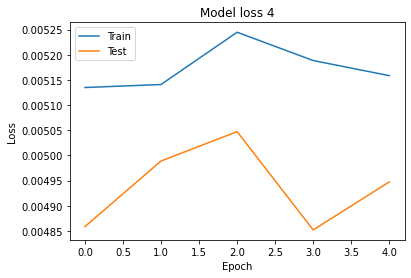

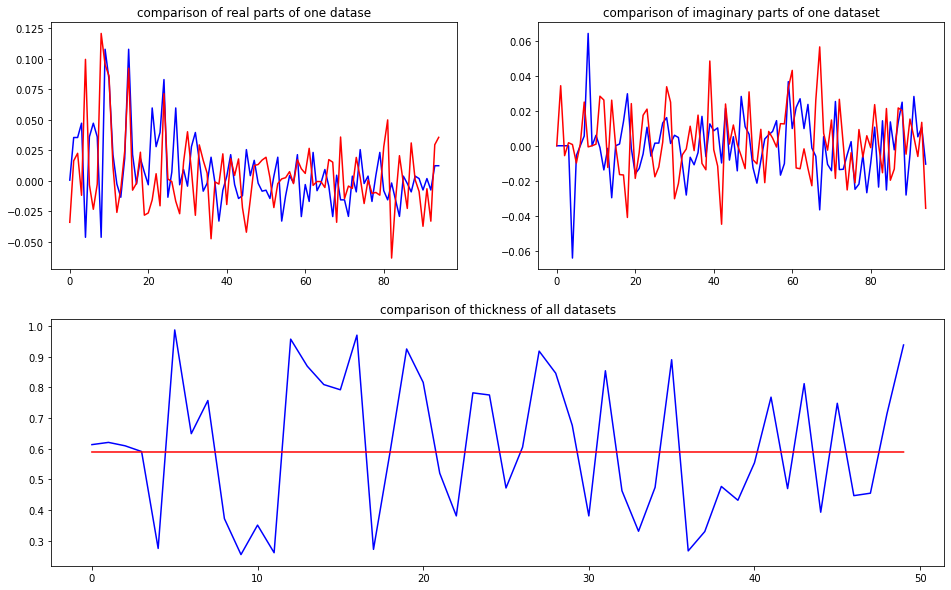

predicted thickness: 0.58926773


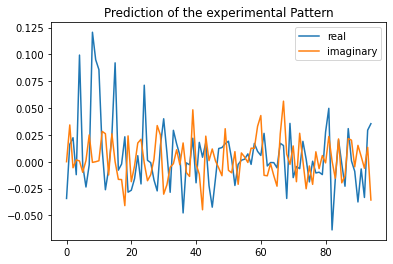

Applied shift of unit cell origin (fractional coordinates): 3.7944846105480995e-06 -0.49739989088120967 -0.12770946762079557
Ug[ 0 ]: 0.03425 3.14159  =>  0.03425 3.14159
Ug[ 1 ]: 0.02775 0.80242  =>  0.02775 0.0
Ug[ 2 ]: 0.02775 -0.80242  =>  0.02775 -0.0
Ug[ 3 ]: 0.01783 3.12526  =>  0.01783 -0.0
Ug[ 4 ]: 0.11 0.00607  =>  0.11 2.36158
Ug[ 5 ]: 0.01769 -1.75234  =>  0.01769 2.20801
Ug[ 6 ]: 0.01783 -3.12526  =>  0.01783 0.0
Ug[ 7 ]: 0.01769 1.75234  =>  0.01769 -2.20801
Ug[ 8 ]: 0.11 -0.00607  =>  0.11 -2.36158
Ug[ 9 ]: 0.09358 -2e-05  =>  0.09358 0.0
Ug[ 10 ]: 0.07853 0.01342  =>  0.07853 -0.78898
Ug[ 11 ]: 0.02245 1.48209  =>  0.02245 2.28453
Ug[ 12 ]: 0.02565 2.15544  =>  0.02565 -1.00247
Ug[ 13 ]: 0.00388 2.38165  =>  0.00388 -1.57867
Ug[ 14 ]: 0.041 0.95512  =>  0.041 -1.40036
Ug[ 15 ]: 0.09358 2e-05  =>  0.09358 0.0
Ug[ 16 ]: 0.02245 -1.48209  =>  0.02245 -2.28453
Ug[ 17 ]: 0.02565 -2.15544  =>  0.02565 1.00247
Ug[ 18 ]: 0.041 -0.95512  =>  0.041 1.40036
Ug[ 19 ]: 0.02328 2.251

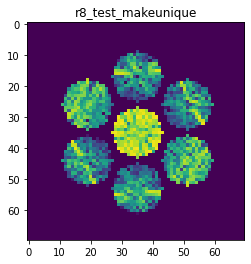

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.959667571316156
>>>replaced the 5. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 733ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 700ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0051 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 691ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000


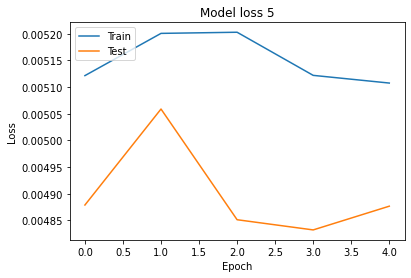

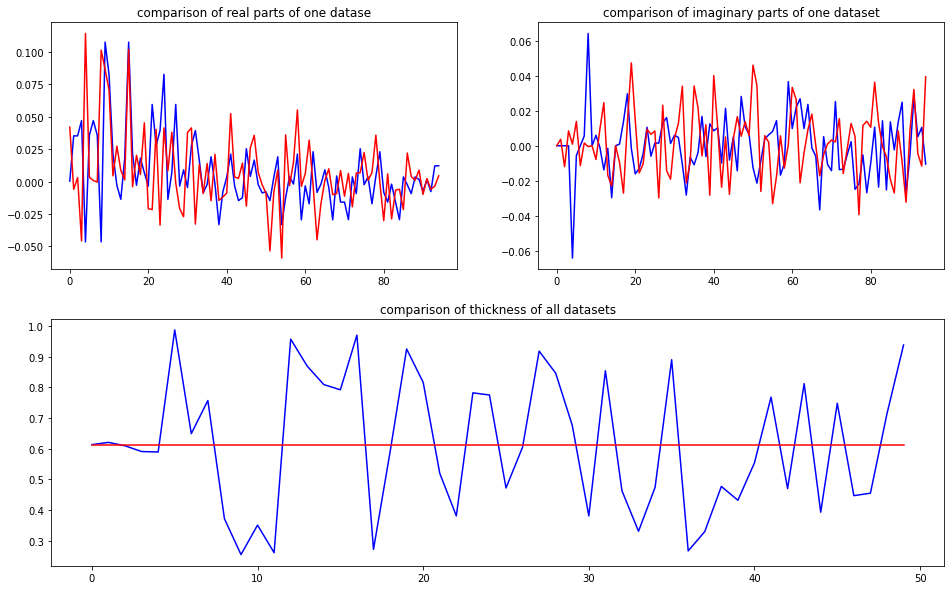

predicted thickness: 0.61044294


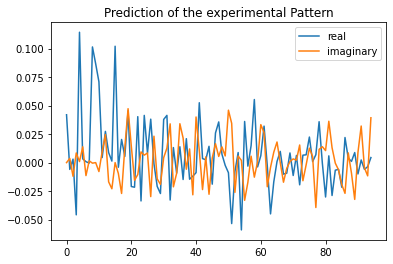

Applied shift of unit cell origin (fractional coordinates): -9.14524194748401e-07 -0.4338240575713184 -0.279193466523841
Ug[ 0 ]: 0.04199 0.0  =>  0.04199 0.0
Ug[ 1 ]: 0.00796 1.75422  =>  0.00796 0.0
Ug[ 2 ]: 0.00796 -1.75422  =>  0.00796 0.0
Ug[ 3 ]: 0.02457 2.7258  =>  0.02457 -0.0
Ug[ 4 ]: 0.10791 0.00642  =>  0.10791 1.80959
Ug[ 5 ]: 0.00632 1.34027  =>  0.00632 0.3687
Ug[ 6 ]: 0.02457 -2.7258  =>  0.02457 0.0
Ug[ 7 ]: 0.00632 -1.34027  =>  0.00632 -0.3687
Ug[ 8 ]: 0.10791 -0.00642  =>  0.10791 -1.80959
Ug[ 9 ]: 0.09436 1e-05  =>  0.09436 0.0
Ug[ 10 ]: 0.05661 -0.12763  =>  0.05661 -1.88186
Ug[ 11 ]: 0.00954 1.5519  =>  0.00954 -2.97707
Ug[ 12 ]: 0.03515 0.8252  =>  0.03515 -2.73219
Ug[ 13 ]: 0.01528 -0.97495  =>  0.01528 -0.00338
Ug[ 14 ]: 0.01844 -1.38575  =>  0.01844 3.09427
Ug[ 15 ]: 0.09436 -1e-05  =>  0.09436 0.0
Ug[ 16 ]: 0.00954 -1.5519  =>  0.00954 2.97707
Ug[ 17 ]: 0.03515 -0.8252  =>  0.03515 2.73219
Ug[ 18 ]: 0.01844 1.38575  =>  0.01844 -3.09427
Ug[ 19 ]: 0.05682 0.74

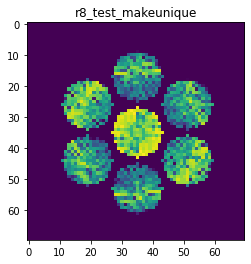

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.932425599340142
>>>replaced the 6. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 734ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 5s 691ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 5s 687ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000


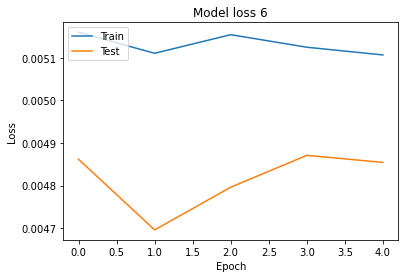

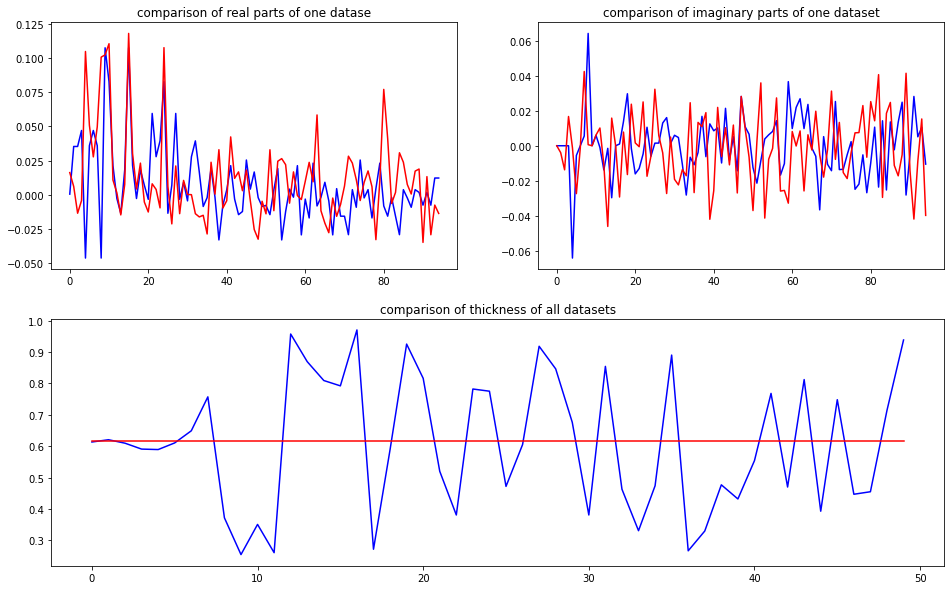

predicted thickness: 0.6180299


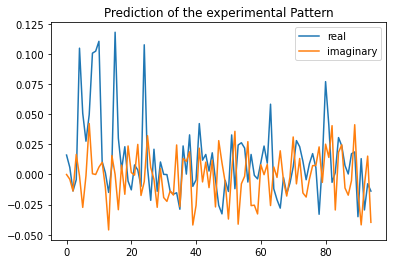

Applied shift of unit cell origin (fractional coordinates): -3.0927501445642106e-06 -0.10361347156060387 -0.35590878983281643
Ug[ 0 ]: 0.01614 0.0  =>  0.01614 0.0
Ug[ 1 ]: 0.00623 2.23624  =>  0.00623 0.0
Ug[ 2 ]: 0.00623 -2.23624  =>  0.00623 -0.0
Ug[ 3 ]: 0.01467 0.65102  =>  0.01467 0.0
Ug[ 4 ]: 0.10287 -0.00873  =>  0.10287 -2.89599
Ug[ 5 ]: 0.06115 -0.60632  =>  0.06115 0.9789
Ug[ 6 ]: 0.01467 -0.65102  =>  0.01467 0.0
Ug[ 7 ]: 0.06115 0.60632  =>  0.06115 -0.9789
Ug[ 8 ]: 0.10287 0.00873  =>  0.10287 2.89599
Ug[ 9 ]: 0.11033 2e-05  =>  0.11033 0.0
Ug[ 10 ]: 0.10936 0.055  =>  0.10936 -2.18126
Ug[ 11 ]: 0.02836 0.76738  =>  0.02836 3.0036
Ug[ 12 ]: 0.00978 -1.2895  =>  0.00978 -0.6385
Ug[ 13 ]: 0.03939 -1.68339  =>  0.03939 3.01456
Ug[ 14 ]: 0.0222 0.81186  =>  0.0222 -2.58408
Ug[ 15 ]: 0.11033 -2e-05  =>  0.11033 -0.0
Ug[ 16 ]: 0.02836 -0.76738  =>  0.02836 -3.0036
Ug[ 17 ]: 0.00978 1.2895  =>  0.00978 0.6385
Ug[ 18 ]: 0.0222 -0.81186  =>  0.0222 2.58408
Ug[ 19 ]: 0.01617 2.5550

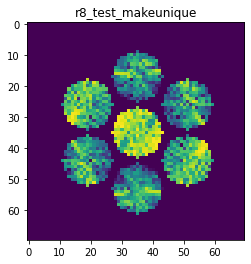

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8618844793209043
>>>replaced the 7. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 5s 689ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 693ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000


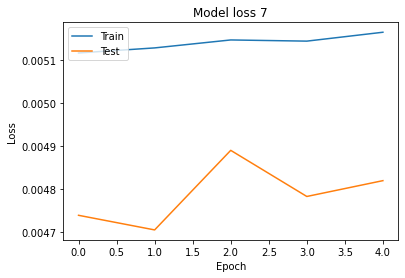

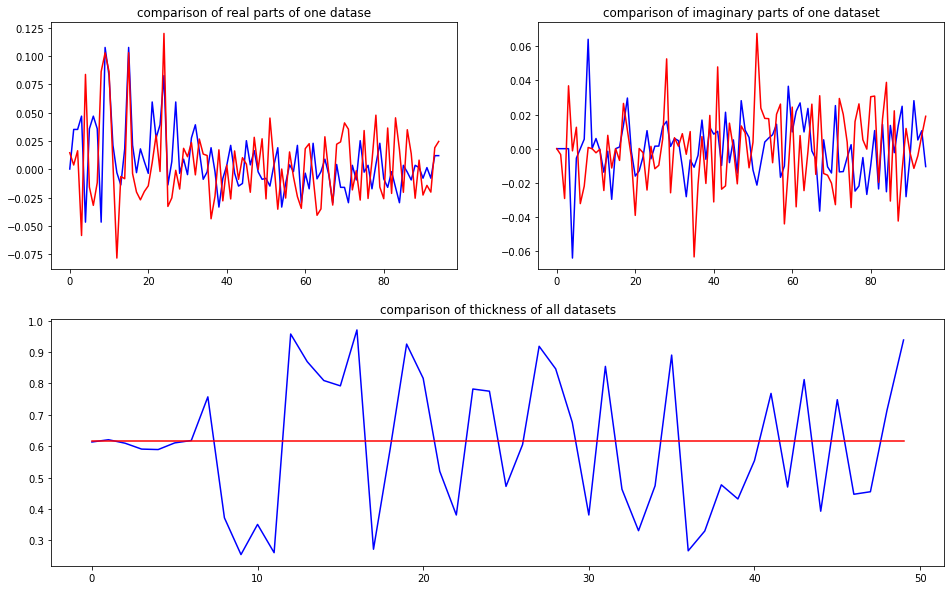

predicted thickness: 0.61764073


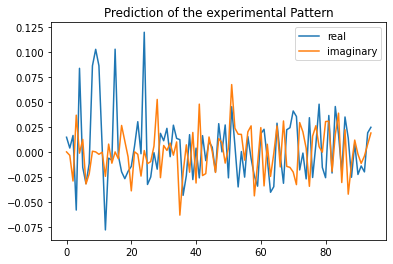

Applied shift of unit cell origin (fractional coordinates): -1.4513987273606448e-07 -0.3959130551229487 -0.14338557796200255
Ug[ 0 ]: 0.01471 0.0  =>  0.01471 0.0
Ug[ 1 ]: 0.01641 0.90092  =>  0.01641 0.0
Ug[ 2 ]: 0.01641 -0.90092  =>  0.01641 -0.0
Ug[ 3 ]: 0.05673 2.4876  =>  0.05673 -0.0
Ug[ 4 ]: 0.0851 -0.01165  =>  0.0851 2.88302
Ug[ 5 ]: 0.022 2.23993  =>  0.022 0.65326
Ug[ 6 ]: 0.05673 -2.4876  =>  0.05673 0.0
Ug[ 7 ]: 0.022 -2.23993  =>  0.022 -0.65326
Ug[ 8 ]: 0.0851 0.01165  =>  0.0851 -2.88302
Ug[ 9 ]: 0.10296 0.0  =>  0.10296 0.0
Ug[ 10 ]: 0.10325 -0.01818  =>  0.10325 -0.9191
Ug[ 11 ]: 0.00337 1.34118  =>  0.00337 2.24209
Ug[ 12 ]: 0.05534 -2.6623  =>  0.05534 -0.17471
Ug[ 13 ]: 0.02179 2.67529  =>  0.02179 -2.02122
Ug[ 14 ]: 0.02073 -2.57834  =>  0.02073 0.81017
Ug[ 15 ]: 0.10296 -0.0  =>  0.10296 0.0
Ug[ 16 ]: 0.00337 -1.34118  =>  0.00337 -2.24209
Ug[ 17 ]: 0.05534 2.6623  =>  0.05534 0.17471
Ug[ 18 ]: 0.02073 2.57834  =>  0.02073 -0.81017
Ug[ 19 ]: 0.02247 3.03445  =>  

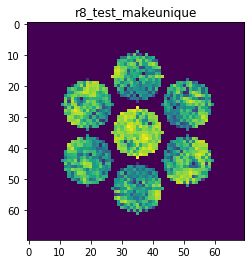

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9147833827291824
>>>replaced the 8. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000


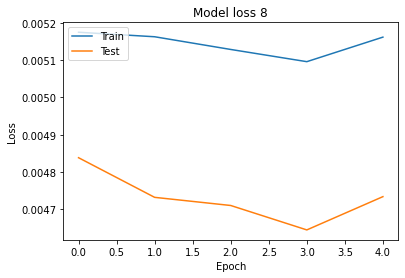

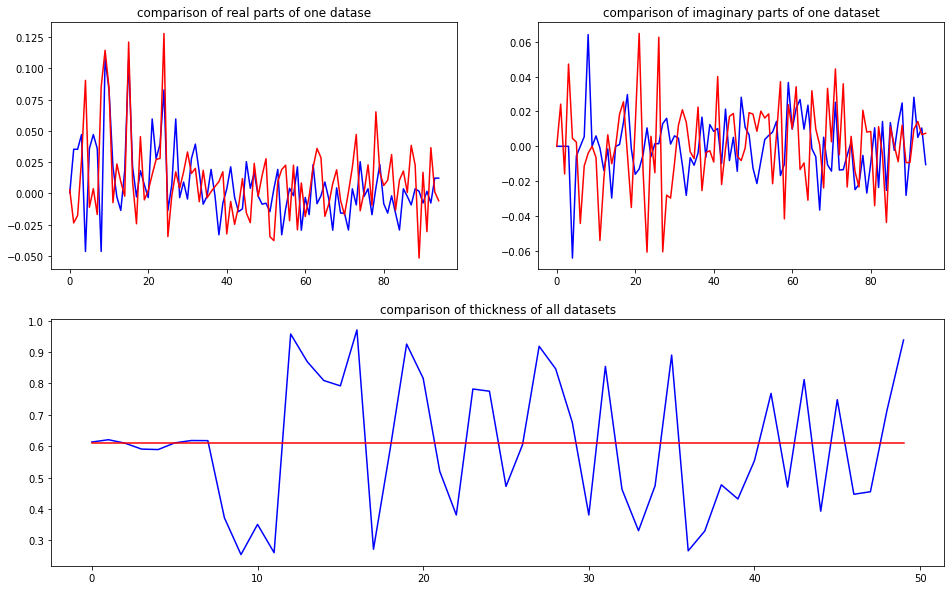

predicted thickness: 0.60975075


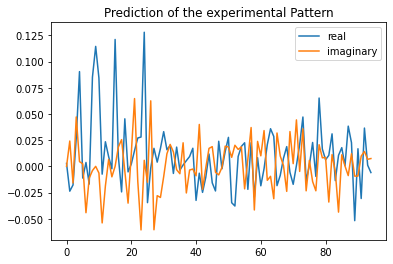

Applied shift of unit cell origin (fractional coordinates): 3.914846657276791e-07 -0.1984033275866877 -0.3777503406177416
Ug[ 0 ]: 0.00279 0.0  =>  0.00279 0.0
Ug[ 1 ]: 0.02883 2.37348  =>  0.02883 -0.0
Ug[ 2 ]: 0.02883 -2.37348  =>  0.02883 0.0
Ug[ 3 ]: 0.04822 1.2466  =>  0.04822 0.0
Ug[ 4 ]: 0.08792 0.04869  =>  0.08792 2.71179
Ug[ 5 ]: 0.0156 2.6894  =>  0.0156 -2.46691
Ug[ 6 ]: 0.04822 -1.2466  =>  0.04822 -0.0
Ug[ 7 ]: 0.0156 -2.6894  =>  0.0156 2.46691
Ug[ 8 ]: 0.08792 -0.04869  =>  0.08792 -2.71179
Ug[ 9 ]: 0.11782 -0.0  =>  0.11782 0.0
Ug[ 10 ]: 0.10635 -0.05716  =>  0.10635 -2.43064
Ug[ 11 ]: 0.03622 -1.54228  =>  0.03622 0.8312
Ug[ 12 ]: 0.02209 -1.59127  =>  0.02209 -0.34466
Ug[ 13 ]: 0.01669 2.43114  =>  0.01669 1.30427
Ug[ 14 ]: 0.02171 -0.12567  =>  0.02171 -2.78878
Ug[ 15 ]: 0.11782 0.0  =>  0.11782 0.0
Ug[ 16 ]: 0.03622 1.54228  =>  0.03622 -0.8312
Ug[ 17 ]: 0.02209 1.59127  =>  0.02209 0.34466
Ug[ 18 ]: 0.02171 0.12567  =>  0.02171 2.78878
Ug[ 19 ]: 0.04896 -1.64289  

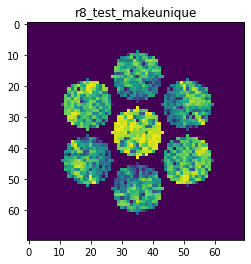

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8711468790956535
>>>replaced the 9. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 745ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 700ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0047 - val_acc: 1.0000


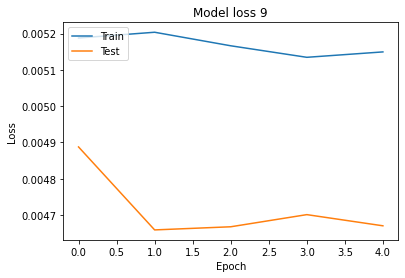

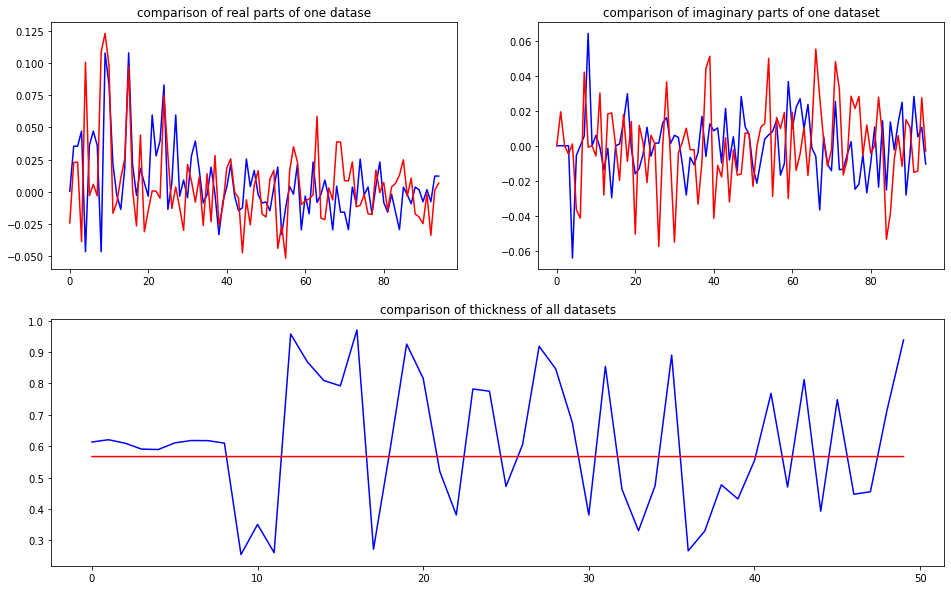

predicted thickness: 0.56693614


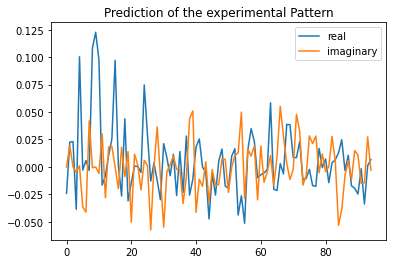

Applied shift of unit cell origin (fractional coordinates): 1.5843490383010796e-06 -0.36658728734061236 -0.06409992422925248
Ug[ 0 ]: 0.02412 3.14159  =>  0.02412 3.14159
Ug[ 1 ]: 0.02478 0.40275  =>  0.02478 0.0
Ug[ 2 ]: 0.02478 -0.40275  =>  0.02478 -0.0
Ug[ 3 ]: 0.02457 2.30334  =>  0.02457 -0.0
Ug[ 4 ]: 0.10446 0.00903  =>  0.10446 -2.69706
Ug[ 5 ]: 0.03937 -1.64843  =>  0.03937 2.73418
Ug[ 6 ]: 0.02457 -2.30334  =>  0.02457 0.0
Ug[ 7 ]: 0.03937 1.64843  =>  0.03937 -2.73418
Ug[ 8 ]: 0.10446 -0.00903  =>  0.10446 2.69706
Ug[ 9 ]: 0.10998 -1e-05  =>  0.10998 0.0
Ug[ 10 ]: 0.08646 -0.06847  =>  0.08646 -0.47122
Ug[ 11 ]: 0.02605 1.86434  =>  0.02605 2.2671
Ug[ 12 ]: 0.02879 -2.21762  =>  0.02879 0.08573
Ug[ 13 ]: 0.02141 0.41068  =>  0.02141 2.31127
Ug[ 14 ]: 0.03734 0.37885  =>  0.03734 3.08494
Ug[ 15 ]: 0.10998 1e-05  =>  0.10998 0.0
Ug[ 16 ]: 0.02605 -1.86434  =>  0.02605 -2.2671
Ug[ 17 ]: 0.02879 2.21762  =>  0.02879 -0.08573
Ug[ 18 ]: 0.03734 -0.37885  =>  0.03734 -3.08494
Ug[ 1

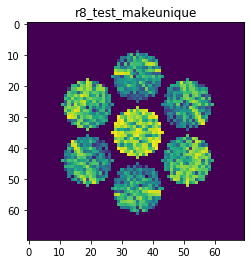

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9083419116284261
>>>replaced the 10. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 733ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 691ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 5s 689ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 701ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 691ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000


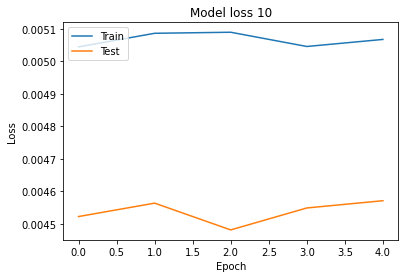

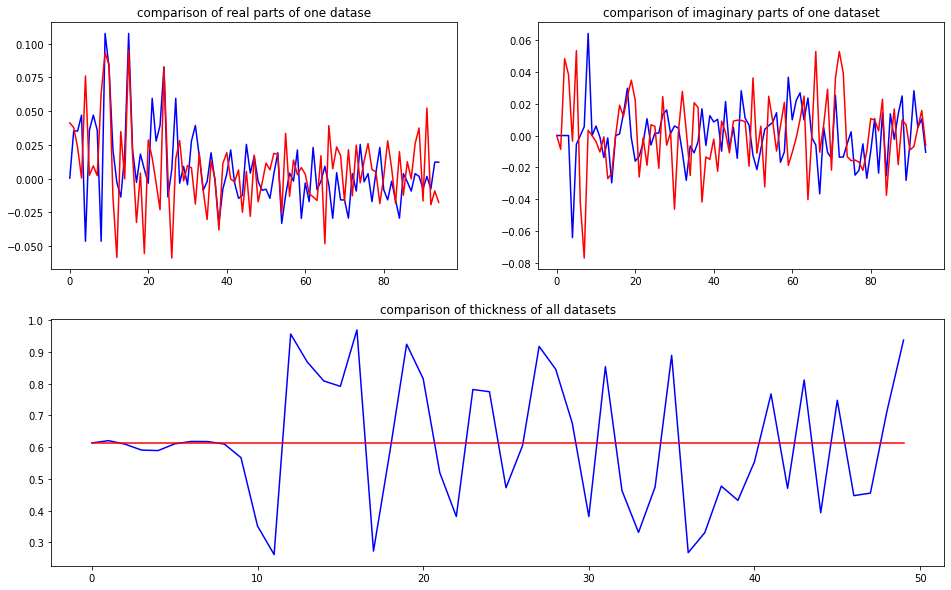

predicted thickness: 0.613814


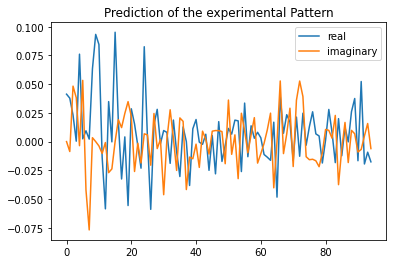

Applied shift of unit cell origin (fractional coordinates): 7.0475501374444305e-06 -0.23076128028661877 0.11961636202312685
Ug[ 0 ]: 0.04129 0.0  =>  0.04129 0.0
Ug[ 1 ]: 0.04168 -0.75157  =>  0.04168 0.0
Ug[ 2 ]: 0.04168 0.75157  =>  0.04168 -0.0
Ug[ 3 ]: 0.04047 1.44992  =>  0.04047 -0.0
Ug[ 4 ]: 0.06982 -0.04967  =>  0.06982 -0.74802
Ug[ 5 ]: 0.06514 1.5357  =>  0.06514 -0.66579
Ug[ 6 ]: 0.04047 -1.44992  =>  0.04047 0.0
Ug[ 7 ]: 0.06514 -1.5357  =>  0.06514 0.66579
Ug[ 8 ]: 0.06982 0.04967  =>  0.06982 0.74802
Ug[ 9 ]: 0.09426 -4e-05  =>  0.09426 0.0
Ug[ 10 ]: 0.08374 -0.06308  =>  0.08374 0.68853
Ug[ 11 ]: 0.0148 -1.44809  =>  0.0148 -2.19962
Ug[ 12 ]: 0.04601 -2.99978  =>  0.04601 -1.54982
Ug[ 13 ]: 0.02473 -0.72595  =>  0.02473 1.47558
Ug[ 14 ]: 0.02423 -1.4911  =>  0.02423 -0.79271
Ug[ 15 ]: 0.09426 4e-05  =>  0.09426 0.0
Ug[ 16 ]: 0.0148 1.44809  =>  0.0148 2.19962
Ug[ 17 ]: 0.04601 2.99978  =>  0.04601 1.54982
Ug[ 18 ]: 0.02423 1.4911  =>  0.02423 0.79271
Ug[ 19 ]: 0.06365 2.

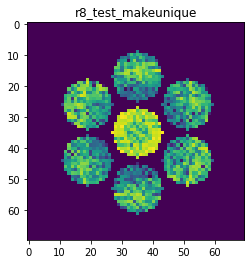

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9341615258804455
>>>replaced the 11. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 723ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000


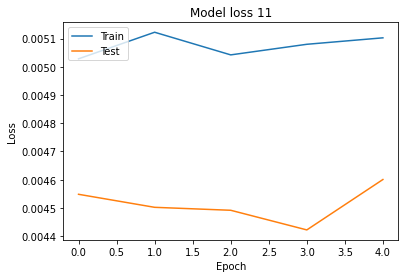

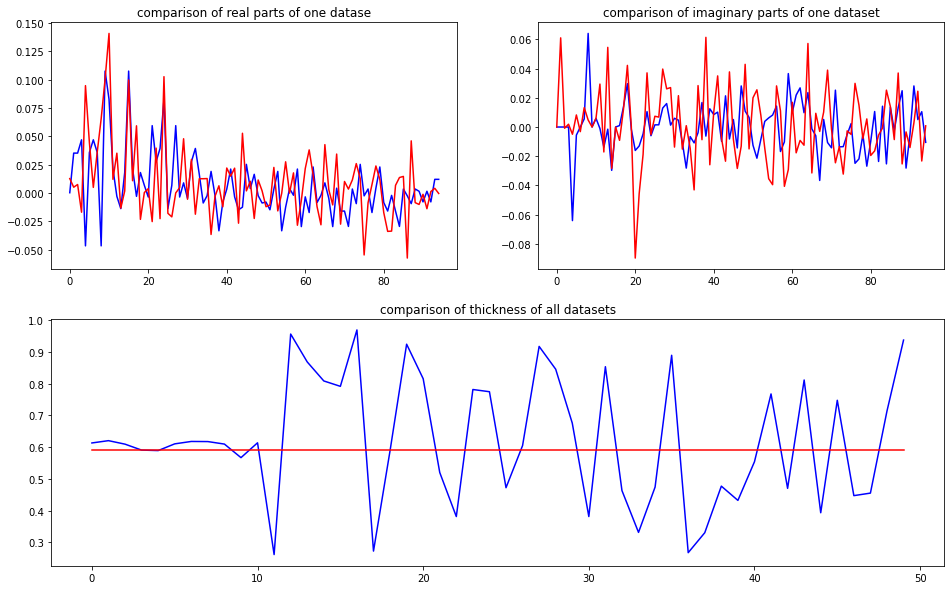

predicted thickness: 0.5923571


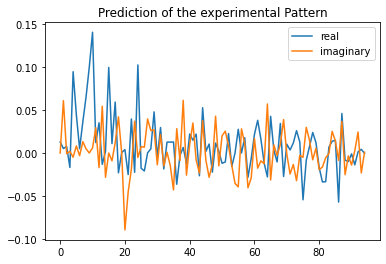

Applied shift of unit cell origin (fractional coordinates): 2.2149761141456544e-06 -0.4352423409270523 -0.21754122955693692
Ug[ 0 ]: 0.01282 0.0  =>  0.01282 0.0
Ug[ 1 ]: 0.0316 1.36685  =>  0.0316 -0.0
Ug[ 2 ]: 0.0316 -1.36685  =>  0.0316 0.0
Ug[ 3 ]: 0.00642 2.73471  =>  0.00642 -0.0
Ug[ 4 ]: 0.08035 -0.06078  =>  0.08035 2.12084
Ug[ 5 ]: 0.04053 -0.06177  =>  0.04053 -1.42963
Ug[ 6 ]: 0.00642 -2.73471  =>  0.00642 0.0
Ug[ 7 ]: 0.04053 0.06177  =>  0.04053 1.42963
Ug[ 8 ]: 0.08035 0.06078  =>  0.08035 -2.12084
Ug[ 9 ]: 0.10019 -1e-05  =>  0.10019 0.0
Ug[ 10 ]: 0.12192 0.04607  =>  0.12192 -1.32077
Ug[ 11 ]: 0.02246 1.03064  =>  0.02246 2.3975
Ug[ 12 ]: 0.04949 -0.29913  =>  0.04949 2.43559
Ug[ 13 ]: 0.02824 2.15328  =>  0.02824 -2.76204
Ug[ 14 ]: 0.03684 -1.86404  =>  0.03684 2.23754
Ug[ 15 ]: 0.10019 1e-05  =>  0.10019 0.0
Ug[ 16 ]: 0.02246 -1.03064  =>  0.02246 -2.3975
Ug[ 17 ]: 0.04949 0.29913  =>  0.04949 -2.43559
Ug[ 18 ]: 0.03684 1.86404  =>  0.03684 -2.23754
Ug[ 19 ]: 0.01076 

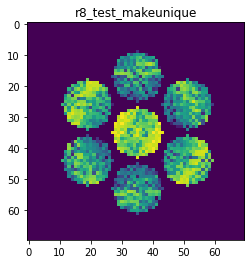

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9432804639076645
>>>replaced the 12. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 693ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 712ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0045 - val_acc: 1.0000


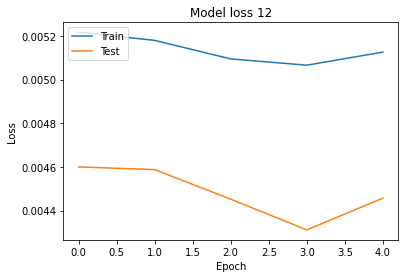

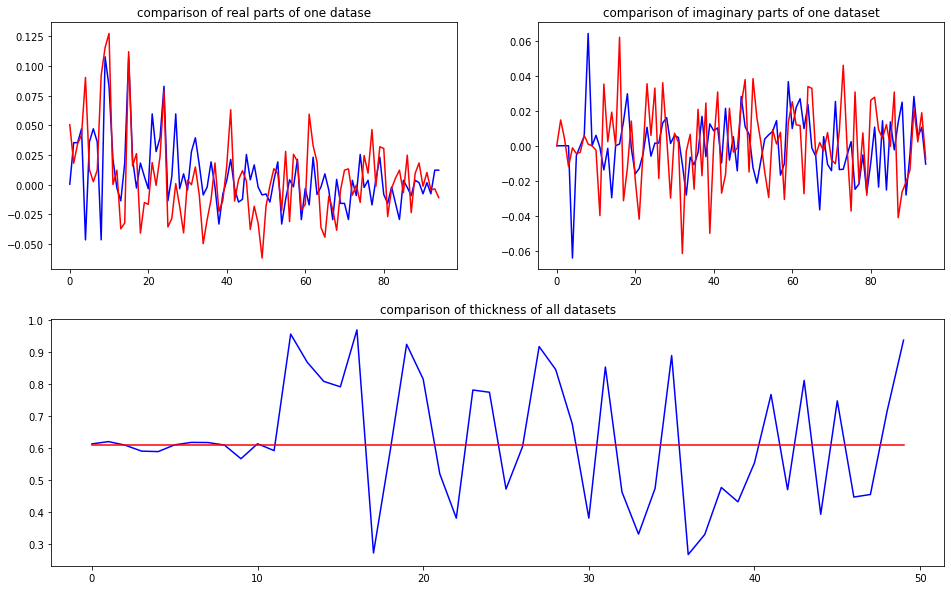

predicted thickness: 0.6112568


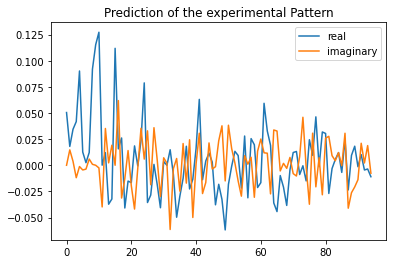

Applied shift of unit cell origin (fractional coordinates): 2.7646041354716674e-06 0.029244450694344597 -0.032805203975016656
Ug[ 0 ]: 0.05046 0.0  =>  0.05046 0.0
Ug[ 1 ]: 0.02682 0.20612  =>  0.02682 -0.0
Ug[ 2 ]: 0.02682 -0.20612  =>  0.02682 0.0
Ug[ 3 ]: 0.02249 -0.18375  =>  0.02249 0.0
Ug[ 4 ]: 0.0911 -0.0116  =>  0.0911 -0.03397
Ug[ 5 ]: 0.01347 -0.39886  =>  0.01347 -0.00899
Ug[ 6 ]: 0.02249 0.18375  =>  0.02249 -0.0
Ug[ 7 ]: 0.01347 0.39886  =>  0.01347 0.00899
Ug[ 8 ]: 0.0911 0.0116  =>  0.0911 0.03397
Ug[ 9 ]: 0.11364 -2e-05  =>  0.11364 -0.0
Ug[ 10 ]: 0.10314 -0.04096  =>  0.10314 -0.24707
Ug[ 11 ]: 0.05148 -1.41686  =>  0.05148 -1.21072
Ug[ 12 ]: 0.03837 1.04967  =>  0.03837 0.86594
Ug[ 13 ]: 0.03955 -2.74392  =>  0.03955 -3.13377
Ug[ 14 ]: 0.03989 2.73176  =>  0.03989 2.75415
Ug[ 15 ]: 0.11364 2e-05  =>  0.11364 0.0
Ug[ 16 ]: 0.05148 1.41686  =>  0.05148 1.21072
Ug[ 17 ]: 0.03837 -1.04967  =>  0.03837 -0.86594
Ug[ 18 ]: 0.03989 -2.73176  =>  0.03989 -2.75415
Ug[ 19 ]: 0.0

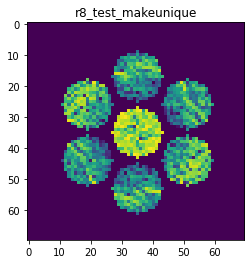

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9540275626000163
>>>replaced the 13. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 747ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 707ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 706ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 708ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 705ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000


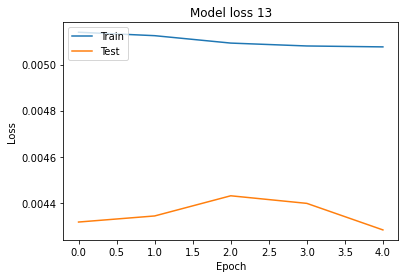

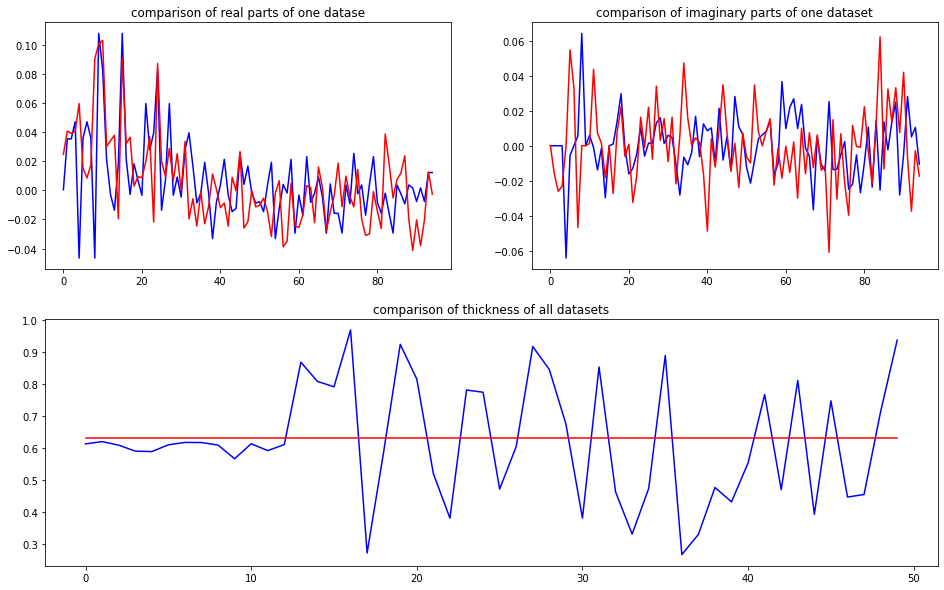

predicted thickness: 0.6325125


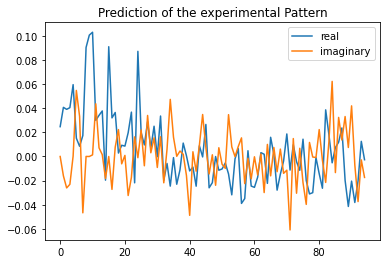

Applied shift of unit cell origin (fractional coordinates): -6.662776531050171e-07 0.13607425033196344 -0.019850361900442308
Ug[ 0 ]: 0.02469 0.0  =>  0.02469 0.0
Ug[ 1 ]: 0.04016 0.12472  =>  0.04016 0.0
Ug[ 2 ]: 0.04016 -0.12472  =>  0.04016 -0.0
Ug[ 3 ]: 0.03725 -0.85498  =>  0.03725 -0.0
Ug[ 4 ]: 0.07487 0.00192  =>  0.07487 0.73218
Ug[ 5 ]: 0.0532 1.2605  =>  0.0532 2.2402
Ug[ 6 ]: 0.03725 0.85498  =>  0.03725 0.0
Ug[ 7 ]: 0.0532 -1.2605  =>  0.0532 -2.2402
Ug[ 8 ]: 0.07487 -0.00192  =>  0.07487 -0.73218
Ug[ 9 ]: 0.09567 0.0  =>  0.09567 -0.0
Ug[ 10 ]: 0.09496 0.01236  =>  0.09496 -0.11236
Ug[ 11 ]: 0.04704 0.85259  =>  0.04704 0.97731
Ug[ 12 ]: 0.03524 -0.00793  =>  0.03524 -0.86291
Ug[ 13 ]: 0.03056 -0.34058  =>  0.03056 -1.32029
Ug[ 14 ]: 0.0219 -1.96278  =>  0.0219 -2.69304
Ug[ 15 ]: 0.09567 -0.0  =>  0.09567 0.0
Ug[ 16 ]: 0.04704 -0.85259  =>  0.04704 -0.97731
Ug[ 17 ]: 0.03524 0.00793  =>  0.03524 0.86291
Ug[ 18 ]: 0.0219 1.96278  =>  0.0219 2.69304
Ug[ 19 ]: 0.00948 0.08531

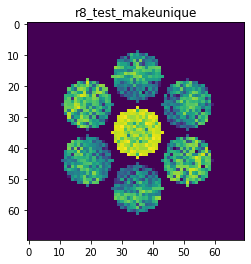

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9614423596004424
>>>replaced the 14. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 733ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 693ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 700ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000


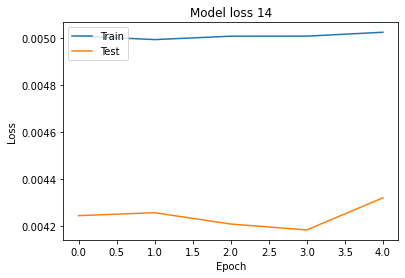

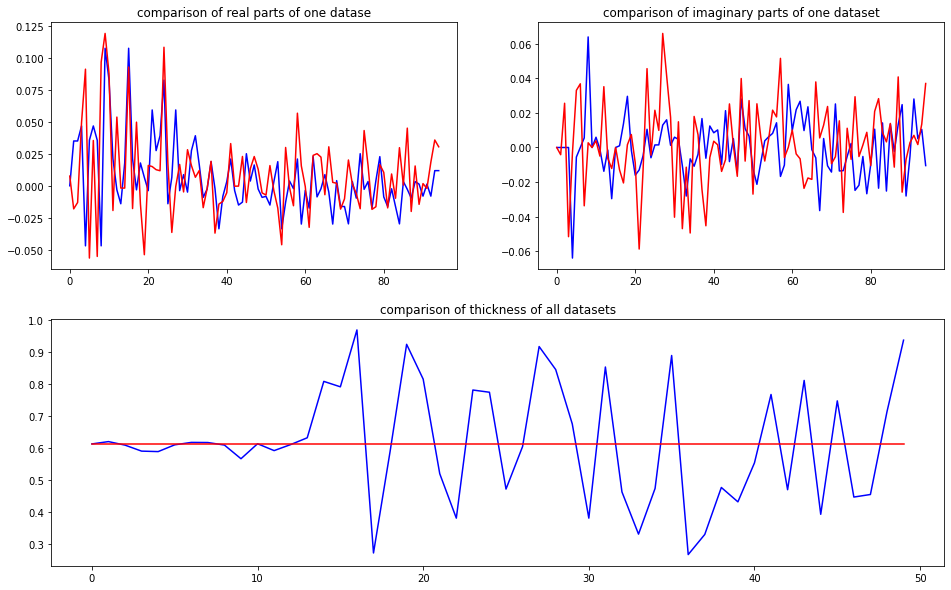

predicted thickness: 0.6142343


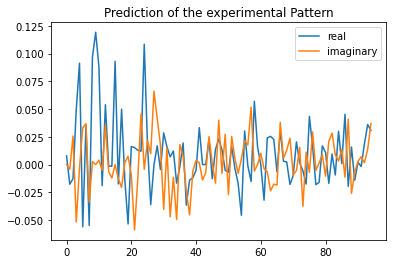

Applied shift of unit cell origin (fractional coordinates): 3.995149607483516e-06 0.1279506208360864 0.37645155748173925
Ug[ 0 ]: 0.00787 0.0  =>  0.00787 0.0
Ug[ 1 ]: 0.02129 -2.36531  =>  0.02129 0.0
Ug[ 2 ]: 0.02129 2.36531  =>  0.02129 -0.0
Ug[ 3 ]: 0.06153 -0.80394  =>  0.06153 0.0
Ug[ 4 ]: 0.09417 -0.03084  =>  0.09417 3.13841
Ug[ 5 ]: 0.06475 2.59843  =>  0.06475 1.03705
Ug[ 6 ]: 0.06153 0.80394  =>  0.06153 0.0
Ug[ 7 ]: 0.06475 -2.59843  =>  0.06475 -1.03705
Ug[ 8 ]: 0.09417 0.03084  =>  0.09417 -3.13841
Ug[ 9 ]: 0.10611 -3e-05  =>  0.10611 0.0
Ug[ 10 ]: 0.09828 0.04266  =>  0.09828 2.408
Ug[ 11 ]: 0.01864 2.92513  =>  0.01864 0.55984
Ug[ 12 ]: 0.05898 0.49276  =>  0.05898 -0.31115
Ug[ 13 ]: 0.01614 -1.03932  =>  0.01614 0.52208
Ug[ 14 ]: 0.01029 -2.409  =>  0.01029 0.70496
Ug[ 15 ]: 0.10611 3e-05  =>  0.10611 0.0
Ug[ 16 ]: 0.01864 -2.92513  =>  0.01864 -0.55984
Ug[ 17 ]: 0.05898 -0.49276  =>  0.05898 0.31115
Ug[ 18 ]: 0.01029 2.409  =>  0.01029 -0.70496
Ug[ 19 ]: 0.04478 -3.11

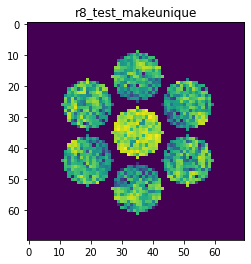

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8735791159612974
>>>replaced the 15. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 720ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 691ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000


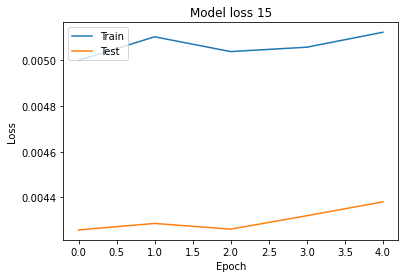

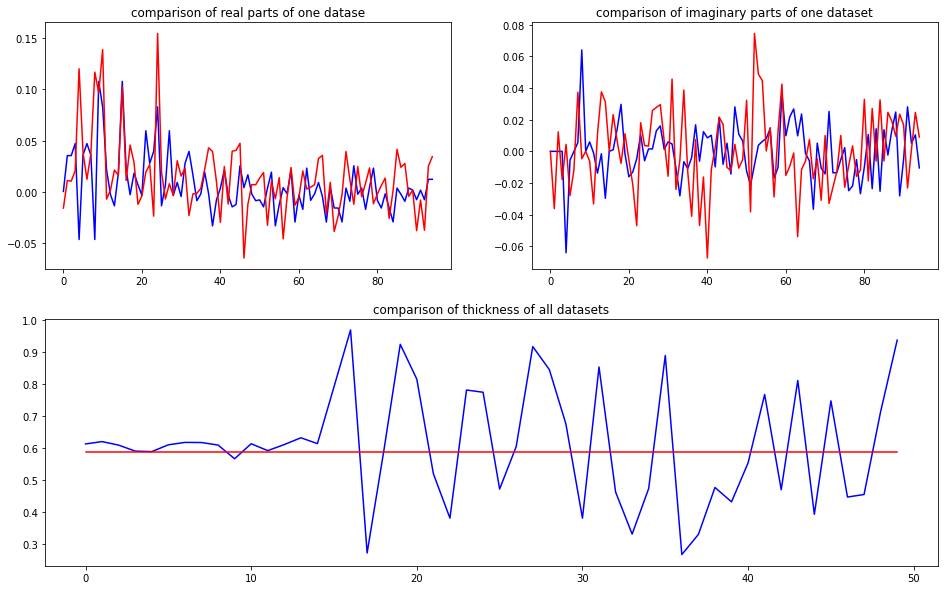

predicted thickness: 0.58928674


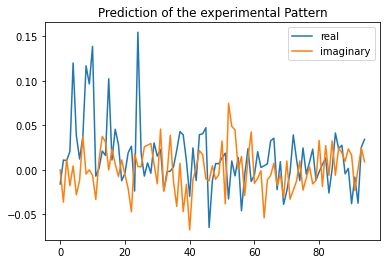

Applied shift of unit cell origin (fractional coordinates): -8.287127215830502e-07 0.02933125853483896 0.18392407522122722
Ug[ 0 ]: 0.01593 3.14159  =>  0.01593 3.14159
Ug[ 1 ]: 0.02653 -1.15563  =>  0.02653 -0.0
Ug[ 2 ]: 0.02653 1.15563  =>  0.02653 0.0
Ug[ 3 ]: 0.01661 -0.18429  =>  0.01661 0.0
Ug[ 4 ]: 0.11841 0.0386  =>  0.11841 1.37852
Ug[ 5 ]: 0.04991 -0.71361  =>  0.04991 -1.68495
Ug[ 6 ]: 0.01661 0.18429  =>  0.01661 0.0
Ug[ 7 ]: 0.04991 0.71361  =>  0.04991 1.68495
Ug[ 8 ]: 0.11841 -0.0386  =>  0.11841 -1.37852
Ug[ 9 ]: 0.09931 1e-05  =>  0.09931 0.0
Ug[ 10 ]: 0.14663 -0.03379  =>  0.14663 1.12183
Ug[ 11 ]: 0.02831 -1.50242  =>  0.02831 -2.65805
Ug[ 12 ]: 0.02377 0.09013  =>  0.02377 -0.09416
Ug[ 13 ]: 0.02656 0.7026  =>  0.02656 1.67393
Ug[ 14 ]: 0.02955 0.71526  =>  0.02955 -0.62467
Ug[ 15 ]: 0.09931 -1e-05  =>  0.09931 0.0
Ug[ 16 ]: 0.02831 1.50242  =>  0.02831 2.65805
Ug[ 17 ]: 0.02377 -0.09013  =>  0.02377 0.09416
Ug[ 18 ]: 0.02955 -0.71526  =>  0.02955 0.62467
Ug[ 19 ]: 

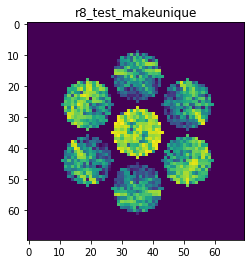

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9768356564739535
>>>replaced the 16. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 724ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0044 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 691ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0052 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000


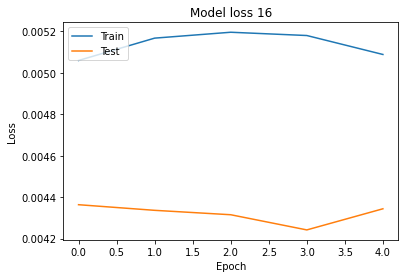

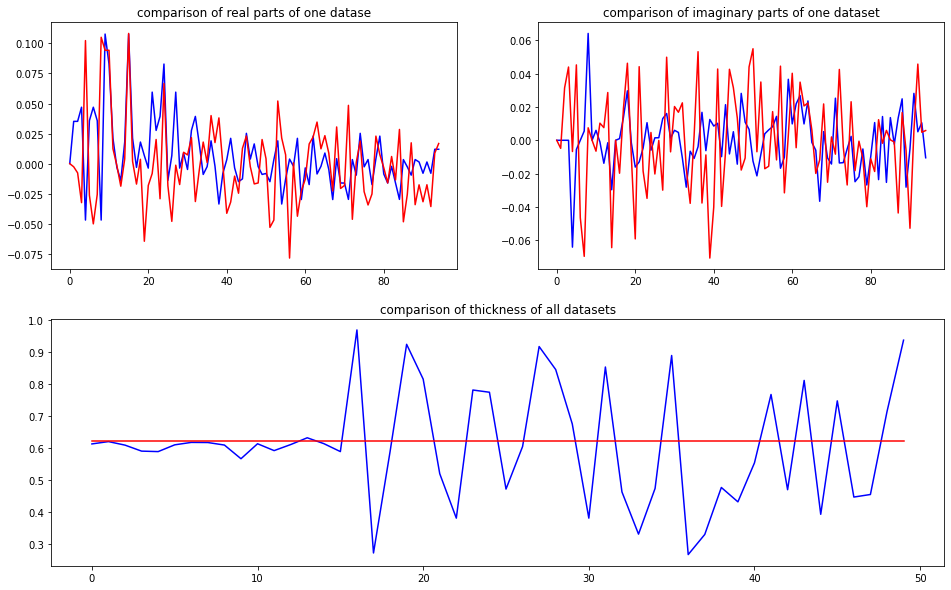

predicted thickness: 0.62147486


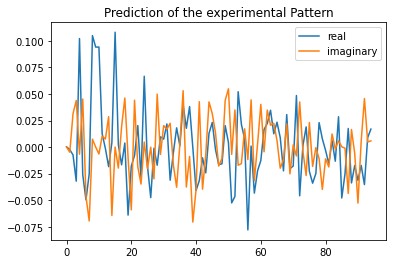

Applied shift of unit cell origin (fractional coordinates): 2.0595511761306214e-06 -0.3670499811218334 0.29197102069163916
Ug[ 0 ]: 0.00022 0.0  =>  0.00022 0.0
Ug[ 1 ]: 0.0188 -1.83451  =>  0.0188 0.0
Ug[ 2 ]: 0.0188 1.83451  =>  0.0188 -0.0
Ug[ 3 ]: 0.06095 2.30624  =>  0.06095 -0.0
Ug[ 4 ]: 0.10386 -0.06851  =>  0.10386 -0.54024
Ug[ 5 ]: 0.06286 1.99005  =>  0.06286 -2.1507
Ug[ 6 ]: 0.06095 -2.30624  =>  0.06095 0.0
Ug[ 7 ]: 0.06286 -1.99005  =>  0.06286 2.1507
Ug[ 8 ]: 0.10386 0.06851  =>  0.10386 0.54024
Ug[ 9 ]: 0.10119 -1e-05  =>  0.10119 0.0
Ug[ 10 ]: 0.08066 -0.06951  =>  0.08066 1.76501
Ug[ 11 ]: 0.01677 1.10997  =>  0.01677 -0.72453
Ug[ 12 ]: 0.01075 -2.56937  =>  0.01075 -0.26311
Ug[ 13 ]: 0.0305 2.21267  =>  0.0305 0.07025
Ug[ 14 ]: 0.05545 -1.49887  =>  0.05545 -1.02712
Ug[ 15 ]: 0.10119 1e-05  =>  0.10119 -0.0
Ug[ 16 ]: 0.01677 -1.10997  =>  0.01677 0.72453
Ug[ 17 ]: 0.01075 2.56937  =>  0.01075 0.26311
Ug[ 18 ]: 0.05545 1.49887  =>  0.05545 1.02712
Ug[ 19 ]: 0.05605 -3.

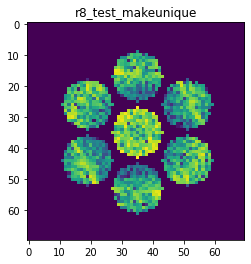

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9176996572908008
>>>replaced the 17. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0043 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 5s 691ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 690ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000


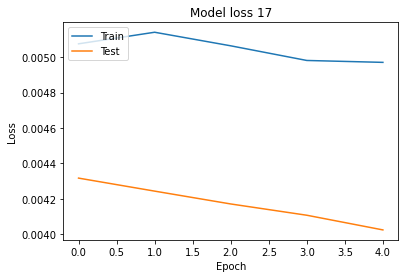

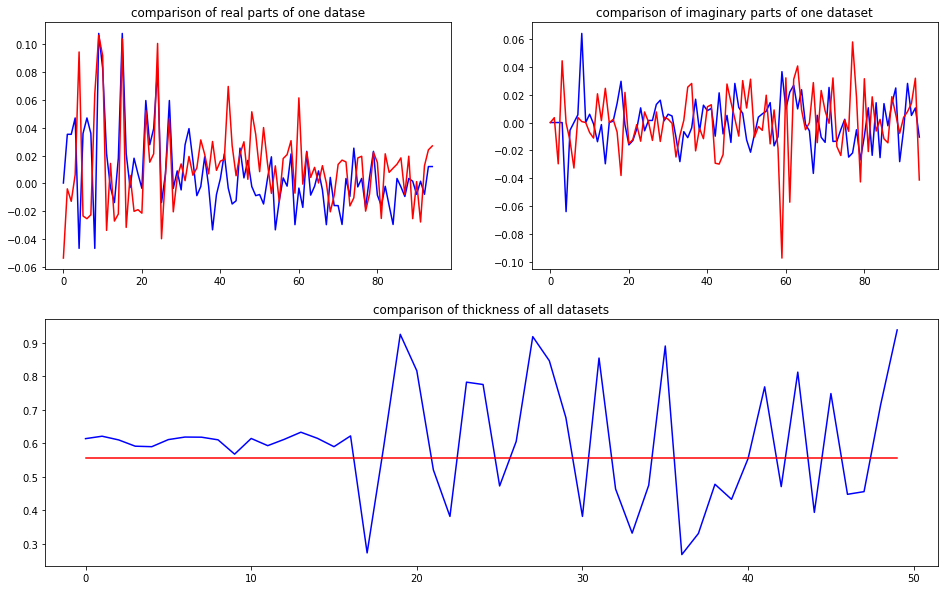

predicted thickness: 0.55631536


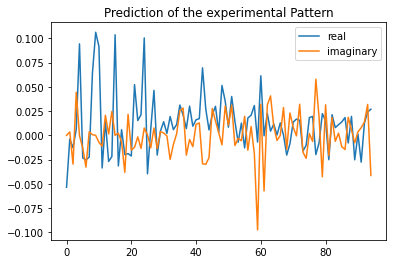

Applied shift of unit cell origin (fractional coordinates): -3.7992249640588886e-06 -0.2883468282788475 -0.32394275073763484
Ug[ 0 ]: 0.05349 3.14159  =>  0.05349 3.14159
Ug[ 1 ]: 0.01855 2.03539  =>  0.01855 -0.0
Ug[ 2 ]: 0.01855 -2.03539  =>  0.01855 0.0
Ug[ 3 ]: 0.03971 1.81174  =>  0.03971 0.0
Ug[ 4 ]: 0.07937 -0.00644  =>  0.07937 2.42962
Ug[ 5 ]: 0.02435 -2.79302  =>  0.02435 -2.56937
Ug[ 6 ]: 0.03971 -1.81174  =>  0.03971 0.0
Ug[ 7 ]: 0.02435 2.79302  =>  0.02435 2.56937
Ug[ 8 ]: 0.07937 0.00644  =>  0.07937 -2.42962
Ug[ 9 ]: 0.10502 2e-05  =>  0.10502 0.0
Ug[ 10 ]: 0.09638 -0.07683  =>  0.09638 -2.11224
Ug[ 11 ]: 0.03324 -2.93857  =>  0.03324 -0.9032
Ug[ 12 ]: 0.01705 0.93536  =>  0.01705 2.74707
Ug[ 13 ]: 0.03329 3.12716  =>  0.03329 2.90348
Ug[ 14 ]: 0.03769 2.15885  =>  0.03769 -0.27723
Ug[ 15 ]: 0.10502 -2e-05  =>  0.10502 0.0
Ug[ 16 ]: 0.03324 2.93857  =>  0.03324 0.9032
Ug[ 17 ]: 0.01705 -0.93536  =>  0.01705 -2.74707
Ug[ 18 ]: 0.03769 -2.15885  =>  0.03769 0.27723
Ug[ 19

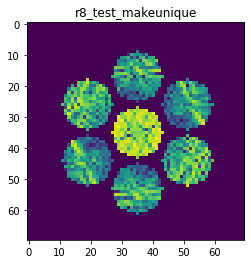

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9393678456967672
>>>replaced the 18. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 719ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 693ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 5s 690ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 5s 687ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000


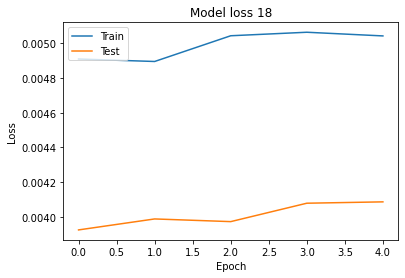

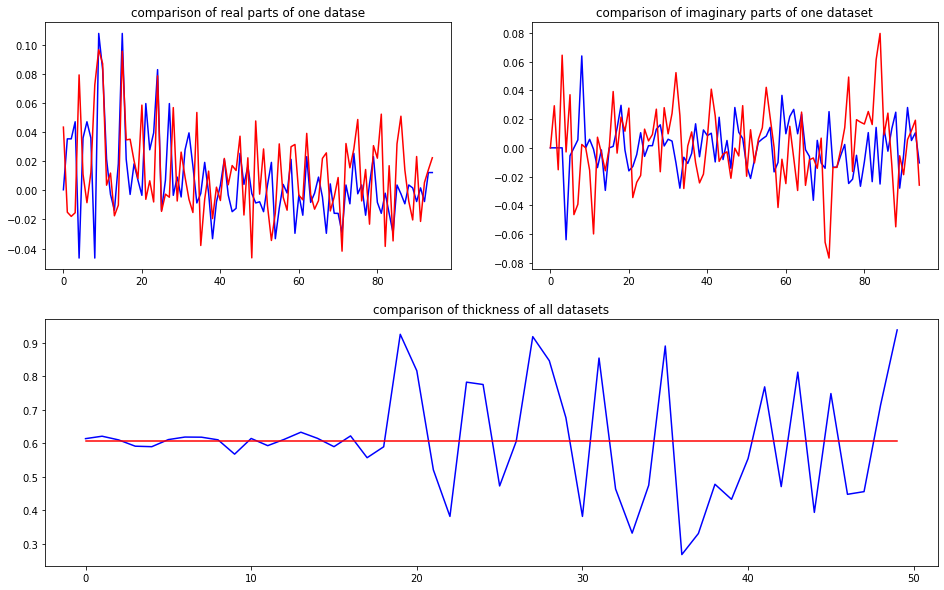

predicted thickness: 0.6050561


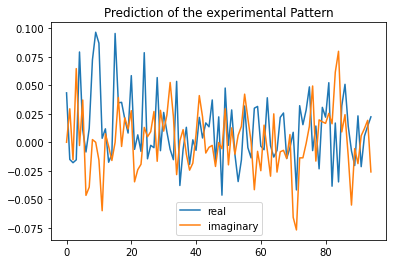

Applied shift of unit cell origin (fractional coordinates): 1.6913898079080636e-06 -0.28376362908545516 -0.3513079166309983
Ug[ 0 ]: 0.04334 0.0  =>  0.04334 0.0
Ug[ 1 ]: 0.02775 2.20733  =>  0.02775 -0.0
Ug[ 2 ]: 0.02775 -2.20733  =>  0.02775 0.0
Ug[ 3 ]: 0.05686 1.78294  =>  0.05686 0.0
Ug[ 4 ]: 0.0758 -0.03435  =>  0.0758 2.25857
Ug[ 5 ]: 0.03992 1.27708  =>  0.03992 1.70147
Ug[ 6 ]: 0.05686 -1.78294  =>  0.05686 -0.0
Ug[ 7 ]: 0.03992 -1.27708  =>  0.03992 -1.70147
Ug[ 8 ]: 0.0758 0.03435  =>  0.0758 -2.25857
Ug[ 9 ]: 0.09596 -1e-05  =>  0.09596 0.0
Ug[ 10 ]: 0.08398 -0.17167  =>  0.08398 -2.37899
Ug[ 11 ]: 0.05318 -1.20456  =>  0.05318 1.00278
Ug[ 12 ]: 0.02405 0.23247  =>  0.02405 2.01542
Ug[ 13 ]: 0.01655 -2.88471  =>  0.01655 2.97409
Ug[ 14 ]: 0.01937 -1.30768  =>  0.01937 2.6826
Ug[ 15 ]: 0.09596 1e-05  =>  0.09596 0.0
Ug[ 16 ]: 0.05318 1.20456  =>  0.05318 -1.00278
Ug[ 17 ]: 0.02405 -0.23247  =>  0.02405 -2.01542
Ug[ 18 ]: 0.01937 1.30768  =>  0.01937 -2.6826
Ug[ 19 ]: 0.00294

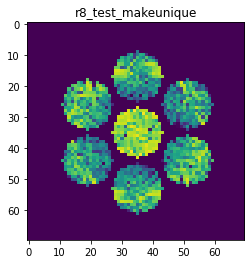

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.956239075228043
>>>replaced the 19. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 693ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 693ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000


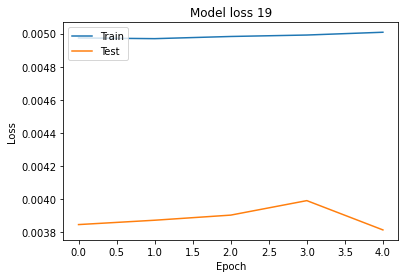

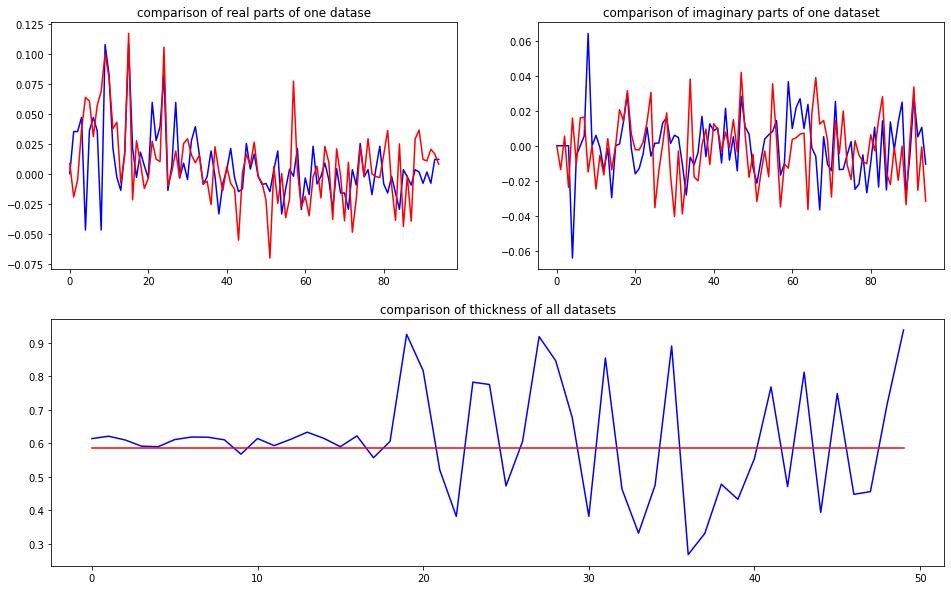

predicted thickness: 0.58590585


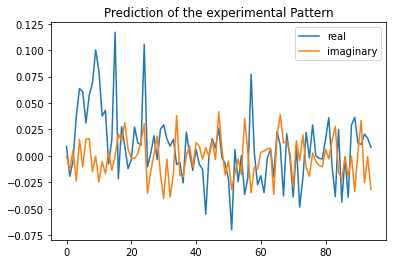

Applied shift of unit cell origin (fractional coordinates): 2.7671994745609475e-06 0.08382303626338673 0.3935763729520682
Ug[ 0 ]: 0.00881 0.0  =>  0.00881 0.0
Ug[ 1 ]: 0.01538 -2.47291  =>  0.01538 0.0
Ug[ 2 ]: 0.01538 2.47291  =>  0.01538 -0.0
Ug[ 3 ]: 0.03952 -0.52668  =>  0.03952 0.0
Ug[ 4 ]: 0.06802 0.22802  =>  0.06802 -3.05558
Ug[ 5 ]: 0.06041 -0.22096  =>  0.06041 -2.16719
Ug[ 6 ]: 0.03952 0.52668  =>  0.03952 0.0
Ug[ 7 ]: 0.06041 0.22096  =>  0.06041 2.16719
Ug[ 8 ]: 0.06802 -0.22802  =>  0.06802 3.05558
Ug[ 9 ]: 0.10858 -2e-05  =>  0.10858 -0.0
Ug[ 10 ]: 0.09681 -0.28848  =>  0.09681 2.18445
Ug[ 11 ]: 0.0153 -1.01569  =>  0.0153 2.7946
Ug[ 12 ]: 0.03856 -0.41198  =>  0.03856 -0.93863
Ug[ 13 ]: 0.02157 1.99185  =>  0.02157 -2.34508
Ug[ 14 ]: 0.02578 -1.06819  =>  0.02578 2.21543
Ug[ 15 ]: 0.10858 2e-05  =>  0.10858 0.0
Ug[ 16 ]: 0.0153 1.01569  =>  0.0153 -2.7946
Ug[ 17 ]: 0.03856 0.41198  =>  0.03856 0.93863
Ug[ 18 ]: 0.02578 1.06819  =>  0.02578 -2.21543
Ug[ 19 ]: 0.01172 2.

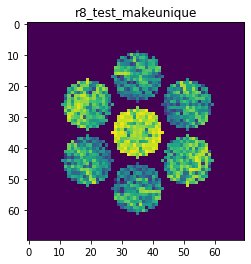

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9354077884790305
>>>replaced the 20. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 700ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 701ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0042 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 702ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000


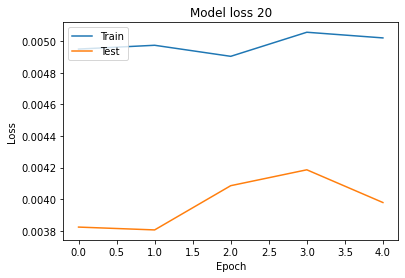

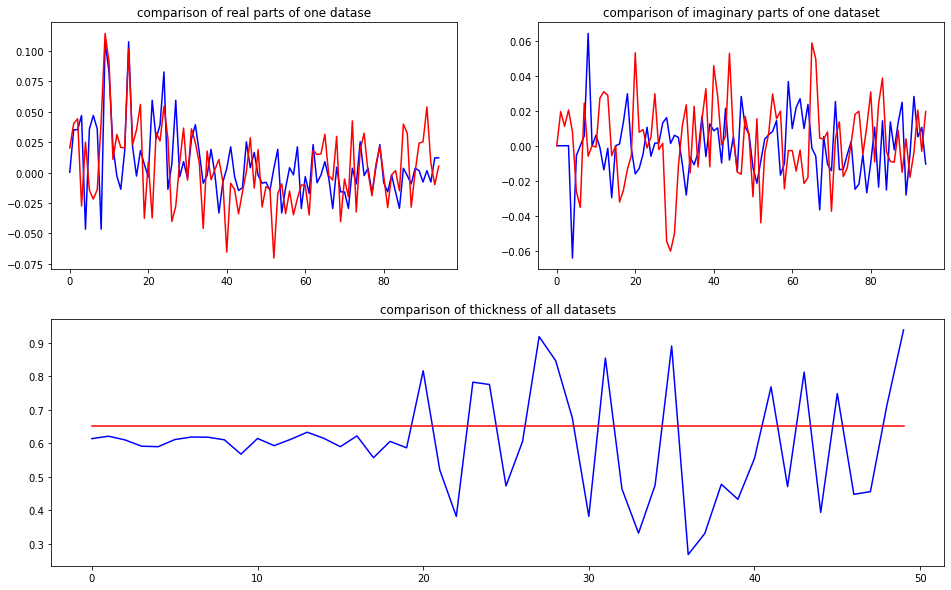

predicted thickness: 0.64970624


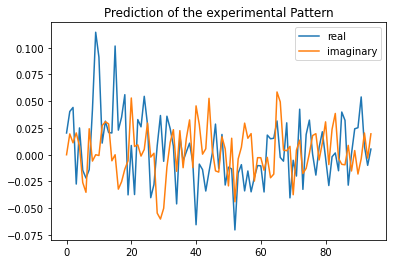

Applied shift of unit cell origin (fractional coordinates): -4.177507662800039e-07 -0.36537894949987687 -0.015569576612070542
Ug[ 0 ]: 0.02032 0.0  =>  0.02032 0.0
Ug[ 1 ]: 0.04251 0.09783  =>  0.04251 0.0
Ug[ 2 ]: 0.04251 -0.09783  =>  0.04251 0.0
Ug[ 3 ]: 0.03708 2.29574  =>  0.03708 0.0
Ug[ 4 ]: 0.03433 0.20348  =>  0.03433 -2.19009
Ug[ 5 ]: 0.02892 -2.08593  =>  0.02892 1.99934
Ug[ 6 ]: 0.03708 -2.29574  =>  0.03708 -0.0
Ug[ 7 ]: 0.02892 2.08593  =>  0.02892 -1.99934
Ug[ 8 ]: 0.03433 -0.20348  =>  0.03433 2.19009
Ug[ 9 ]: 0.10806 0.0  =>  0.10806 0.0
Ug[ 10 ]: 0.07299 -0.03888  =>  0.07299 -0.13671
Ug[ 11 ]: 0.03418 1.05255  =>  0.03418 1.15038
Ug[ 12 ]: 0.04348 0.70045  =>  0.04348 2.99619
Ug[ 13 ]: 0.02453 -0.01731  =>  0.02453 2.18061
Ug[ 14 ]: 0.03845 0.10156  =>  0.03845 2.49513
Ug[ 15 ]: 0.10806 -0.0  =>  0.10806 0.0
Ug[ 16 ]: 0.03418 -1.05255  =>  0.03418 -1.15038
Ug[ 17 ]: 0.04348 -0.70045  =>  0.04348 -2.99619
Ug[ 18 ]: 0.03845 -0.10156  =>  0.03845 -2.49513
Ug[ 19 ]: 0.03

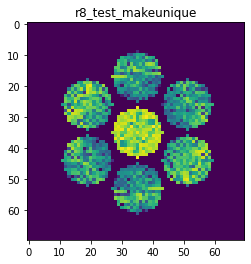

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9709194458212032
>>>replaced the 21. dataset and train: 
Epoch 1/5
8/8 [==============================] - 8s 897ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0040 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000


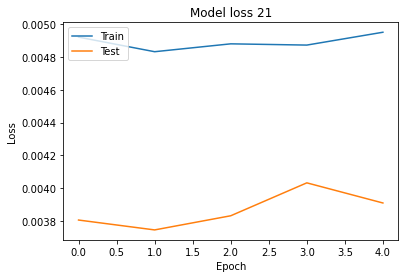

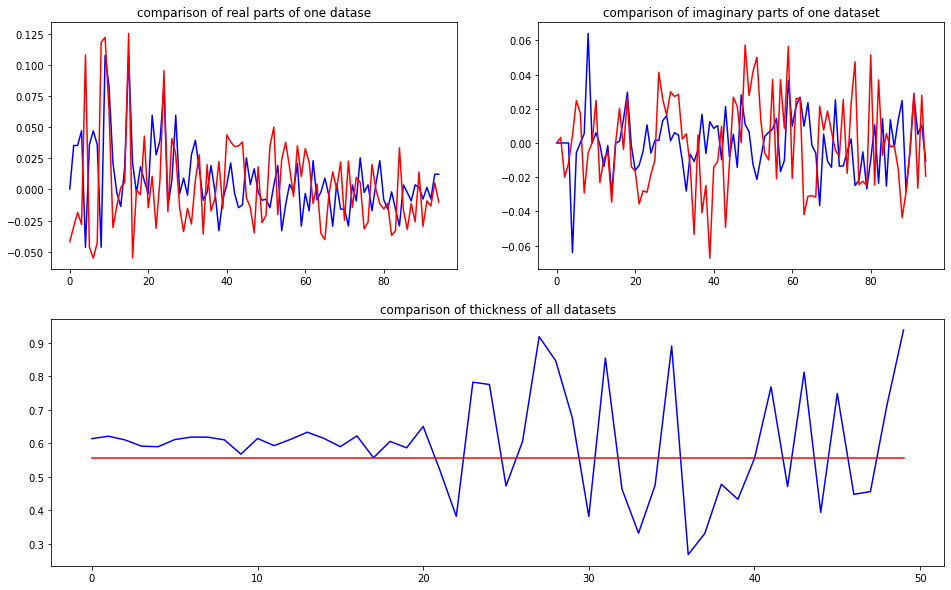

predicted thickness: 0.55659294


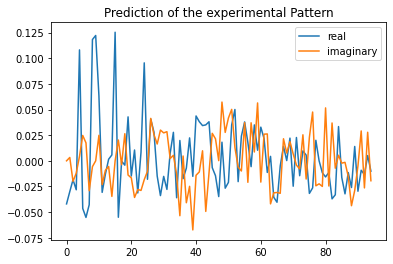

Applied shift of unit cell origin (fractional coordinates): -4.381825897381464e-07 0.44593725521373395 -0.42866056954029713
Ug[ 0 ]: 0.04196 3.14159  =>  0.04196 3.14159
Ug[ 1 ]: 0.02687 2.69335  =>  0.02687 0.0
Ug[ 2 ]: 0.02687 -2.69335  =>  0.02687 -0.0
Ug[ 3 ]: 0.04421 -2.80191  =>  0.04421 -0.0
Ug[ 4 ]: 0.11324 0.04445  =>  0.11324 0.153
Ug[ 5 ]: 0.0521 2.59796  =>  0.0521 1.81004
Ug[ 6 ]: 0.04421 2.80191  =>  0.04421 0.0
Ug[ 7 ]: 0.0521 -2.59796  =>  0.0521 -1.81004
Ug[ 8 ]: 0.11324 -0.04445  =>  0.11324 -0.153
Ug[ 9 ]: 0.1237 0.0  =>  0.1237 0.0
Ug[ 10 ]: 0.08231 0.26523  =>  0.08231 -2.42813
Ug[ 11 ]: 0.04806 -2.67237  =>  0.04806 0.02099
Ug[ 12 ]: 0.00717 -2.74835  =>  0.00717 0.73292
Ug[ 13 ]: 0.00855 2.86328  =>  0.00855 -2.63198
Ug[ 14 ]: 0.03055 -1.54641  =>  0.03055 -1.65496
Ug[ 15 ]: 0.1237 -0.0  =>  0.1237 0.0
Ug[ 16 ]: 0.04806 2.67237  =>  0.04806 -0.02099
Ug[ 17 ]: 0.00717 2.74835  =>  0.00717 -0.73292
Ug[ 18 ]: 0.03055 1.54641  =>  0.03055 1.65496
Ug[ 19 ]: 0.05009 -0

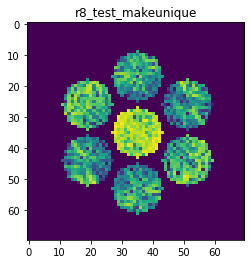

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9381997529728622
>>>replaced the 22. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 5s 689ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0039 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 693ms/step - loss: 0.0051 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000


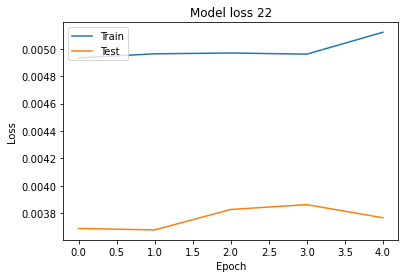

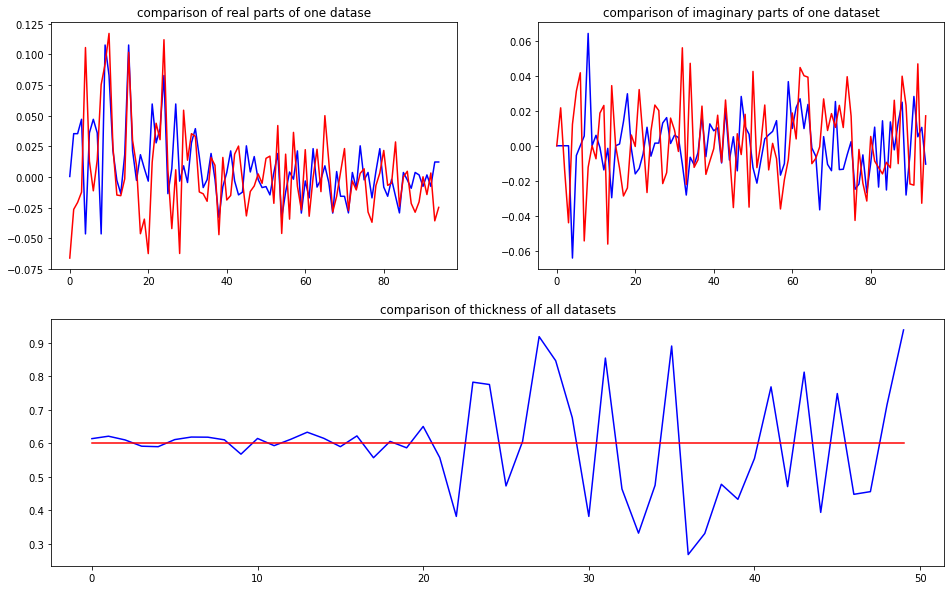

predicted thickness: 0.6003117


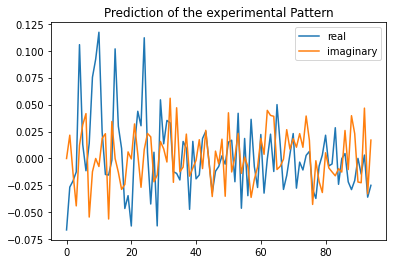

Applied shift of unit cell origin (fractional coordinates): 2.8747072781755833e-06 0.2931534427161945 -0.39798861704261157
Ug[ 0 ]: 0.06625 3.14159  =>  0.06625 3.14159
Ug[ 1 ]: 0.02954 2.50064  =>  0.02954 0.0
Ug[ 2 ]: 0.02954 -2.50064  =>  0.02954 -0.0
Ug[ 3 ]: 0.04442 -1.84194  =>  0.04442 0.0
Ug[ 4 ]: 0.09129 0.13493  =>  0.09129 -0.52377
Ug[ 5 ]: 0.04482 1.26628  =>  0.04482 -0.67433
Ug[ 6 ]: 0.04442 1.84194  =>  0.04442 -0.0
Ug[ 7 ]: 0.04482 -1.26628  =>  0.04482 0.67433
Ug[ 8 ]: 0.09129 -0.13493  =>  0.09129 0.52377
Ug[ 9 ]: 0.0969 -2e-05  =>  0.0969 -0.0
Ug[ 10 ]: 0.11482 -0.06885  =>  0.11482 -2.56947
Ug[ 11 ]: 0.03132 0.52532  =>  0.03132 3.02597
Ug[ 12 ]: 0.02597 1.67727  =>  0.02597 -0.16465
Ug[ 13 ]: 0.03996 -1.69121  =>  0.03996 0.24942
Ug[ 14 ]: 0.03778 2.25842  =>  0.03778 2.91714
Ug[ 15 ]: 0.0969 2e-05  =>  0.0969 0.0
Ug[ 16 ]: 0.03132 -0.52532  =>  0.03132 -3.02597
Ug[ 17 ]: 0.02597 -1.67727  =>  0.02597 0.16465
Ug[ 18 ]: 0.03778 -2.25842  =>  0.03778 -2.91714
Ug[ 19 

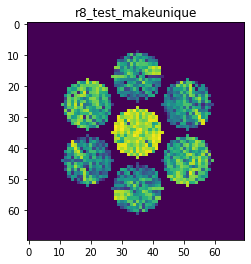

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9592232686736085
>>>replaced the 23. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 702ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 5s 687ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000


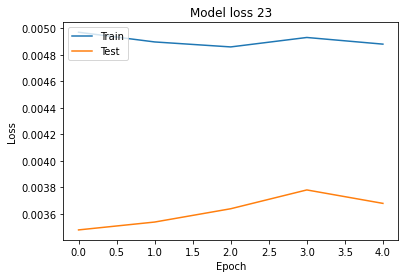

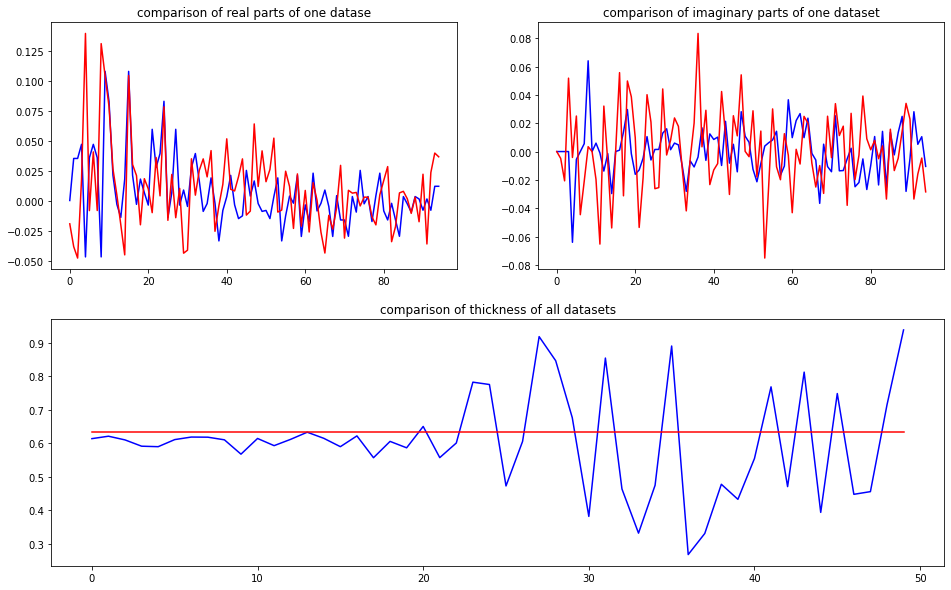

predicted thickness: 0.6337388


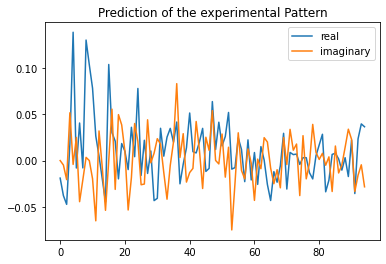

Applied shift of unit cell origin (fractional coordinates): -8.171382368057762e-07 -0.1629439028269238 -0.47084337219355005
Ug[ 0 ]: 0.01904 3.14159  =>  0.01904 3.14159
Ug[ 1 ]: 0.04348 2.9584  =>  0.04348 0.0
Ug[ 2 ]: 0.04348 -2.9584  =>  0.04348 -0.0
Ug[ 3 ]: 0.05646 1.02381  =>  0.05646 0.0
Ug[ 4 ]: 0.13501 -0.0282  =>  0.13501 2.27278
Ug[ 5 ]: 0.02437 1.90626  =>  0.02437 -2.44234
Ug[ 6 ]: 0.05646 -1.02381  =>  0.05646 0.0
Ug[ 7 ]: 0.02437 -1.90626  =>  0.02437 2.44234
Ug[ 8 ]: 0.13501 0.0282  =>  0.13501 -2.27278
Ug[ 9 ]: 0.10404 1e-05  =>  0.10404 0.0
Ug[ 10 ]: 0.08094 -0.25331  =>  0.08094 3.07147
Ug[ 11 ]: 0.06692 -1.13115  =>  0.06692 1.82724
Ug[ 12 ]: 0.03424 1.18238  =>  0.03424 2.20619
Ug[ 13 ]: 0.02028 2.65701  =>  0.02028 0.72242
Ug[ 14 ]: 0.06116 -2.12809  =>  0.06116 1.85411
Ug[ 15 ]: 0.10404 -1e-05  =>  0.10404 0.0
Ug[ 16 ]: 0.06692 1.13115  =>  0.06692 -1.82724
Ug[ 17 ]: 0.03424 -1.18238  =>  0.03424 -2.20619
Ug[ 18 ]: 0.06116 2.12809  =>  0.06116 -1.85411
Ug[ 19 ]: 

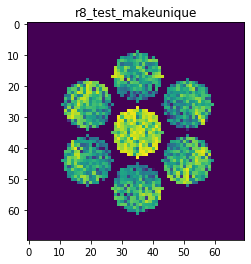

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8669231126648248
>>>replaced the 24. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 5s 691ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 5s 693ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 5s 687ms/step - loss: 0.0050 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 1.0000


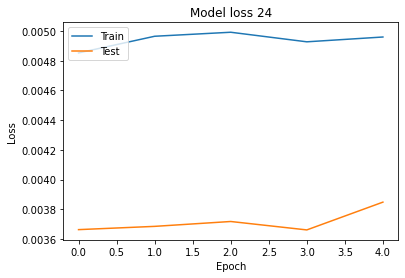

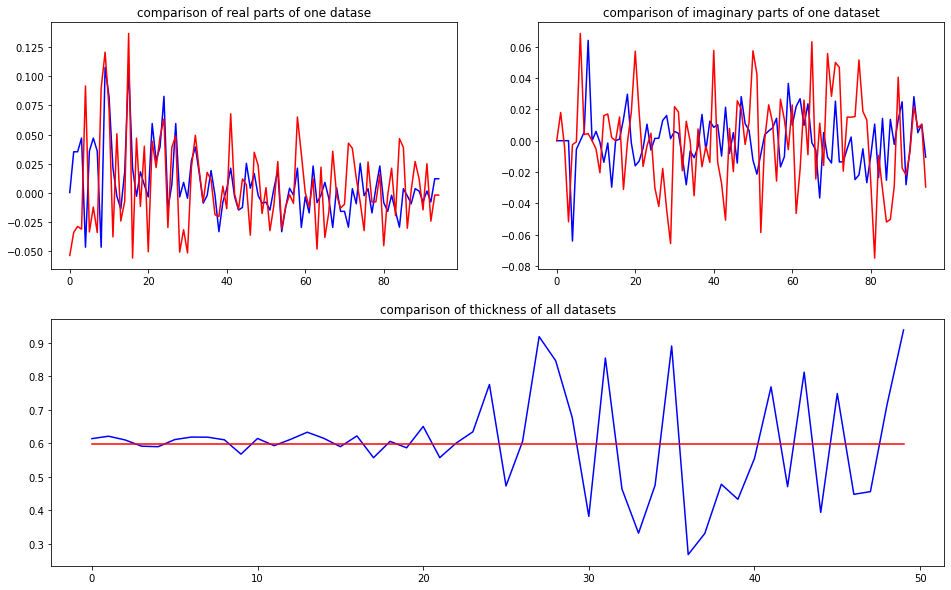

predicted thickness: 0.5975472


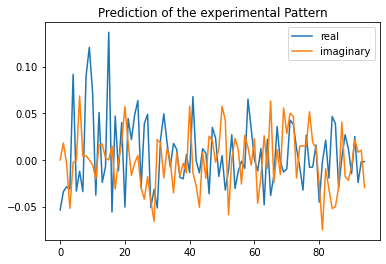

Applied shift of unit cell origin (fractional coordinates): -4.977411129018577e-07 0.3048794065331727 -0.4454190191501113
Ug[ 0 ]: 0.05361 3.14159  =>  0.05361 3.14159
Ug[ 1 ]: 0.0332 2.79865  =>  0.0332 0.0
Ug[ 2 ]: 0.0332 -2.79865  =>  0.0332 -0.0
Ug[ 3 ]: 0.06391 -1.91561  =>  0.06391 -0.0
Ug[ 4 ]: 0.09087 -0.0388  =>  0.09087 -0.92183
Ug[ 5 ]: 0.03377 -3.07179  =>  0.03377 1.64247
Ug[ 6 ]: 0.06391 1.91561  =>  0.06391 0.0
Ug[ 7 ]: 0.03377 3.07179  =>  0.03377 -1.64247
Ug[ 8 ]: 0.09087 0.0388  =>  0.09087 0.92183
Ug[ 9 ]: 0.12874 0.0  =>  0.12874 0.0
Ug[ 10 ]: 0.06837 -0.07255  =>  0.06837 -2.8712
Ug[ 11 ]: 0.05005 -2.77769  =>  0.05005 0.02096
Ug[ 12 ]: 0.05424 0.44942  =>  0.05424 -1.4662
Ug[ 13 ]: 0.03578 2.42084  =>  0.03578 -2.29343
Ug[ 14 ]: 0.00951 2.97058  =>  0.00951 -2.42957
Ug[ 15 ]: 0.12874 -0.0  =>  0.12874 -0.0
Ug[ 16 ]: 0.05005 2.77769  =>  0.05005 -0.02096
Ug[ 17 ]: 0.05424 -0.44942  =>  0.05424 1.4662
Ug[ 18 ]: 0.00951 -2.97058  =>  0.00951 2.42957
Ug[ 19 ]: 0.04978

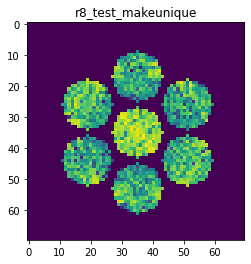

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8348214373547475
>>>replaced the 25. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 771ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 703ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 704ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0037 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 702ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000


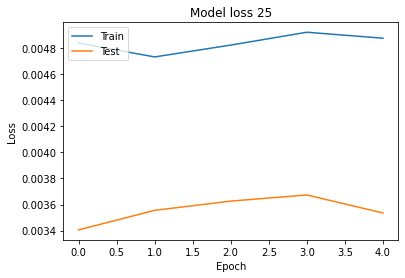

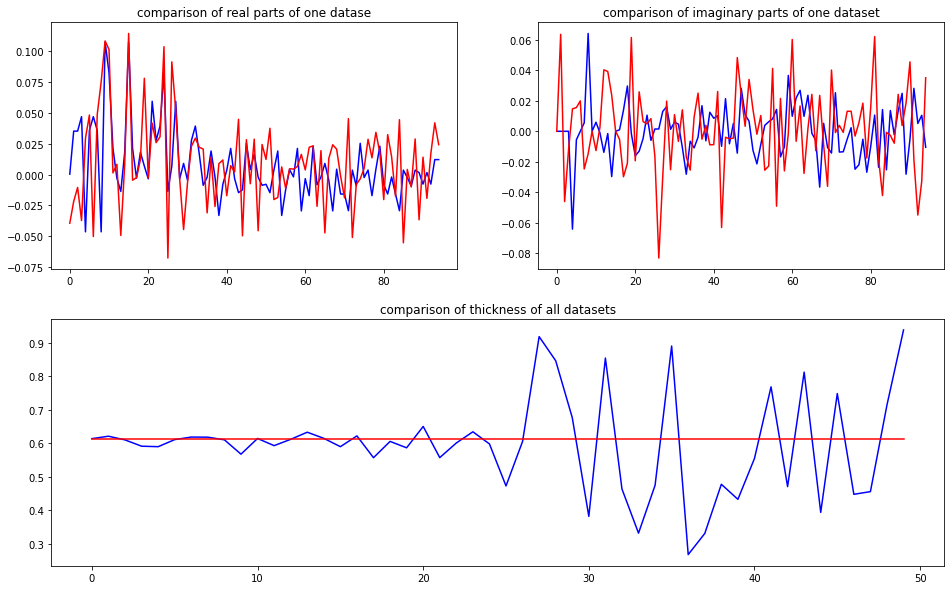

predicted thickness: 0.61185557


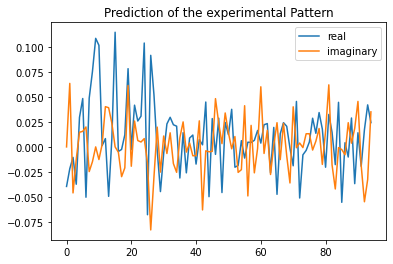

Applied shift of unit cell origin (fractional coordinates): 1.187742951313293e-06 0.44396180055968104 -0.2956328587213074
Ug[ 0 ]: 0.03955 3.14159  =>  0.03955 3.14159
Ug[ 1 ]: 0.05709 1.85752  =>  0.05709 -0.0
Ug[ 2 ]: 0.05709 -1.85752  =>  0.05709 0.0
Ug[ 3 ]: 0.0467 -2.78949  =>  0.0467 0.0
Ug[ 4 ]: 0.05446 0.27354  =>  0.05446 1.20552
Ug[ 5 ]: 0.0526 0.39242  =>  0.0526 -1.24376
Ug[ 6 ]: 0.0467 2.78949  =>  0.0467 -0.0
Ug[ 7 ]: 0.0526 -0.39242  =>  0.0526 1.24376
Ug[ 8 ]: 0.05446 -0.27354  =>  0.05446 -1.20552
Ug[ 9 ]: 0.11161 -1e-05  =>  0.11161 -0.0
Ug[ 10 ]: 0.10327 -0.10147  =>  0.10327 -1.95898
Ug[ 11 ]: 0.00421 1.96187  =>  0.00421 -2.4638
Ug[ 12 ]: 0.03512 1.48828  =>  0.03512 -1.30121
Ug[ 13 ]: 0.06487 2.70021  =>  0.06487 -1.94679
Ug[ 14 ]: 0.02457 1.13682  =>  0.02457 0.20485
Ug[ 15 ]: 0.11161 1e-05  =>  0.11161 0.0
Ug[ 16 ]: 0.00421 -1.96187  =>  0.00421 2.4638
Ug[ 17 ]: 0.03512 -1.48828  =>  0.03512 1.30121
Ug[ 18 ]: 0.02457 -1.13682  =>  0.02457 -0.20485
Ug[ 19 ]: 0.11

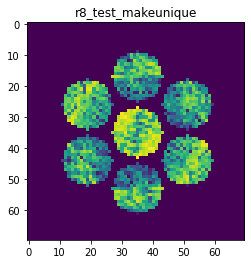

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9220419592462106
>>>replaced the 26. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 693ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 691ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000


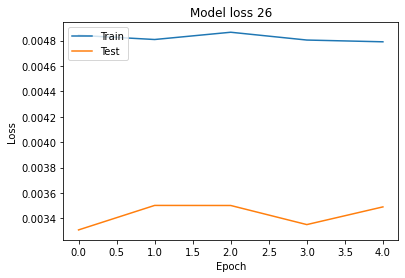

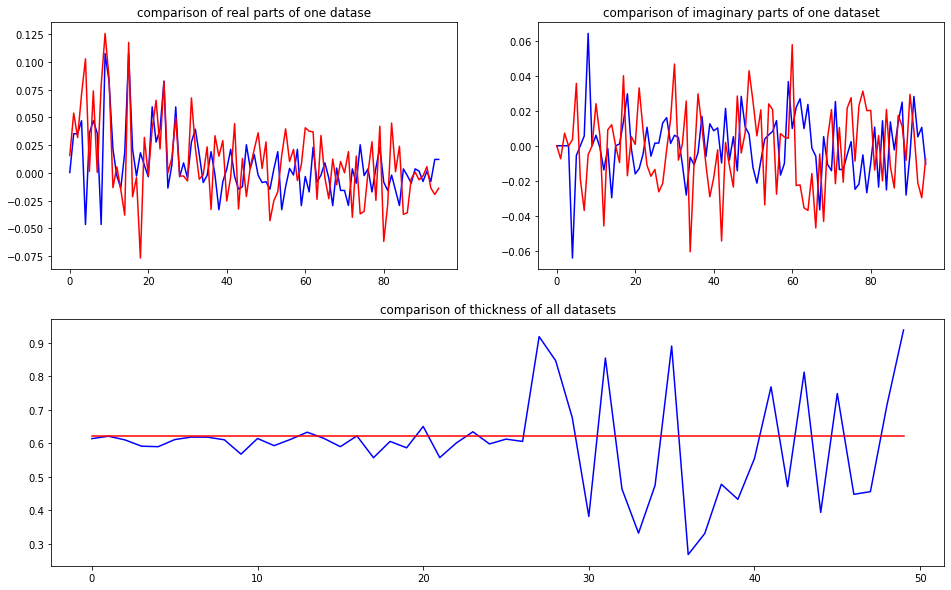

predicted thickness: 0.6202417


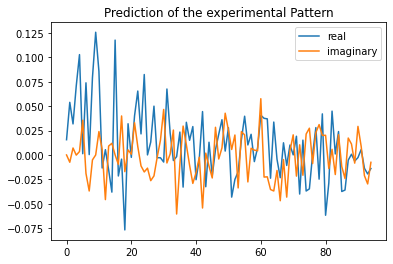

Applied shift of unit cell origin (fractional coordinates): 1.0914496326347359e-06 -0.020548269064595778 0.02685128466739096
Ug[ 0 ]: 0.01563 0.0  =>  0.01563 0.0
Ug[ 1 ]: 0.04348 -0.16871  =>  0.04348 0.0
Ug[ 2 ]: 0.04348 0.16871  =>  0.04348 -0.0
Ug[ 3 ]: 0.07299 0.12911  =>  0.07299 0.0
Ug[ 4 ]: 0.09107 0.04716  =>  0.09107 0.08676
Ug[ 5 ]: 0.03625 1.54795  =>  0.03625 1.25013
Ug[ 6 ]: 0.07299 -0.12911  =>  0.07299 0.0
Ug[ 7 ]: 0.03625 -1.54795  =>  0.03625 -1.25013
Ug[ 8 ]: 0.09107 -0.04716  =>  0.09107 -0.08676
Ug[ 9 ]: 0.12172 -1e-05  =>  0.12172 0.0
Ug[ 10 ]: 0.08657 0.24146  =>  0.08657 0.41017
Ug[ 11 ]: 0.01901 2.73032  =>  0.01901 2.56162
Ug[ 12 ]: 0.04286 -1.55726  =>  0.04286 -1.42814
Ug[ 13 ]: 0.01361 2.16003  =>  0.01361 2.45786
Ug[ 14 ]: 0.05924 2.89371  =>  0.05924 2.85412
Ug[ 15 ]: 0.12172 1e-05  =>  0.12172 0.0
Ug[ 16 ]: 0.01901 -2.73032  =>  0.01901 -2.56162
Ug[ 17 ]: 0.04286 1.55726  =>  0.04286 1.42814
Ug[ 18 ]: 0.05924 -2.89371  =>  0.05924 -2.85412
Ug[ 19 ]: 0.02

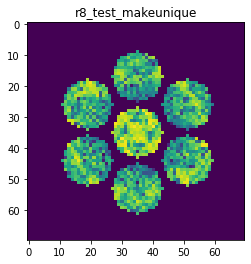

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8057365186406505
>>>replaced the 27. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 719ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0049 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000


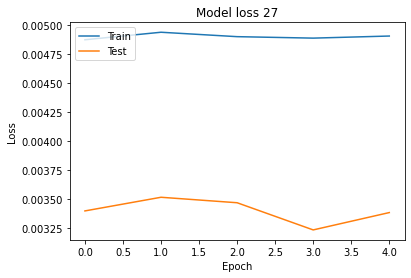

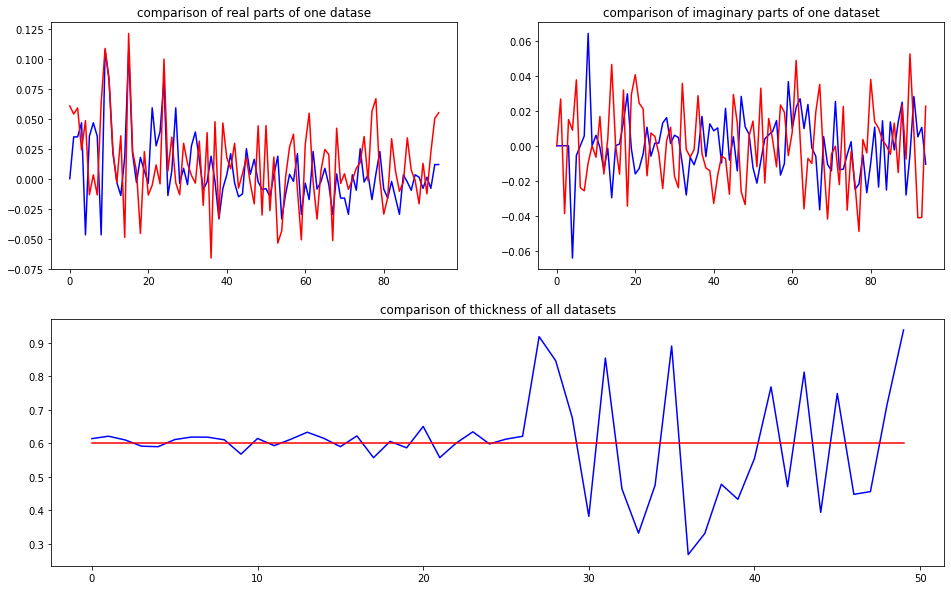

predicted thickness: 0.5998462


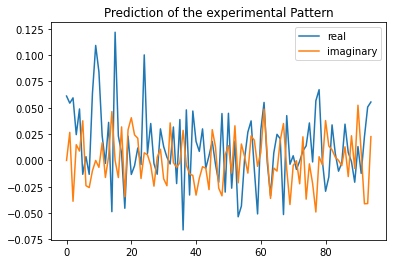

Applied shift of unit cell origin (fractional coordinates): -5.993394447611745e-07 -0.15049899139075654 -0.08301543424996567
Ug[ 0 ]: 0.06111 0.0  =>  0.06111 0.0
Ug[ 1 ]: 0.06561 0.5216  =>  0.06561 0.0
Ug[ 2 ]: 0.06561 -0.5216  =>  0.06561 0.0
Ug[ 3 ]: 0.02398 0.94561  =>  0.02398 0.0
Ug[ 4 ]: 0.05707 0.16425  =>  0.05707 -1.30297
Ug[ 5 ]: 0.03429 1.96491  =>  0.03429 1.5409
Ug[ 6 ]: 0.02398 -0.94561  =>  0.02398 0.0
Ug[ 7 ]: 0.03429 -1.96491  =>  0.03429 -1.5409
Ug[ 8 ]: 0.05707 -0.16425  =>  0.05707 1.30297
Ug[ 9 ]: 0.1154 0.0  =>  0.1154 0.0
Ug[ 10 ]: 0.09236 -0.07476  =>  0.09236 -0.59636
Ug[ 11 ]: 0.02857 0.61473  =>  0.02857 1.13633
Ug[ 12 ]: 0.02407 -1.48836  =>  0.02407 -0.54275
Ug[ 13 ]: 0.02144 -0.03188  =>  0.02144 0.39213
Ug[ 14 ]: 0.06198 2.43126  =>  0.06198 -2.38472
Ug[ 15 ]: 0.1154 -0.0  =>  0.1154 -0.0
Ug[ 16 ]: 0.02857 -0.61473  =>  0.02857 -1.13633
Ug[ 17 ]: 0.02407 1.48836  =>  0.02407 0.54275
Ug[ 18 ]: 0.06198 -2.43126  =>  0.06198 2.38472
Ug[ 19 ]: 0.03357 0.524

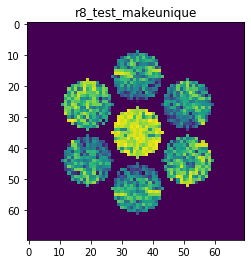

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8943259971090056
>>>replaced the 28. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 726ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 703ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000


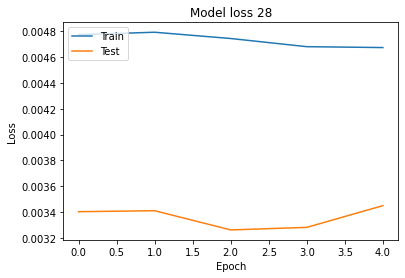

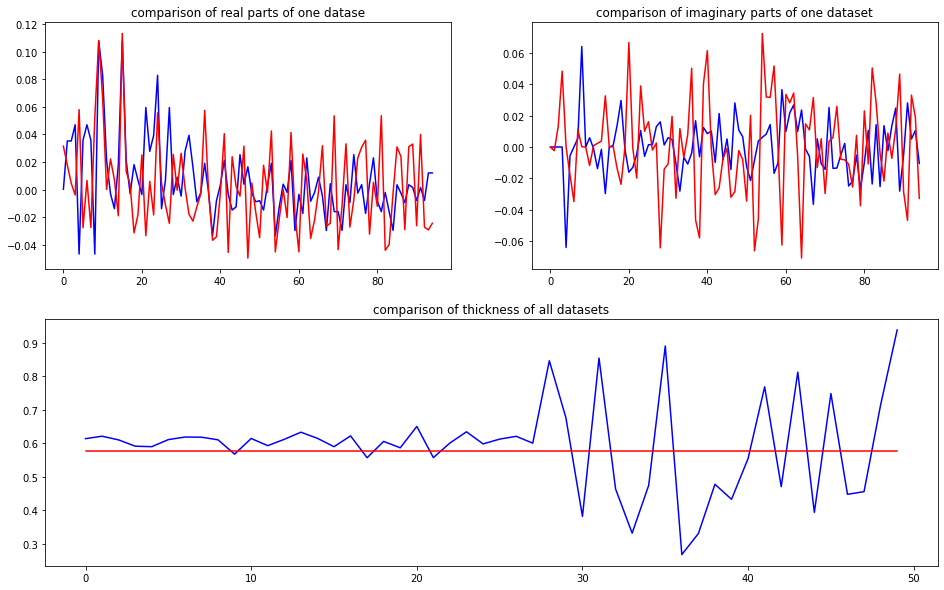

predicted thickness: 0.5759828


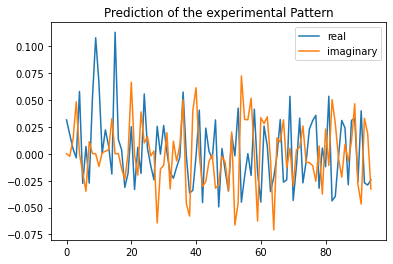

Applied shift of unit cell origin (fractional coordinates): -1.370811747624463e-06 -0.24429081586197274 0.09608125497844024
Ug[ 0 ]: 0.03152 0.0  =>  0.03152 0.0
Ug[ 1 ]: 0.01368 -0.6037  =>  0.01368 0.0
Ug[ 2 ]: 0.01368 0.6037  =>  0.01368 -0.0
Ug[ 3 ]: 0.04164 1.53492  =>  0.04164 -0.0
Ug[ 4 ]: 0.05504 -0.00223  =>  0.05504 -0.93345
Ug[ 5 ]: 0.03102 -2.65401  =>  0.03102 1.49055
Ug[ 6 ]: 0.04164 -1.53492  =>  0.04164 0.0
Ug[ 7 ]: 0.03102 2.65401  =>  0.03102 -1.49055
Ug[ 8 ]: 0.05504 0.00223  =>  0.05504 0.93345
Ug[ 9 ]: 0.11054 1e-05  =>  0.11054 -0.0
Ug[ 10 ]: 0.06195 -0.17741  =>  0.06195 0.42628
Ug[ 11 ]: 0.00683 0.04221  =>  0.00683 -0.5615
Ug[ 12 ]: 0.0153 0.55038  =>  0.0153 2.08529
Ug[ 13 ]: 0.00868 -0.79227  =>  0.00868 1.34634
Ug[ 14 ]: 0.03771 2.29703  =>  0.03771 -3.05494
Ug[ 15 ]: 0.11054 -1e-05  =>  0.11054 0.0
Ug[ 16 ]: 0.00683 -0.04221  =>  0.00683 0.5615
Ug[ 17 ]: 0.0153 -0.55038  =>  0.0153 -2.08529
Ug[ 18 ]: 0.03771 -2.29703  =>  0.03771 3.05494
Ug[ 19 ]: 0.01453 3

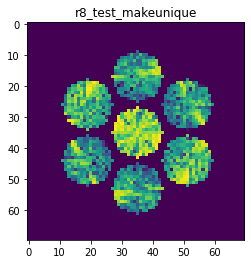

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8724482876714277
>>>replaced the 29. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 720ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 695ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 703ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 700ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000


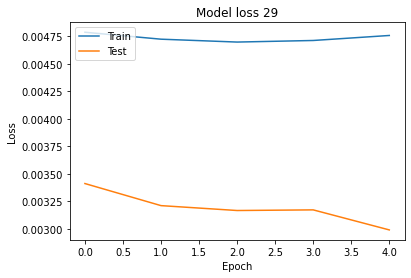

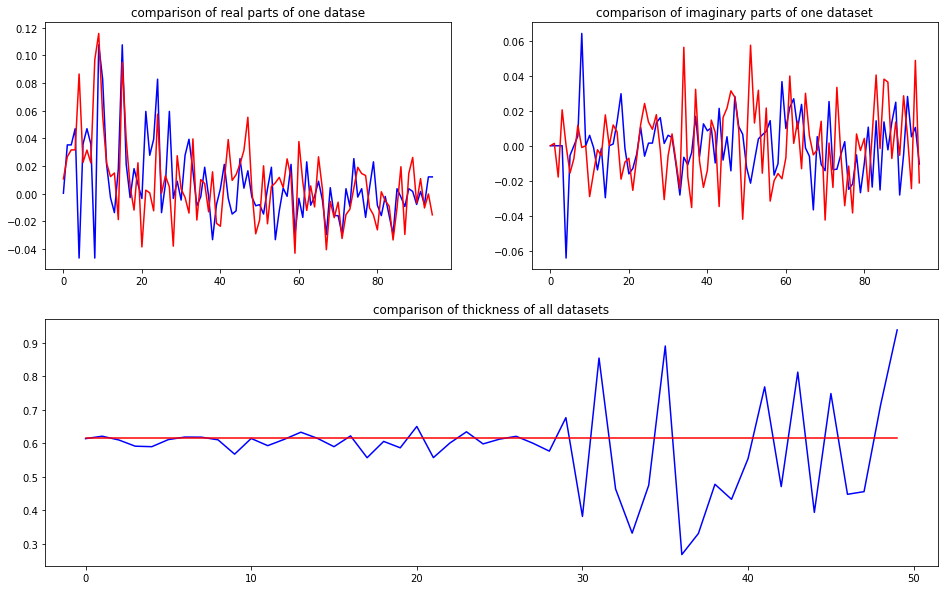

predicted thickness: 0.6162374


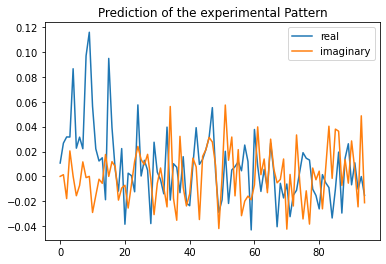

Applied shift of unit cell origin (fractional coordinates): 1.0809926497815256e-06 -0.06584795520651816 -0.05058448824353816
Ug[ 0 ]: 0.01072 0.0  =>  0.01072 0.0
Ug[ 1 ]: 0.03075 0.31783  =>  0.03075 0.0
Ug[ 2 ]: 0.03075 -0.31783  =>  0.03075 0.0
Ug[ 3 ]: 0.03452 0.41373  =>  0.03452 0.0
Ug[ 4 ]: 0.09174 0.00596  =>  0.09174 -0.7256
Ug[ 5 ]: 0.02626 -0.54462  =>  0.02626 -0.64052
Ug[ 6 ]: 0.03452 -0.41373  =>  0.03452 -0.0
Ug[ 7 ]: 0.02626 0.54462  =>  0.02626 0.64052
Ug[ 8 ]: 0.09174 -0.00596  =>  0.09174 0.7256
Ug[ 9 ]: 0.10538 -1e-05  =>  0.10538 0.0
Ug[ 10 ]: 0.06281 -0.43656  =>  0.06281 -0.75438
Ug[ 11 ]: 0.0337 -0.41673  =>  0.0337 -0.09889
Ug[ 12 ]: 0.01016 -0.5242  =>  0.01016 -0.11046
Ug[ 13 ]: 0.01224 -0.8967  =>  0.01224 -0.80079
Ug[ 14 ]: 0.02389 2.26662  =>  0.02389 2.99819
Ug[ 15 ]: 0.10538 1e-05  =>  0.10538 -0.0
Ug[ 16 ]: 0.0337 0.41673  =>  0.0337 0.09889
Ug[ 17 ]: 0.01016 0.5242  =>  0.01016 0.11046
Ug[ 18 ]: 0.02389 -2.26662  =>  0.02389 -2.99819
Ug[ 19 ]: 0.01997 

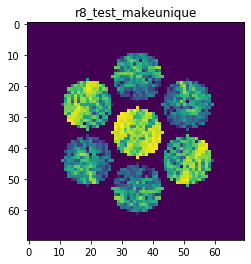

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9199366342320301
>>>replaced the 30. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 721ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 700ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000


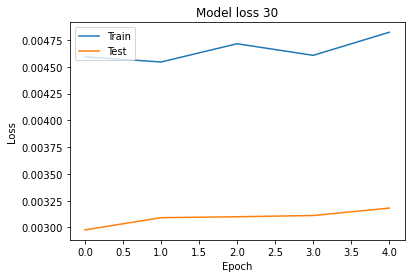

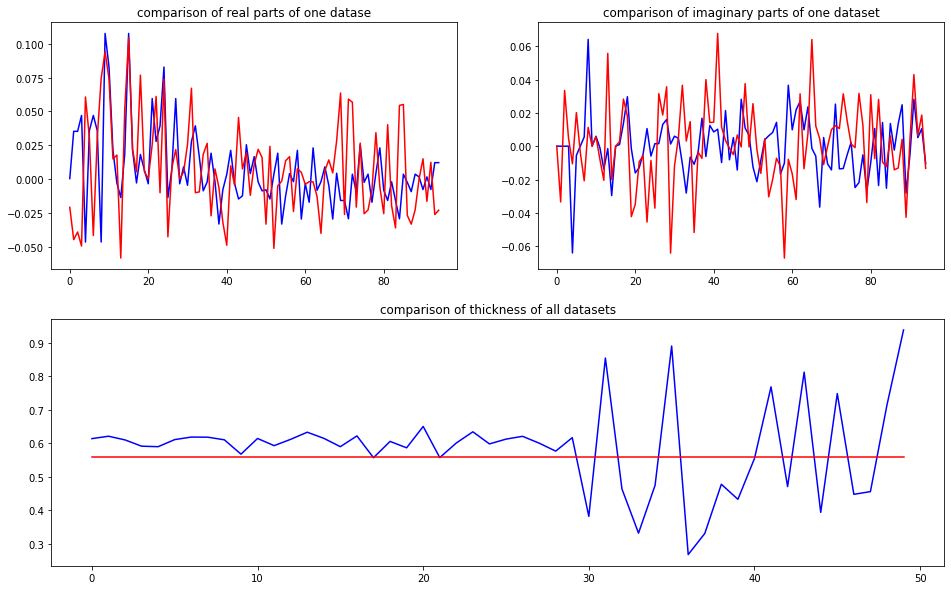

predicted thickness: 0.55715734


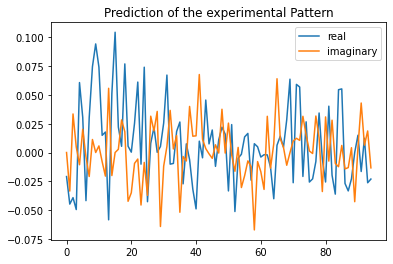

Applied shift of unit cell origin (fractional coordinates): -1.9738414622996615e-06 -0.4851159393156614 0.39284975984530174
Ug[ 0 ]: 0.02086 3.14159  =>  0.02086 3.14159
Ug[ 1 ]: 0.05365 -2.46835  =>  0.05365 -0.0
Ug[ 2 ]: 0.05365 2.46835  =>  0.05365 0.0
Ug[ 3 ]: 0.04582 3.04807  =>  0.04582 0.0
Ug[ 4 ]: 0.06845 -0.16049  =>  0.06845 -0.74022
Ug[ 5 ]: 0.03667 0.59202  =>  0.03667 1.35879
Ug[ 6 ]: 0.04582 -3.04807  =>  0.04582 -0.0
Ug[ 7 ]: 0.03667 -0.59202  =>  0.03667 -1.35879
Ug[ 8 ]: 0.06845 0.16049  =>  0.06845 0.74022
Ug[ 9 ]: 0.09926 1e-05  =>  0.09926 0.0
Ug[ 10 ]: 0.07438 0.09644  =>  0.07438 2.56477
Ug[ 11 ]: 0.01926 -0.28334  =>  0.01926 -2.7517
Ug[ 12 ]: 0.02698 -1.12801  =>  0.02698 1.92005
Ug[ 13 ]: 0.06862 2.39833  =>  0.06862 1.63155
Ug[ 14 ]: 0.06684 -0.28805  =>  0.06684 0.29166
Ug[ 15 ]: 0.09926 -1e-05  =>  0.09926 0.0
Ug[ 16 ]: 0.01926 0.28334  =>  0.01926 2.7517
Ug[ 17 ]: 0.02698 1.12801  =>  0.02698 -1.92005
Ug[ 18 ]: 0.06684 0.28805  =>  0.06684 -0.29166
Ug[ 19 ]

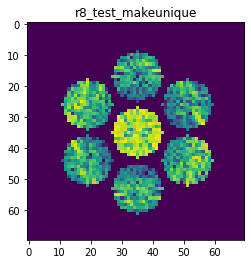

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9114087614858204
>>>replaced the 31. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 735ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 700ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 704ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 718ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000


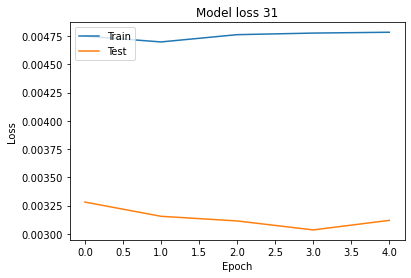

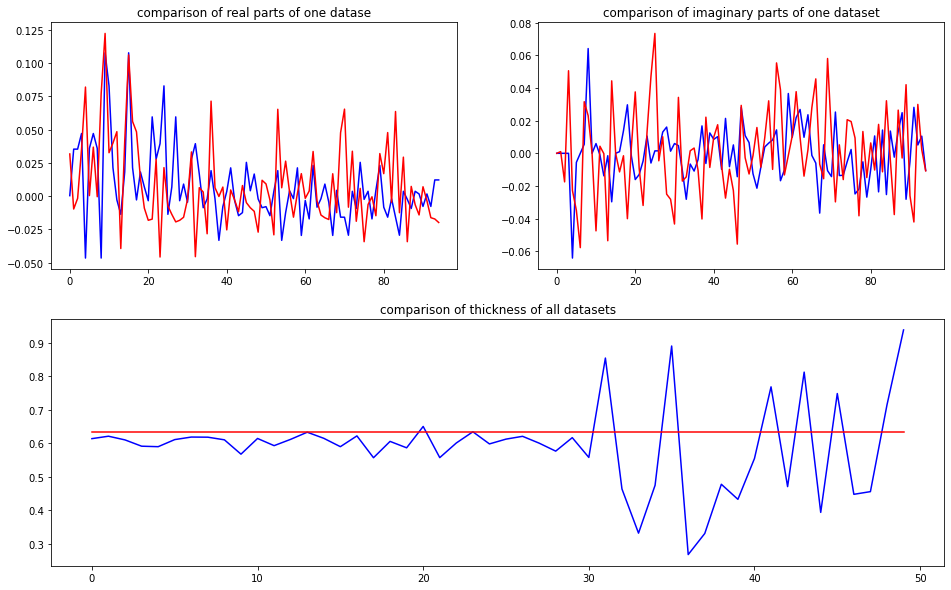

predicted thickness: 0.6324526


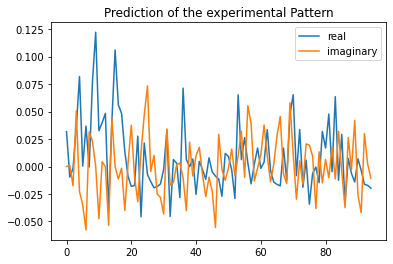

Applied shift of unit cell origin (fractional coordinates): -1.1101852226672396e-06 -0.15636039791462375 -0.33774669801139323
Ug[ 0 ]: 0.03165 0.0  =>  0.03165 0.0
Ug[ 1 ]: 0.01086 2.12213  =>  0.01086 0.0
Ug[ 2 ]: 0.01086 -2.12213  =>  0.01086 -0.0
Ug[ 3 ]: 0.06505 0.98244  =>  0.06505 -0.0
Ug[ 4 ]: 0.08272 -0.2808  =>  0.08272 2.89782
Ug[ 5 ]: 0.03325 -1.57248  =>  0.03325 -0.4328
Ug[ 6 ]: 0.06505 -0.98244  =>  0.06505 0.0
Ug[ 7 ]: 0.03325 1.57248  =>  0.03325 0.4328
Ug[ 8 ]: 0.08272 0.2808  =>  0.08272 -2.89782
Ug[ 9 ]: 0.11413 1e-05  =>  0.11413 0.0
Ug[ 10 ]: 0.05438 -1.05121  =>  0.05438 3.10984
Ug[ 11 ]: 0.04859 0.16241  =>  0.04859 2.28452
Ug[ 12 ]: 0.04835 0.01323  =>  0.04835 0.99566
Ug[ 13 ]: 0.06759 -1.92428  =>  0.06759 -3.06397
Ug[ 14 ]: 0.05019 0.99724  =>  0.05019 -2.18139
Ug[ 15 ]: 0.11413 -1e-05  =>  0.11413 -0.0
Ug[ 16 ]: 0.04859 -0.16241  =>  0.04859 -2.28452
Ug[ 17 ]: 0.04835 -0.01323  =>  0.04835 -0.99566
Ug[ 18 ]: 0.05019 -0.99724  =>  0.05019 2.18139
Ug[ 19 ]: 0.

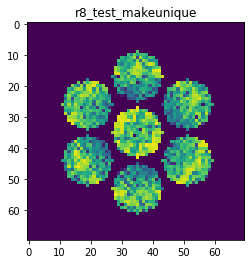

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8197222193415736
>>>replaced the 32. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 727ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000


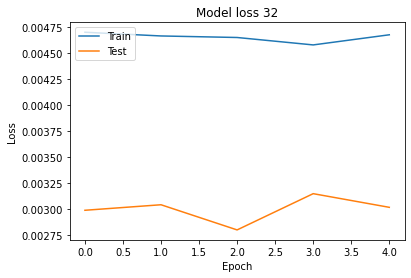

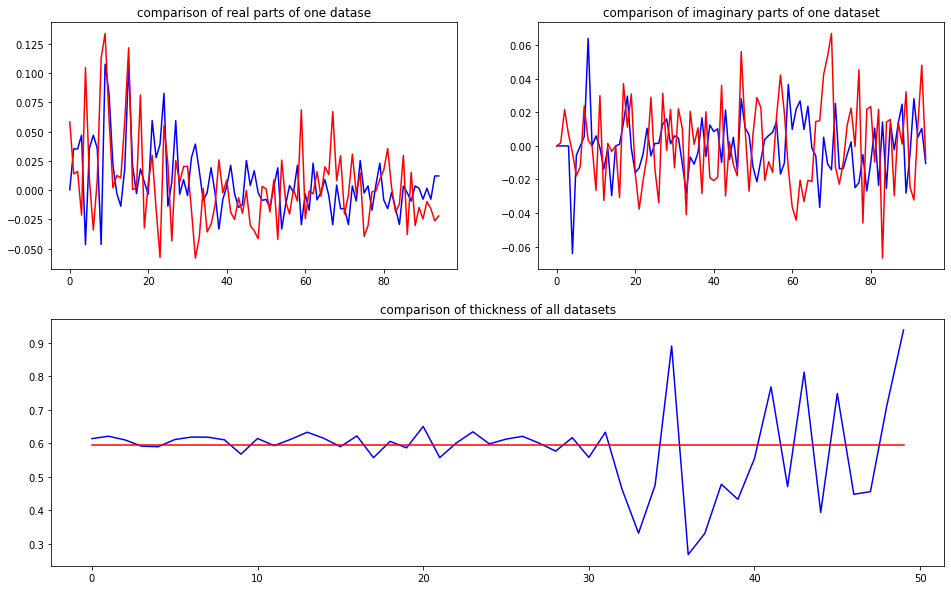

predicted thickness: 0.59367126


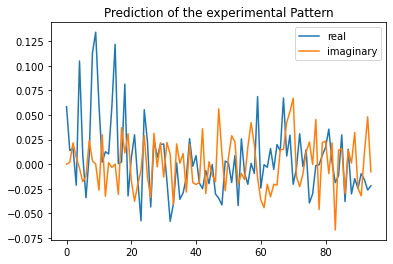

Applied shift of unit cell origin (fractional coordinates): -1.1449147906533003e-07 -0.4472137816958485 0.09279417971941369
Ug[ 0 ]: 0.05839 0.0  =>  0.05839 0.0
Ug[ 1 ]: 0.01798 -0.58304  =>  0.01798 -0.0
Ug[ 2 ]: 0.01798 0.58304  =>  0.01798 0.0
Ug[ 3 ]: 0.02932 2.80993  =>  0.02932 0.0
Ug[ 4 ]: 0.10898 -0.03413  =>  0.10898 -2.26101
Ug[ 5 ]: 0.02278 -1.14849  =>  0.02278 1.74172
Ug[ 6 ]: 0.02932 -2.80993  =>  0.02932 0.0
Ug[ 7 ]: 0.02278 1.14849  =>  0.02278 -1.74172
Ug[ 8 ]: 0.10898 0.03413  =>  0.10898 2.26101
Ug[ 9 ]: 0.12793 0.0  =>  0.12793 0.0
Ug[ 10 ]: 0.06452 -0.44379  =>  0.06452 0.13925
Ug[ 11 ]: 0.03035 1.52901  =>  0.03035 0.94597
Ug[ 12 ]: 0.03558 -1.3601  =>  0.03558 1.44982
Ug[ 13 ]: 0.01806 0.42865  =>  0.01806 -2.46157
Ug[ 14 ]: 0.07026 -0.10345  =>  0.07026 2.12343
Ug[ 15 ]: 0.12793 -0.0  =>  0.12793 0.0
Ug[ 16 ]: 0.03035 -1.52901  =>  0.03035 -0.94597
Ug[ 17 ]: 0.03558 1.3601  =>  0.03558 -1.44982
Ug[ 18 ]: 0.07026 0.10345  =>  0.07026 -2.12343
Ug[ 19 ]: 0.04988 2

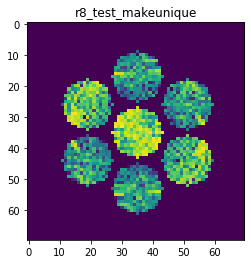

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8892423366347895
>>>replaced the 33. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0032 - val_acc: 1.0000


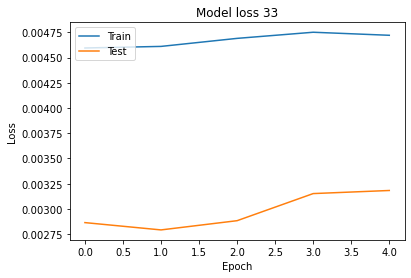

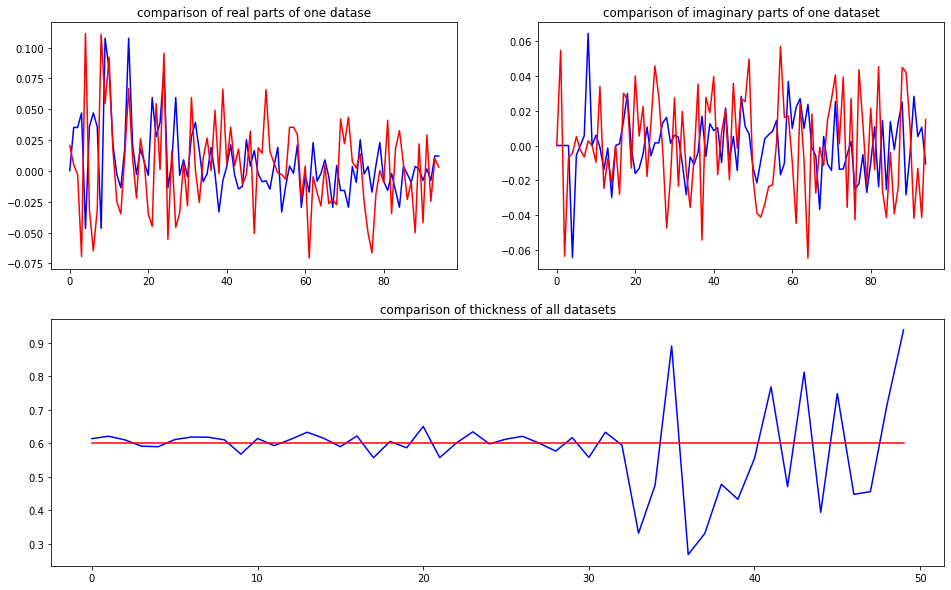

predicted thickness: 0.6015103


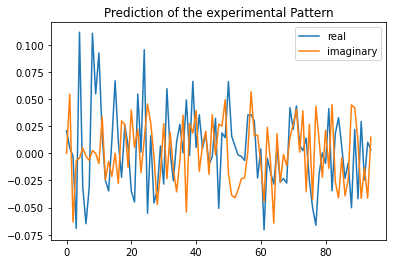

Applied shift of unit cell origin (fractional coordinates): -2.7986616567550102e-06 0.4949723570345103 -0.24692854134991077
Ug[ 0 ]: 0.02065 0.0  =>  0.02065 0.0
Ug[ 1 ]: 0.0589 1.5515  =>  0.0589 -0.0
Ug[ 2 ]: 0.0589 -1.5515  =>  0.0589 0.0
Ug[ 3 ]: 0.06713 -3.11  =>  0.06713 0.0
Ug[ 4 ]: 0.11114 -0.03181  =>  0.11114 1.52669
Ug[ 5 ]: 0.03177 2.95874  =>  0.03177 1.33705
Ug[ 6 ]: 0.06713 3.11  =>  0.06713 -0.0
Ug[ 7 ]: 0.03177 -2.95874  =>  0.03177 -1.33705
Ug[ 8 ]: 0.11114 0.03181  =>  0.11114 -1.52669
Ug[ 9 ]: 0.06076 2e-05  =>  0.06076 0.0
Ug[ 10 ]: 0.09463 -0.11948  =>  0.09463 -1.67099
Ug[ 11 ]: 0.03373 1.15467  =>  0.03373 2.70616
Ug[ 12 ]: 0.03594 -2.28356  =>  0.03594 0.8896
Ug[ 13 ]: 0.05221 -2.61046  =>  0.05221 -0.9888
Ug[ 14 ]: 0.03046 -0.89513  =>  0.03046 -2.45365
Ug[ 15 ]: 0.06076 -2e-05  =>  0.06076 0.0
Ug[ 16 ]: 0.03373 -1.15467  =>  0.03373 -2.70616
Ug[ 17 ]: 0.03594 2.28356  =>  0.03594 -0.8896
Ug[ 18 ]: 0.03046 0.89513  =>  0.03046 2.45365
Ug[ 19 ]: 0.02351 -1.0593

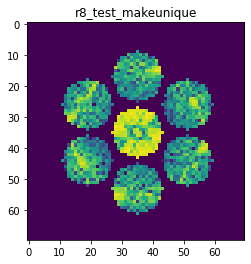

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9395903981457364
>>>replaced the 34. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 723ms/step - loss: 0.0048 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 696ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 705ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000


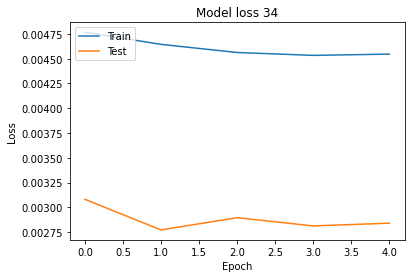

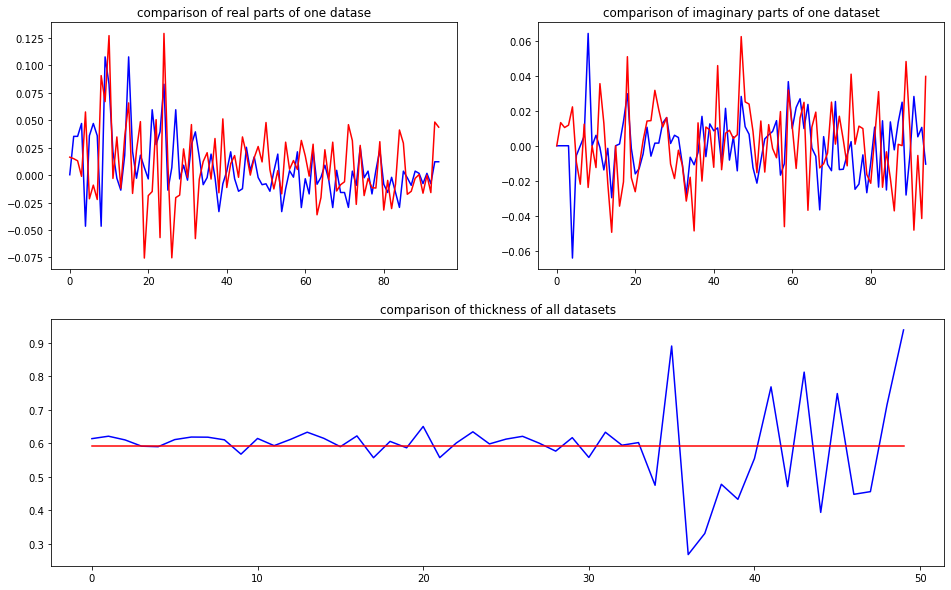

predicted thickness: 0.5920818


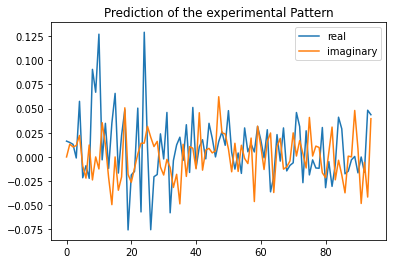

Applied shift of unit cell origin (fractional coordinates): -2.288978448993737e-06 -0.29685899678937533 -0.01593919317976417
Ug[ 0 ]: 0.01635 0.0  =>  0.01635 0.0
Ug[ 1 ]: 0.01406 0.10015  =>  0.01406 0.0
Ug[ 2 ]: 0.01406 -0.10015  =>  0.01406 0.0
Ug[ 3 ]: 0.01761 1.86522  =>  0.01761 -0.0
Ug[ 4 ]: 0.07755 0.3011  =>  0.07755 -1.66427
Ug[ 5 ]: 0.0244 -2.68215  =>  0.0244 1.83596
Ug[ 6 ]: 0.01761 -1.86522  =>  0.01761 0.0
Ug[ 7 ]: 0.0244 2.68215  =>  0.0244 -1.83596
Ug[ 8 ]: 0.07755 -0.3011  =>  0.07755 1.66427
Ug[ 9 ]: 0.06634 1e-05  =>  0.06634 0.0
Ug[ 10 ]: 0.12871 -0.10424  =>  0.12871 -0.2044
Ug[ 11 ]: 0.03631 1.84545  =>  0.03631 1.94558
Ug[ 12 ]: 0.03313 0.53073  =>  0.03313 2.39593
Ug[ 13 ]: 0.02658 -1.60862  =>  0.02658 0.15644
Ug[ 14 ]: 0.06527 -0.87504  =>  0.06527 1.09031
Ug[ 15 ]: 0.06634 -1e-05  =>  0.06634 -0.0
Ug[ 16 ]: 0.03631 -1.84545  =>  0.03631 -1.94558
Ug[ 17 ]: 0.03313 -0.53073  =>  0.03313 -2.39593
Ug[ 18 ]: 0.06527 0.87504  =>  0.06527 -1.09031
Ug[ 19 ]: 0.07786

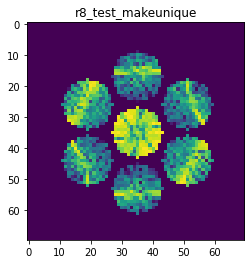

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.926364444917057
>>>replaced the 35. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 702ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0029 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 703ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 709ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000


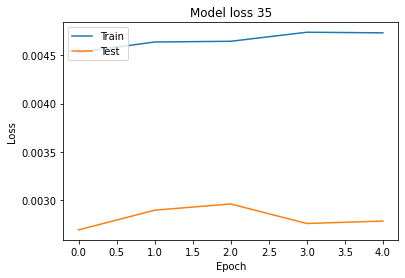

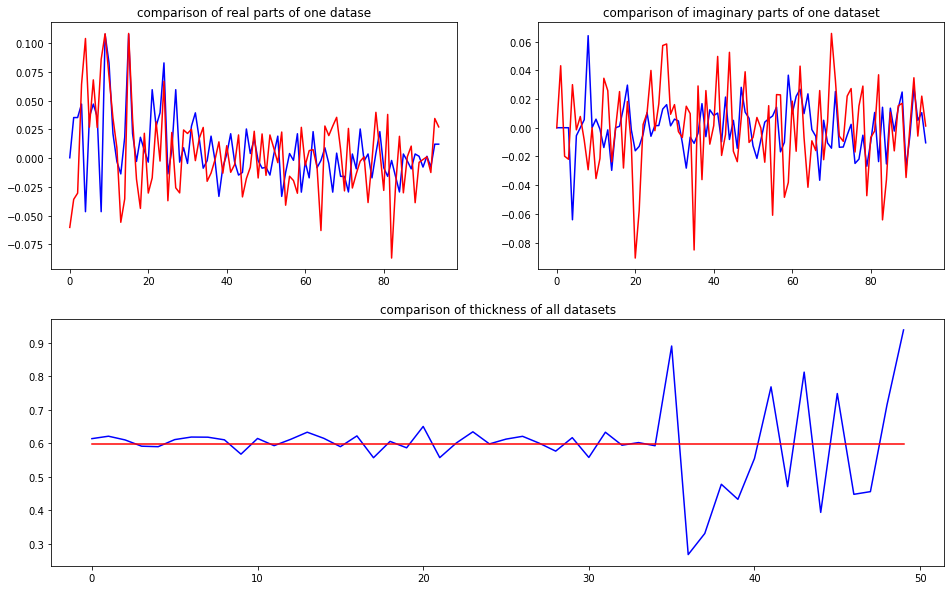

predicted thickness: 0.5978254


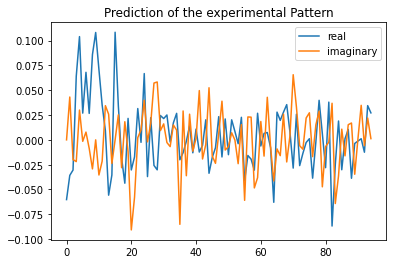

Applied shift of unit cell origin (fractional coordinates): -6.777732250130633e-07 0.0352487599066435 -0.3789724819839547
Ug[ 0 ]: 0.06019 3.14159  =>  0.06019 3.14159
Ug[ 1 ]: 0.04571 2.38115  =>  0.04571 0.0
Ug[ 2 ]: 0.04571 -2.38115  =>  0.04571 0.0
Ug[ 3 ]: 0.06774 -0.22147  =>  0.06774 0.0
Ug[ 4 ]: 0.09945 0.30255  =>  0.09945 -1.85713
Ug[ 5 ]: 0.02703 0.1328  =>  0.02703 2.73543
Ug[ 6 ]: 0.06774 0.22147  =>  0.06774 0.0
Ug[ 7 ]: 0.02703 -0.1328  =>  0.02703 -2.73543
Ug[ 8 ]: 0.09945 -0.30255  =>  0.09945 1.85713
Ug[ 9 ]: 0.10829 0.0  =>  0.10829 -0.0
Ug[ 10 ]: 0.07849 -0.50024  =>  0.07849 -2.8814
Ug[ 11 ]: 0.04172 -0.59319  =>  0.04172 1.78796
Ug[ 12 ]: 0.03158 1.71563  =>  0.03158 1.49415
Ug[ 13 ]: 0.04843 2.84969  =>  0.04843 0.24705
Ug[ 14 ]: 0.04479 -2.65311  =>  0.04479 -0.49343
Ug[ 15 ]: 0.10829 -0.0  =>  0.10829 0.0
Ug[ 16 ]: 0.04172 0.59319  =>  0.04172 -1.78796
Ug[ 17 ]: 0.03158 -1.71563  =>  0.03158 -1.49415
Ug[ 18 ]: 0.04479 2.65311  =>  0.04479 0.49343
Ug[ 19 ]: 0.02

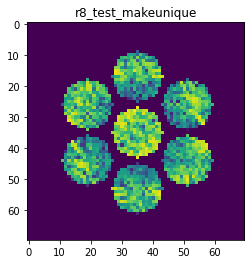

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8692156831556725
>>>replaced the 36. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 692ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 694ms/step - loss: 0.0047 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 721ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000


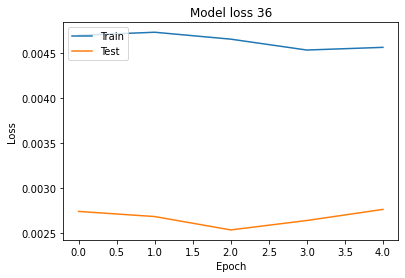

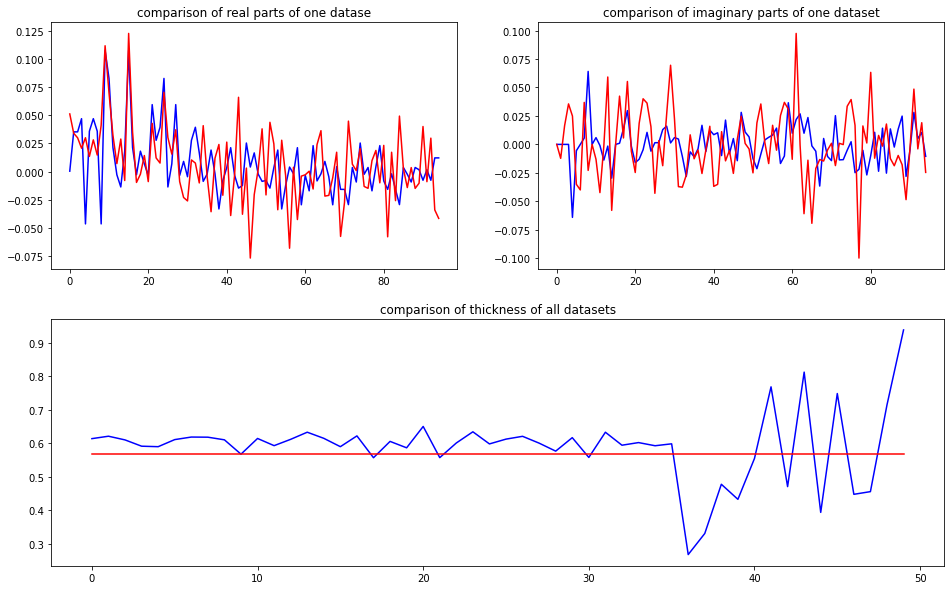

predicted thickness: 0.5679006


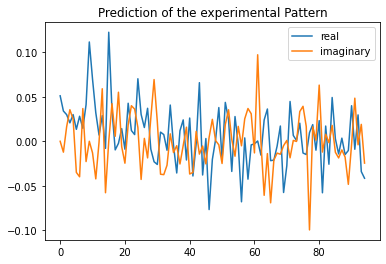

Applied shift of unit cell origin (fractional coordinates): 2.2380911202218343e-06 -0.1584783433232591 0.06691081158789322
Ug[ 0 ]: 0.05123 0.0  =>  0.05123 0.0
Ug[ 1 ]: 0.0351 -0.42041  =>  0.0351 0.0
Ug[ 2 ]: 0.0351 0.42041  =>  0.0351 0.0
Ug[ 3 ]: 0.045 0.99575  =>  0.045 -0.0
Ug[ 4 ]: 0.04289 0.59005  =>  0.04289 0.01471
Ug[ 5 ]: 0.03862 -1.19768  =>  0.03862 -2.61384
Ug[ 6 ]: 0.045 -0.99575  =>  0.045 0.0
Ug[ 7 ]: 0.03862 1.19768  =>  0.03862 2.61384
Ug[ 8 ]: 0.04289 -0.59005  =>  0.04289 -0.01471
Ug[ 9 ]: 0.11733 -1e-05  =>  0.11733 0.0
Ug[ 10 ]: 0.07157 -0.20151  =>  0.07157 0.21891
Ug[ 11 ]: 0.05413 -0.89887  =>  0.05413 -1.31927
Ug[ 12 ]: 0.00369 -1.93281  =>  0.00369 -0.93705
Ug[ 13 ]: 0.05902 1.04555  =>  0.05902 2.46173
Ug[ 14 ]: 0.05682 -1.66121  =>  0.05682 -1.08586
Ug[ 15 ]: 0.11733 1e-05  =>  0.11733 -0.0
Ug[ 16 ]: 0.05413 0.89887  =>  0.05413 1.31927
Ug[ 17 ]: 0.00369 1.93281  =>  0.00369 0.93705
Ug[ 18 ]: 0.05682 1.66121  =>  0.05682 1.08586
Ug[ 19 ]: 0.01559 -0.30129

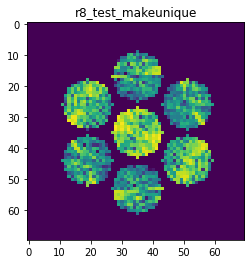

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9293885865275685
>>>replaced the 37. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 713ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 701ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000


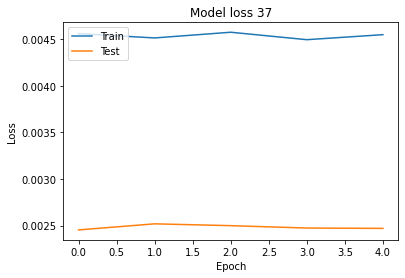

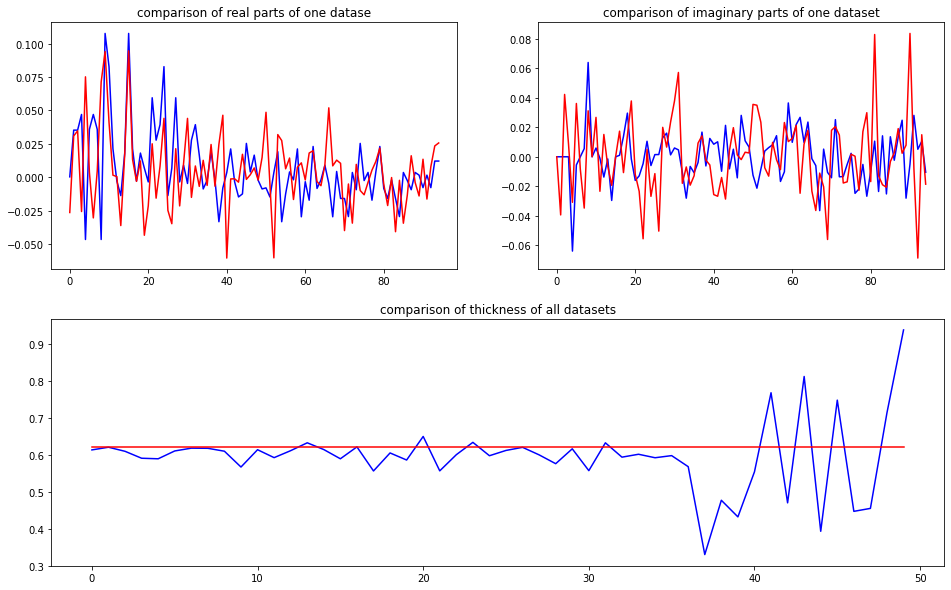

predicted thickness: 0.62143815


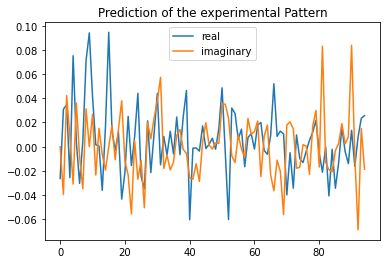

Applied shift of unit cell origin (fractional coordinates): 6.708361490047219e-07 -0.4533085514673062 0.14240187605615992
Ug[ 0 ]: 0.02634 3.14159  =>  0.02634 3.14159
Ug[ 1 ]: 0.05248 -0.89474  =>  0.05248 0.0
Ug[ 2 ]: 0.05248 0.89474  =>  0.05248 0.0
Ug[ 3 ]: 0.02925 2.84822  =>  0.02925 0.0
Ug[ 4 ]: 0.07958 -0.40134  =>  0.07958 -2.35483
Ug[ 5 ]: 0.03579 1.45066  =>  0.03579 -2.2923
Ug[ 6 ]: 0.02925 -2.84822  =>  0.02925 -0.0
Ug[ 7 ]: 0.03579 -1.45066  =>  0.03579 2.2923
Ug[ 8 ]: 0.07958 0.40134  =>  0.07958 2.35483
Ug[ 9 ]: 0.09436 -0.0  =>  0.09436 0.0
Ug[ 10 ]: 0.05038 0.56172  =>  0.05038 1.45646
Ug[ 11 ]: 0.02174 -1.2206  =>  0.02174 -2.11533
Ug[ 12 ]: 0.01302 1.66767  =>  0.01302 -1.76729
Ug[ 13 ]: 0.03052 3.06027  =>  0.03052 0.52005
Ug[ 14 ]: 0.02237 -0.85675  =>  0.02237 1.09674
Ug[ 15 ]: 0.09436 0.0  =>  0.09436 0.0
Ug[ 16 ]: 0.02174 1.2206  =>  0.02174 2.11533
Ug[ 17 ]: 0.01302 -1.66767  =>  0.01302 1.76729
Ug[ 18 ]: 0.02237 0.85675  =>  0.02237 -1.09674
Ug[ 19 ]: 0.05899

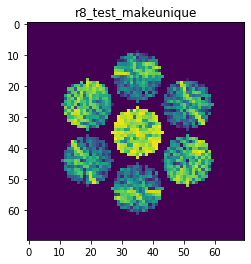

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9499778519028498
>>>replaced the 38. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 707ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 709ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000


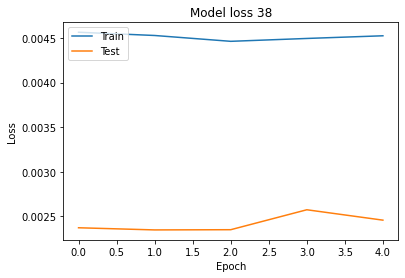

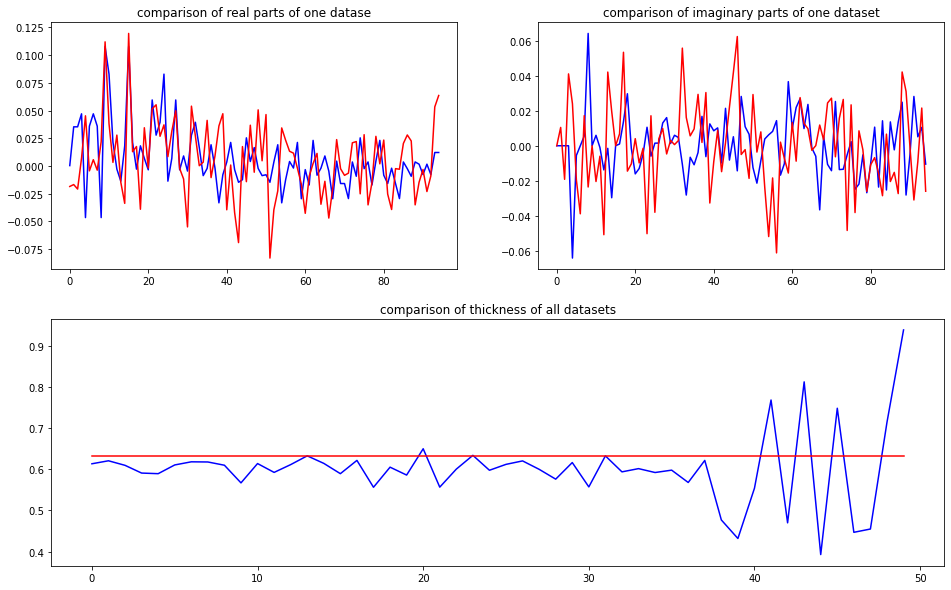

predicted thickness: 0.63114095


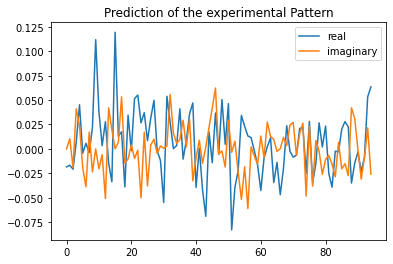

Applied shift of unit cell origin (fractional coordinates): -1.2289683842541667e-06 -0.22478078625183814 -0.39375803373348034
Ug[ 0 ]: 0.01848 3.14159  =>  0.01848 3.14159
Ug[ 1 ]: 0.02392 2.47405  =>  0.02392 0.0
Ug[ 2 ]: 0.02392 -2.47405  =>  0.02392 -0.0
Ug[ 3 ]: 0.04042 1.41234  =>  0.04042 0.0
Ug[ 4 ]: 0.04107 0.61624  =>  0.04107 3.01304
Ug[ 5 ]: 0.01879 -1.79035  =>  0.01879 -0.72864
Ug[ 6 ]: 0.04042 -1.41234  =>  0.04042 -0.0
Ug[ 7 ]: 0.01879 1.79035  =>  0.01879 0.72864
Ug[ 8 ]: 0.04107 -0.61624  =>  0.04107 -3.01304
Ug[ 9 ]: 0.11569 1e-05  =>  0.11569 -0.0
Ug[ 10 ]: 0.04198 -0.46306  =>  0.04198 -2.93713
Ug[ 11 ]: 0.01027 -0.66951  =>  0.01027 1.80454
Ug[ 12 ]: 0.05678 -1.1597  =>  0.05678 0.25263
Ug[ 13 ]: 0.04013 1.64866  =>  0.04013 0.58694
Ug[ 14 ]: 0.04016 2.70323  =>  0.04016 0.30643
Ug[ 15 ]: 0.11569 -1e-05  =>  0.11569 0.0
Ug[ 16 ]: 0.01027 0.66951  =>  0.01027 -1.80454
Ug[ 17 ]: 0.05678 1.1597  =>  0.05678 -0.25263
Ug[ 18 ]: 0.04016 -2.70323  =>  0.04016 -0.30643
Ug[

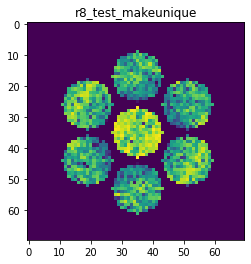

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8578872880285668
>>>replaced the 39. dataset and train: 
Epoch 1/5
8/8 [==============================] - 8s 797ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 708ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 709ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 757ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000


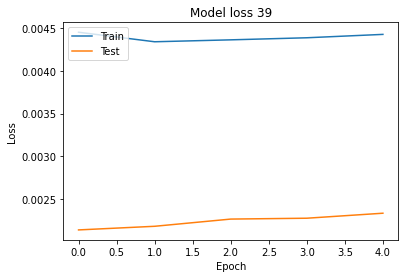

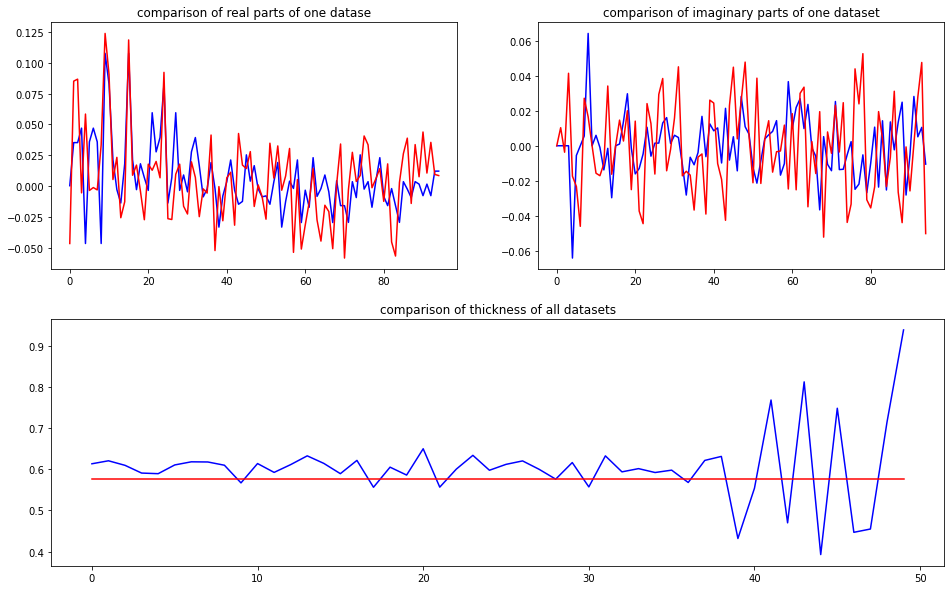

predicted thickness: 0.57723963


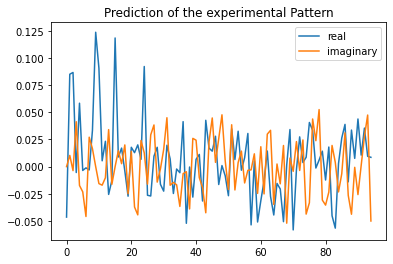

Applied shift of unit cell origin (fractional coordinates): 7.275736761192193e-07 -0.2620508916870909 -0.012930793514256819
Ug[ 0 ]: 0.04653 3.14159  =>  0.04653 3.14159
Ug[ 1 ]: 0.08623 0.08125  =>  0.08623 0.0
Ug[ 2 ]: 0.08623 -0.08125  =>  0.08623 -0.0
Ug[ 3 ]: 0.04379 1.64651  =>  0.04379 0.0
Ug[ 4 ]: 0.04895 -0.35349  =>  0.04895 -2.08125
Ug[ 5 ]: 0.02539 -1.70122  =>  0.02539 3.0167
Ug[ 6 ]: 0.04379 -1.64651  =>  0.04379 -0.0
Ug[ 7 ]: 0.02539 1.70122  =>  0.02539 -3.0167
Ug[ 8 ]: 0.04895 0.35349  =>  0.04895 2.08125
Ug[ 9 ]: 0.12118 -0.0  =>  0.12118 0.0
Ug[ 10 ]: 0.09256 -0.15374  =>  0.09256 -0.23498
Ug[ 11 ]: 0.01738 -1.15036  =>  0.01738 -1.0691
Ug[ 12 ]: 0.02121 -0.31087  =>  0.02121 1.33565
Ug[ 13 ]: 0.03616 2.37365  =>  0.03616 -2.34426
Ug[ 14 ]: 0.01996 -2.00332  =>  0.01996 -0.27556
Ug[ 15 ]: 0.12118 0.0  =>  0.12118 0.0
Ug[ 16 ]: 0.01738 1.15036  =>  0.01738 1.0691
Ug[ 17 ]: 0.02121 0.31087  =>  0.02121 -1.33565
Ug[ 18 ]: 0.01996 2.00332  =>  0.01996 0.27556
Ug[ 19 ]: 0

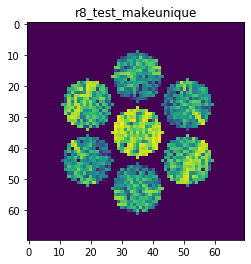

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9654611257538812
>>>replaced the 40. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 699ms/step - loss: 0.0046 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 701ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000


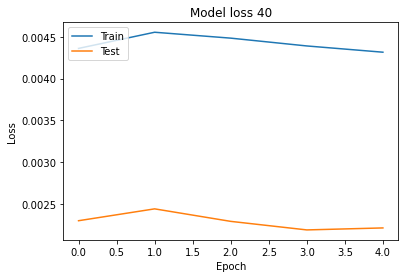

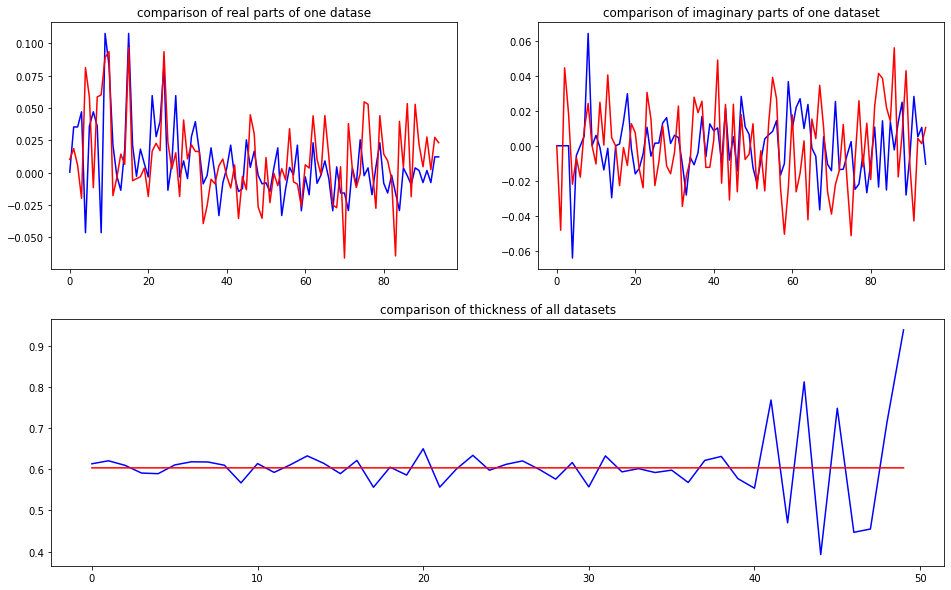

predicted thickness: 0.6033967


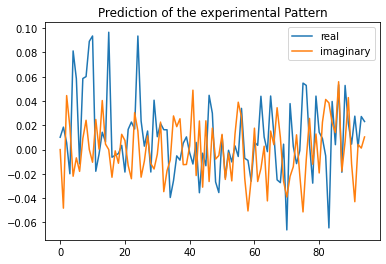

Applied shift of unit cell origin (fractional coordinates): 1.0767321893948435e-06 -0.3637084584129331 0.2094447971212827
Ug[ 0 ]: 0.01016 0.0  =>  0.01016 0.0
Ug[ 1 ]: 0.04789 -1.31598  =>  0.04789 -0.0
Ug[ 2 ]: 0.04789 1.31598  =>  0.04789 0.0
Ug[ 3 ]: 0.02412 2.28525  =>  0.02412 0.0
Ug[ 4 ]: 0.07433 -0.3151  =>  0.07433 -1.28437
Ug[ 5 ]: 0.059 -0.13549  =>  0.059 2.54647
Ug[ 6 ]: 0.02412 -2.28525  =>  0.02412 -0.0
Ug[ 7 ]: 0.059 0.13549  =>  0.059 -2.54647
Ug[ 8 ]: 0.07433 0.3151  =>  0.07433 1.28437
Ug[ 9 ]: 0.09287 -1e-05  =>  0.09287 0.0
Ug[ 10 ]: 0.09441 -0.13698  =>  0.09441 1.17901
Ug[ 11 ]: 0.02668 2.04034  =>  0.02668 0.72436
Ug[ 12 ]: 0.00434 2.97865  =>  0.00434 -1.01928
Ug[ 13 ]: 0.03676 1.03175  =>  0.03676 -1.6502
Ug[ 14 ]: 0.00805 1.37457  =>  0.00805 2.34385
Ug[ 15 ]: 0.09287 1e-05  =>  0.09287 -0.0
Ug[ 16 ]: 0.02668 -2.04034  =>  0.02668 -0.72436
Ug[ 17 ]: 0.00434 -2.97865  =>  0.00434 1.01928
Ug[ 18 ]: 0.00805 -1.37457  =>  0.00805 -2.34385
Ug[ 19 ]: 0.0115 1.29307

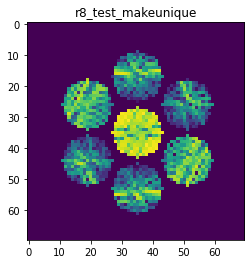

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9655244782249202
>>>replaced the 41. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 701ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 701ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 720ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000


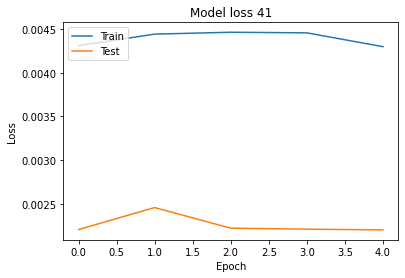

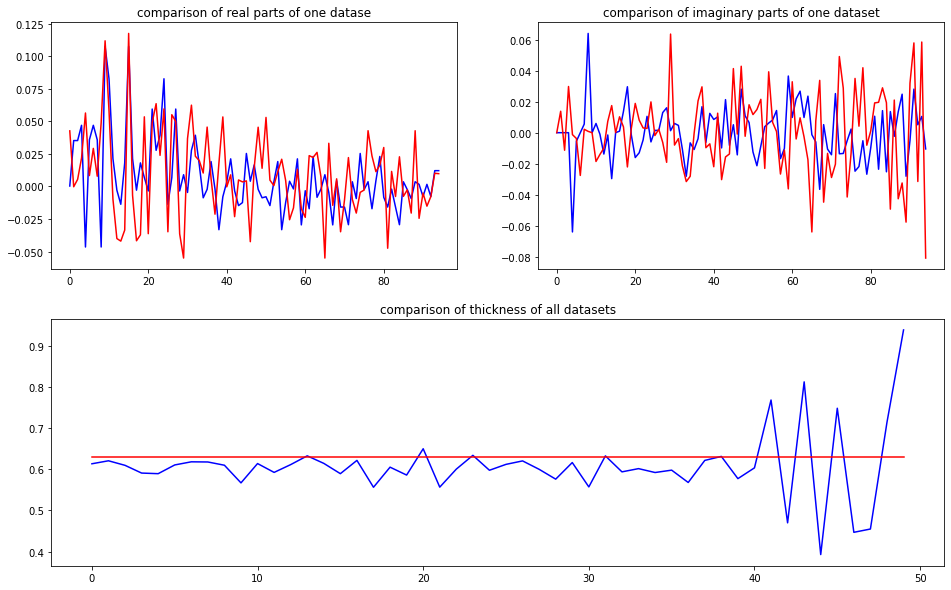

predicted thickness: 0.63027483


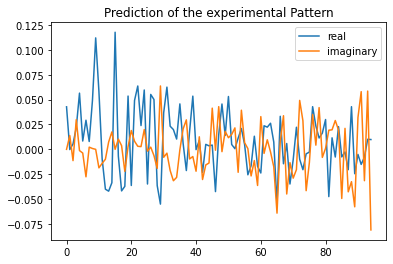

Applied shift of unit cell origin (fractional coordinates): 1.192308122405686e-06 -0.1342696194503422 -0.21758289427159827
Ug[ 0 ]: 0.04274 0.0  =>  0.04274 0.0
Ug[ 1 ]: 0.01285 1.36711  =>  0.01285 0.0
Ug[ 2 ]: 0.01285 -1.36711  =>  0.01285 0.0
Ug[ 3 ]: 0.03843 0.84364  =>  0.03843 -0.0
Ug[ 4 ]: 0.05276 -0.02  =>  0.05276 -2.23075
Ug[ 5 ]: 0.00864 -0.3501  =>  0.00864 0.17337
Ug[ 6 ]: 0.03843 -0.84364  =>  0.03843 0.0
Ug[ 7 ]: 0.00864 0.3501  =>  0.00864 -0.17337
Ug[ 8 ]: 0.05276 0.02  =>  0.05276 2.23075
Ug[ 9 ]: 0.11481 -1e-05  =>  0.11481 0.0
Ug[ 10 ]: 0.06192 -0.31581  =>  0.06192 -1.68291
Ug[ 11 ]: 0.01471 -2.16958  =>  0.01471 -0.80246
Ug[ 12 ]: 0.04146 -2.97582  =>  0.04146 -2.13217
Ug[ 13 ]: 0.03869 3.02281  =>  0.03869 2.49934
Ug[ 14 ]: 0.04052 2.63097  =>  0.04052 -1.44146
Ug[ 15 ]: 0.11481 1e-05  =>  0.11481 0.0
Ug[ 16 ]: 0.01471 2.16958  =>  0.01471 0.80246
Ug[ 17 ]: 0.04146 2.97582  =>  0.04146 2.13217
Ug[ 18 ]: 0.04052 -2.63097  =>  0.04052 1.44146
Ug[ 19 ]: 0.05435 0.00

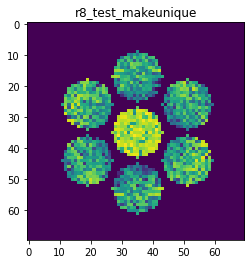

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9257028686380583
>>>replaced the 42. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 691ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 701ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


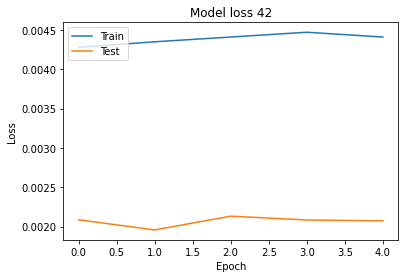

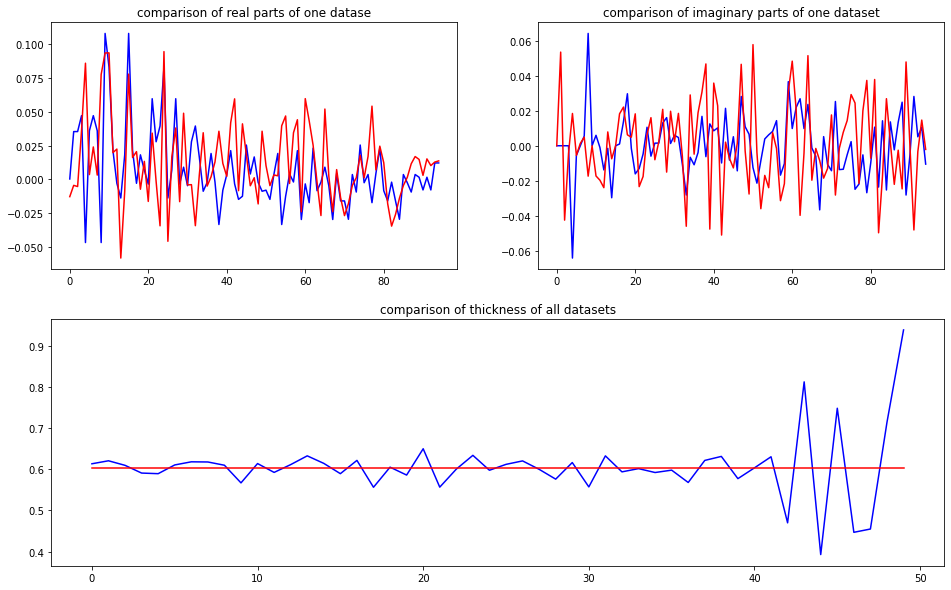

predicted thickness: 0.6029794


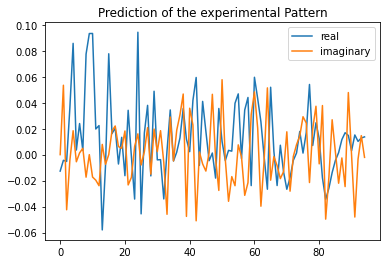

Applied shift of unit cell origin (fractional coordinates): 6.656726011285339e-07 0.014930577298345408 -0.2658868938164016
Ug[ 0 ]: 0.01269 3.14159  =>  0.01269 3.14159
Ug[ 1 ]: 0.04819 1.67062  =>  0.04819 0.0
Ug[ 2 ]: 0.04819 -1.67062  =>  0.04819 -0.0
Ug[ 3 ]: 0.03022 -0.09381  =>  0.03022 0.0
Ug[ 4 ]: 0.0835 0.2158  =>  0.0835 -1.36101
Ug[ 5 ]: 0.00618 -0.99325  =>  0.00618 0.77118
Ug[ 6 ]: 0.03022 0.09381  =>  0.03022 -0.0
Ug[ 7 ]: 0.00618 0.99325  =>  0.00618 -0.77118
Ug[ 8 ]: 0.0835 -0.2158  =>  0.0835 1.36101
Ug[ 9 ]: 0.08546 -0.0  =>  0.08546 0.0
Ug[ 10 ]: 0.09524 -0.17551  =>  0.09524 -1.84612
Ug[ 11 ]: 0.02611 -0.81179  =>  0.02611 0.85883
Ug[ 12 ]: 0.03144 -0.82037  =>  0.03144 -0.91418
Ug[ 13 ]: 0.05239 2.98955  =>  0.05239 1.22513
Ug[ 14 ]: 0.01051 -2.43355  =>  0.01051 -0.85674
Ug[ 15 ]: 0.08546 0.0  =>  0.08546 0.0
Ug[ 16 ]: 0.02611 0.81179  =>  0.02611 -0.85883
Ug[ 17 ]: 0.03144 0.82037  =>  0.03144 0.91418
Ug[ 18 ]: 0.01051 2.43355  =>  0.01051 0.85674
Ug[ 19 ]: 0.015

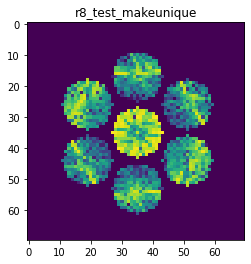

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9234850411591606
>>>replaced the 43. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 697ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 703ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


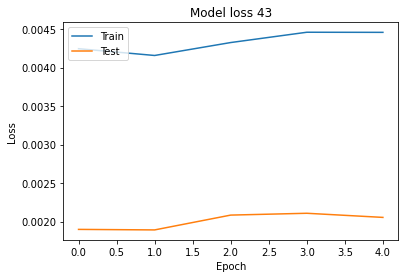

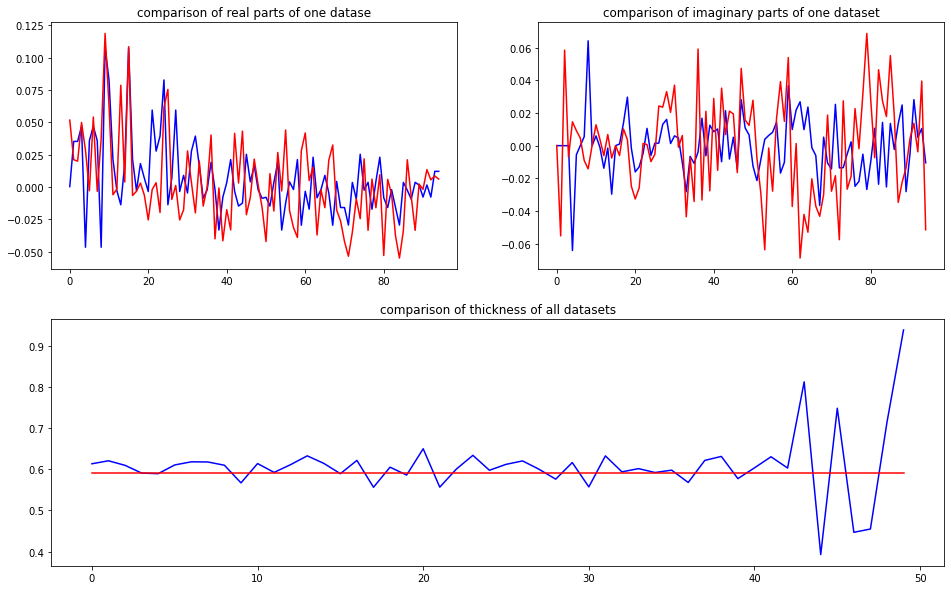

predicted thickness: 0.59198934


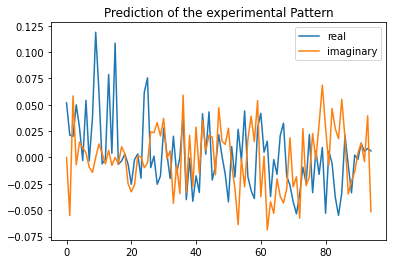

Applied shift of unit cell origin (fractional coordinates): 7.898462096843005e-07 0.01757548382912522 0.1946700377284128
Ug[ 0 ]: 0.05174 0.0  =>  0.05174 0.0
Ug[ 1 ]: 0.0604 -1.22315  =>  0.0604 0.0
Ug[ 2 ]: 0.0604 1.22315  =>  0.0604 -0.0
Ug[ 3 ]: 0.05236 -0.11043  =>  0.05236 -0.0
Ug[ 4 ]: 0.03587 0.41268  =>  0.03587 1.74626
Ug[ 5 ]: 0.00967 1.89472  =>  0.00967 0.782
Ug[ 6 ]: 0.05236 0.11043  =>  0.05236 0.0
Ug[ 7 ]: 0.00967 -1.89472  =>  0.00967 -0.782
Ug[ 8 ]: 0.03587 -0.41268  =>  0.03587 -1.74626
Ug[ 9 ]: 0.11365 -0.0  =>  0.11365 0.0
Ug[ 10 ]: 0.06326 0.17883  =>  0.06326 1.40198
Ug[ 11 ]: 0.00797 2.47273  =>  0.00797 1.24958
Ug[ 12 ]: 0.0085 -1.86242  =>  0.0085 -1.97284
Ug[ 13 ]: 0.07735 0.0784  =>  0.07735 1.19112
Ug[ 14 ]: 0.00662 -1.01266  =>  0.00662 -2.34624
Ug[ 15 ]: 0.11365 0.0  =>  0.11365 0.0
Ug[ 16 ]: 0.00797 -2.47273  =>  0.00797 -1.24958
Ug[ 17 ]: 0.0085 1.86242  =>  0.0085 1.97284
Ug[ 18 ]: 0.00662 1.01266  =>  0.00662 2.34624
Ug[ 19 ]: 0.02573 -1.88374  =>  0.

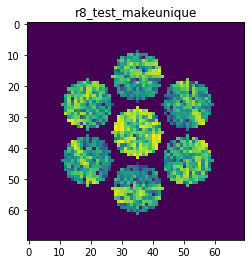

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9515755818429352
>>>replaced the 44. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0045 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 707ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000


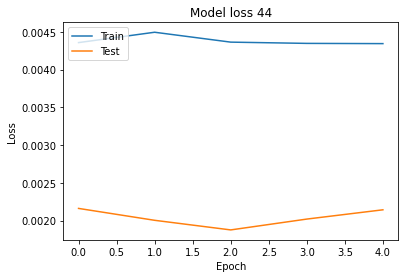

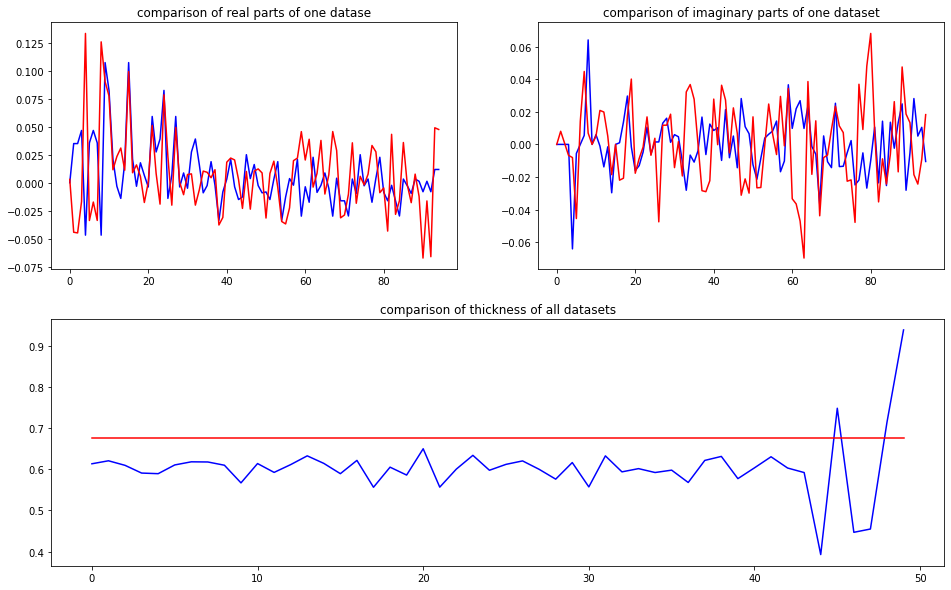

predicted thickness: 0.67648524


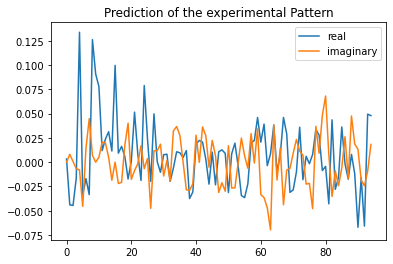

Applied shift of unit cell origin (fractional coordinates): -1.243636329730569e-06 0.41098838223565765 -0.48684603284471495
Ug[ 0 ]: 0.00324 0.0  =>  0.00324 0.0
Ug[ 1 ]: 0.04439 3.05894  =>  0.04439 -0.0
Ug[ 2 ]: 0.04439 -3.05894  =>  0.04439 0.0
Ug[ 3 ]: 0.01975 -2.58232  =>  0.01975 0.0
Ug[ 4 ]: 0.13016 -0.05755  =>  0.13016 -0.53418
Ug[ 5 ]: 0.05613 -2.20828  =>  0.05613 -2.85021
Ug[ 6 ]: 0.01975 2.58232  =>  0.01975 -0.0
Ug[ 7 ]: 0.05613 2.20828  =>  0.05613 2.85021
Ug[ 8 ]: 0.13016 0.05755  =>  0.13016 0.53418
Ug[ 9 ]: 0.09513 1e-05  =>  0.09513 0.0
Ug[ 10 ]: 0.07853 0.07488  =>  0.07853 -2.98407
Ug[ 11 ]: 0.02386 1.11193  =>  0.02386 -2.11232
Ug[ 12 ]: 0.02848 0.79359  =>  0.02848 -1.78873
Ug[ 13 ]: 0.0276 0.02355  =>  0.0276 0.66547
Ug[ 14 ]: 0.01997 -1.12054  =>  0.01997 -0.64392
Ug[ 15 ]: 0.09513 -1e-05  =>  0.09513 0.0
Ug[ 16 ]: 0.02386 -1.11193  =>  0.02386 2.11232
Ug[ 17 ]: 0.02848 -0.79359  =>  0.02848 1.78873
Ug[ 18 ]: 0.01997 1.12054  =>  0.01997 0.64392
Ug[ 19 ]: 0.047

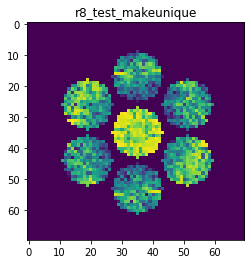

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9239152033748598
>>>replaced the 45. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0044 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 698ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 716ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0020 - val_acc: 1.0000


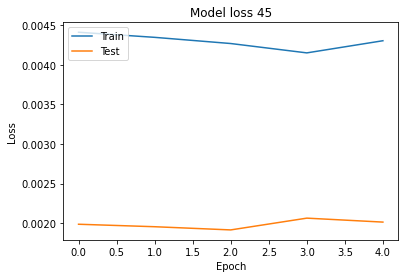

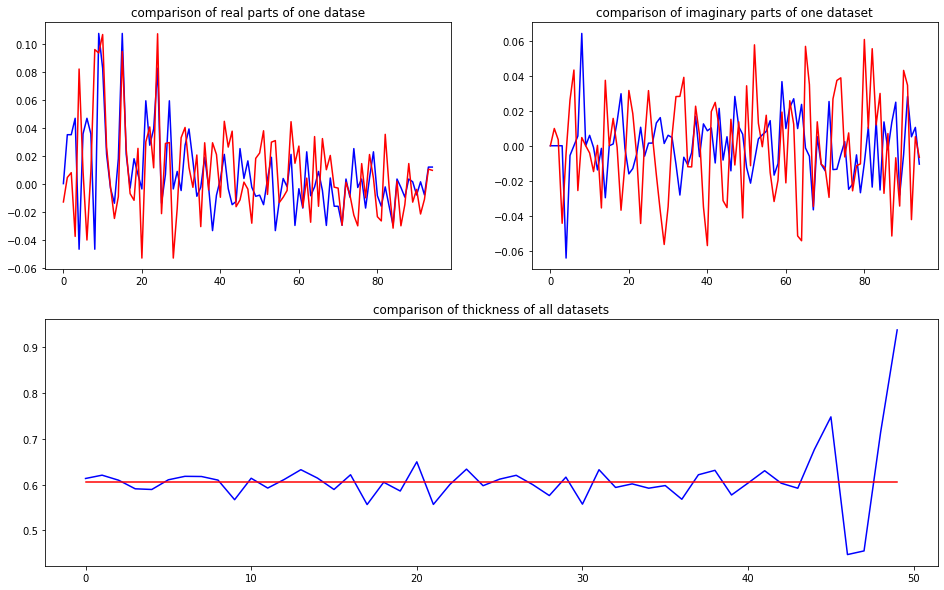

predicted thickness: 0.60530585


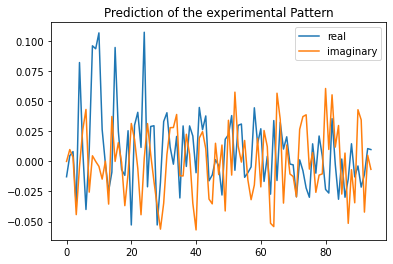

Applied shift of unit cell origin (fractional coordinates): 3.3622833289305026e-07 0.3652492600993578 -0.07355542938694995
Ug[ 0 ]: 0.01276 3.14159  =>  0.01276 3.14159
Ug[ 1 ]: 0.00719 0.46216  =>  0.00719 0.0
Ug[ 2 ]: 0.00719 -0.46216  =>  0.00719 0.0
Ug[ 3 ]: 0.05837 -2.29493  =>  0.05837 -0.0
Ug[ 4 ]: 0.08929 -0.0504  =>  0.08929 1.78237
Ug[ 5 ]: 0.02746 1.22716  =>  0.02746 -2.29894
Ug[ 6 ]: 0.05837 2.29493  =>  0.05837 0.0
Ug[ 7 ]: 0.02746 -1.22716  =>  0.02746 2.29894
Ug[ 8 ]: 0.08929 0.0504  =>  0.08929 -1.78237
Ug[ 9 ]: 0.0942 -0.0  =>  0.0942 0.0
Ug[ 10 ]: 0.1072 -0.03182  =>  0.1072 -0.49398
Ug[ 11 ]: 0.02985 -0.53322  =>  0.02985 -0.07106
Ug[ 12 ]: 0.00445 3.02245  =>  0.00445 0.72752
Ug[ 13 ]: 0.04052 -2.16916  =>  0.04052 1.35693
Ug[ 14 ]: 0.03846 1.84083  =>  0.03846 0.00806
Ug[ 15 ]: 0.0942 0.0  =>  0.0942 -0.0
Ug[ 16 ]: 0.02985 0.53322  =>  0.02985 0.07106
Ug[ 17 ]: 0.00445 -3.02245  =>  0.00445 -0.72752
Ug[ 18 ]: 0.03846 -1.84083  =>  0.03846 -0.00806
Ug[ 19 ]: 0.0284

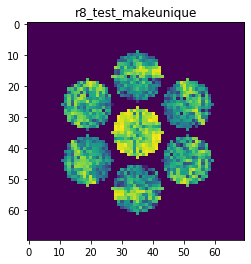

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9313934710539709
>>>replaced the 46. dataset and train: 
Epoch 1/5
8/8 [==============================] - 8s 726ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 700ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000


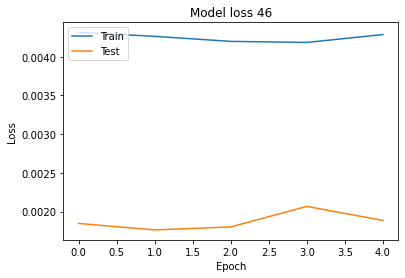

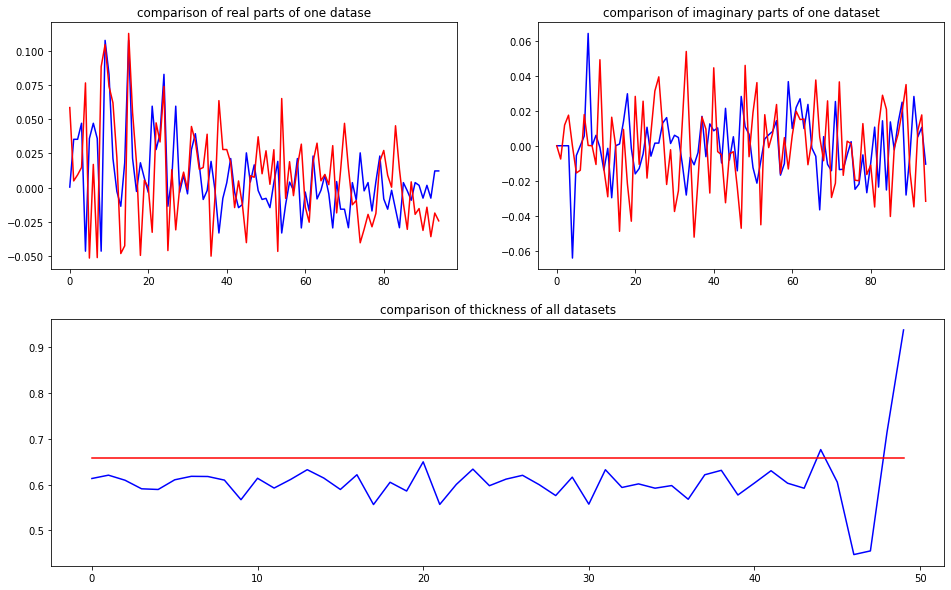

predicted thickness: 0.65735775


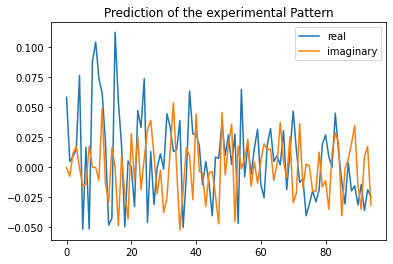

Applied shift of unit cell origin (fractional coordinates): 8.649615420550718e-07 -0.12445343513893961 0.14963159640213702
Ug[ 0 ]: 0.05849 0.0  =>  0.05849 0.0
Ug[ 1 ]: 0.01199 -0.94016  =>  0.01199 0.0
Ug[ 2 ]: 0.01199 0.94016  =>  0.01199 0.0
Ug[ 3 ]: 0.0223 0.78196  =>  0.0223 -0.0
Ug[ 4 ]: 0.0825 -0.00204  =>  0.0825 0.15616
Ug[ 5 ]: 0.05404 -2.82814  =>  0.05404 1.73292
Ug[ 6 ]: 0.0223 -0.78196  =>  0.0223 0.0
Ug[ 7 ]: 0.05404 2.82814  =>  0.05404 -1.73292
Ug[ 8 ]: 0.0825 0.00204  =>  0.0825 -0.15616
Ug[ 9 ]: 0.10864 -1e-05  =>  0.10864 -0.0
Ug[ 10 ]: 0.07455 -0.12232  =>  0.07455 0.81785
Ug[ 11 ]: 0.07622 0.6973  =>  0.07622 -0.24286
Ug[ 12 ]: 0.02294 -0.5115  =>  0.02294 0.27047
Ug[ 13 ]: 0.05601 -2.57231  =>  0.05601 -0.85018
Ug[ 14 ]: 0.04987 2.75085  =>  0.04987 2.59266
Ug[ 15 ]: 0.10864 1e-05  =>  0.10864 0.0
Ug[ 16 ]: 0.07622 -0.6973  =>  0.07622 0.24286
Ug[ 17 ]: 0.02294 0.5115  =>  0.02294 -0.27047
Ug[ 18 ]: 0.04987 -2.75085  =>  0.04987 -2.59266
Ug[ 19 ]: 0.04221 -1.350

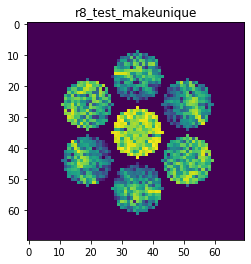

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9072142187058579
>>>replaced the 47. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 720ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 693ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 719ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


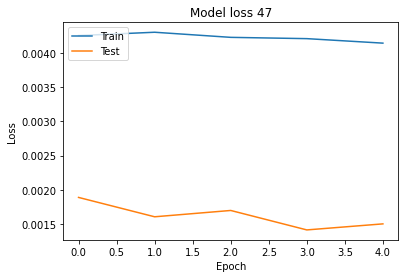

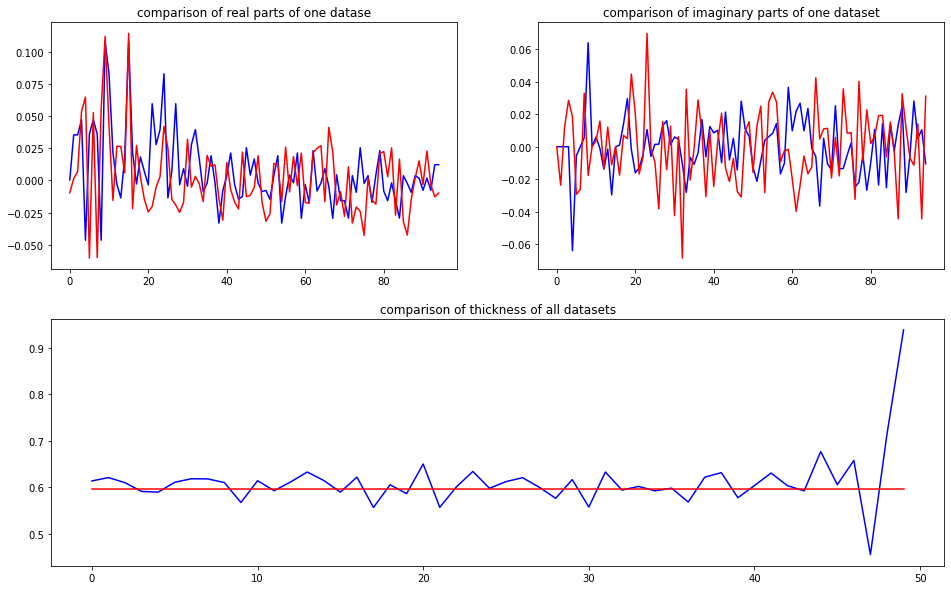

predicted thickness: 0.5960201


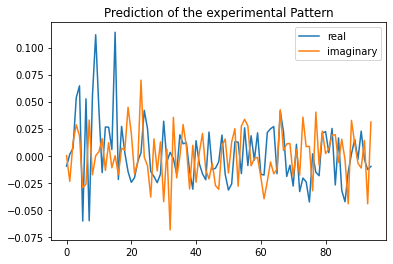

Applied shift of unit cell origin (fractional coordinates): 5.769334055951858e-07 -0.07603464402675558 0.21450731789588307
Ug[ 0 ]: 0.00967 3.14159  =>  0.00967 3.14159
Ug[ 1 ]: 0.0184 -1.34779  =>  0.0184 0.0
Ug[ 2 ]: 0.0184 1.34779  =>  0.0184 0.0
Ug[ 3 ]: 0.05979 0.47774  =>  0.05979 0.0
Ug[ 4 ]: 0.06262 0.29253  =>  0.06262 1.16258
Ug[ 5 ]: 0.0678 -2.66399  =>  0.0678 1.79366
Ug[ 6 ]: 0.05979 -0.47774  =>  0.05979 -0.0
Ug[ 7 ]: 0.0678 2.66399  =>  0.0678 -1.79366
Ug[ 8 ]: 0.06262 -0.29253  =>  0.06262 -1.16258
Ug[ 9 ]: 0.11295 -0.0  =>  0.11295 0.0
Ug[ 10 ]: 0.04226 0.05961  =>  0.04226 1.40741
Ug[ 11 ]: 0.02513 2.41812  =>  0.02513 1.07033
Ug[ 12 ]: 0.02871 -0.36735  =>  0.02871 0.11039
Ug[ 13 ]: 0.02787 0.39125  =>  0.02787 2.21678
Ug[ 14 ]: 0.00908 -1.08587  =>  0.00908 -1.95592
Ug[ 15 ]: 0.11295 0.0  =>  0.11295 -0.0
Ug[ 16 ]: 0.02513 -2.41812  =>  0.02513 -1.07033
Ug[ 17 ]: 0.02871 0.36735  =>  0.02871 -0.11039
Ug[ 18 ]: 0.00908 1.08587  =>  0.00908 1.95592
Ug[ 19 ]: 0.04402 1

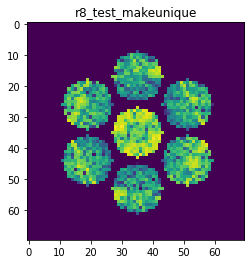

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9304118619840698
>>>replaced the 48. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 5s 689ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


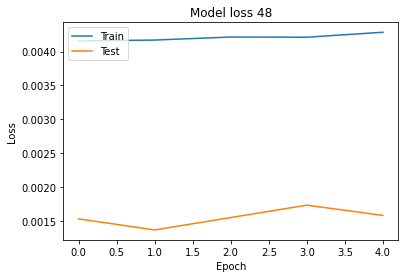

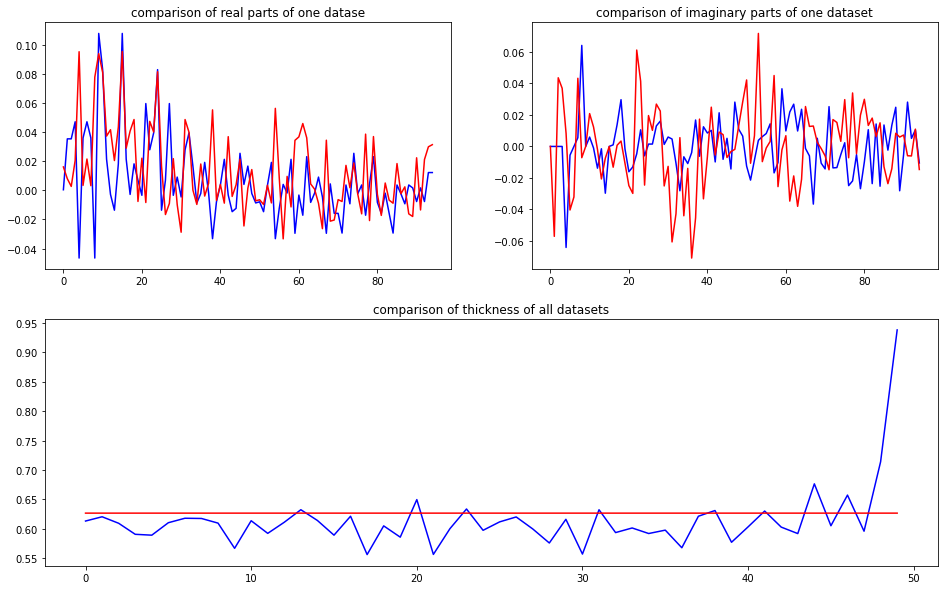

predicted thickness: 0.62672436


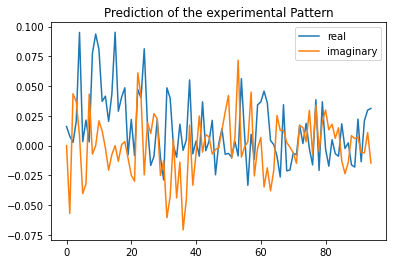

Applied shift of unit cell origin (fractional coordinates): 1.7524130007288874e-06 -0.1630162098052504 0.23332359778170184
Ug[ 0 ]: 0.016 0.0  =>  0.016 0.0
Ug[ 1 ]: 0.05058 -1.46602  =>  0.05058 0.0
Ug[ 2 ]: 0.05058 1.46602  =>  0.05058 -0.0
Ug[ 3 ]: 0.04037 1.02426  =>  0.04037 0.0
Ug[ 4 ]: 0.08672 0.08919  =>  0.08672 0.53094
Ug[ 5 ]: 0.0419 -1.49345  =>  0.0419 2.29946
Ug[ 6 ]: 0.04037 -1.02426  =>  0.04037 -0.0
Ug[ 7 ]: 0.0419 1.49345  =>  0.0419 -2.29946
Ug[ 8 ]: 0.08672 -0.08919  =>  0.08672 -0.53094
Ug[ 9 ]: 0.09451 -1e-05  =>  0.09451 0.0
Ug[ 10 ]: 0.08427 0.27251  =>  0.08427 1.73854
Ug[ 11 ]: 0.03542 0.36806  =>  0.03542 -1.09794
Ug[ 12 ]: 0.04112 -0.03216  =>  0.04112 0.99211
Ug[ 13 ]: 0.02735 -0.82588  =>  0.02735 1.66441
Ug[ 14 ]: 0.04632 -0.11736  =>  0.04632 -0.55911
Ug[ 15 ]: 0.09451 1e-05  =>  0.09451 -0.0
Ug[ 16 ]: 0.03542 -0.36806  =>  0.03542 1.09794
Ug[ 17 ]: 0.04112 0.03216  =>  0.04112 -0.99211
Ug[ 18 ]: 0.04632 0.11736  =>  0.04632 0.55911
Ug[ 19 ]: 0.016 -2.43

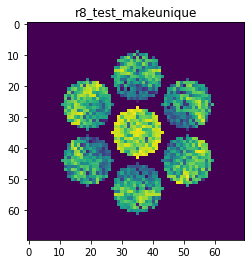

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9135751830202798
>>>replaced the 49. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 706ms/step - loss: 0.0043 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


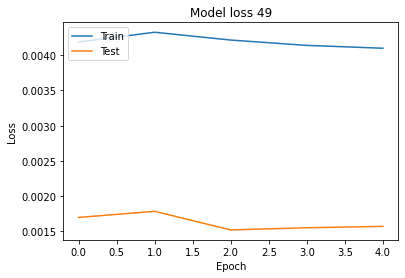

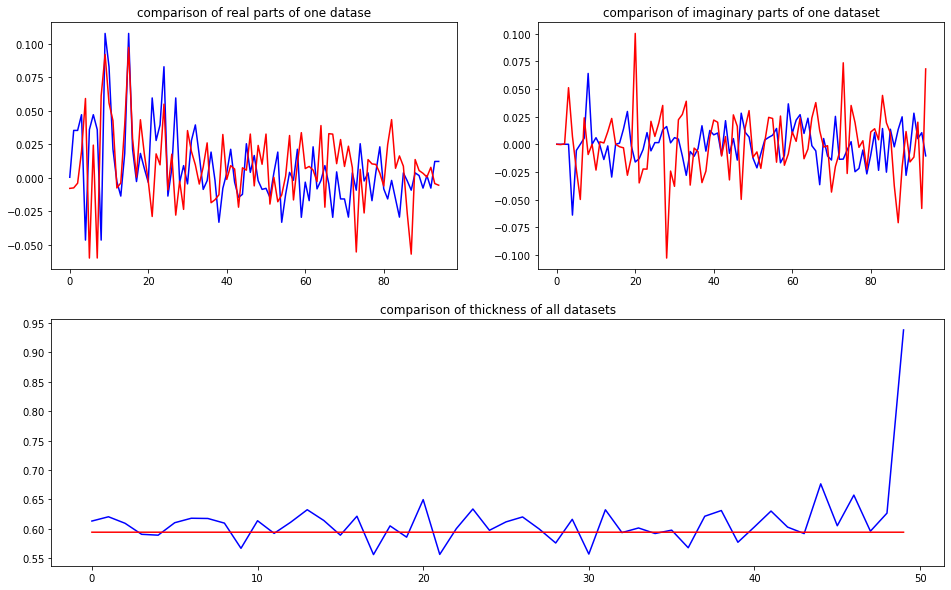

predicted thickness: 0.5943183


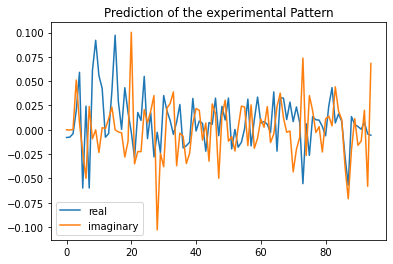

Applied shift of unit cell origin (fractional coordinates): 6.004838662088981e-07 -0.18453124217624314 0.49139100531935204
Ug[ 0 ]: 0.00796 3.14159  =>  0.00796 3.14159
Ug[ 1 ]: 0.00584 -3.0875  =>  0.00584 -0.0
Ug[ 2 ]: 0.00584 3.0875  =>  0.00584 0.0
Ug[ 3 ]: 0.05517 1.15944  =>  0.05517 -0.0
Ug[ 4 ]: 0.06068 0.13475  =>  0.06068 2.06281
Ug[ 5 ]: 0.06436 -2.76797  =>  0.06436 -0.73173
Ug[ 6 ]: 0.05517 -1.15944  =>  0.05517 0.0
Ug[ 7 ]: 0.06436 2.76797  =>  0.06436 0.73173
Ug[ 8 ]: 0.06068 -0.13475  =>  0.06068 -2.06281
Ug[ 9 ]: 0.09462 -0.0  =>  0.09462 0.0
Ug[ 10 ]: 0.05953 -0.37976  =>  0.05953 2.70774
Ug[ 11 ]: 0.03598 0.06237  =>  0.03598 -3.02512
Ug[ 12 ]: 0.0042 2.59332  =>  0.0042 -2.53042
Ug[ 13 ]: 0.00684 2.82236  =>  0.00684 0.78613
Ug[ 14 ]: 0.04867 0.55648  =>  0.04867 -1.37157
Ug[ 15 ]: 0.09462 0.0  =>  0.09462 0.0
Ug[ 16 ]: 0.03598 -0.06237  =>  0.03598 3.02512
Ug[ 17 ]: 0.0042 -2.59332  =>  0.0042 2.53042
Ug[ 18 ]: 0.04867 -0.55648  =>  0.04867 1.37157
Ug[ 19 ]: 0.0234

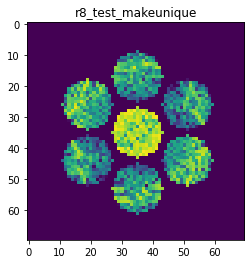

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9369748384273252
>>>replaced the 50. dataset and train: 
Epoch 1/5
8/8 [==============================] - 8s 767ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 756ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 750ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


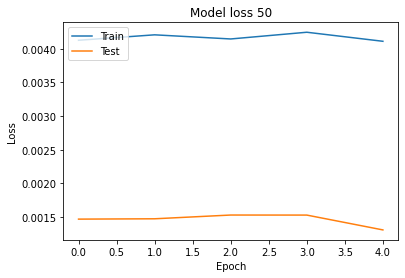

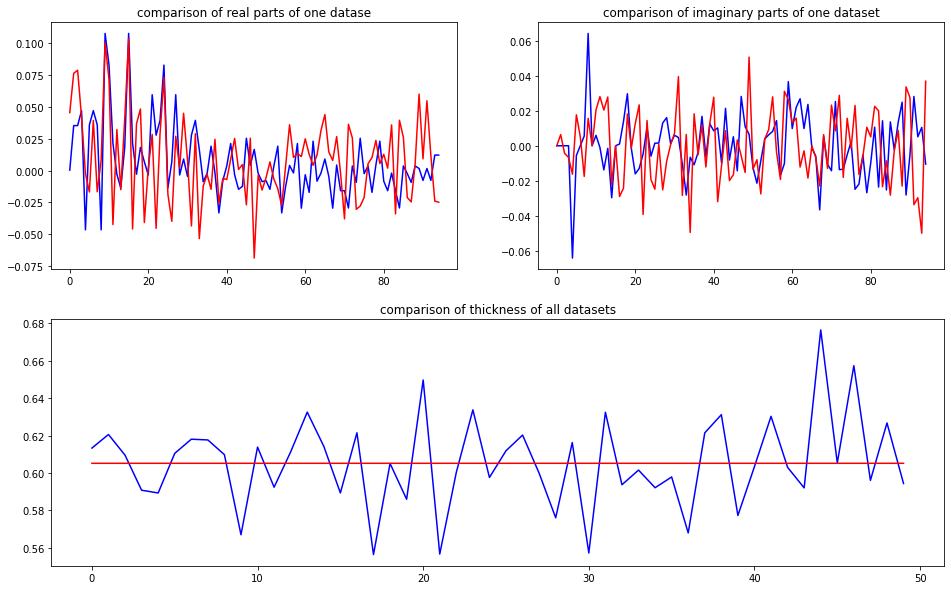

predicted thickness: 0.60514593


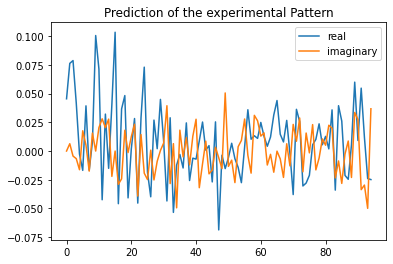

Applied shift of unit cell origin (fractional coordinates): -6.775173165245171e-07 0.022912333123753306 -0.011002207629745932
Ug[ 0 ]: 0.0455 0.0  =>  0.0455 0.0
Ug[ 1 ]: 0.07775 0.06913  =>  0.07775 0.0
Ug[ 2 ]: 0.07775 -0.06913  =>  0.07775 0.0
Ug[ 3 ]: 0.04103 -0.14396  =>  0.04103 0.0
Ug[ 4 ]: 0.01619 -1.39778  =>  0.01619 -1.32294
Ug[ 5 ]: 0.02428 2.33287  =>  0.02428 2.54596
Ug[ 6 ]: 0.04103 0.14396  =>  0.04103 -0.0
Ug[ 7 ]: 0.02428 -2.33287  =>  0.02428 -2.54596
Ug[ 8 ]: 0.01619 1.39778  =>  0.01619 1.32294
Ug[ 9 ]: 0.10203 0.0  =>  0.10203 0.0
Ug[ 10 ]: 0.0749 0.26835  =>  0.0749 0.19922
Ug[ 11 ]: 0.05256 2.56804  =>  0.05256 2.63716
Ug[ 12 ]: 0.04101 0.57443  =>  0.04101 0.43047
Ug[ 13 ]: 0.03121 2.13985  =>  0.03121 1.92675
Ug[ 14 ]: 0.04876 -0.42486  =>  0.04876 -0.4997
Ug[ 15 ]: 0.10203 -0.0  =>  0.10203 -0.0
Ug[ 16 ]: 0.05256 -2.56804  =>  0.05256 -2.63716
Ug[ 17 ]: 0.04101 -0.57443  =>  0.04101 -0.43047
Ug[ 18 ]: 0.04876 0.42486  =>  0.04876 0.4997
Ug[ 19 ]: 0.04034 -3.1

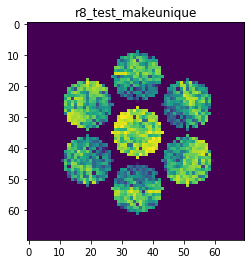

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8641762572536135
>>>replaced the 51. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 705ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


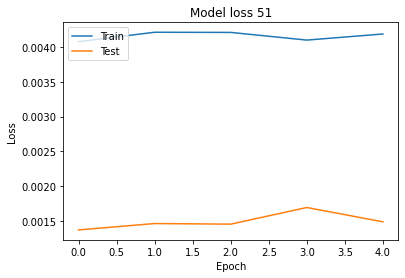

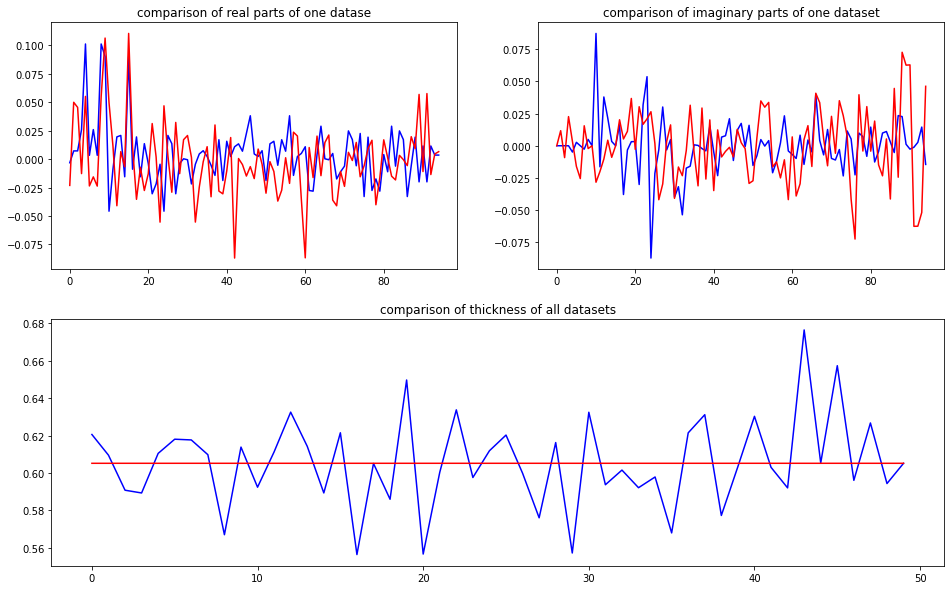

predicted thickness: 0.6051444


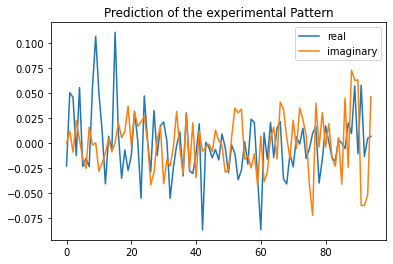

Applied shift of unit cell origin (fractional coordinates): 3.2116584170946076e-06 -0.3347012602653151 -0.03431290485747046
Ug[ 0 ]: 0.02309 3.14159  =>  0.02309 3.14159
Ug[ 1 ]: 0.04887 0.21559  =>  0.04887 0.0
Ug[ 2 ]: 0.04887 -0.21559  =>  0.04887 -0.0
Ug[ 3 ]: 0.02791 2.10299  =>  0.02791 0.0
Ug[ 4 ]: 0.05518 0.04975  =>  0.05518 -2.26884
Ug[ 5 ]: 0.0284 -2.5543  =>  0.0284 1.84149
Ug[ 6 ]: 0.02791 -2.10299  =>  0.02791 -0.0
Ug[ 7 ]: 0.0284 2.5543  =>  0.0284 -1.84149
Ug[ 8 ]: 0.05518 -0.04975  =>  0.05518 2.26884
Ug[ 9 ]: 0.10848 -2e-05  =>  0.10848 0.0
Ug[ 10 ]: 0.05548 -0.51574  =>  0.05548 -0.73131
Ug[ 11 ]: 0.02293 -1.06963  =>  0.02293 -0.85402
Ug[ 12 ]: 0.03894 -2.94024  =>  0.03894 -0.83723
Ug[ 13 ]: 0.00504 0.2455  =>  0.00504 2.13291
Ug[ 14 ]: 0.01224 -2.17457  =>  0.01224 0.14403
Ug[ 15 ]: 0.10848 2e-05  =>  0.10848 -0.0
Ug[ 16 ]: 0.02293 1.06963  =>  0.02293 0.85402
Ug[ 17 ]: 0.03894 2.94024  =>  0.03894 0.83723
Ug[ 18 ]: 0.01224 2.17457  =>  0.01224 -0.14403
Ug[ 19 ]: 

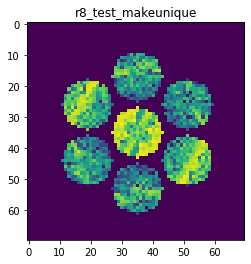

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8769411501596595
>>>replaced the 52. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 723ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 712ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


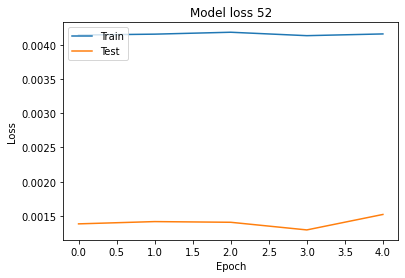

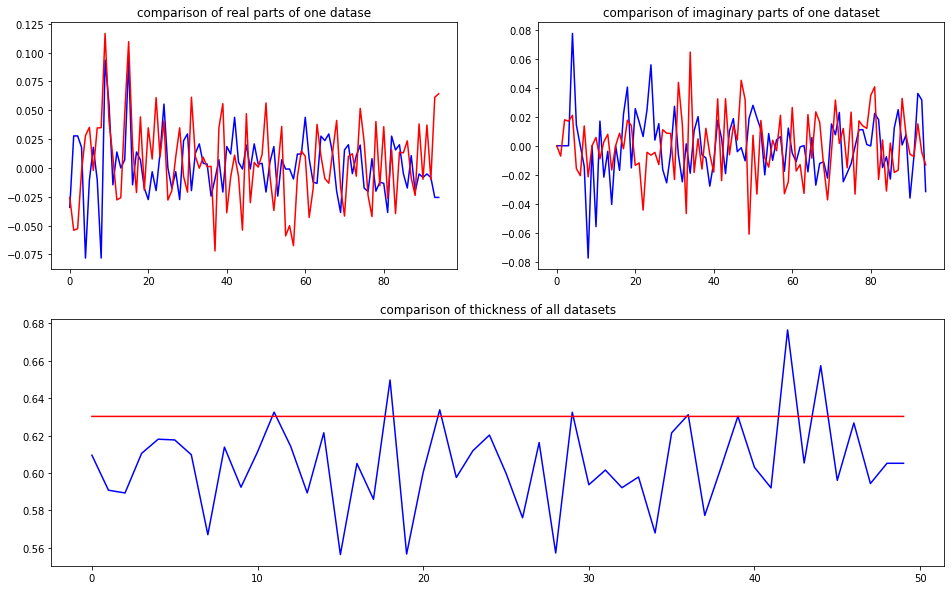

predicted thickness: 0.6302239


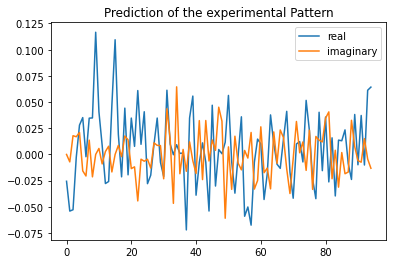

Applied shift of unit cell origin (fractional coordinates): 1.1449618407652984e-06 -0.2710832366280119 0.46344155825545613
Ug[ 0 ]: 0.0256 3.14159  =>  0.0256 3.14159
Ug[ 1 ]: 0.05486 -2.91189  =>  0.05486 -0.0
Ug[ 2 ]: 0.05486 2.91189  =>  0.05486 0.0
Ug[ 3 ]: 0.0189 1.70327  =>  0.0189 -0.0
Ug[ 4 ]: 0.03789 0.59275  =>  0.03789 1.80137
Ug[ 5 ]: 0.03786 -0.39776  =>  0.03786 1.27027
Ug[ 6 ]: 0.0189 -1.70327  =>  0.0189 0.0
Ug[ 7 ]: 0.03786 0.39776  =>  0.03786 -1.27027
Ug[ 8 ]: 0.03789 -0.59275  =>  0.03789 -1.80137
Ug[ 9 ]: 0.11305 -1e-05  =>  0.11305 0.0
Ug[ 10 ]: 0.04122 0.14842  =>  0.04122 3.06032
Ug[ 11 ]: 0.01652 -0.56461  =>  0.01652 2.80669
Ug[ 12 ]: 0.02468 3.04315  =>  0.02468 -1.53676
Ug[ 13 ]: 0.02756 2.91458  =>  0.02756 1.24656
Ug[ 14 ]: 0.04866 -0.36003  =>  0.04866 -1.56864
Ug[ 15 ]: 0.11305 1e-05  =>  0.11305 -0.0
Ug[ 16 ]: 0.01652 0.56461  =>  0.01652 -2.80669
Ug[ 17 ]: 0.02468 -3.04315  =>  0.02468 1.53676
Ug[ 18 ]: 0.04866 0.36003  =>  0.04866 1.56864
Ug[ 19 ]: 0.

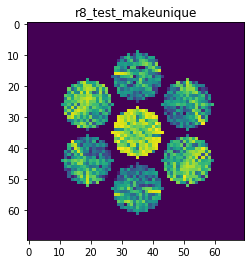

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9213755378802958
>>>replaced the 53. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 713ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0042 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


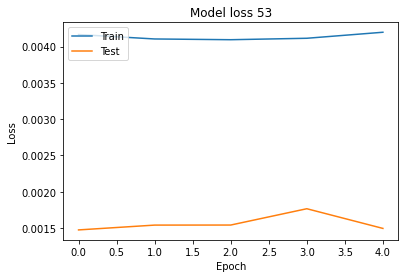

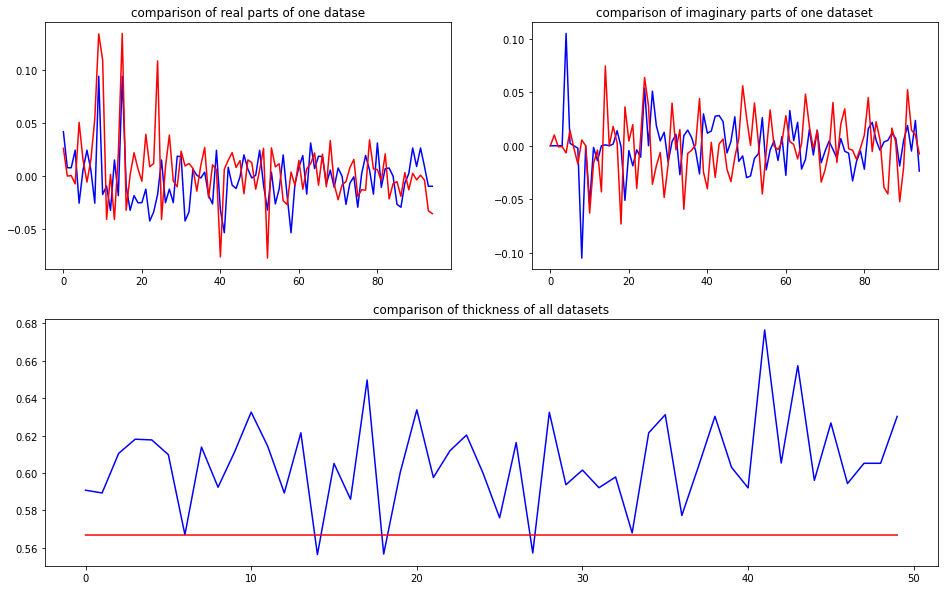

predicted thickness: 0.5667762


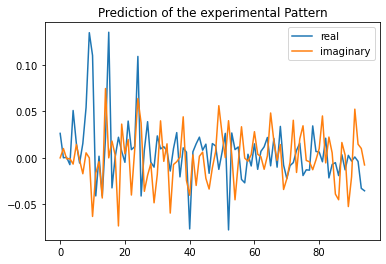

Applied shift of unit cell origin (fractional coordinates): 2.2899934744254027e-06 -0.48065242223740007 -0.24036449074525645
Ug[ 0 ]: 0.02629 0.0  =>  0.02629 0.0
Ug[ 1 ]: 0.00553 1.51025  =>  0.00553 0.0
Ug[ 2 ]: 0.00553 -1.51025  =>  0.00553 -0.0
Ug[ 3 ]: 0.00648 3.02003  =>  0.00648 0.0
Ug[ 4 ]: 0.05287 -0.11455  =>  0.05287 1.63835
Ug[ 5 ]: 0.02206 0.79144  =>  0.02206 -0.71833
Ug[ 6 ]: 0.00648 -3.02003  =>  0.00648 -0.0
Ug[ 7 ]: 0.02206 -0.79144  =>  0.02206 0.71833
Ug[ 8 ]: 0.05287 0.11455  =>  0.05287 -1.63835
Ug[ 9 ]: 0.13464 -1e-05  =>  0.13464 0.0
Ug[ 10 ]: 0.12641 -0.52472  =>  0.12641 -2.03496
Ug[ 11 ]: 0.04038 -2.70233  =>  0.04038 -1.19206
Ug[ 12 ]: 0.00373 -1.16833  =>  0.00373 1.85171
Ug[ 13 ]: 0.05742 -2.36487  =>  0.05742 -0.85508
Ug[ 14 ]: 0.07693 1.28257  =>  0.07693 -0.47032
Ug[ 15 ]: 0.13464 1e-05  =>  0.13464 0.0
Ug[ 16 ]: 0.04038 2.70233  =>  0.04038 1.19206
Ug[ 17 ]: 0.00373 1.16833  =>  0.00373 -1.85171
Ug[ 18 ]: 0.07693 -1.28257  =>  0.07693 0.47032
Ug[ 19 ]:

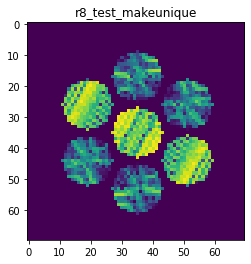

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9509567551342681
>>>replaced the 54. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 710ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 748ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 744ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


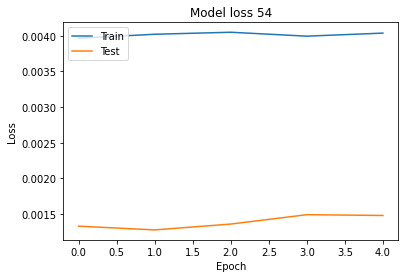

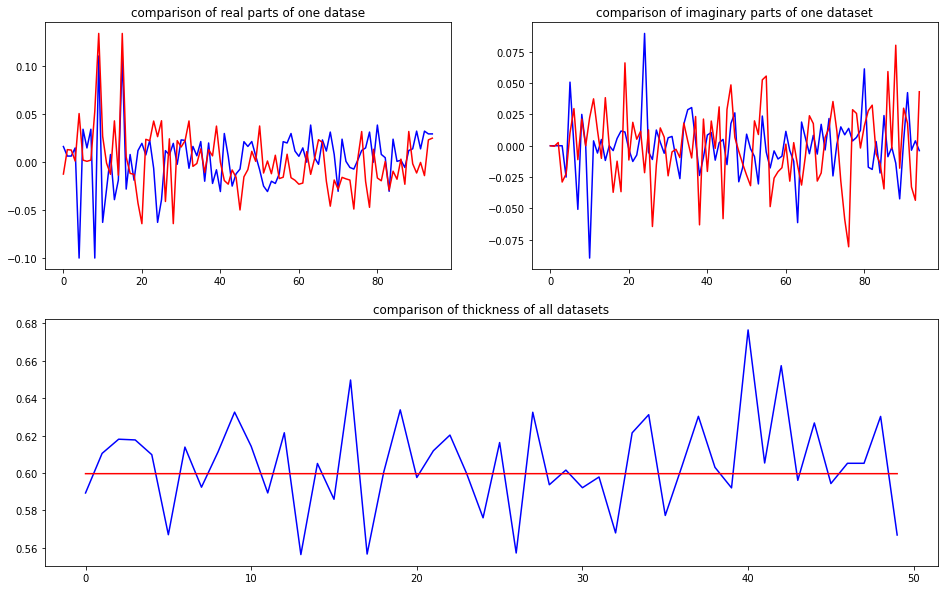

predicted thickness: 0.5995967


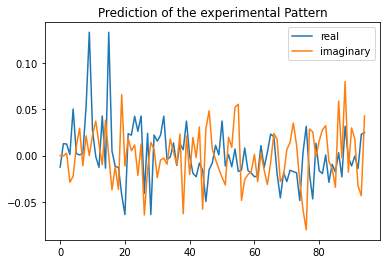

Applied shift of unit cell origin (fractional coordinates): 2.75224042874223e-07 0.2449216206103734 0.018525496986661408
Ug[ 0 ]: 0.01247 3.14159  =>  0.01247 3.14159
Ug[ 1 ]: 0.01279 -0.1164  =>  0.01279 0.0
Ug[ 2 ]: 0.01279 0.1164  =>  0.01279 0.0
Ug[ 3 ]: 0.02931 -1.53889  =>  0.02931 0.0
Ug[ 4 ]: 0.05606 -0.40097  =>  0.05606 1.25431
Ug[ 5 ]: 0.01088 1.38331  =>  0.01088 2.8058
Ug[ 6 ]: 0.02931 1.53889  =>  0.02931 -0.0
Ug[ 7 ]: 0.01088 -1.38331  =>  0.01088 -2.8058
Ug[ 8 ]: 0.05606 0.40097  =>  0.05606 -1.25431
Ug[ 9 ]: 0.1337 -0.0  =>  0.1337 -0.0
Ug[ 10 ]: 0.03446 0.68888  =>  0.03446 0.80528
Ug[ 11 ]: 0.03734 1.51775  =>  0.03734 1.40135
Ug[ 12 ]: 0.01737 2.35404  =>  0.01737 0.81515
Ug[ 13 ]: 0.04436 -0.259  =>  0.04436 -1.68148
Ug[ 14 ]: 0.03978 1.90975  =>  0.03978 0.25446
Ug[ 15 ]: 0.1337 0.0  =>  0.1337 0.0
Ug[ 16 ]: 0.03734 -1.51775  =>  0.03734 -1.40135
Ug[ 17 ]: 0.01737 -2.35404  =>  0.01737 -0.81515
Ug[ 18 ]: 0.03978 -1.90975  =>  0.03978 -0.25446
Ug[ 19 ]: 0.07751 2.1

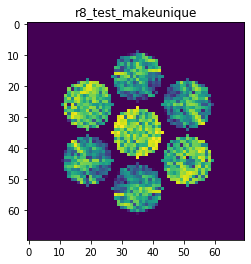

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8952139673363606
>>>replaced the 55. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 723ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


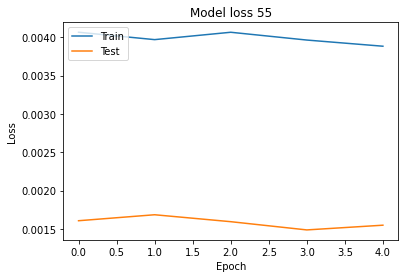

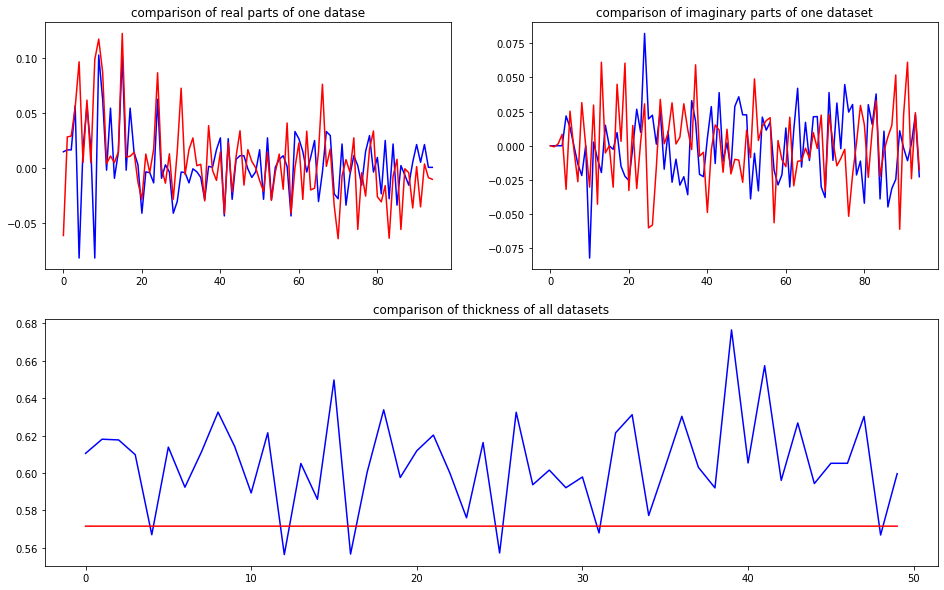

predicted thickness: 0.5715143


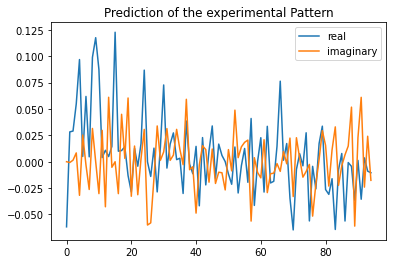

Applied shift of unit cell origin (fractional coordinates): 4.505318387998869e-07 -0.015557126576639426 0.006219605515488889
Ug[ 0 ]: 0.06171 3.14159  =>  0.06171 3.14159
Ug[ 1 ]: 0.02868 -0.03908  =>  0.02868 0.0
Ug[ 2 ]: 0.02868 0.03908  =>  0.02868 0.0
Ug[ 3 ]: 0.05864 0.09775  =>  0.05864 0.0
Ug[ 4 ]: 0.10287 -0.31316  =>  0.10287 -0.37183
Ug[ 5 ]: 0.02624 1.38633  =>  0.02624 1.2495
Ug[ 6 ]: 0.05864 -0.09775  =>  0.05864 0.0
Ug[ 7 ]: 0.02624 -1.38633  =>  0.02624 -1.2495
Ug[ 8 ]: 0.10287 0.31316  =>  0.10287 0.37183
Ug[ 9 ]: 0.12011 -0.0  =>  0.12011 0.0
Ug[ 10 ]: 0.09222 -0.3363  =>  0.09222 -0.29722
Ug[ 11 ]: 0.03079 1.34285  =>  0.03079 1.30378
Ug[ 12 ]: 0.0451 -1.33136  =>  0.0451 -1.23361
Ug[ 13 ]: 0.06058 1.53174  =>  0.06058 1.66857
Ug[ 14 ]: 0.01494 -0.28675  =>  0.01494 -0.22807
Ug[ 15 ]: 0.12011 0.0  =>  0.12011 0.0
Ug[ 16 ]: 0.03079 -1.34285  =>  0.03079 -1.30378
Ug[ 17 ]: 0.0451 1.33136  =>  0.0451 1.23361
Ug[ 18 ]: 0.01494 0.28675  =>  0.01494 0.22807
Ug[ 19 ]: 0.0606

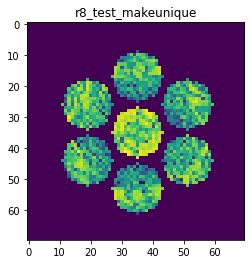

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8322031432506926
>>>replaced the 56. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 723ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 748ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 750ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


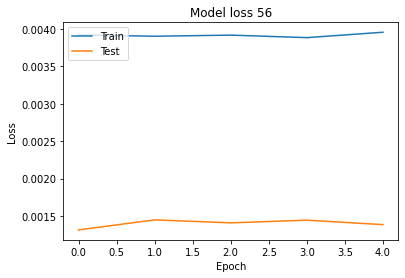

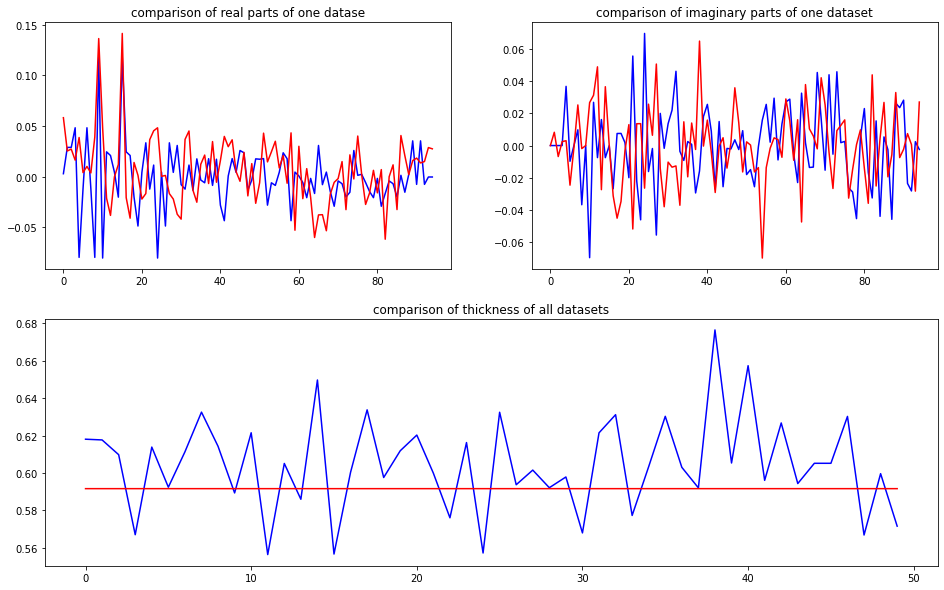

predicted thickness: 0.5915788


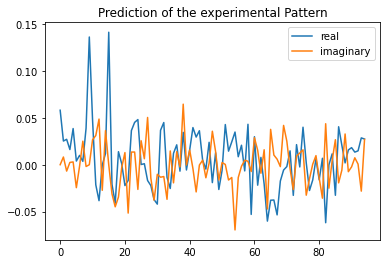

Applied shift of unit cell origin (fractional coordinates): 7.983412923584111e-07 -0.023098739078325745 -0.04444521784622699
Ug[ 0 ]: 0.05818 0.0  =>  0.05818 0.0
Ug[ 1 ]: 0.02727 0.27926  =>  0.02727 0.0
Ug[ 2 ]: 0.02727 -0.27926  =>  0.02727 -0.0
Ug[ 3 ]: 0.01324 0.14513  =>  0.01324 0.0
Ug[ 4 ]: 0.03893 0.06278  =>  0.03893 -0.36162
Ug[ 5 ]: 0.02511 -1.42064  =>  0.02511 -1.28651
Ug[ 6 ]: 0.01324 -0.14513  =>  0.01324 0.0
Ug[ 7 ]: 0.02511 1.42064  =>  0.02511 1.28651
Ug[ 8 ]: 0.03893 -0.06278  =>  0.03893 0.36162
Ug[ 9 ]: 0.13894 -1e-05  =>  0.13894 0.0
Ug[ 10 ]: 0.05494 0.50299  =>  0.05494 0.22374
Ug[ 11 ]: 0.03764 2.16734  =>  0.03764 2.4466
Ug[ 12 ]: 0.06146 2.27486  =>  0.06146 2.41999
Ug[ 13 ]: 0.02646 -1.57248  =>  0.02646 -1.7066
Ug[ 14 ]: 0.03778 1.22151  =>  0.03778 1.6459
Ug[ 15 ]: 0.13894 1e-05  =>  0.13894 0.0
Ug[ 16 ]: 0.03764 -2.16734  =>  0.03764 -2.4466
Ug[ 17 ]: 0.06146 -2.27486  =>  0.06146 -2.41999
Ug[ 18 ]: 0.03778 -1.22151  =>  0.03778 -1.6459
Ug[ 19 ]: 0.0049 

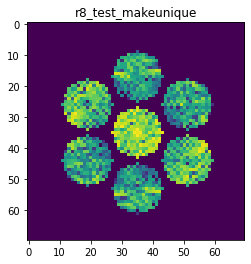

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8786112509786604
>>>replaced the 57. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 777ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 757ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 756ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 748ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


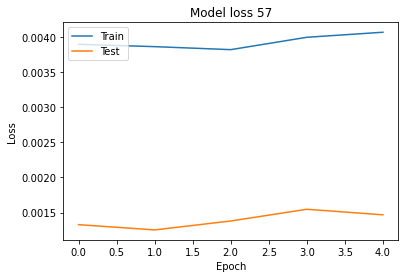

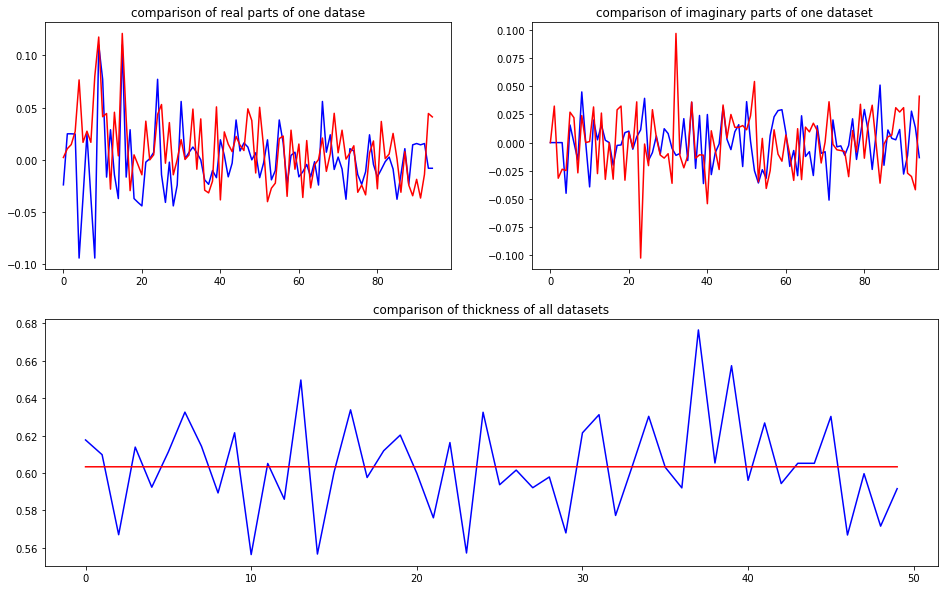

predicted thickness: 0.6032741


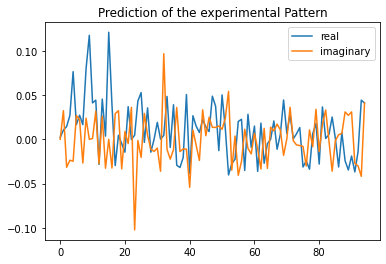

Applied shift of unit cell origin (fractional coordinates): 1.1691263154417662e-06 0.11150462671924677 -0.1906894851752929
Ug[ 0 ]: 0.00209 0.0  =>  0.00209 0.0
Ug[ 1 ]: 0.03433 1.19814  =>  0.03433 0.0
Ug[ 2 ]: 0.03433 -1.19814  =>  0.03433 0.0
Ug[ 3 ]: 0.03547 -0.7006  =>  0.03547 -0.0
Ug[ 4 ]: 0.0819 -0.30215  =>  0.0819 -0.79968
Ug[ 5 ]: 0.03161 1.0178  =>  0.03161 2.91654
Ug[ 6 ]: 0.03547 0.7006  =>  0.03547 0.0
Ug[ 7 ]: 0.03161 -1.0178  =>  0.03161 -2.91654
Ug[ 8 ]: 0.0819 0.30215  =>  0.0819 0.79968
Ug[ 9 ]: 0.11927 -1e-05  =>  0.11927 0.0
Ug[ 10 ]: 0.04226 0.02613  =>  0.04226 -1.172
Ug[ 11 ]: 0.05247 0.65645  =>  0.05247 1.85459
Ug[ 12 ]: 0.04047 -2.36824  =>  0.04047 -3.06884
Ug[ 13 ]: 0.0544 0.44283  =>  0.0544 -1.45591
Ug[ 14 ]: 0.03275 -1.44448  =>  0.03275 -0.94694
Ug[ 15 ]: 0.11927 1e-05  =>  0.11927 0.0
Ug[ 16 ]: 0.05247 -0.65645  =>  0.05247 -1.85459
Ug[ 17 ]: 0.04047 2.36824  =>  0.04047 3.06884
Ug[ 18 ]: 0.03275 1.44448  =>  0.03275 0.94694
Ug[ 19 ]: 0.03153 -1.70138

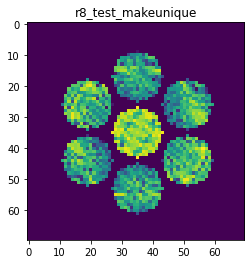

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9280671988349886
>>>replaced the 58. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


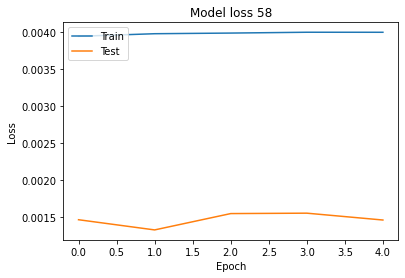

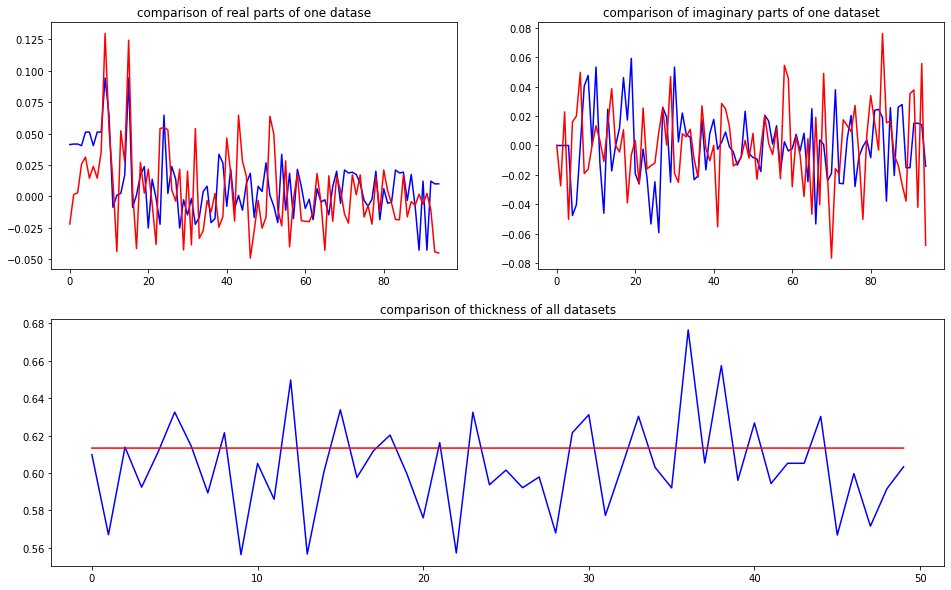

predicted thickness: 0.613288


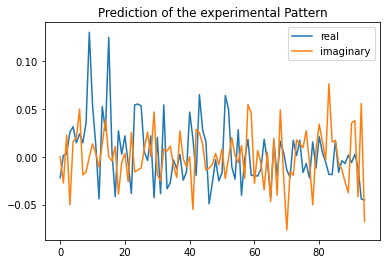

Applied shift of unit cell origin (fractional coordinates): 7.739924753259754e-07 0.17652537601992088 0.23639988464167405
Ug[ 0 ]: 0.02204 3.14159  =>  0.02204 3.14159
Ug[ 1 ]: 0.02517 -1.48534  =>  0.02517 0.0
Ug[ 2 ]: 0.02517 1.48534  =>  0.02517 -0.0
Ug[ 3 ]: 0.0557 -1.10914  =>  0.0557 0.0
Ug[ 4 ]: 0.03697 0.44844  =>  0.03697 3.04293
Ug[ 5 ]: 0.02428 0.93103  =>  0.02428 0.55483
Ug[ 6 ]: 0.0557 1.10914  =>  0.0557 0.0
Ug[ 7 ]: 0.02428 -0.93103  =>  0.02428 -0.55483
Ug[ 8 ]: 0.03697 -0.44844  =>  0.03697 -3.04293
Ug[ 9 ]: 0.1271 -0.0  =>  0.1271 -0.0
Ug[ 10 ]: 0.05596 0.24386  =>  0.05596 1.72921
Ug[ 11 ]: 0.0095 0.42297  =>  0.0095 -1.06237
Ug[ 12 ]: 0.04407 -2.8951  =>  0.04407 2.27895
Ug[ 13 ]: 0.05418 0.23973  =>  0.05418 0.61594
Ug[ 14 ]: 0.04735 0.95893  =>  0.04735 -1.63555
Ug[ 15 ]: 0.1271 0.0  =>  0.1271 0.0
Ug[ 16 ]: 0.0095 -0.42297  =>  0.0095 1.06237
Ug[ 17 ]: 0.04407 2.8951  =>  0.04407 -2.27895
Ug[ 18 ]: 0.04735 -0.95893  =>  0.04735 1.63555
Ug[ 19 ]: 0.00866 -1.11509

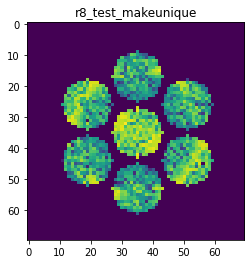

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8685498848104531
>>>replaced the 59. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


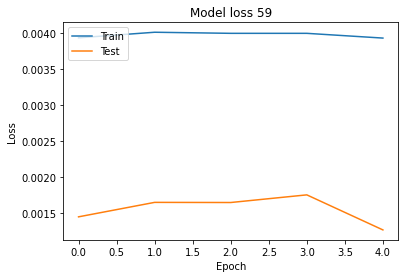

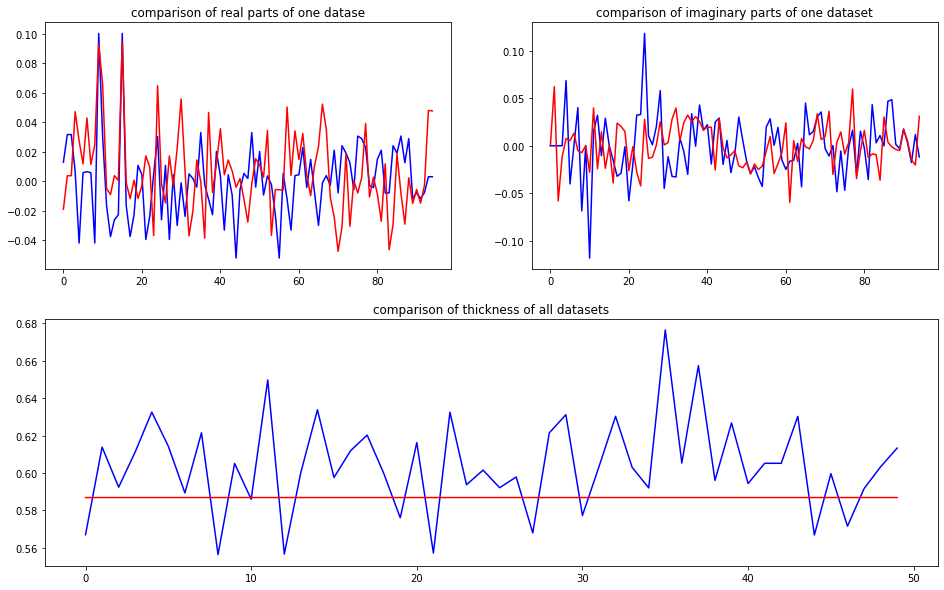

predicted thickness: 0.58681685


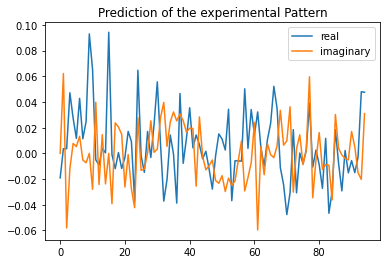

Applied shift of unit cell origin (fractional coordinates): -2.31597787767676e-06 0.04322445743251474 -0.24035246454073503
Ug[ 0 ]: 0.01909 3.14159  =>  0.01909 3.14159
Ug[ 1 ]: 0.06018 1.51018  =>  0.06018 0.0
Ug[ 2 ]: 0.06018 -1.51018  =>  0.06018 -0.0
Ug[ 3 ]: 0.0467 -0.27159  =>  0.0467 0.0
Ug[ 4 ]: 0.02714 0.27996  =>  0.02714 -0.95863
Ug[ 5 ]: 0.01266 0.42376  =>  0.01266 2.20553
Ug[ 6 ]: 0.0467 0.27159  =>  0.0467 -0.0
Ug[ 7 ]: 0.01266 -0.42376  =>  0.01266 -2.20553
Ug[ 8 ]: 0.02714 -0.27996  =>  0.02714 0.95863
Ug[ 9 ]: 0.09365 1e-05  =>  0.09365 0.0
Ug[ 10 ]: 0.0708 -0.40449  =>  0.0708 -1.91468
Ug[ 11 ]: 0.03957 1.64552  =>  0.03957 -3.1275
Ug[ 12 ]: 0.02621 -1.98327  =>  0.02621 -2.25487
Ug[ 13 ]: 0.01391 1.50543  =>  0.01391 -0.27635
Ug[ 14 ]: 0.02213 -1.54624  =>  0.02213 -0.30766
Ug[ 15 ]: 0.09365 -1e-05  =>  0.09365 -0.0
Ug[ 16 ]: 0.03957 -1.64552  =>  0.03957 3.1275
Ug[ 17 ]: 0.02621 1.98327  =>  0.02621 2.25487
Ug[ 18 ]: 0.02213 1.54624  =>  0.02213 0.30766
Ug[ 19 ]: 0

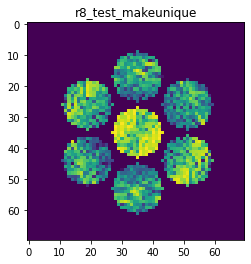

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8960326910458017
>>>replaced the 60. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 722ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


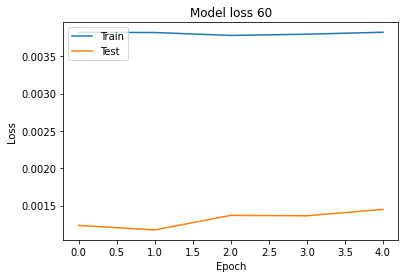

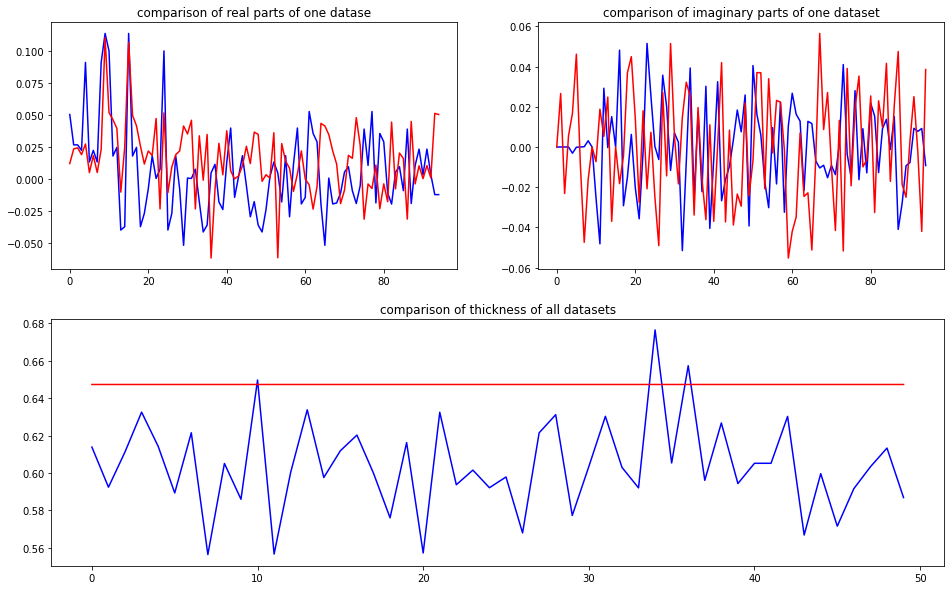

predicted thickness: 0.64730763


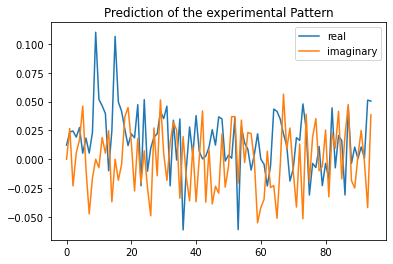

Applied shift of unit cell origin (fractional coordinates): 2.0988264044167374e-06 -0.05613936868731367 -0.1276320864169166
Ug[ 0 ]: 0.01225 0.0  =>  0.01225 0.0
Ug[ 1 ]: 0.0346 0.80194  =>  0.0346 0.0
Ug[ 2 ]: 0.0346 -0.80194  =>  0.0346 -0.0
Ug[ 3 ]: 0.02001 0.35273  =>  0.02001 0.0
Ug[ 4 ]: 0.03029 0.57646  =>  0.03029 -0.57821
Ug[ 5 ]: 0.04707 1.45924  =>  0.04707 1.90844
Ug[ 6 ]: 0.02001 -0.35273  =>  0.02001 -0.0
Ug[ 7 ]: 0.04707 -1.45924  =>  0.04707 -1.90844
Ug[ 8 ]: 0.03029 -0.57646  =>  0.03029 0.57821
Ug[ 9 ]: 0.10846 -1e-05  =>  0.10846 -0.0
Ug[ 10 ]: 0.05236 -0.14049  =>  0.05236 -0.94241
Ug[ 11 ]: 0.05153 0.36767  =>  0.05153 1.16962
Ug[ 12 ]: 0.04097 0.11972  =>  0.04097 0.47246
Ug[ 13 ]: 0.02684 1.96107  =>  0.02684 1.51188
Ug[ 14 ]: 0.04489 -0.96654  =>  0.04489 0.18814
Ug[ 15 ]: 0.10846 1e-05  =>  0.10846 0.0
Ug[ 16 ]: 0.05153 -0.36767  =>  0.05153 -1.16962
Ug[ 17 ]: 0.04097 -0.11972  =>  0.04097 -0.47246
Ug[ 18 ]: 0.04489 0.96654  =>  0.04489 -0.18814
Ug[ 19 ]: 0.048

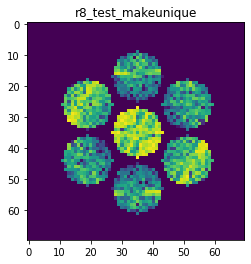

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9238381096546198
>>>replaced the 61. dataset and train: 
Epoch 1/5
8/8 [==============================] - 8s 796ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 751ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0019 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0041 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 756ms/step - loss: 0.0040 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000


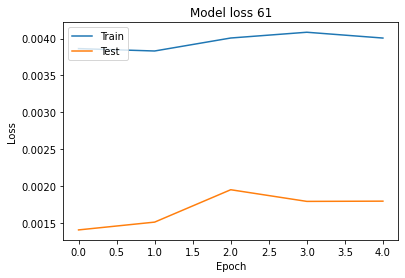

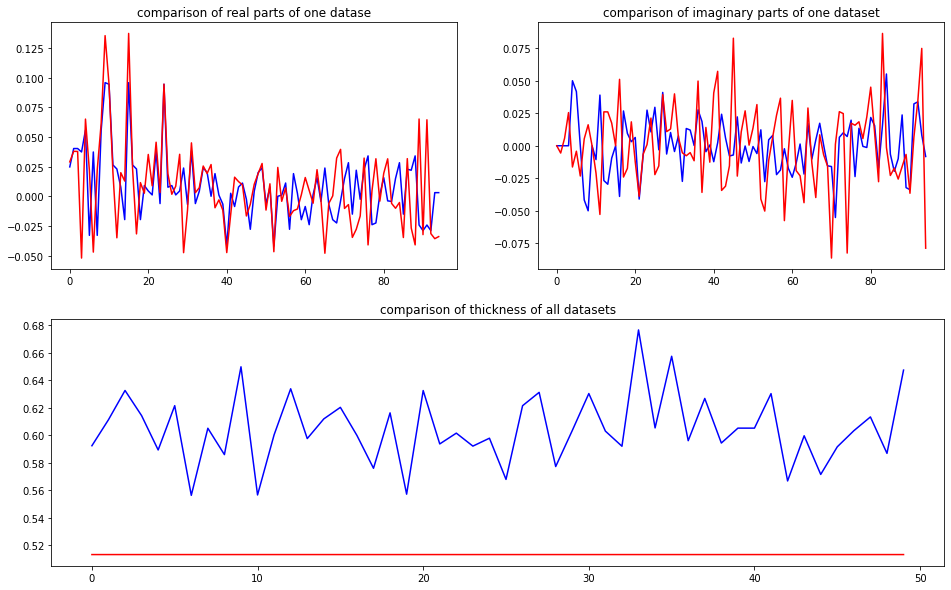

predicted thickness: 0.5132856


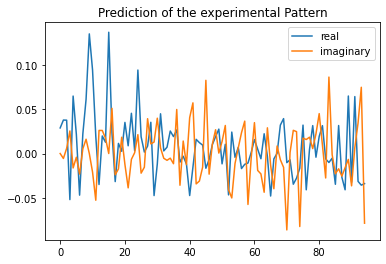

Applied shift of unit cell origin (fractional coordinates): -1.575676987178367e-07 -0.427265477303166 0.023928968232107266
Ug[ 0 ]: 0.0289 0.0  =>  0.0289 0.0
Ug[ 1 ]: 0.0382 -0.15035  =>  0.0382 0.0
Ug[ 2 ]: 0.0382 0.15035  =>  0.0382 0.0
Ug[ 3 ]: 0.0553 2.68459  =>  0.0553 -0.0
Ug[ 4 ]: 0.06521 -0.25182  =>  0.06521 -2.78606
Ug[ 5 ]: 0.02238 -0.21456  =>  0.02238 -3.0495
Ug[ 6 ]: 0.0553 -2.68459  =>  0.0553 0.0
Ug[ 7 ]: 0.02238 0.21456  =>  0.02238 3.0495
Ug[ 8 ]: 0.06521 0.25182  =>  0.06521 2.78606
Ug[ 9 ]: 0.13623 0.0  =>  0.13623 0.0
Ug[ 10 ]: 0.09677 -0.22051  =>  0.09677 -0.07017
Ug[ 11 ]: 0.05624 -1.17932  =>  0.05624 -1.32967
Ug[ 12 ]: 0.04179 2.4977  =>  0.04179 -1.1009
Ug[ 13 ]: 0.03095 0.89447  =>  0.03095 -2.55378
Ug[ 14 ]: 0.02121 0.9641  =>  0.02121 -2.78485
Ug[ 15 ]: 0.13623 -0.0  =>  0.13623 -0.0
Ug[ 16 ]: 0.05624 1.17932  =>  0.05624 1.32967
Ug[ 17 ]: 0.04179 -2.4977  =>  0.04179 1.1009
Ug[ 18 ]: 0.02121 -0.9641  =>  0.02121 2.78485
Ug[ 19 ]: 0.01709 1.44865  =>  0.0

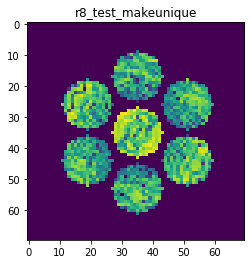

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9080996290717752
>>>replaced the 62. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0039 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


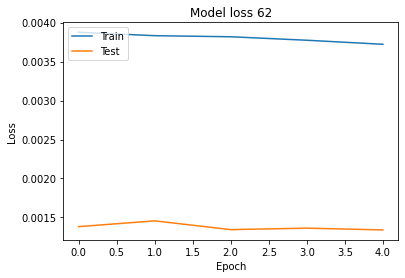

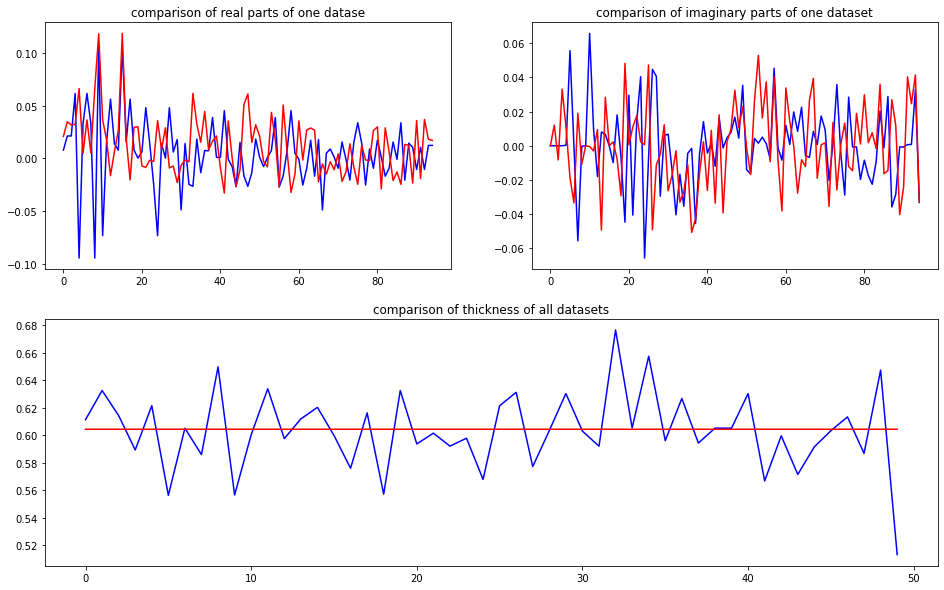

predicted thickness: 0.6043399


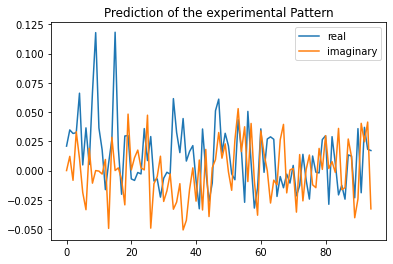

Applied shift of unit cell origin (fractional coordinates): 6.363950635731337e-07 -0.1223079706461935 -0.047556376658155035
Ug[ 0 ]: 0.0209 0.0  =>  0.0209 0.0
Ug[ 1 ]: 0.03477 0.29881  =>  0.03477 0.0
Ug[ 2 ]: 0.03477 -0.29881  =>  0.03477 0.0
Ug[ 3 ]: 0.04792 0.76848  =>  0.04792 -0.0
Ug[ 4 ]: 0.06715 0.15817  =>  0.06715 -0.90912
Ug[ 5 ]: 0.01954 -1.31117  =>  0.01954 -1.78084
Ug[ 6 ]: 0.04792 -0.76848  =>  0.04792 0.0
Ug[ 7 ]: 0.01954 1.31117  =>  0.01954 1.78084
Ug[ 8 ]: 0.06715 -0.15817  =>  0.06715 0.90912
Ug[ 9 ]: 0.11812 -0.0  =>  0.11812 -0.0
Ug[ 10 ]: 0.03617 -0.01422  =>  0.03617 -0.31302
Ug[ 11 ]: 0.01847 -0.14373  =>  0.01847 0.15508
Ug[ 12 ]: 0.02021 2.70144  =>  0.02021 -2.81326
Ug[ 13 ]: 0.04897 -1.41747  =>  0.04897 -0.94779
Ug[ 14 ]: 0.0403 0.79885  =>  0.0403 1.86614
Ug[ 15 ]: 0.11812 0.0  =>  0.11812 0.0
Ug[ 16 ]: 0.01847 0.14373  =>  0.01847 -0.15508
Ug[ 17 ]: 0.02021 -2.70144  =>  0.02021 2.81326
Ug[ 18 ]: 0.0403 -0.79885  =>  0.0403 -1.86614
Ug[ 19 ]: 0.05699 1.

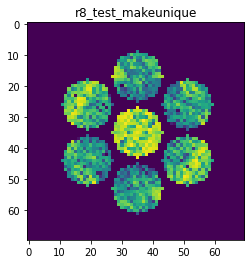

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8402140893301845
>>>replaced the 63. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0038 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


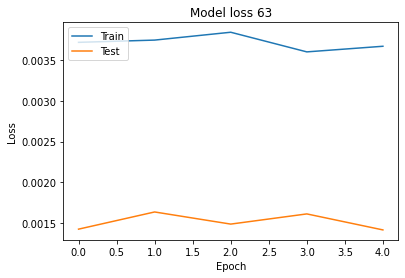

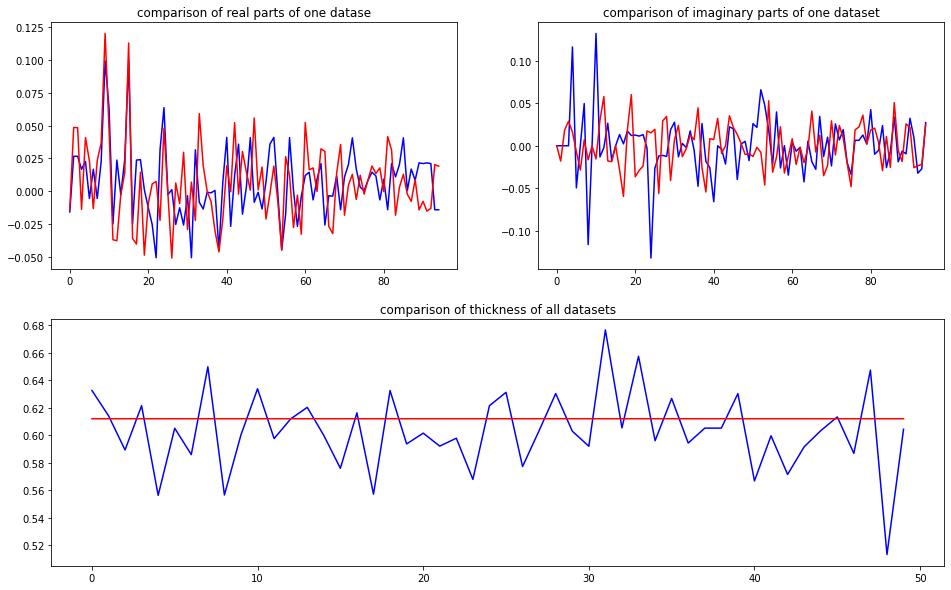

predicted thickness: 0.6119773


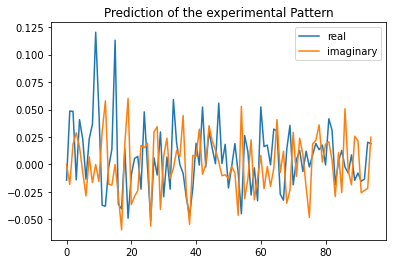

Applied shift of unit cell origin (fractional coordinates): -7.040812254728555e-07 -0.32080717576240614 0.05735291038663738
Ug[ 0 ]: 0.01423 3.14159  =>  0.01423 3.14159
Ug[ 1 ]: 0.05176 -0.36036  =>  0.05176 -0.0
Ug[ 2 ]: 0.05176 0.36036  =>  0.05176 0.0
Ug[ 3 ]: 0.03179 2.01569  =>  0.03179 0.0
Ug[ 4 ]: 0.04202 0.39789  =>  0.04202 -1.25744
Ug[ 5 ]: 0.02423 -0.2918  =>  0.02423 -2.66785
Ug[ 6 ]: 0.03179 -2.01569  =>  0.03179 0.0
Ug[ 7 ]: 0.02423 0.2918  =>  0.02423 2.66785
Ug[ 8 ]: 0.04202 -0.39789  =>  0.04202 1.25744
Ug[ 9 ]: 0.11664 0.0  =>  0.11664 0.0
Ug[ 10 ]: 0.05035 -0.31039  =>  0.05035 0.04996
Ug[ 11 ]: 0.04675 2.47181  =>  0.04675 2.11145
Ug[ 12 ]: 0.07058 2.15918  =>  0.07058 -2.10832
Ug[ 13 ]: 0.01871 -1.69392  =>  0.01871 0.68213
Ug[ 14 ]: 0.02344 -0.92589  =>  0.02344 0.72944
Ug[ 15 ]: 0.11664 -0.0  =>  0.11664 -0.0
Ug[ 16 ]: 0.04675 -2.47181  =>  0.04675 -2.11145
Ug[ 17 ]: 0.07058 -2.15918  =>  0.07058 2.10832
Ug[ 18 ]: 0.02344 0.92589  =>  0.02344 -0.72944
Ug[ 19 ]: 

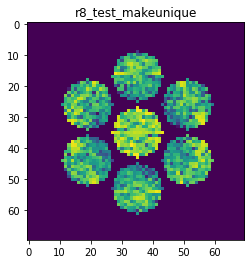

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8633578497306394
>>>replaced the 64. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 753ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 767ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 765ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 763ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


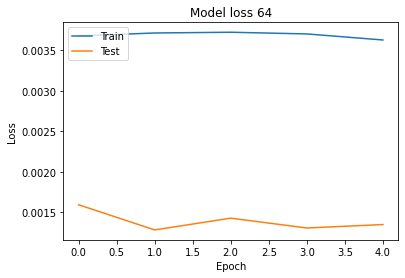

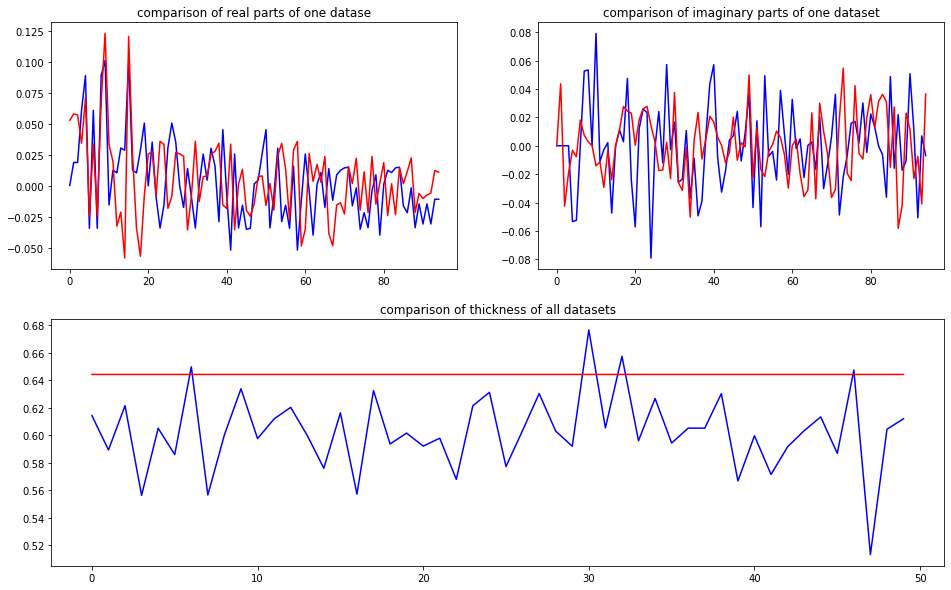

predicted thickness: 0.6441394


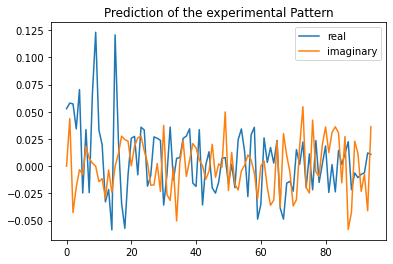

Applied shift of unit cell origin (fractional coordinates): 8.397403528735362e-07 0.07975282453835704 -0.10229944215505671
Ug[ 0 ]: 0.05289 0.0  =>  0.05289 0.0
Ug[ 1 ]: 0.07198 0.64277  =>  0.07198 0.0
Ug[ 2 ]: 0.07198 -0.64277  =>  0.07198 0.0
Ug[ 3 ]: 0.03878 -0.5011  =>  0.03878 -0.0
Ug[ 4 ]: 0.06907 -0.04383  =>  0.06907 -0.1855
Ug[ 5 ]: 0.02558 -2.84095  =>  0.02558 -1.69708
Ug[ 6 ]: 0.03878 0.5011  =>  0.03878 0.0
Ug[ 7 ]: 0.02558 2.84095  =>  0.02558 1.69708
Ug[ 8 ]: 0.06907 0.04383  =>  0.06907 0.1855
Ug[ 9 ]: 0.1219 -1e-05  =>  0.1219 -0.0
Ug[ 10 ]: 0.03618 -0.4021  =>  0.03618 -1.04486
Ug[ 11 ]: 0.02503 -0.47214  =>  0.02503 0.17064
Ug[ 12 ]: 0.04387 -2.43472  =>  0.04387 -2.93582
Ug[ 13 ]: 0.02012 -2.97373  =>  0.02012 2.16559
Ug[ 14 ]: 0.06265 -2.74493  =>  0.06265 -2.60326
Ug[ 15 ]: 0.1219 1e-05  =>  0.1219 0.0
Ug[ 16 ]: 0.02503 0.47214  =>  0.02503 -0.17064
Ug[ 17 ]: 0.04387 2.43472  =>  0.04387 2.93582
Ug[ 18 ]: 0.06265 2.74493  =>  0.06265 2.60326
Ug[ 19 ]: 0.02177 1.9

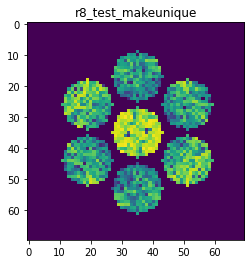

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8947652388525338
>>>replaced the 65. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


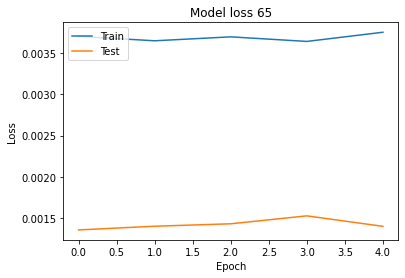

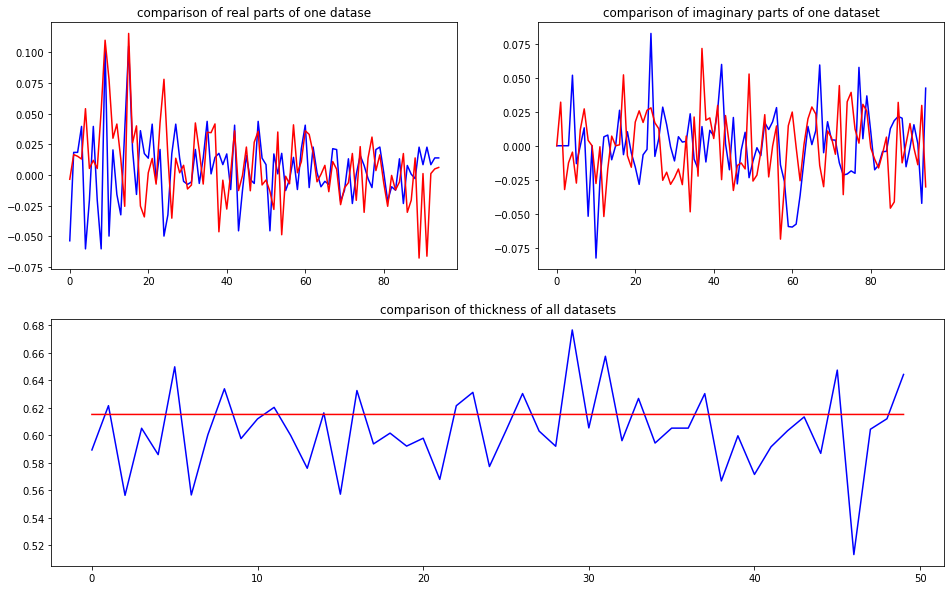

predicted thickness: 0.615087


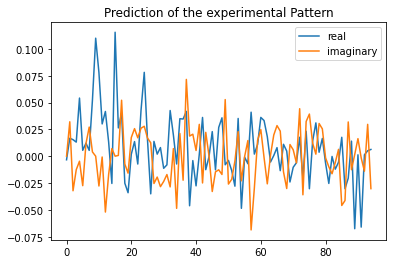

Applied shift of unit cell origin (fractional coordinates): 2.884707624395858e-08 0.12222553184119649 -0.17622986919952247
Ug[ 0 ]: 0.00336 3.14159  =>  0.00336 3.14159
Ug[ 1 ]: 0.03593 1.10728  =>  0.03593 0.0
Ug[ 2 ]: 0.03593 -1.10728  =>  0.03593 -0.0
Ug[ 3 ]: 0.01751 -0.76797  =>  0.01751 -0.0
Ug[ 4 ]: 0.05347 -0.08092  =>  0.05347 -0.42024
Ug[ 5 ]: 0.02783 -1.37381  =>  0.02783 0.50144
Ug[ 6 ]: 0.01751 0.76797  =>  0.01751 0.0
Ug[ 7 ]: 0.02783 1.37381  =>  0.02783 -0.50144
Ug[ 8 ]: 0.05347 0.08092  =>  0.05347 0.42024
Ug[ 9 ]: 0.11272 -0.0  =>  0.11272 0.0
Ug[ 10 ]: 0.08286 -0.34243  =>  0.08286 -1.44972
Ug[ 11 ]: 0.02822 -0.02557  =>  0.02822 1.08172
Ug[ 12 ]: 0.06624 -0.90513  =>  0.06624 -1.67309
Ug[ 13 ]: 0.02219 -0.86929  =>  0.02219 -2.74454
Ug[ 14 ]: 0.0263 2.86464  =>  0.0263 -3.07922
Ug[ 15 ]: 0.11272 0.0  =>  0.11272 0.0
Ug[ 16 ]: 0.02822 0.02557  =>  0.02822 -1.08172
Ug[ 17 ]: 0.06624 0.90513  =>  0.06624 1.67309
Ug[ 18 ]: 0.0263 -2.86464  =>  0.0263 3.07922
Ug[ 19 ]: 0

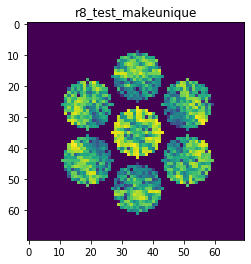

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8308394393580621
>>>replaced the 66. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


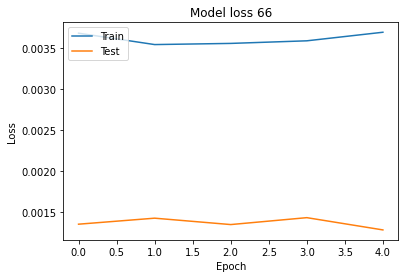

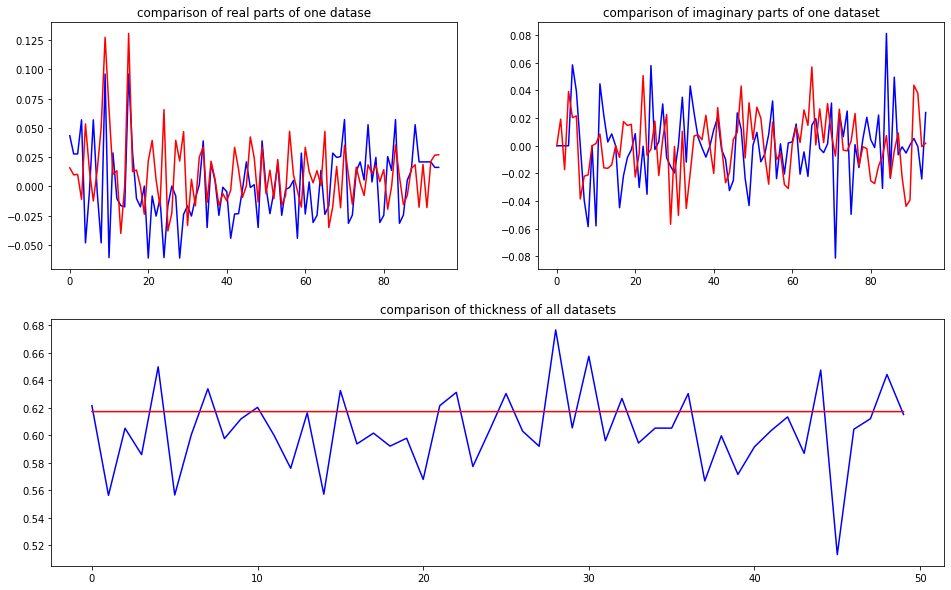

predicted thickness: 0.6171445


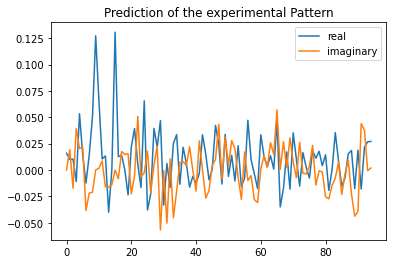

Applied shift of unit cell origin (fractional coordinates): -3.654705522458584e-07 -0.29645979357388247 -0.16960923470540004
Ug[ 0 ]: 0.01589 0.0  =>  0.01589 0.0
Ug[ 1 ]: 0.02091 1.06569  =>  0.02091 -0.0
Ug[ 2 ]: 0.02091 -1.06569  =>  0.02091 0.0
Ug[ 3 ]: 0.04062 1.86271  =>  0.04062 -0.0
Ug[ 4 ]: 0.05571 0.38097  =>  0.05571 -2.54743
Ug[ 5 ]: 0.02597 0.99752  =>  0.02597 0.20049
Ug[ 6 ]: 0.04062 -1.86271  =>  0.04062 0.0
Ug[ 7 ]: 0.02597 -0.99752  =>  0.02597 -0.20049
Ug[ 8 ]: 0.05571 -0.38097  =>  0.05571 2.54743
Ug[ 9 ]: 0.12895 0.0  =>  0.12895 -0.0
Ug[ 10 ]: 0.0657 0.03147  =>  0.0657 -1.03422
Ug[ 11 ]: 0.01431 0.63141  =>  0.01431 1.6971
Ug[ 12 ]: 0.02165 -0.88508  =>  0.02165 0.97763
Ug[ 13 ]: 0.04258 -2.72926  =>  0.04258 -1.93224
Ug[ 14 ]: 0.01429 -1.54256  =>  0.01429 1.38584
Ug[ 15 ]: 0.12895 -0.0  =>  0.12895 0.0
Ug[ 16 ]: 0.01431 -0.63141  =>  0.01431 -1.6971
Ug[ 17 ]: 0.02165 0.88508  =>  0.02165 -0.97763
Ug[ 18 ]: 0.01429 1.54256  =>  0.01429 -1.38584
Ug[ 19 ]: 0.0297 

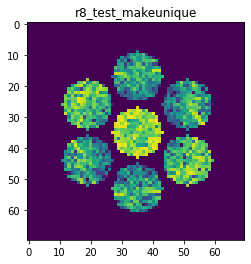

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8897577109415313
>>>replaced the 67. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


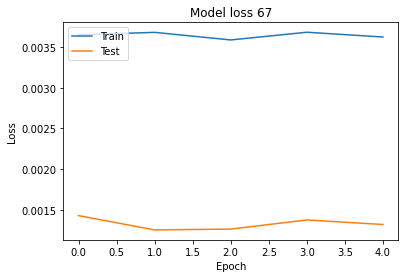

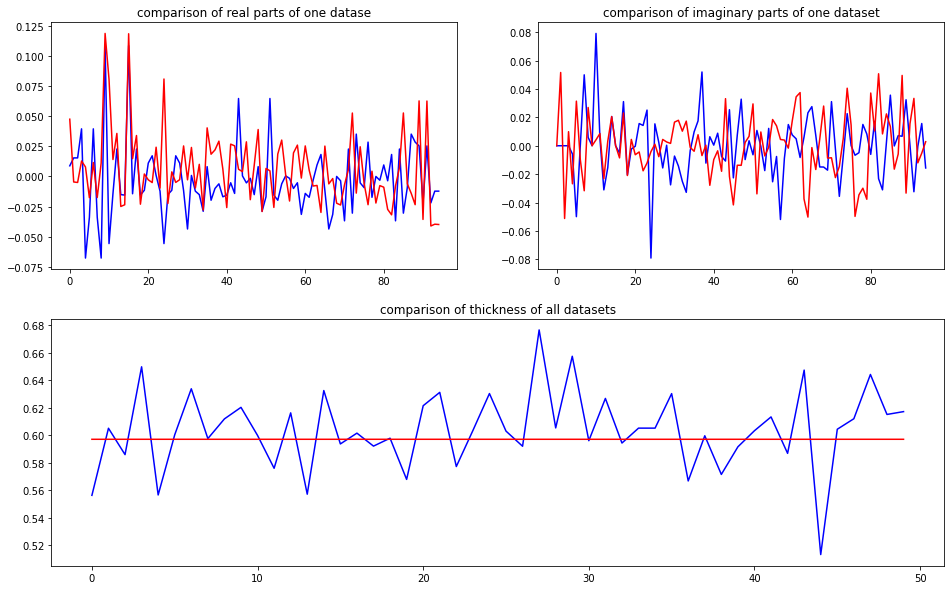

predicted thickness: 0.597042


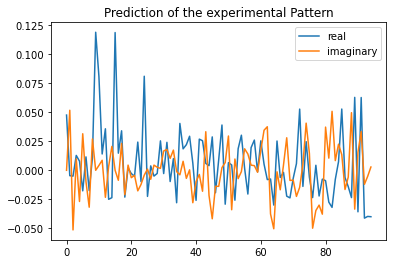

Applied shift of unit cell origin (fractional coordinates): 9.940205098921289e-07 -0.10793426436467882 -0.26481923543944796
Ug[ 0 ]: 0.04751 0.0  =>  0.04751 0.0
Ug[ 1 ]: 0.05166 1.66391  =>  0.05166 0.0
Ug[ 2 ]: 0.05166 -1.66391  =>  0.05166 -0.0
Ug[ 3 ]: 0.01563 0.67817  =>  0.01563 0.0
Ug[ 4 ]: 0.02852 -1.23049  =>  0.02852 2.71061
Ug[ 5 ]: 0.03614 2.07869  =>  0.03614 3.06443
Ug[ 6 ]: 0.01563 -0.67817  =>  0.01563 0.0
Ug[ 7 ]: 0.03614 -2.07869  =>  0.03614 -3.06443
Ug[ 8 ]: 0.02852 1.23049  =>  0.02852 -2.71061
Ug[ 9 ]: 0.11859 -1e-05  =>  0.11859 -0.0
Ug[ 10 ]: 0.08089 0.05147  =>  0.08089 -1.61243
Ug[ 11 ]: 0.01676 0.53867  =>  0.01676 2.20258
Ug[ 12 ]: 0.04184 -0.58659  =>  0.04184 0.09159
Ug[ 13 ]: 0.02372 3.0963  =>  0.02372 2.11057
Ug[ 14 ]: 0.0312 2.4135  =>  0.0312 -1.52759
Ug[ 15 ]: 0.11859 1e-05  =>  0.11859 0.0
Ug[ 16 ]: 0.01676 -0.53867  =>  0.01676 -2.20258
Ug[ 17 ]: 0.04184 0.58659  =>  0.04184 -0.09159
Ug[ 18 ]: 0.0312 -2.4135  =>  0.0312 1.52759
Ug[ 19 ]: 0.00674 1.

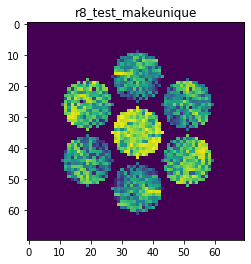

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9233596052163489
>>>replaced the 68. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


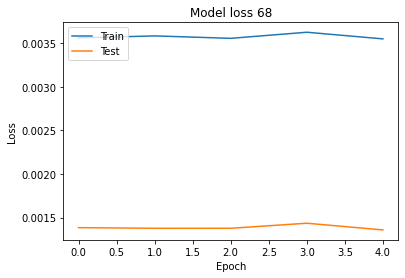

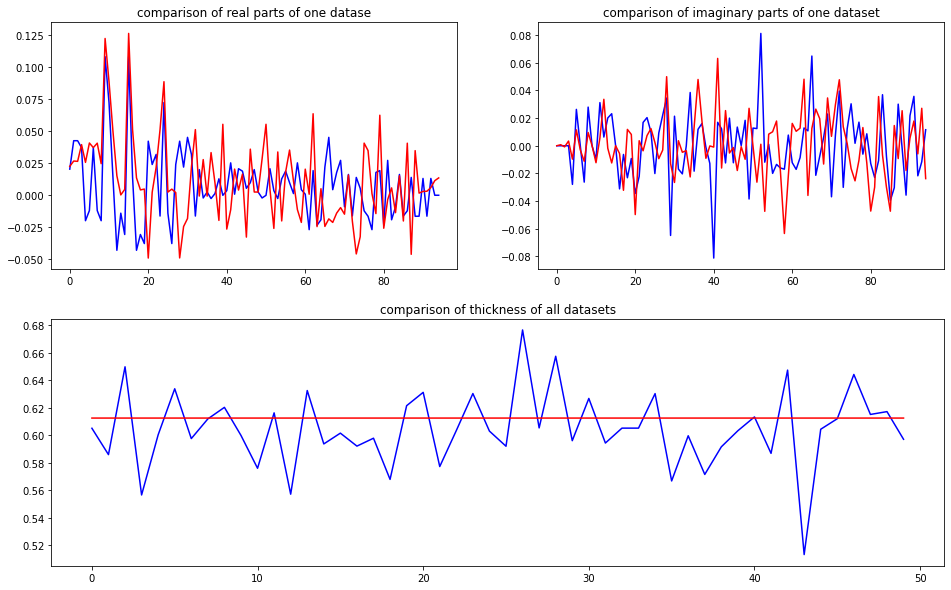

predicted thickness: 0.6124578


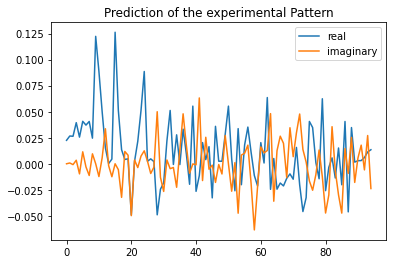

Applied shift of unit cell origin (fractional coordinates): 1.667601706908763e-06 -0.013305577976297415 -0.004676254064450016
Ug[ 0 ]: 0.02249 0.0  =>  0.02249 0.0
Ug[ 1 ]: 0.02653 0.02938  =>  0.02653 0.0
Ug[ 2 ]: 0.02653 -0.02938  =>  0.02653 0.0
Ug[ 3 ]: 0.03843 0.0836  =>  0.03843 0.0
Ug[ 4 ]: 0.02687 -0.36634  =>  0.02687 -0.47932
Ug[ 5 ]: 0.04222 0.27257  =>  0.04222 0.21835
Ug[ 6 ]: 0.03843 -0.0836  =>  0.03843 0.0
Ug[ 7 ]: 0.04222 -0.27257  =>  0.04222 -0.21835
Ug[ 8 ]: 0.02687 0.36634  =>  0.02687 0.47932
Ug[ 9 ]: 0.12426 -1e-05  =>  0.12426 0.0
Ug[ 10 ]: 0.08946 -0.1385  =>  0.08946 -0.16787
Ug[ 11 ]: 0.05085 0.11213  =>  0.05085 0.14153
Ug[ 12 ]: 0.03591 1.15966  =>  0.03591 1.24327
Ug[ 13 ]: 0.00251 -1.01879  =>  0.00251 -0.96456
Ug[ 14 ]: 0.01287 -1.22986  =>  0.01287 -1.11687
Ug[ 15 ]: 0.12426 1e-05  =>  0.12426 0.0
Ug[ 16 ]: 0.05085 -0.11213  =>  0.05085 -0.14153
Ug[ 17 ]: 0.03591 -1.15966  =>  0.03591 -1.24327
Ug[ 18 ]: 0.01287 1.22986  =>  0.01287 1.11687
Ug[ 19 ]: 0.0

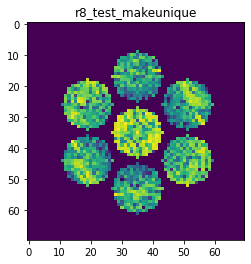

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8208402632634194
>>>replaced the 69. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


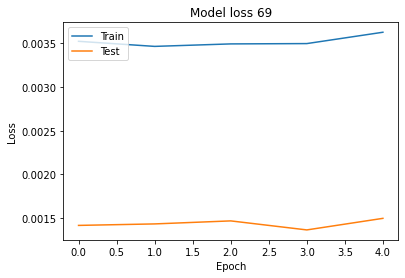

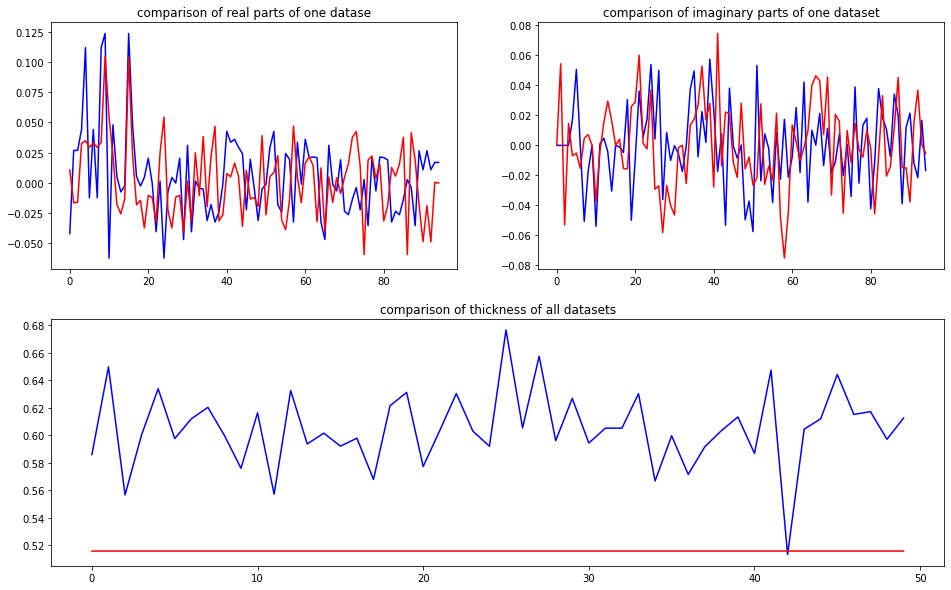

predicted thickness: 0.5158394


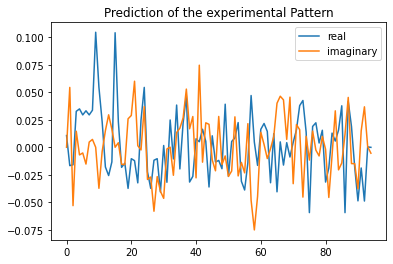

Applied shift of unit cell origin (fractional coordinates): 1.1764294488031663e-06 -0.06776171558422328 -0.2968565220018065
Ug[ 0 ]: 0.01063 0.0  =>  0.01063 0.0
Ug[ 1 ]: 0.0561 1.8652  =>  0.0561 0.0
Ug[ 2 ]: 0.0561 -1.8652  =>  0.0561 -0.0
Ug[ 3 ]: 0.03611 0.42576  =>  0.03611 0.0
Ug[ 4 ]: 0.03497 -0.20247  =>  0.03497 -2.49343
Ug[ 5 ]: 0.02982 -0.16689  =>  0.02982 1.27256
Ug[ 6 ]: 0.03611 -0.42576  =>  0.03611 -0.0
Ug[ 7 ]: 0.02982 0.16689  =>  0.02982 -1.27256
Ug[ 8 ]: 0.03497 0.20247  =>  0.03497 2.49343
Ug[ 9 ]: 0.10425 -1e-05  =>  0.10425 0.0
Ug[ 10 ]: 0.06589 -0.59813  =>  0.06589 -2.46332
Ug[ 11 ]: 0.02356 -0.16935  =>  0.02356 1.69586
Ug[ 12 ]: 0.02366 2.43892  =>  0.02366 2.86469
Ug[ 13 ]: 0.03791 2.25598  =>  0.03791 0.81654
Ug[ 14 ]: 0.0212 2.28336  =>  0.0212 -1.70885
Ug[ 15 ]: 0.10425 1e-05  =>  0.10425 -0.0
Ug[ 16 ]: 0.02356 0.16935  =>  0.02356 -1.69586
Ug[ 17 ]: 0.02366 -2.43892  =>  0.02366 -2.86469
Ug[ 18 ]: 0.0212 -2.28336  =>  0.0212 1.70885
Ug[ 19 ]: 0.04573 2.5

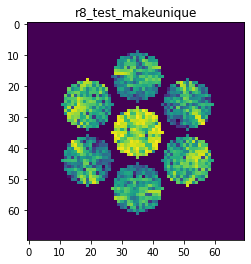

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8858691672939469
>>>replaced the 70. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


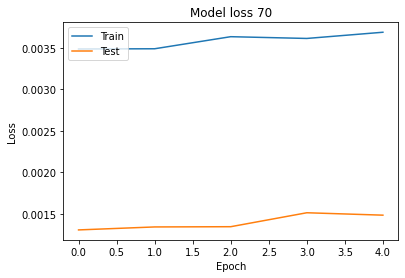

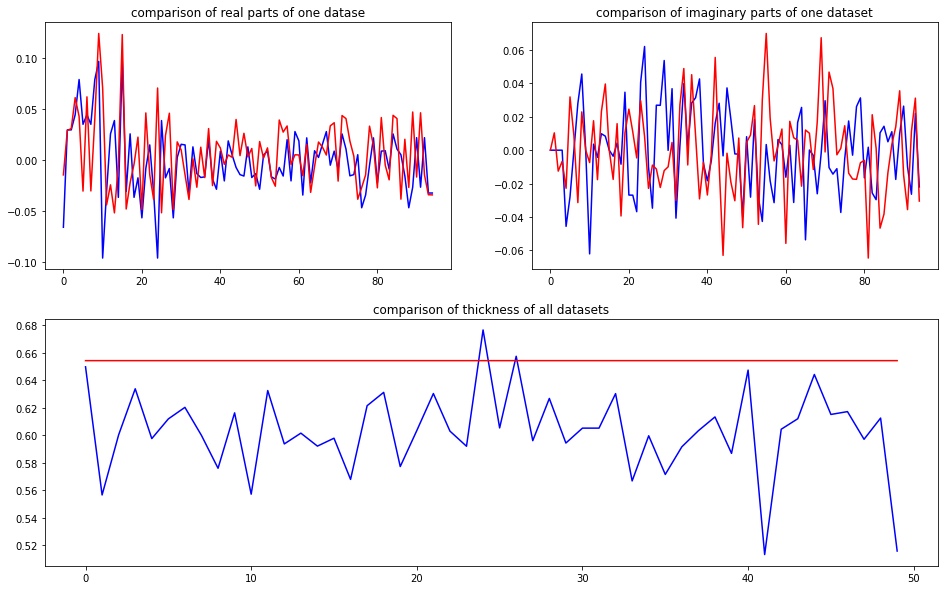

predicted thickness: 0.6541802


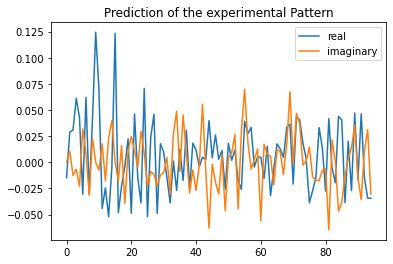

Applied shift of unit cell origin (fractional coordinates): 3.654884727328069e-07 0.019708063580964157 -0.058303535658931364
Ug[ 0 ]: 0.01475 3.14159  =>  0.01475 3.14159
Ug[ 1 ]: 0.032 0.36633  =>  0.032 -0.0
Ug[ 2 ]: 0.032 -0.36633  =>  0.032 0.0
Ug[ 3 ]: 0.06211 -0.12383  =>  0.06211 0.0
Ug[ 4 ]: 0.04744 -0.50389  =>  0.04744 -0.74639
Ug[ 5 ]: 0.04404 2.3388  =>  0.04404 2.82896
Ug[ 6 ]: 0.06211 0.12383  =>  0.06211 0.0
Ug[ 7 ]: 0.04404 -2.3388  =>  0.04404 -2.82896
Ug[ 8 ]: 0.04744 0.50389  =>  0.04744 0.74639
Ug[ 9 ]: 0.12385 -0.0  =>  0.12385 -0.0
Ug[ 10 ]: 0.0712 -0.11039  =>  0.0712 -0.47672
Ug[ 11 ]: 0.04947 2.77819  =>  0.04947 -3.13866
Ug[ 12 ]: 0.02887 -2.52107  =>  0.02887 -2.64489
Ug[ 13 ]: 0.0569 2.7251  =>  0.0569 2.23494
Ug[ 14 ]: 0.03982 1.68341  =>  0.03982 1.92591
Ug[ 15 ]: 0.12385 0.0  =>  0.12385 0.0
Ug[ 16 ]: 0.04947 -2.77819  =>  0.04947 3.13866
Ug[ 17 ]: 0.02887 2.52107  =>  0.02887 2.64489
Ug[ 18 ]: 0.03982 -1.68341  =>  0.03982 -1.92591
Ug[ 19 ]: 0.02506 0.39

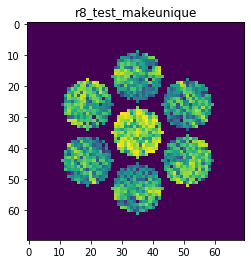

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9209400931958214
>>>replaced the 71. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0037 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


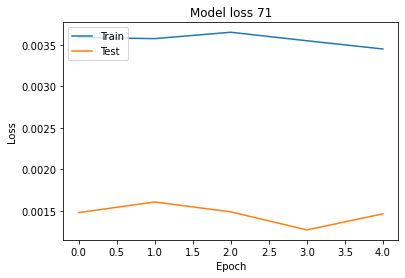

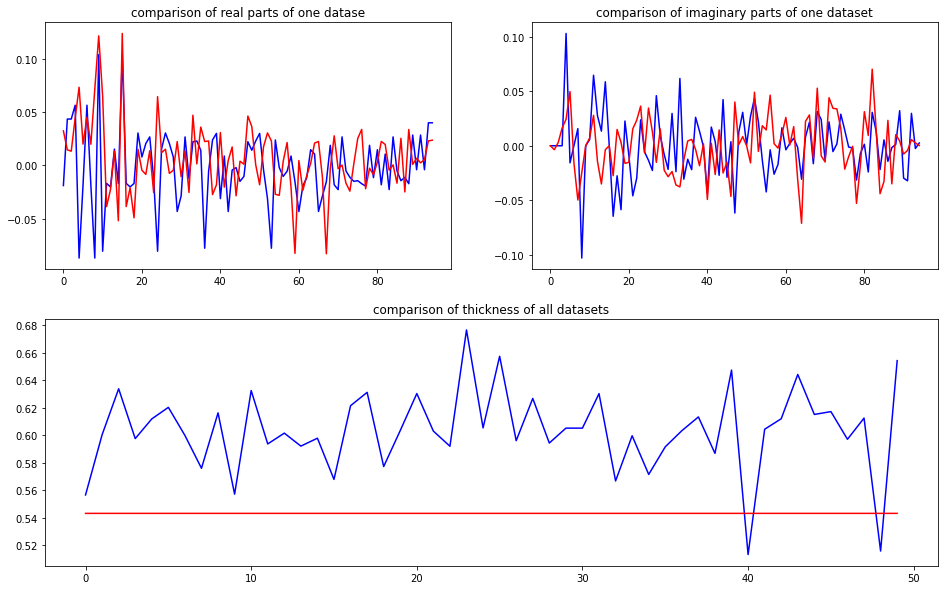

predicted thickness: 0.54321736


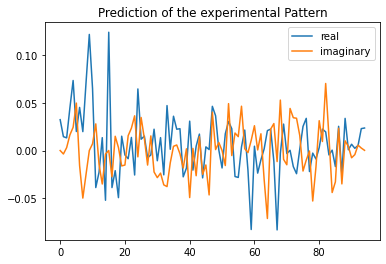

Applied shift of unit cell origin (fractional coordinates): -1.1073945193500773e-07 -0.05466347883815028 0.03730060319804941
Ug[ 0 ]: 0.03234 0.0  =>  0.03234 0.0
Ug[ 1 ]: 0.0143 -0.23437  =>  0.0143 0.0
Ug[ 2 ]: 0.0143 0.23437  =>  0.0143 -0.0
Ug[ 3 ]: 0.04766 0.34346  =>  0.04766 0.0
Ug[ 4 ]: 0.07659 0.32572  =>  0.07659 0.21663
Ug[ 5 ]: 0.05358 1.19119  =>  0.05358 0.61336
Ug[ 6 ]: 0.04766 -0.34346  =>  0.04766 -0.0
Ug[ 7 ]: 0.05358 -1.19119  =>  0.05358 -0.61336
Ug[ 8 ]: 0.07659 -0.32572  =>  0.07659 -0.21663
Ug[ 9 ]: 0.12281 0.0  =>  0.12281 -0.0
Ug[ 10 ]: 0.06507 0.10544  =>  0.06507 0.33981
Ug[ 11 ]: 0.04769 2.52169  =>  0.04769 2.28733
Ug[ 12 ]: 0.0264 -2.5537  =>  0.0264 -2.21024
Ug[ 13 ]: 0.03708 -1.222  =>  0.03708 -0.64417
Ug[ 14 ]: 0.05085 -3.07534  =>  0.05085 -2.96624
Ug[ 15 ]: 0.12281 -0.0  =>  0.12281 0.0
Ug[ 16 ]: 0.04769 -2.52169  =>  0.04769 -2.28733
Ug[ 17 ]: 0.0264 2.5537  =>  0.0264 2.21024
Ug[ 18 ]: 0.05085 3.07534  =>  0.05085 2.96624
Ug[ 19 ]: 0.02084 -0.76252

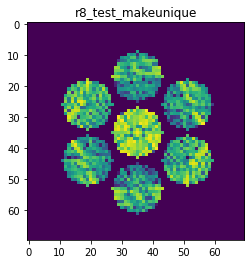

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8987191300373332
>>>replaced the 72. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 746ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0036 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


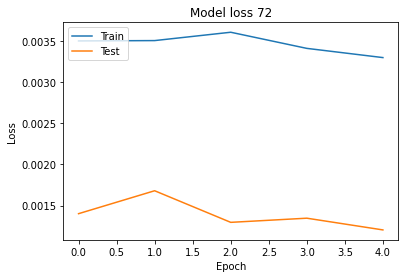

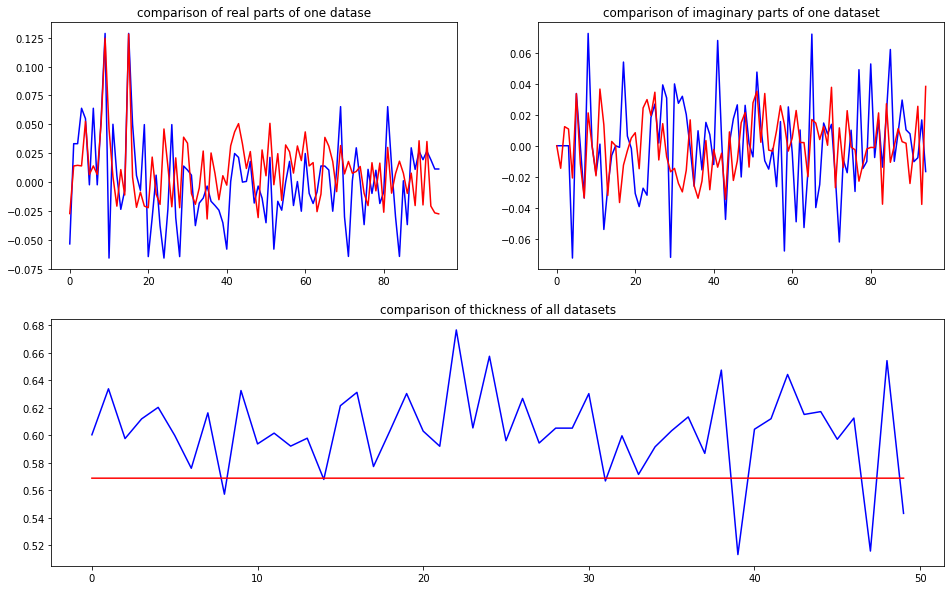

predicted thickness: 0.5687884


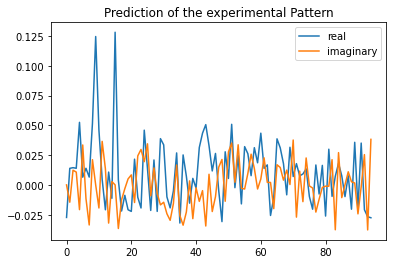

Applied shift of unit cell origin (fractional coordinates): 7.162237428676281e-07 -0.10714857111425491 0.12057659381074892
Ug[ 0 ]: 0.02734 3.14159  =>  0.02734 3.14159
Ug[ 1 ]: 0.01952 -0.75761  =>  0.01952 0.0
Ug[ 2 ]: 0.01952 0.75761  =>  0.01952 -0.0
Ug[ 3 ]: 0.01785 0.67323  =>  0.01785 0.0
Ug[ 4 ]: 0.05613 -0.38292  =>  0.05613 -0.29855
Ug[ 5 ]: 0.03421 1.37925  =>  0.03421 -0.05159
Ug[ 6 ]: 0.01785 -0.67323  =>  0.01785 0.0
Ug[ 7 ]: 0.03421 -1.37925  =>  0.03421 0.05159
Ug[ 8 ]: 0.05613 0.38292  =>  0.05613 0.29855
Ug[ 9 ]: 0.12637 -0.0  =>  0.12637 0.0
Ug[ 10 ]: 0.04995 -0.39968  =>  0.04995 0.35793
Ug[ 11 ]: 0.03683 1.45084  =>  0.03683 0.69324
Ug[ 12 ]: 0.02504 2.5962  =>  0.02504 -3.01374
Ug[ 13 ]: 0.03545 -1.21922  =>  0.03545 0.21162
Ug[ 14 ]: 0.01043 2.85317  =>  0.01043 2.76881
Ug[ 15 ]: 0.12637 0.0  =>  0.12637 -0.0
Ug[ 16 ]: 0.03683 -1.45084  =>  0.03683 -0.69324
Ug[ 17 ]: 0.02504 -2.5962  =>  0.02504 3.01374
Ug[ 18 ]: 0.01043 -2.85317  =>  0.01043 -2.76881
Ug[ 19 ]: 0

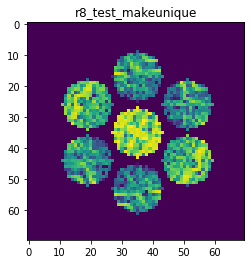

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8894201752929969
>>>replaced the 73. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 752ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 744ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


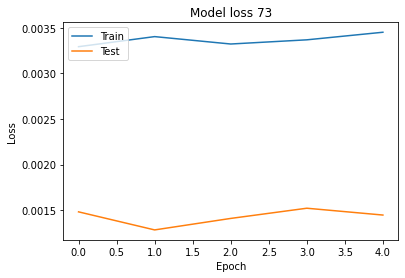

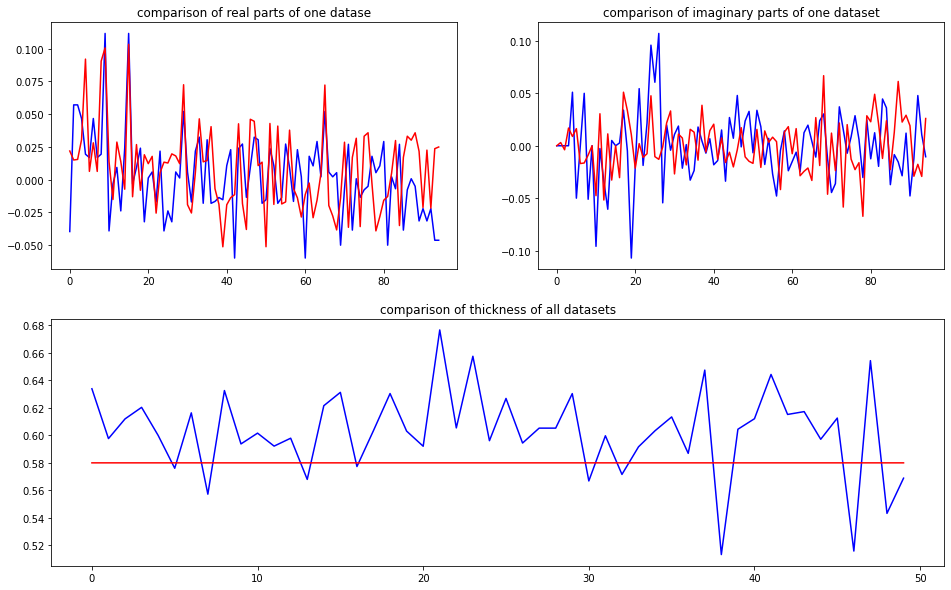

predicted thickness: 0.5799218


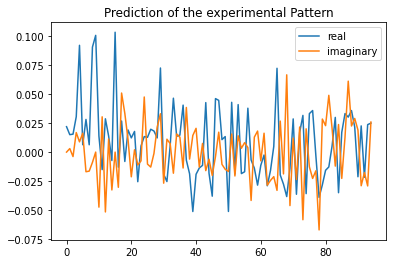

Applied shift of unit cell origin (fractional coordinates): 1.8056104496022108e-06 -0.0830565447975609 -0.03526998629810259
Ug[ 0 ]: 0.0219 0.0  =>  0.0219 0.0
Ug[ 1 ]: 0.01563 0.22161  =>  0.01563 0.0
Ug[ 2 ]: 0.01563 -0.22161  =>  0.01563 0.0
Ug[ 3 ]: 0.03383 0.52186  =>  0.03383 -0.0
Ug[ 4 ]: 0.09168 0.09672  =>  0.09168 -0.64675
Ug[ 5 ]: 0.01751 1.20054  =>  0.01751 0.90029
Ug[ 6 ]: 0.03383 -0.52186  =>  0.03383 0.0
Ug[ 7 ]: 0.01751 -1.20054  =>  0.01751 -0.90029
Ug[ 8 ]: 0.09168 -0.09672  =>  0.09168 0.64675
Ug[ 9 ]: 0.10194 -1e-05  =>  0.10194 0.0
Ug[ 10 ]: 0.04937 -1.29128  =>  0.04937 -1.51287
Ug[ 11 ]: 0.03345 2.00406  =>  0.03345 2.22568
Ug[ 12 ]: 0.05827 -1.07428  =>  0.05827 -0.5524
Ug[ 13 ]: 0.01713 0.68276  =>  0.01713 0.98302
Ug[ 14 ]: 0.03385 -1.79941  =>  0.03385 -1.05593
Ug[ 15 ]: 0.10194 1e-05  =>  0.10194 0.0
Ug[ 16 ]: 0.03345 -2.00406  =>  0.03345 -2.22568
Ug[ 17 ]: 0.05827 1.07428  =>  0.05827 0.5524
Ug[ 18 ]: 0.03385 1.79941  =>  0.03385 1.05593
Ug[ 19 ]: 0.02266

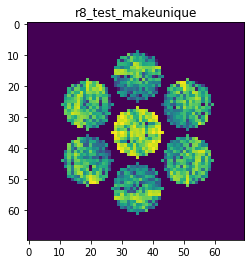

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8722537013088325
>>>replaced the 74. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 757ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


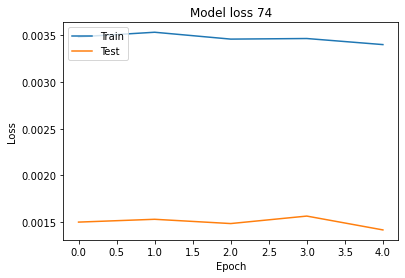

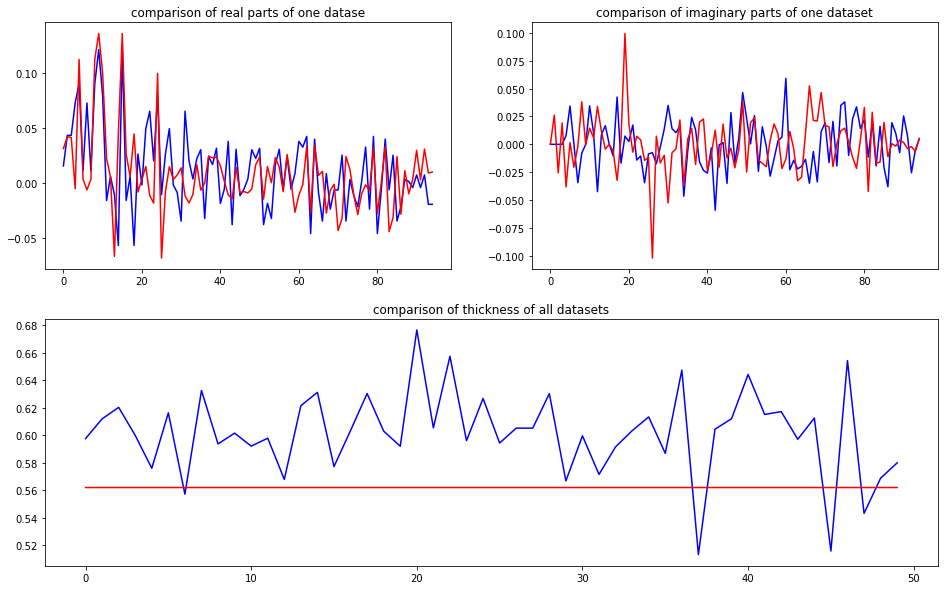

predicted thickness: 0.5619909


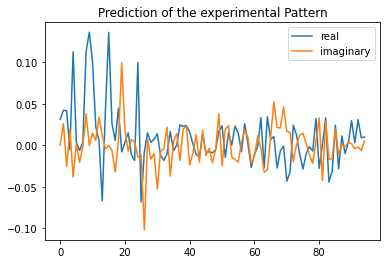

Applied shift of unit cell origin (fractional coordinates): -1.3992211719454031e-08 -0.2943360829054861 -0.08806563000686703
Ug[ 0 ]: 0.03149 0.0  =>  0.03149 0.0
Ug[ 1 ]: 0.04933 0.55333  =>  0.04933 0.0
Ug[ 2 ]: 0.04933 -0.55333  =>  0.04933 -0.0
Ug[ 3 ]: 0.02065 1.84937  =>  0.02065 0.0
Ug[ 4 ]: 0.11914 -0.32601  =>  0.11914 -2.72871
Ug[ 5 ]: 0.00391 0.4442  =>  0.00391 -0.85183
Ug[ 6 ]: 0.02065 -1.84937  =>  0.02065 -0.0
Ug[ 7 ]: 0.00391 -0.4442  =>  0.00391 0.85183
Ug[ 8 ]: 0.11914 0.32601  =>  0.11914 2.72871
Ug[ 9 ]: 0.13639 0.0  =>  0.13639 0.0
Ug[ 10 ]: 0.10112 0.14327  =>  0.10112 -0.41006
Ug[ 11 ]: 0.02509 0.24606  =>  0.02509 0.79939
Ug[ 12 ]: 0.03366 1.39885  =>  0.03366 -3.03497
Ug[ 13 ]: 0.06858 2.96998  =>  0.06858 -2.01717
Ug[ 14 ]: 0.04505 -0.10552  =>  0.04505 2.29718
Ug[ 15 ]: 0.13639 -0.0  =>  0.13639 -0.0
Ug[ 16 ]: 0.02509 -0.24606  =>  0.02509 -0.79939
Ug[ 17 ]: 0.03366 -1.39885  =>  0.03366 3.03497
Ug[ 18 ]: 0.04505 0.10552  =>  0.04505 -2.29718
Ug[ 19 ]: 0.1011

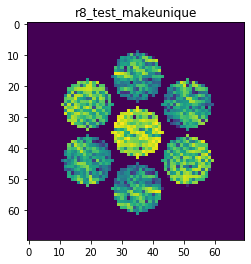

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8330908869605186
>>>replaced the 75. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 751ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0034 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000


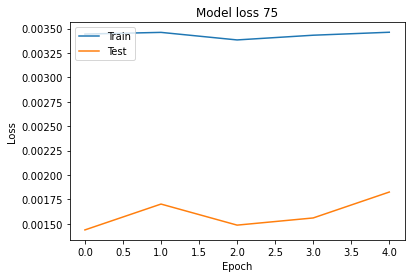

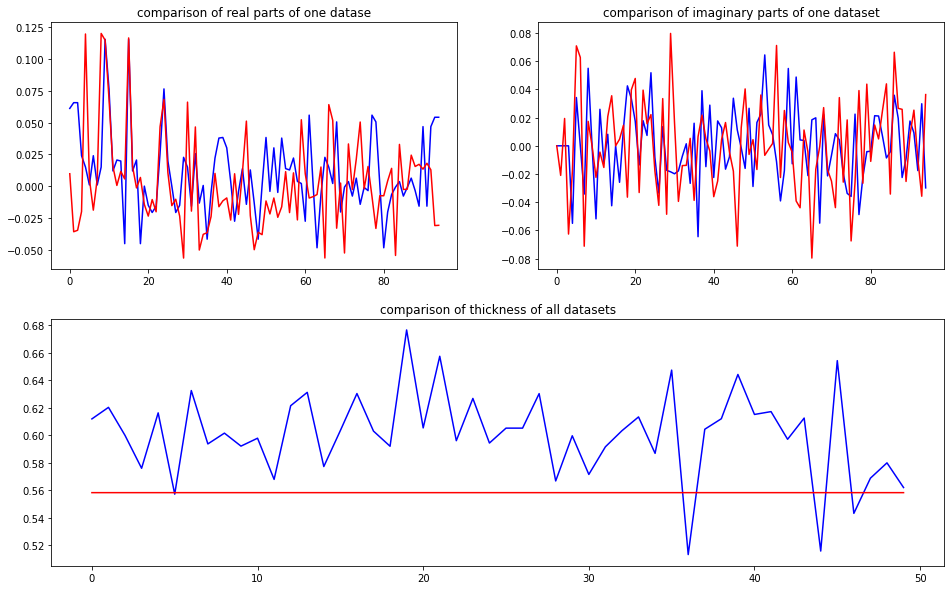

predicted thickness: 0.558272


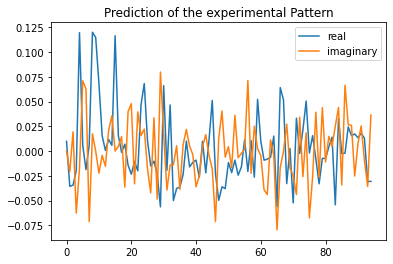

Applied shift of unit cell origin (fractional coordinates): -1.0780228722674599e-07 0.2975896803703357 0.41695815129293323
Ug[ 0 ]: 0.00982 0.0  =>  0.00982 0.0
Ug[ 1 ]: 0.04052 -2.61983  =>  0.04052 -0.0
Ug[ 2 ]: 0.04052 2.61983  =>  0.04052 0.0
Ug[ 3 ]: 0.06562 -1.86981  =>  0.06562 -0.0
Ug[ 4 ]: 0.121 -0.1443  =>  0.121 -1.93785
Ug[ 5 ]: 0.07136 1.48739  =>  0.07136 0.73738
Ug[ 6 ]: 0.06562 1.86981  =>  0.06562 0.0
Ug[ 7 ]: 0.07136 -1.48739  =>  0.07136 -0.73738
Ug[ 8 ]: 0.121 0.1443  =>  0.121 1.93785
Ug[ 9 ]: 0.11558 0.0  =>  0.11558 -0.0
Ug[ 10 ]: 0.07186 -0.31517  =>  0.07186 2.30465
Ug[ 11 ]: 0.01611 -0.28705  =>  0.01611 -2.90688
Ug[ 12 ]: 0.01499 -1.59313  =>  0.01499 2.82024
Ug[ 13 ]: 0.02227 1.04583  =>  0.02227 1.79585
Ug[ 14 ]: 0.03655 1.39674  =>  0.03655 -3.09289
Ug[ 15 ]: 0.11558 -0.0  =>  0.11558 0.0
Ug[ 16 ]: 0.01611 0.28705  =>  0.01611 2.90688
Ug[ 17 ]: 0.01499 1.59313  =>  0.01499 -2.82024
Ug[ 18 ]: 0.03655 -1.39674  =>  0.03655 3.09289
Ug[ 19 ]: 0.04356 1.91632  

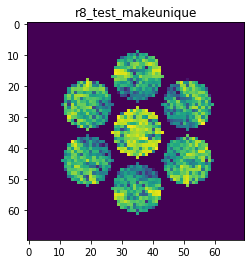

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8535632549972925
>>>replaced the 76. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 756ms/step - loss: 0.0035 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 748ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


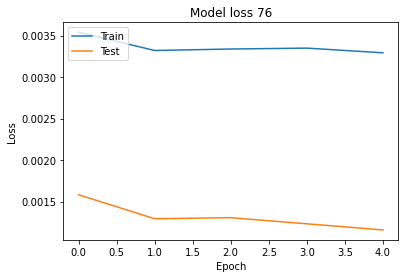

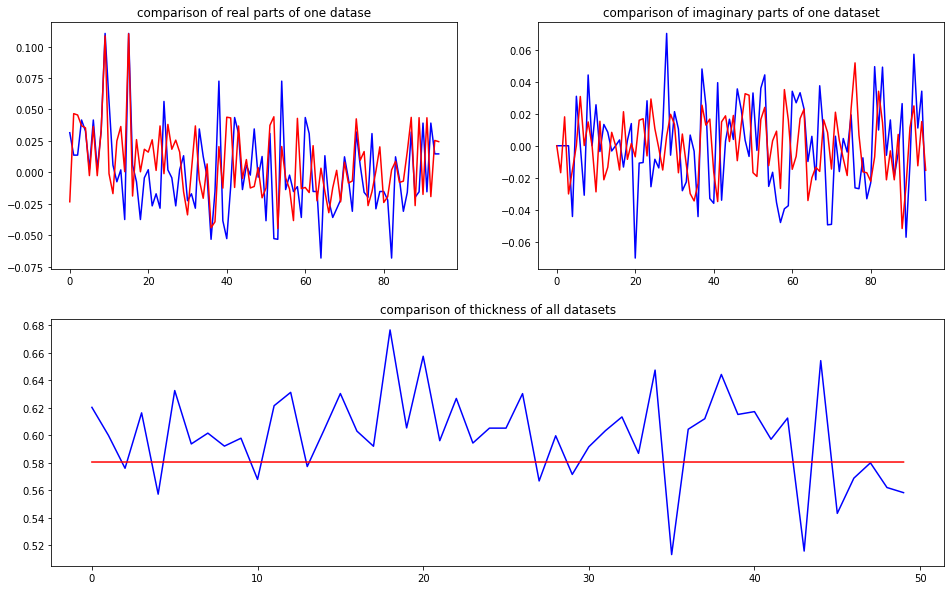

predicted thickness: 0.5805282


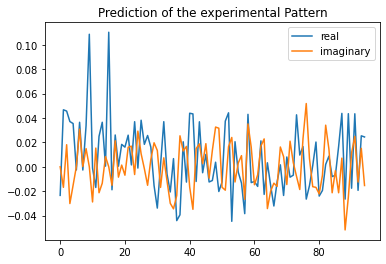

Applied shift of unit cell origin (fractional coordinates): -5.25252107871238e-07 0.11013550584572507 0.05754923590043166
Ug[ 0 ]: 0.02344 3.14159  =>  0.02344 3.14159
Ug[ 1 ]: 0.04935 -0.36159  =>  0.04935 0.0
Ug[ 2 ]: 0.04935 0.36159  =>  0.04935 0.0
Ug[ 3 ]: 0.04773 -0.692  =>  0.04773 -0.0
Ug[ 4 ]: 0.03764 -0.40902  =>  0.03764 0.64458
Ug[ 5 ]: 0.00264 -3.14029  =>  0.00264 -2.80988
Ug[ 6 ]: 0.04773 0.692  =>  0.04773 0.0
Ug[ 7 ]: 0.00264 3.14029  =>  0.00264 2.80988
Ug[ 8 ]: 0.03764 0.40902  =>  0.03764 -0.64458
Ug[ 9 ]: 0.1094 0.0  =>  0.1094 0.0
Ug[ 10 ]: 0.02905 -1.60791  =>  0.02905 -1.24632
Ug[ 11 ]: 0.02351 2.43616  =>  0.02351 2.07457
Ug[ 12 ]: 0.03321 -0.6955  =>  0.03321 -1.38751
Ug[ 13 ]: 0.0392 -0.31259  =>  0.0392 -0.64301
Ug[ 14 ]: 0.00845 1.51393  =>  0.00845 0.46033
Ug[ 15 ]: 0.1094 -0.0  =>  0.1094 0.0
Ug[ 16 ]: 0.02351 -2.43616  =>  0.02351 -2.07457
Ug[ 17 ]: 0.03321 0.6955  =>  0.03321 1.38751
Ug[ 18 ]: 0.00845 -1.51393  =>  0.00845 -0.46033
Ug[ 19 ]: 0.01842 0.0

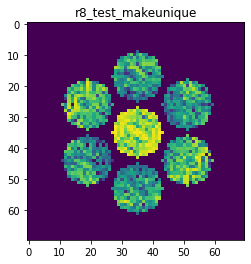

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8702488234441424
>>>replaced the 77. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 757ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 744ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


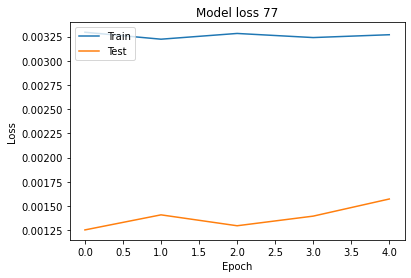

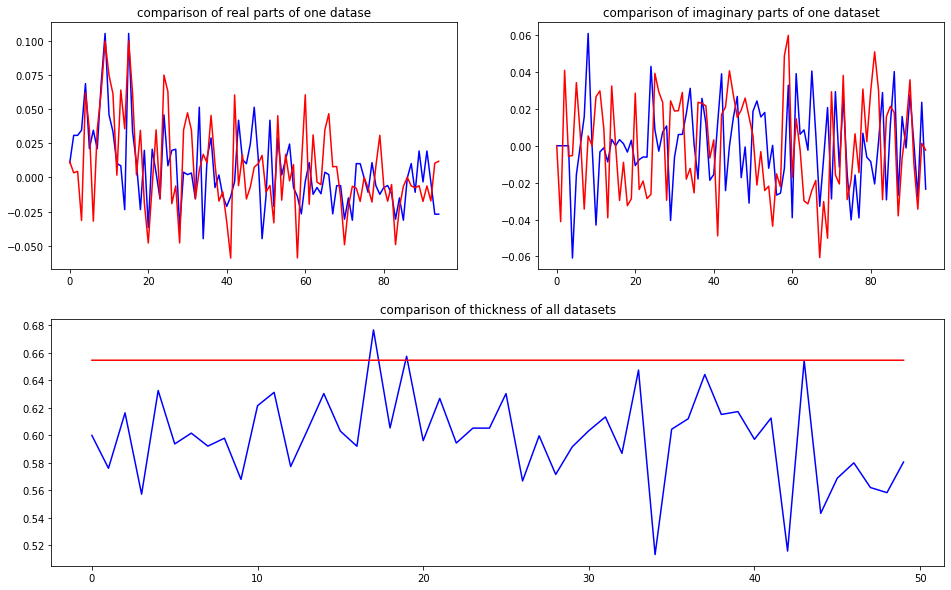

predicted thickness: 0.6544809


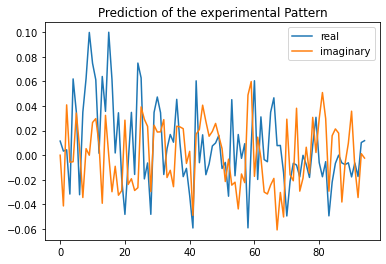

Applied shift of unit cell origin (fractional coordinates): 9.247453982949255e-07 0.4715234034565087 0.235000612207882
Ug[ 0 ]: 0.01148 0.0  =>  0.01148 0.0
Ug[ 1 ]: 0.04122 -1.47655  =>  0.04122 0.0
Ug[ 2 ]: 0.04122 1.47655  =>  0.04122 -0.0
Ug[ 3 ]: 0.03232 -2.96267  =>  0.03232 0.0
Ug[ 4 ]: 0.06237 -0.08531  =>  0.06237 -1.92928
Ug[ 5 ]: 0.04896 0.77525  =>  0.04896 2.26137
Ug[ 6 ]: 0.03232 2.96267  =>  0.03232 -0.0
Ug[ 7 ]: 0.04896 -0.77525  =>  0.04896 -2.26137
Ug[ 8 ]: 0.06237 0.08531  =>  0.06237 1.92928
Ug[ 9 ]: 0.09978 -1e-05  =>  0.09978 0.0
Ug[ 10 ]: 0.07931 0.3403  =>  0.07931 1.81686
Ug[ 11 ]: 0.06821 0.4504  =>  0.06821 -1.02615
Ug[ 12 ]: 0.00918 1.3821  =>  0.00918 -1.58057
Ug[ 13 ]: 0.07448 -0.55312  =>  0.07448 -2.03923
Ug[ 14 ]: 0.04775 0.74684  =>  0.04775 2.59081
Ug[ 15 ]: 0.09978 1e-05  =>  0.09978 -0.0
Ug[ 16 ]: 0.06821 -0.4504  =>  0.06821 1.02615
Ug[ 17 ]: 0.00918 -1.3821  =>  0.00918 1.58057
Ug[ 18 ]: 0.04775 -0.74684  =>  0.04775 -2.59081
Ug[ 19 ]: 0.03467 -2.

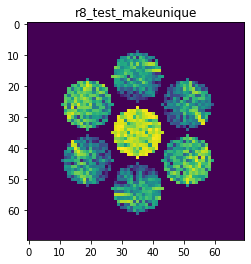

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9188320446447659
>>>replaced the 78. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 753ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


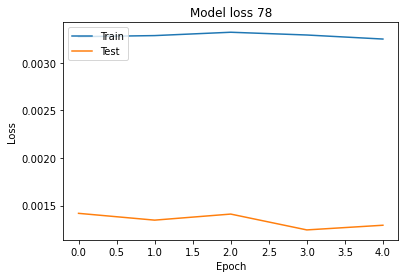

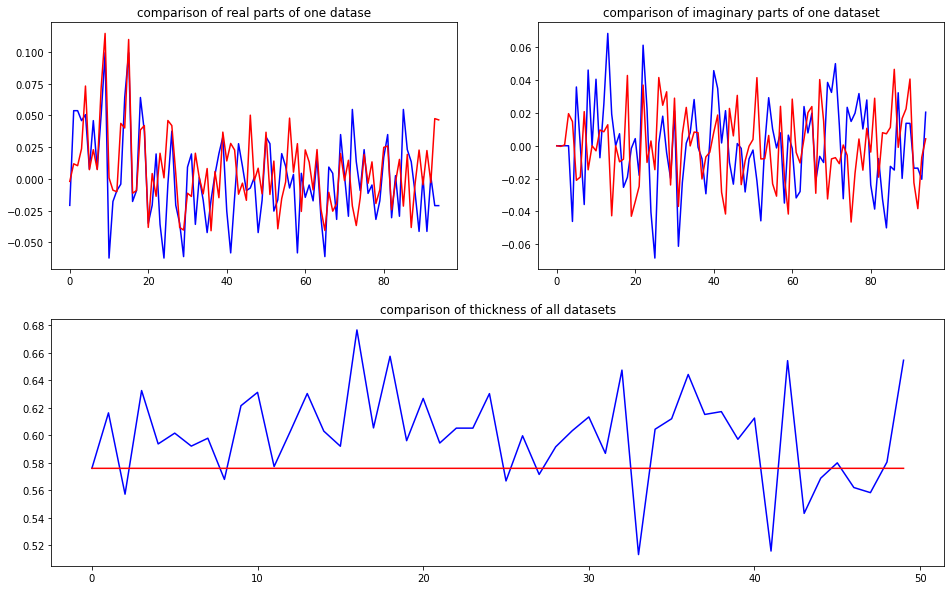

predicted thickness: 0.57594484


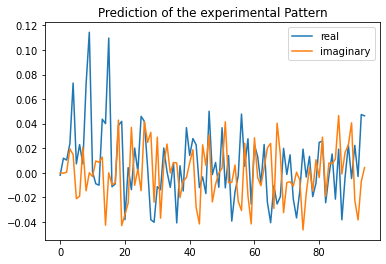

Applied shift of unit cell origin (fractional coordinates): 3.699524999137677e-07 -0.11009530452483897 0.006422524681422927
Ug[ 0 ]: 0.00201 3.14159  =>  0.00201 3.14159
Ug[ 1 ]: 0.01111 -0.04035  =>  0.01111 0.0
Ug[ 2 ]: 0.01111 0.04035  =>  0.01111 -0.0
Ug[ 3 ]: 0.03031 0.69175  =>  0.03031 -0.0
Ug[ 4 ]: 0.07396 0.20026  =>  0.07396 -0.45114
Ug[ 5 ]: 0.02217 -1.23741  =>  0.02217 -1.96951
Ug[ 6 ]: 0.03031 -0.69175  =>  0.03031 0.0
Ug[ 7 ]: 0.02217 1.23741  =>  0.02217 1.96951
Ug[ 8 ]: 0.07396 -0.20026  =>  0.07396 0.45114
Ug[ 9 ]: 0.11206 -0.0  =>  0.11206 0.0
Ug[ 10 ]: 0.00311 -1.311  =>  0.00311 -1.27064
Ug[ 11 ]: 0.01403 2.37762  =>  0.01403 2.33727
Ug[ 12 ]: 0.01276 2.42714  =>  0.01276 3.11889
Ug[ 13 ]: 0.04684 0.29687  =>  0.04684 1.02897
Ug[ 14 ]: 0.05808 -0.82805  =>  0.05808 -0.17666
Ug[ 15 ]: 0.11206 0.0  =>  0.11206 0.0
Ug[ 16 ]: 0.01403 -2.37762  =>  0.01403 -2.33727
Ug[ 17 ]: 0.01276 -2.42714  =>  0.01276 -3.11889
Ug[ 18 ]: 0.05808 0.82805  =>  0.05808 0.17666
Ug[ 19 ]: 

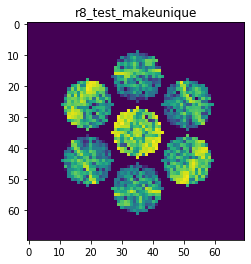

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9587347756357721
>>>replaced the 79. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 751ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


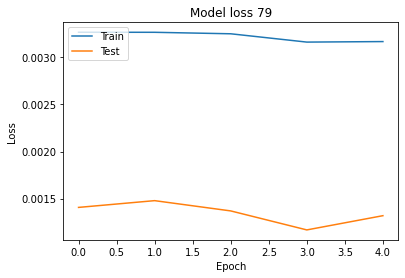

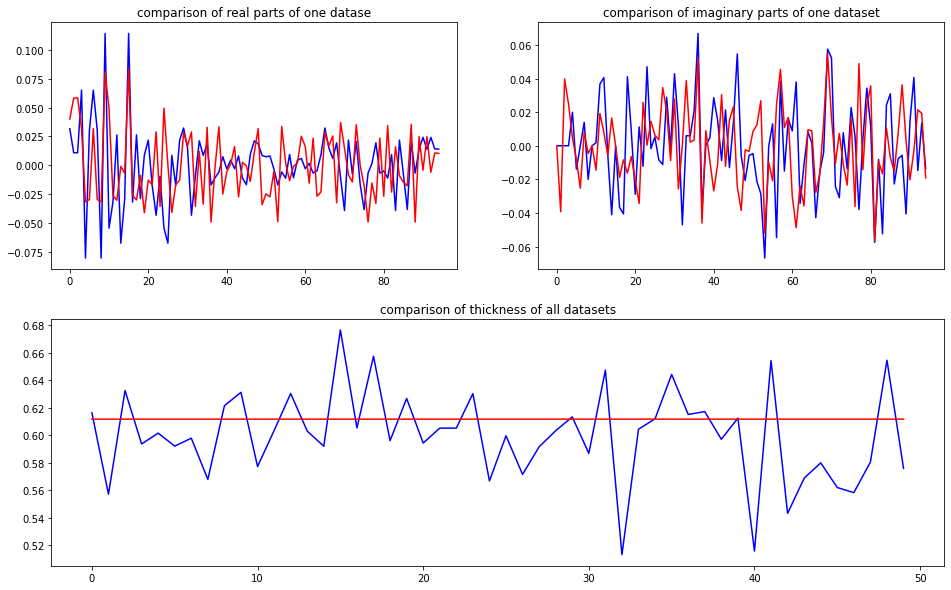

predicted thickness: 0.61168593


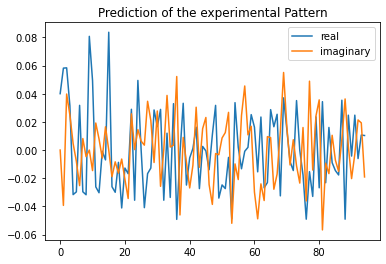

Applied shift of unit cell origin (fractional coordinates): -1.7415870985909204e-07 -0.10663355149988325 0.09487639441206294
Ug[ 0 ]: 0.04003 0.0  =>  0.04003 0.0
Ug[ 1 ]: 0.07041 -0.59613  =>  0.07041 -0.0
Ug[ 2 ]: 0.07041 0.59613  =>  0.07041 0.0
Ug[ 3 ]: 0.04034 0.67  =>  0.04034 0.0
Ug[ 4 ]: 0.03201 2.99578  =>  0.03201 2.92191
Ug[ 5 ]: 0.03073 -2.87505  =>  0.03073 2.14201
Ug[ 6 ]: 0.04034 -0.67  =>  0.04034 0.0
Ug[ 7 ]: 0.03073 2.87505  =>  0.03073 -2.14201
Ug[ 8 ]: 0.03201 -2.99578  =>  0.03201 -2.92191
Ug[ 9 ]: 0.08218 0.0  =>  0.08218 0.0
Ug[ 10 ]: 0.05146 -0.28666  =>  0.05146 0.30946
Ug[ 11 ]: 0.03228 2.51053  =>  0.03228 1.9144
Ug[ 12 ]: 0.03121 2.87771  =>  0.03121 -2.73548
Ug[ 13 ]: 0.00604 -1.61224  =>  0.00604 -0.34611
Ug[ 14 ]: 0.0182 2.01659  =>  0.0182 2.09046
Ug[ 15 ]: 0.08218 -0.0  =>  0.08218 0.0
Ug[ 16 ]: 0.03228 -2.51053  =>  0.03228 -1.9144
Ug[ 17 ]: 0.03121 -2.87771  =>  0.03121 2.73548
Ug[ 18 ]: 0.0182 -2.01659  =>  0.0182 -2.09046
Ug[ 19 ]: 0.04129 -3.02171 

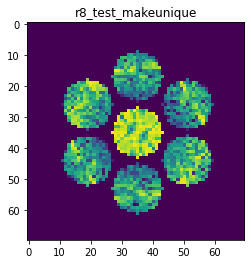

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8691719414744402
>>>replaced the 80. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 763ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 751ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 744ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


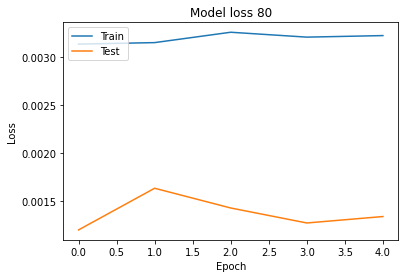

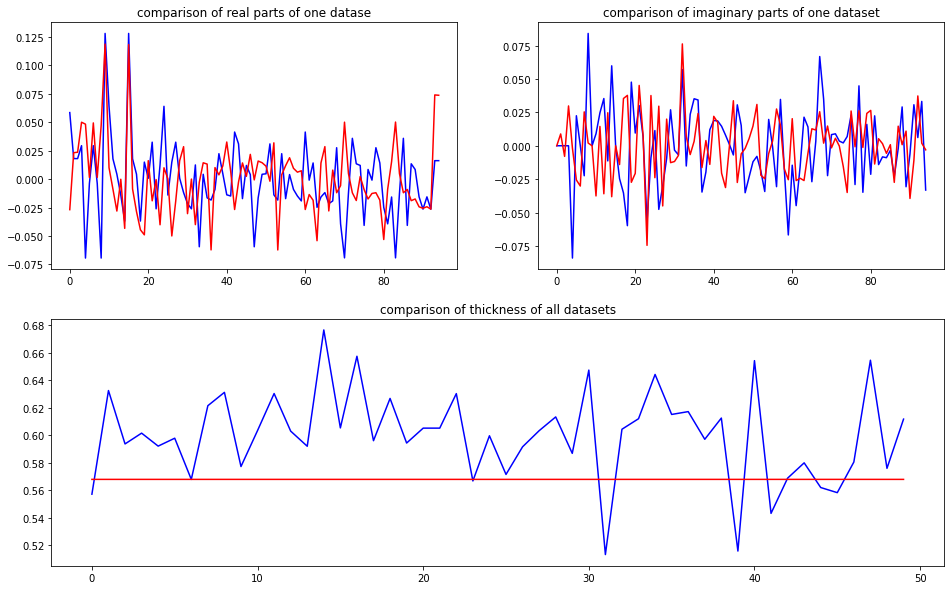

predicted thickness: 0.5679128


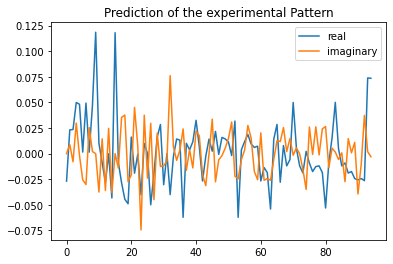

Applied shift of unit cell origin (fractional coordinates): 1.5281681608892986e-06 -0.08646105106092847 -0.0548447869585778
Ug[ 0 ]: 0.02687 3.14159  =>  0.02687 3.14159
Ug[ 1 ]: 0.02483 0.3446  =>  0.02483 0.0
Ug[ 2 ]: 0.02483 -0.3446  =>  0.02483 0.0
Ug[ 3 ]: 0.05797 0.54325  =>  0.05797 0.0
Ug[ 4 ]: 0.04767 -0.04163  =>  0.04767 -0.92948
Ug[ 5 ]: 0.02552 -1.51388  =>  0.02552 -1.71253
Ug[ 6 ]: 0.05797 -0.54325  =>  0.05797 0.0
Ug[ 7 ]: 0.02552 1.51388  =>  0.02552 1.71253
Ug[ 8 ]: 0.04767 0.04163  =>  0.04767 0.92948
Ug[ 9 ]: 0.11835 -1e-05  =>  0.11835 0.0
Ug[ 10 ]: 0.03886 -1.31167  =>  0.03886 -1.65626
Ug[ 11 ]: 0.01674 2.123  =>  0.01674 2.46761
Ug[ 12 ]: 0.04552 -2.24194  =>  0.04552 -1.69867
Ug[ 13 ]: 0.0243 1.57025  =>  0.0243 1.76891
Ug[ 14 ]: 0.05802 -2.42969  =>  0.05802 -1.54183
Ug[ 15 ]: 0.11835 1e-05  =>  0.11835 0.0
Ug[ 16 ]: 0.01674 -2.123  =>  0.01674 -2.46761
Ug[ 17 ]: 0.04552 2.24194  =>  0.04552 1.69867
Ug[ 18 ]: 0.05802 2.42969  =>  0.05802 1.54183
Ug[ 19 ]: 0.05

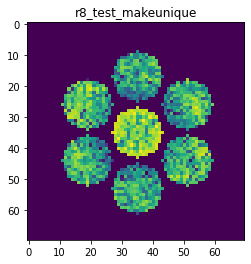

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9239523893410394
>>>replaced the 81. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 753ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


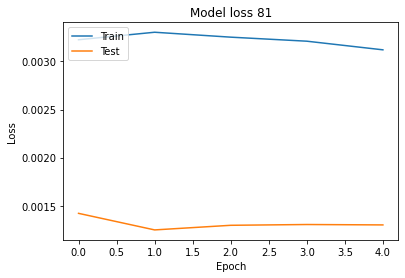

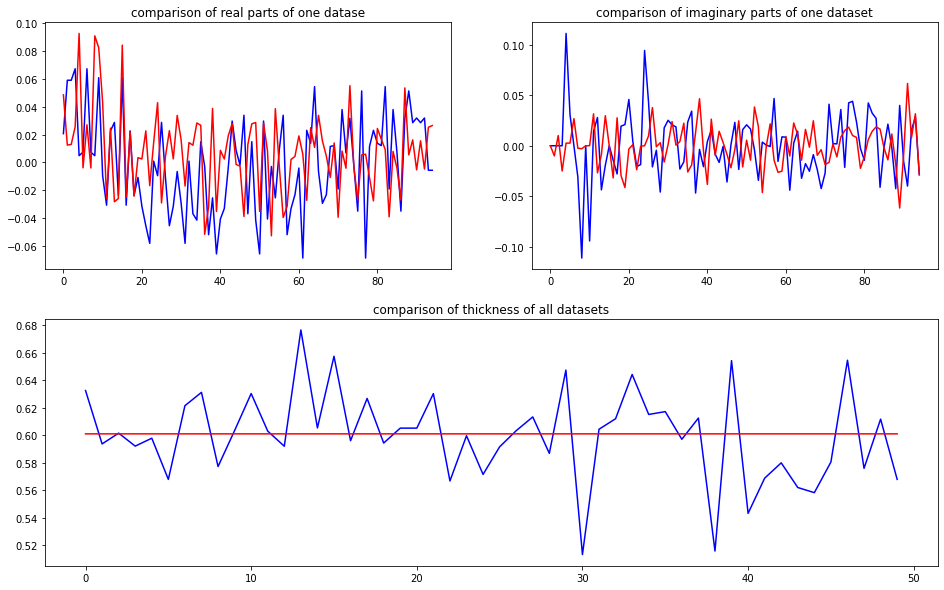

predicted thickness: 0.60099155


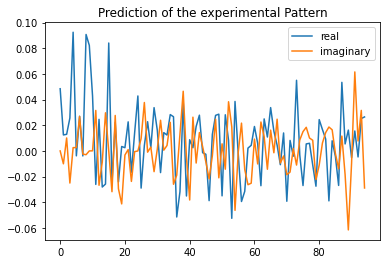

Applied shift of unit cell origin (fractional coordinates): 9.493687678139385e-07 0.12373053695300332 0.10664018634174456
Ug[ 0 ]: 0.04844 0.0  =>  0.04844 0.0
Ug[ 1 ]: 0.01621 -0.67004  =>  0.01621 -0.0
Ug[ 2 ]: 0.01621 0.67004  =>  0.01621 0.0
Ug[ 3 ]: 0.03693 -0.77742  =>  0.03693 -0.0
Ug[ 4 ]: 0.09161 0.03005  =>  0.09161 1.47751
Ug[ 5 ]: 0.00463 2.56173  =>  0.00463 2.66911
Ug[ 6 ]: 0.03693 0.77742  =>  0.03693 0.0
Ug[ 7 ]: 0.00463 -2.56173  =>  0.00463 -2.66911
Ug[ 8 ]: 0.09161 -0.03005  =>  0.09161 -1.47751
Ug[ 9 ]: 0.08313 -1e-05  =>  0.08313 0.0
Ug[ 10 ]: 0.04279 0.00107  =>  0.04279 0.67111
Ug[ 11 ]: 0.04064 2.24892  =>  0.04064 1.57888
Ug[ 12 ]: 0.03587 -0.86042  =>  0.03587 -1.63783
Ug[ 13 ]: 0.02996 -2.83196  =>  0.02996 -2.93933
Ug[ 14 ]: 0.03873 2.27178  =>  0.03873 0.82432
Ug[ 15 ]: 0.08313 1e-05  =>  0.08313 -0.0
Ug[ 16 ]: 0.04064 -2.24892  =>  0.04064 -1.57888
Ug[ 17 ]: 0.03587 0.86042  =>  0.03587 1.63783
Ug[ 18 ]: 0.03873 -2.27178  =>  0.03873 -0.82432
Ug[ 19 ]: 0.0

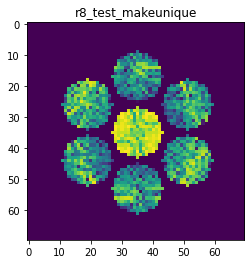

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9083931202435211
>>>replaced the 82. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


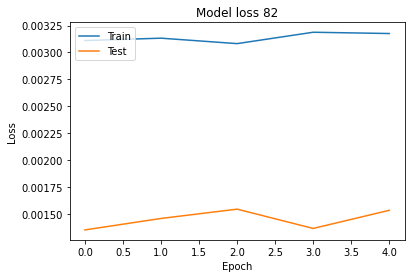

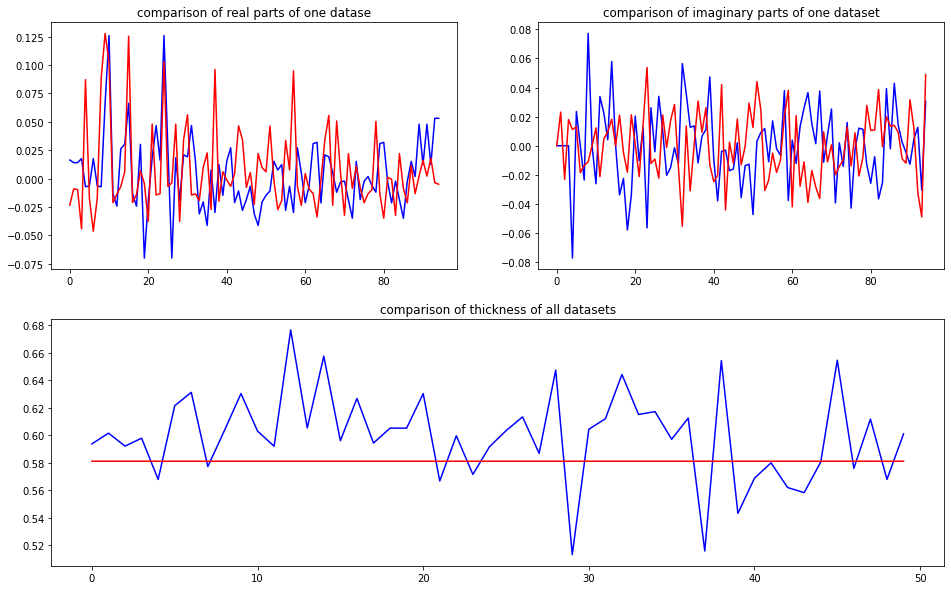

predicted thickness: 0.5811114


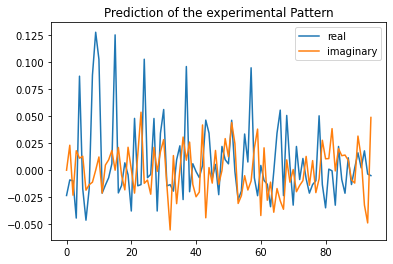

Applied shift of unit cell origin (fractional coordinates): -5.099550503481527e-07 -0.4390045271822755 -0.3114667375260059
Ug[ 0 ]: 0.02346 3.14159  =>  0.02346 3.14159
Ug[ 1 ]: 0.02501 1.957  =>  0.02501 -0.0
Ug[ 2 ]: 0.02501 -1.957  =>  0.02501 0.0
Ug[ 3 ]: 0.04893 2.75835  =>  0.04893 -0.0
Ug[ 4 ]: 0.08836 0.12619  =>  0.08836 1.69403
Ug[ 5 ]: 0.02167 2.48606  =>  0.02167 1.68472
Ug[ 6 ]: 0.04893 -2.75835  =>  0.04893 0.0
Ug[ 7 ]: 0.02167 -2.48606  =>  0.02167 -1.68472
Ug[ 8 ]: 0.08836 -0.12619  =>  0.08836 -1.69403
Ug[ 9 ]: 0.12671 0.0  =>  0.12671 0.0
Ug[ 10 ]: 0.10359 0.11819  =>  0.10359 -1.83882
Ug[ 11 ]: 0.0299 -2.3569  =>  0.0299 -0.3999
Ug[ 12 ]: 0.01477 2.81368  =>  0.01477 -0.71116
Ug[ 13 ]: 0.01169 2.21097  =>  0.01169 3.01231
Ug[ 14 ]: 0.01933 1.23124  =>  0.01933 -0.33659
Ug[ 15 ]: 0.12671 -0.0  =>  0.12671 -0.0
Ug[ 16 ]: 0.0299 2.3569  =>  0.0299 0.3999
Ug[ 17 ]: 0.01477 -2.81368  =>  0.01477 0.71116
Ug[ 18 ]: 0.01933 -1.23124  =>  0.01933 0.33659
Ug[ 19 ]: 0.02215 1.7

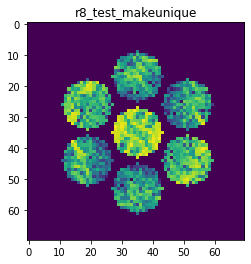

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9351823342094404
>>>replaced the 83. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 752ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0033 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


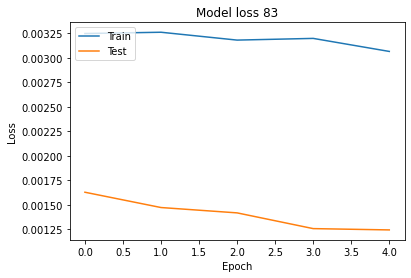

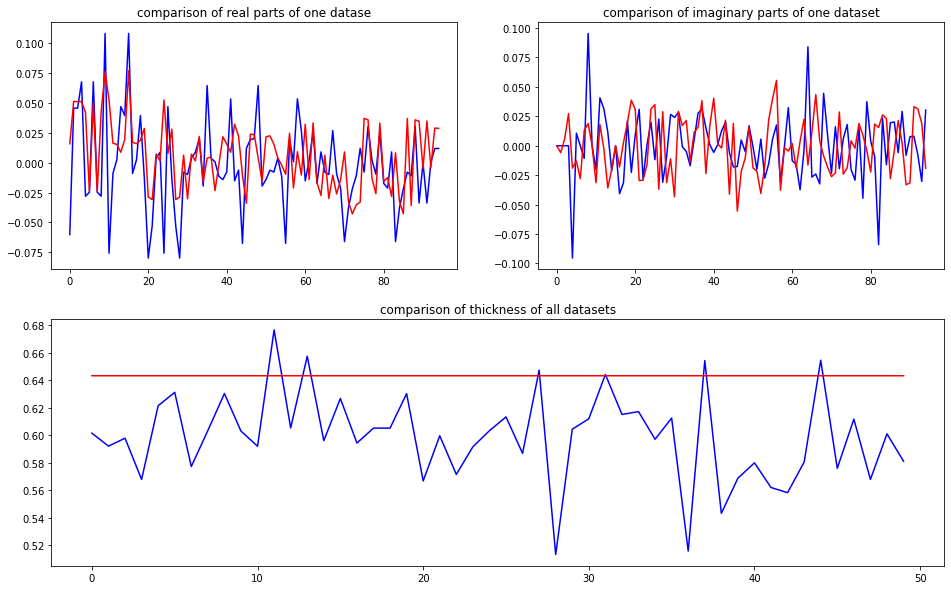

predicted thickness: 0.6431999


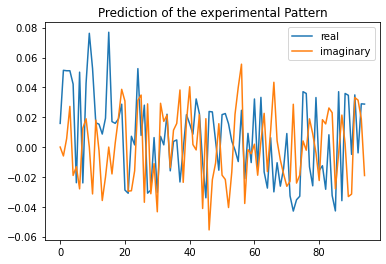

Applied shift of unit cell origin (fractional coordinates): 1.1308150527951674e-06 -0.07945737351003244 0.017909110021862483
Ug[ 0 ]: 0.01585 0.0  =>  0.01585 0.0
Ug[ 1 ]: 0.0516 -0.11253  =>  0.0516 -0.0
Ug[ 2 ]: 0.0516 0.11253  =>  0.0516 0.0
Ug[ 3 ]: 0.0577 0.49925  =>  0.0577 0.0
Ug[ 4 ]: 0.04651 -0.42021  =>  0.04651 -0.80693
Ug[ 5 ]: 0.02721 -2.64779  =>  0.02721 3.02362
Ug[ 6 ]: 0.0577 -0.49925  =>  0.0577 0.0
Ug[ 7 ]: 0.02721 2.64779  =>  0.02721 -3.02362
Ug[ 8 ]: 0.04651 0.42021  =>  0.04651 0.80693
Ug[ 9 ]: 0.07657 -1e-05  =>  0.07657 -0.0
Ug[ 10 ]: 0.06123 -0.53729  =>  0.06123 -0.42476
Ug[ 11 ]: 0.02455 0.82506  =>  0.02455 0.71254
Ug[ 12 ]: 0.01582 -0.16322  =>  0.01582 0.33603
Ug[ 13 ]: 0.03628 -1.34097  =>  0.03628 -0.72919
Ug[ 14 ]: 0.02755 -0.80561  =>  0.02755 -0.41888
Ug[ 15 ]: 0.07657 1e-05  =>  0.07657 0.0
Ug[ 16 ]: 0.02455 -0.82506  =>  0.02455 -0.71254
Ug[ 17 ]: 0.01582 0.16322  =>  0.01582 -0.33603
Ug[ 18 ]: 0.02755 0.80561  =>  0.02755 0.41888
Ug[ 19 ]: 0.04731

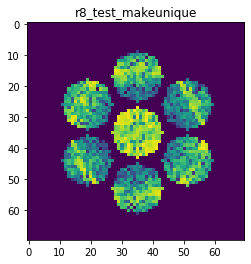

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8595132128564769
>>>replaced the 84. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 749ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 748ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 744ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


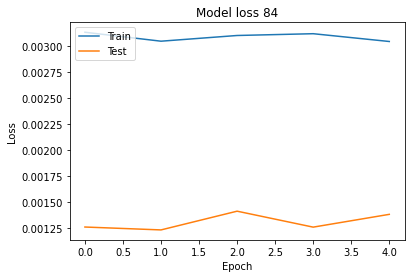

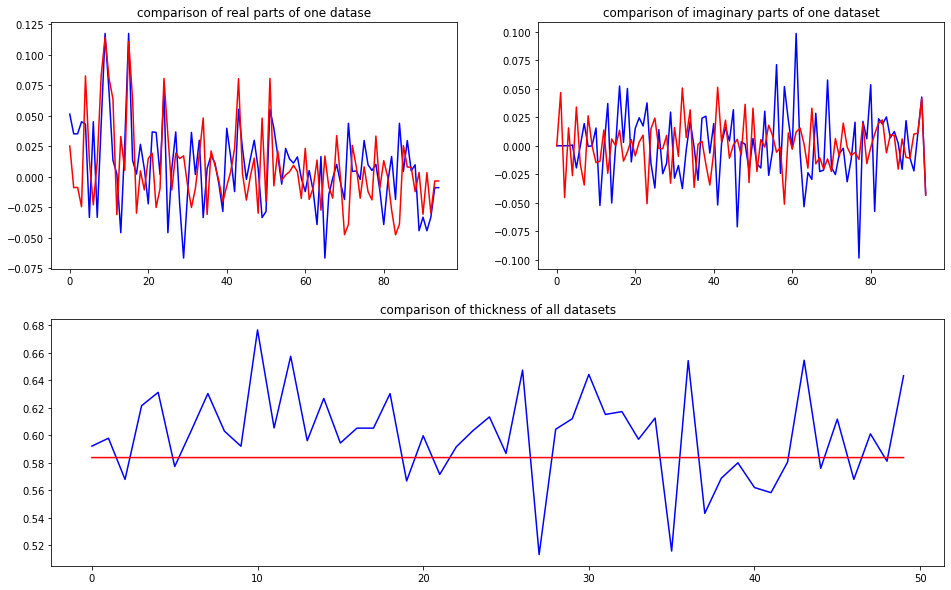

predicted thickness: 0.58375466


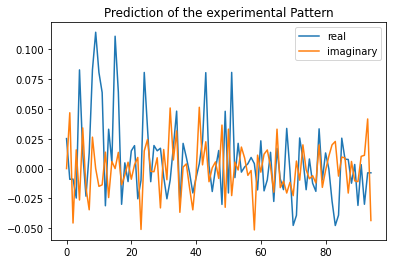

Applied shift of unit cell origin (fractional coordinates): -8.159670120888221e-07 -0.40616585000129674 -0.28023995358634585
Ug[ 0 ]: 0.02509 0.0  =>  0.02509 0.0
Ug[ 1 ]: 0.04698 1.7608  =>  0.04698 0.0
Ug[ 2 ]: 0.04698 -1.7608  =>  0.04698 -0.0
Ug[ 3 ]: 0.02871 2.55202  =>  0.02871 0.0
Ug[ 4 ]: 0.0867 -0.30798  =>  0.0867 1.66239
Ug[ 5 ]: 0.03663 1.20813  =>  0.03663 0.41691
Ug[ 6 ]: 0.02871 -2.55202  =>  0.02871 0.0
Ug[ 7 ]: 0.03663 -1.20813  =>  0.03663 -0.41691
Ug[ 8 ]: 0.0867 0.30798  =>  0.0867 -1.66239
Ug[ 9 ]: 0.11241 1e-05  =>  0.11241 -0.0
Ug[ 10 ]: 0.08181 -0.18246  =>  0.08181 -1.94326
Ug[ 11 ]: 0.06524 -0.20991  =>  0.06524 1.55089
Ug[ 12 ]: 0.0334 2.72118  =>  0.0334 -1.01
Ug[ 13 ]: 0.04133 -0.62791  =>  0.04133 0.1633
Ug[ 14 ]: 0.00758 0.85933  =>  0.00758 -1.11105
Ug[ 15 ]: 0.11241 -1e-05  =>  0.11241 0.0
Ug[ 16 ]: 0.06524 0.20991  =>  0.06524 -1.55089
Ug[ 17 ]: 0.0334 -2.72118  =>  0.0334 1.01
Ug[ 18 ]: 0.00758 -0.85933  =>  0.00758 1.11105
Ug[ 19 ]: 0.01156 2.80566  

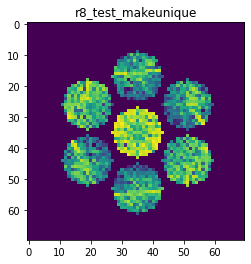

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9156125499704002
>>>replaced the 85. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 751ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0032 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


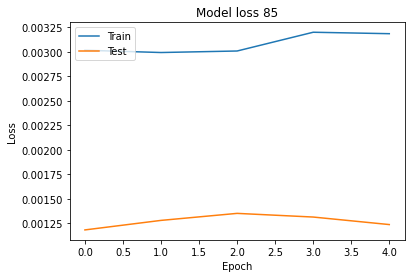

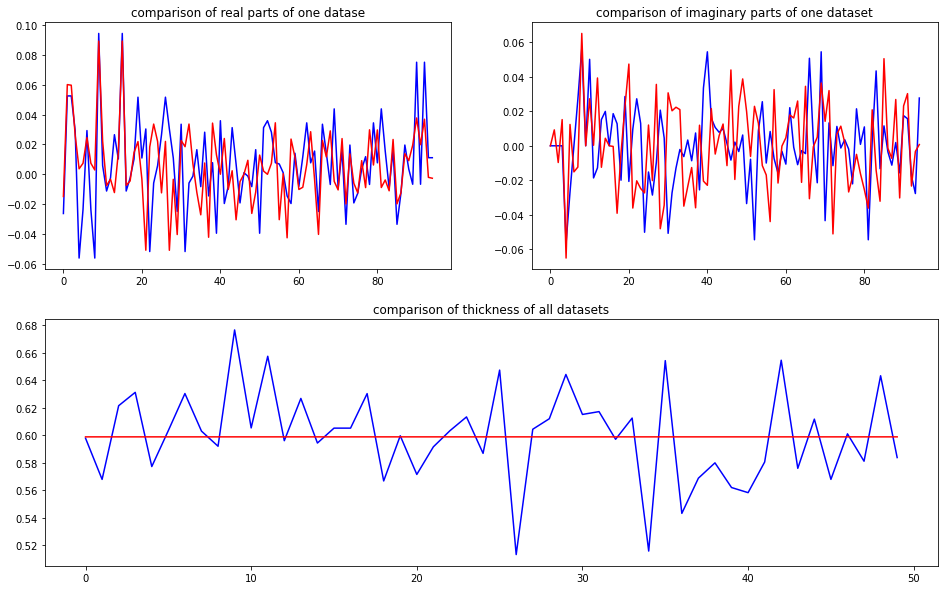

predicted thickness: 0.5988017


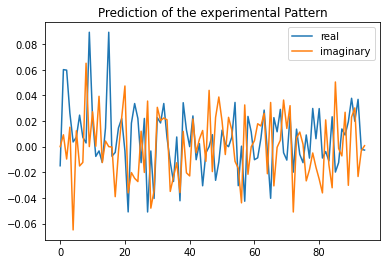

Applied shift of unit cell origin (fractional coordinates): -2.905456700325875e-06 -0.08570271575507302 -0.024923936817012247
Ug[ 0 ]: 0.01493 3.14159  =>  0.01493 3.14159
Ug[ 1 ]: 0.0606 0.1566  =>  0.0606 0.0
Ug[ 2 ]: 0.0606 -0.1566  =>  0.0606 0.0
Ug[ 3 ]: 0.0295 0.53849  =>  0.0295 -0.0
Ug[ 4 ]: 0.06509 -1.52105  =>  0.06509 -2.21614
Ug[ 5 ]: 0.01435 1.03486  =>  0.01435 0.65298
Ug[ 6 ]: 0.0295 -0.53849  =>  0.0295 0.0
Ug[ 7 ]: 0.01435 -1.03486  =>  0.01435 -0.65298
Ug[ 8 ]: 0.06509 1.52105  =>  0.06509 2.21614
Ug[ 9 ]: 0.08922 2e-05  =>  0.08922 0.0
Ug[ 10 ]: 0.03504 0.89032  =>  0.03504 0.7337
Ug[ 11 ]: 0.00755 3.09775  =>  0.00755 -3.02885
Ug[ 12 ]: 0.03935 1.671  =>  0.03935 2.20946
Ug[ 13 ]: 0.01742 -2.36307  =>  0.01742 -1.9812
Ug[ 14 ]: 0.01516 0.28373  =>  0.01516 0.9788
Ug[ 15 ]: 0.08922 -2e-05  =>  0.08922 -0.0
Ug[ 16 ]: 0.00755 -3.09775  =>  0.00755 3.02885
Ug[ 17 ]: 0.03935 -1.671  =>  0.03935 -2.20946
Ug[ 18 ]: 0.01516 -0.28373  =>  0.01516 -0.9788
Ug[ 19 ]: 0.03062 0.

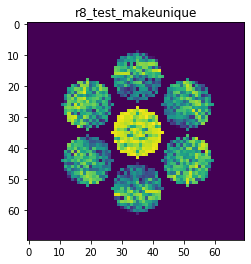

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8912003209496365
>>>replaced the 86. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


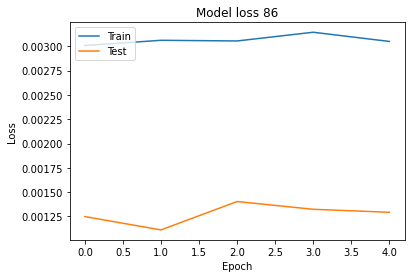

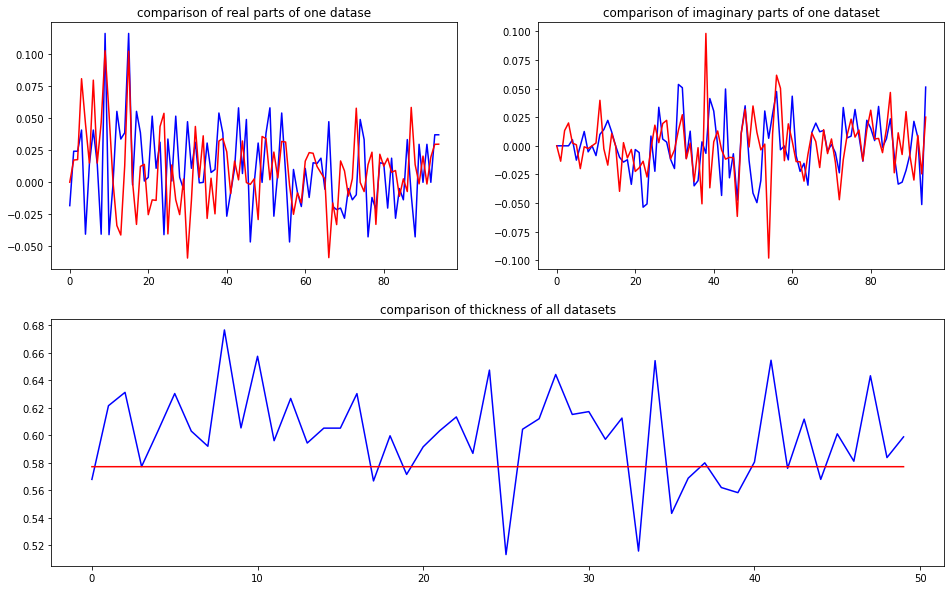

predicted thickness: 0.57712996


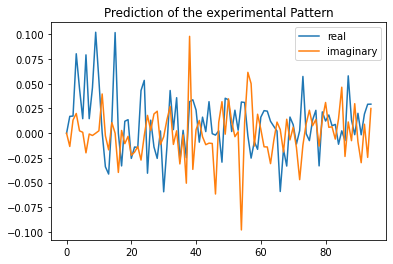

Applied shift of unit cell origin (fractional coordinates): 1.3387745080108006e-06 -0.0389030032604967 0.10509893490927978
Ug[ 0 ]: 0.00022 3.14159  =>  0.00022 3.14159
Ug[ 1 ]: 0.02177 -0.66036  =>  0.02177 0.0
Ug[ 2 ]: 0.02177 0.66036  =>  0.02177 0.0
Ug[ 3 ]: 0.0823 0.24443  =>  0.0823 0.0
Ug[ 4 ]: 0.04578 0.05139  =>  0.04578 0.46731
Ug[ 5 ]: 0.0147 0.05962  =>  0.0147 -0.84517
Ug[ 6 ]: 0.0823 -0.24443  =>  0.0823 0.0
Ug[ 7 ]: 0.0147 -0.05962  =>  0.0147 0.84517
Ug[ 8 ]: 0.04578 -0.05139  =>  0.04578 -0.46731
Ug[ 9 ]: 0.10203 -1e-05  =>  0.10203 0.0
Ug[ 10 ]: 0.05346 0.04597  =>  0.05346 0.70633
Ug[ 11 ]: 0.03971 1.56239  =>  0.03971 0.90204
Ug[ 12 ]: 0.03367 -3.06154  =>  0.03367 -2.8171
Ug[ 13 ]: 0.0445 -2.73911  =>  0.0445 -1.83431
Ug[ 14 ]: 0.01634 0.70752  =>  0.01634 0.29161
Ug[ 15 ]: 0.10203 1e-05  =>  0.10203 0.0
Ug[ 16 ]: 0.03971 -1.56239  =>  0.03971 -0.90204
Ug[ 17 ]: 0.03367 3.06154  =>  0.03367 2.8171
Ug[ 18 ]: 0.01634 -0.70752  =>  0.01634 -0.29161
Ug[ 19 ]: 0.01378 -

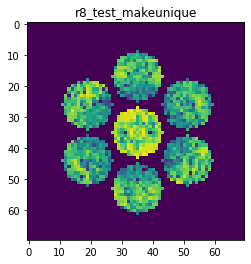

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8633878008902721
>>>replaced the 87. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


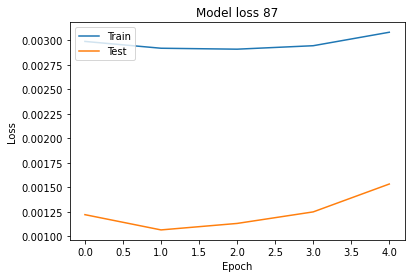

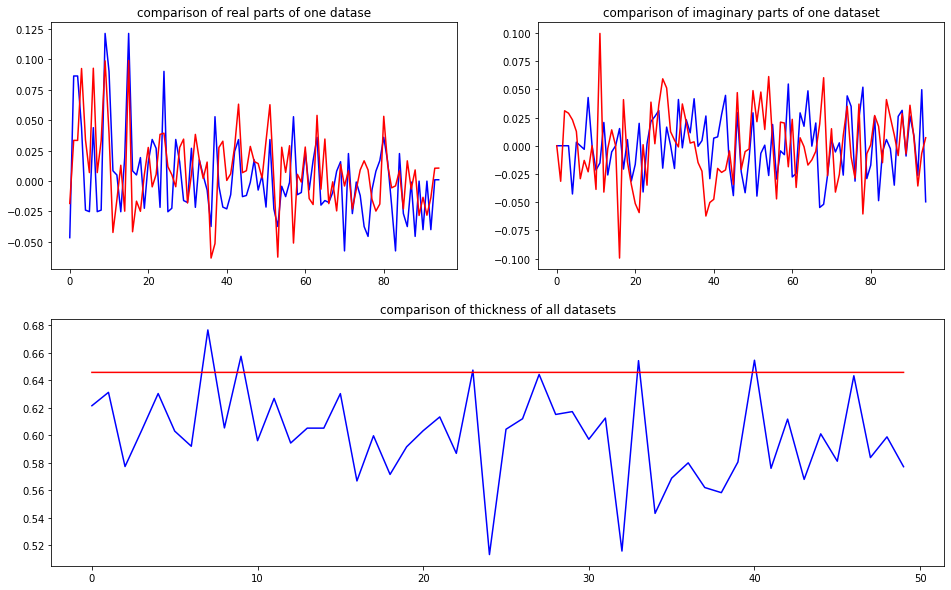

predicted thickness: 0.64564943


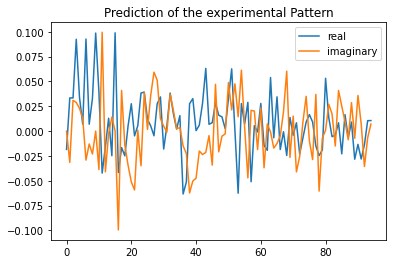

Applied shift of unit cell origin (fractional coordinates): 2.3444471408405037e-07 -0.048340493046798515 0.11976813077279397
Ug[ 0 ]: 0.01844 3.14159  =>  0.01844 3.14159
Ug[ 1 ]: 0.04568 -0.75253  =>  0.04568 0.0
Ug[ 2 ]: 0.04568 0.75253  =>  0.04568 0.0
Ug[ 3 ]: 0.09692 0.30373  =>  0.09692 0.0
Ug[ 4 ]: 0.04057 0.60305  =>  0.04057 1.05184
Ug[ 5 ]: 0.01457 1.07669  =>  0.01457 0.02044
Ug[ 6 ]: 0.09692 -0.30373  =>  0.09692 -0.0
Ug[ 7 ]: 0.01457 -1.07669  =>  0.01457 -0.02044
Ug[ 8 ]: 0.04057 -0.60305  =>  0.04057 -1.05184
Ug[ 9 ]: 0.09875 -0.0  =>  0.09875 0.0
Ug[ 10 ]: 0.05505 -0.77801  =>  0.05505 -0.02548
Ug[ 11 ]: 0.10795 1.97031  =>  0.10795 1.21778
Ug[ 12 ]: 0.04399 -1.94566  =>  0.04399 -1.64193
Ug[ 13 ]: 0.01251 -0.16855  =>  0.01251 0.88771
Ug[ 14 ]: 0.02857 2.62645  =>  0.02857 2.17766
Ug[ 15 ]: 0.09875 0.0  =>  0.09875 0.0
Ug[ 16 ]: 0.10795 -1.97031  =>  0.10795 -1.21778
Ug[ 17 ]: 0.04399 1.94566  =>  0.04399 1.64193
Ug[ 18 ]: 0.02857 -2.62645  =>  0.02857 -2.17766
Ug[ 19 

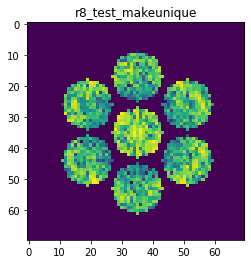

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.7320708888653611
>>>replaced the 88. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 724ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


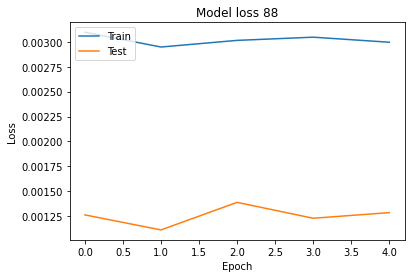

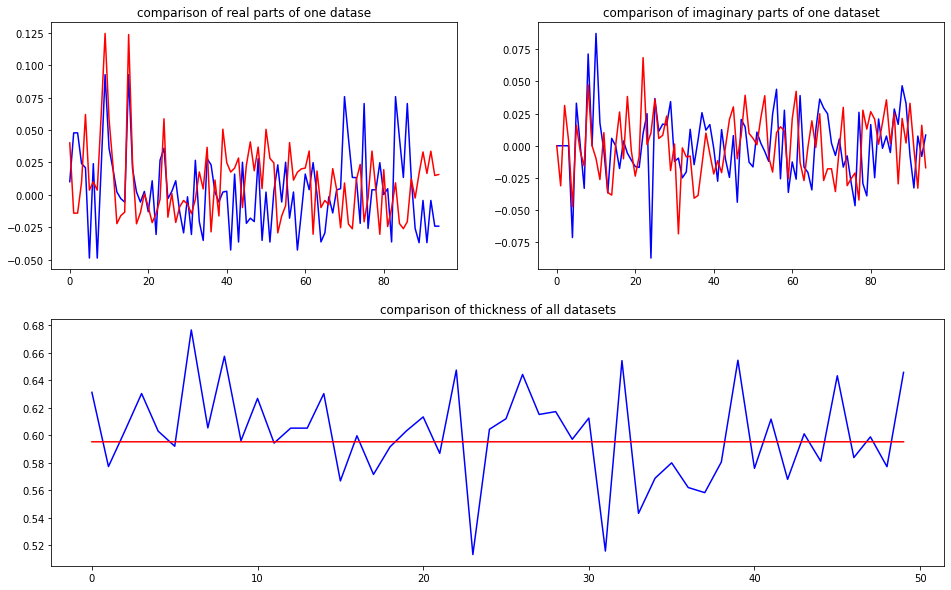

predicted thickness: 0.5952196


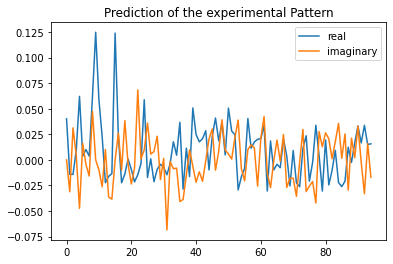

Applied shift of unit cell origin (fractional coordinates): 1.8741036594721567e-06 -0.06743862738021802 0.31763686565253235
Ug[ 0 ]: 0.0401 0.0  =>  0.0401 0.0
Ug[ 1 ]: 0.03429 -1.99577  =>  0.03429 -0.0
Ug[ 2 ]: 0.03429 1.99577  =>  0.03429 0.0
Ug[ 3 ]: 0.01079 0.42373  =>  0.01079 0.0
Ug[ 4 ]: 0.07782 -0.65348  =>  0.07782 0.91857
Ug[ 5 ]: 0.01628 1.34564  =>  0.01628 -1.07386
Ug[ 6 ]: 0.01079 -0.42373  =>  0.01079 0.0
Ug[ 7 ]: 0.01628 -1.34564  =>  0.01628 1.07386
Ug[ 8 ]: 0.07782 0.65348  =>  0.07782 -0.91857
Ug[ 9 ]: 0.12432 -1e-05  =>  0.12432 0.0
Ug[ 10 ]: 0.0596 -0.16642  =>  0.0596 1.82936
Ug[ 11 ]: 0.03506 -0.84521  =>  0.03506 -2.84097
Ug[ 12 ]: 0.02452 2.71574  =>  0.02452 3.13948
Ug[ 13 ]: 0.03987 -2.00285  =>  0.03987 0.41667
Ug[ 14 ]: 0.04067 -1.91142  =>  0.04067 2.79973
Ug[ 15 ]: 0.12432 1e-05  =>  0.12432 0.0
Ug[ 16 ]: 0.03506 0.84521  =>  0.03506 2.84097
Ug[ 17 ]: 0.02452 -2.71574  =>  0.02452 -3.13948
Ug[ 18 ]: 0.04067 1.91142  =>  0.04067 -2.79973
Ug[ 19 ]: 0.00492

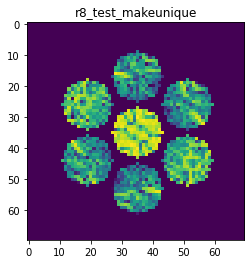

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9051410100043802
>>>replaced the 89. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 755ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 1.0000


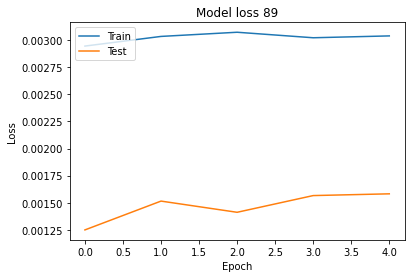

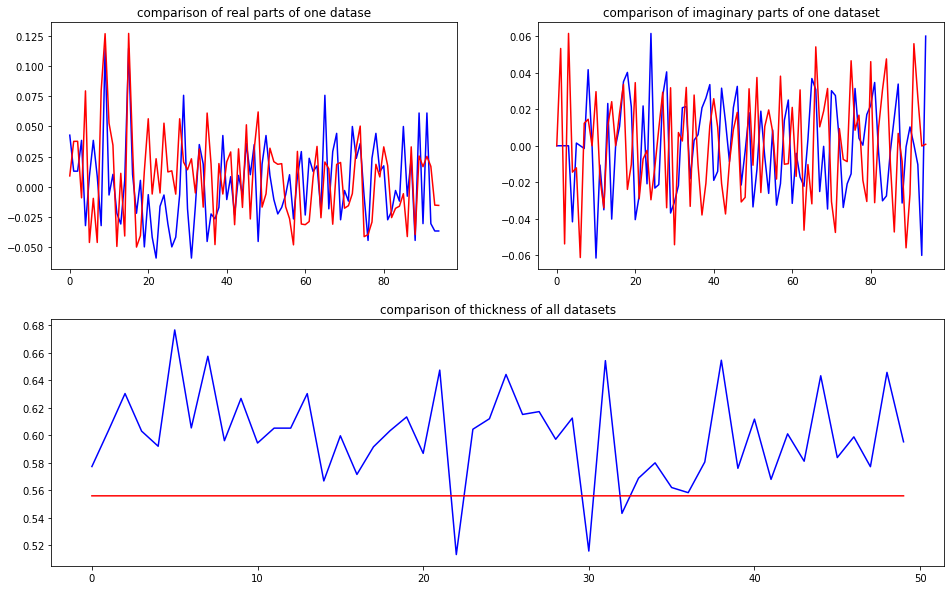

predicted thickness: 0.5559596


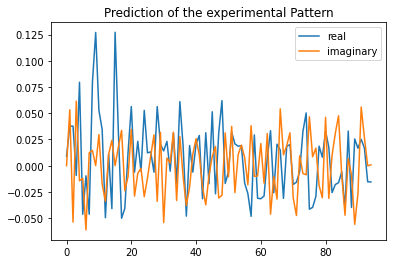

Applied shift of unit cell origin (fractional coordinates): -1.7962501603536226e-06 -0.2743920824086414 -0.15249868804931166
Ug[ 0 ]: 0.00893 0.0  =>  0.00893 0.0
Ug[ 1 ]: 0.06545 0.95818  =>  0.06545 0.0
Ug[ 2 ]: 0.06545 -0.95818  =>  0.06545 -0.0
Ug[ 3 ]: 0.06213 1.72406  =>  0.06213 -0.0
Ug[ 4 ]: 0.0809 -0.18004  =>  0.0809 -2.86228
Ug[ 5 ]: 0.04791 -2.88386  =>  0.04791 2.63345
Ug[ 6 ]: 0.06213 -1.72406  =>  0.06213 0.0
Ug[ 7 ]: 0.04791 2.88386  =>  0.04791 -2.63345
Ug[ 8 ]: 0.0809 0.18004  =>  0.0809 2.86228
Ug[ 9 ]: 0.12709 1e-05  =>  0.12709 0.0
Ug[ 10 ]: 0.06046 0.51206  =>  0.06046 -0.44613
Ug[ 11 ]: 0.03793 -0.48369  =>  0.03793 0.47447
Ug[ 12 ]: 0.06027 -2.54587  =>  0.06027 -0.82182
Ug[ 13 ]: 0.01617 0.76601  =>  0.01617 1.53188
Ug[ 14 ]: 0.04735 2.60928  =>  0.04735 -0.99168
Ug[ 15 ]: 0.12709 -1e-05  =>  0.12709 -0.0
Ug[ 16 ]: 0.03793 0.48369  =>  0.03793 -0.47447
Ug[ 17 ]: 0.06027 2.54587  =>  0.06027 0.82182
Ug[ 18 ]: 0.04735 -2.60928  =>  0.04735 0.99168
Ug[ 19 ]: 0.016

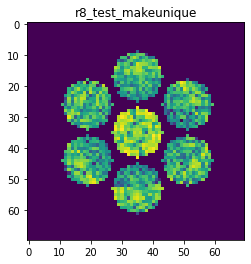

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8364993048537802
>>>replaced the 90. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 792ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0031 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0030 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


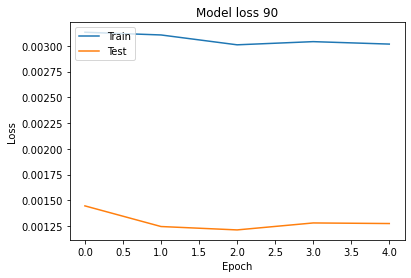

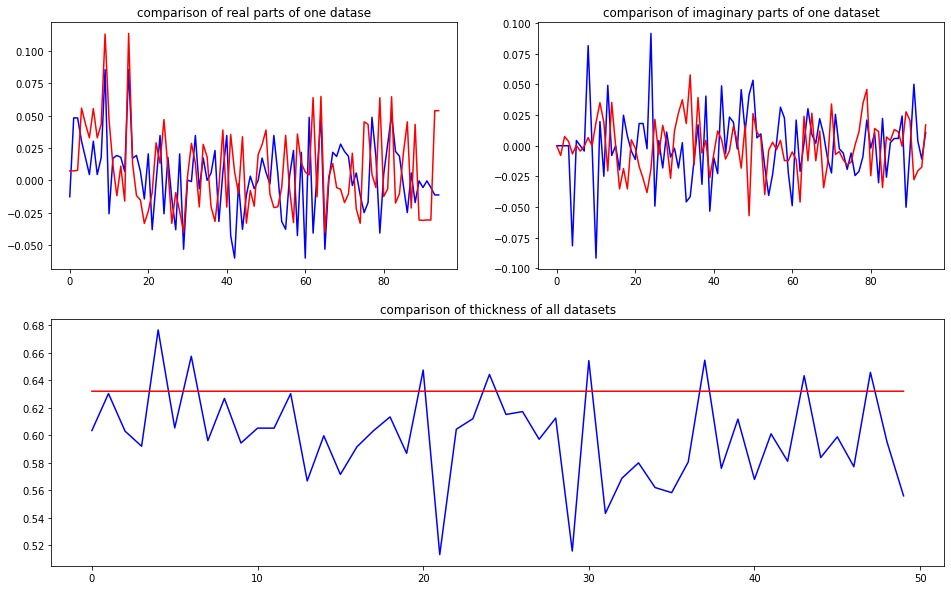

predicted thickness: 0.6319612


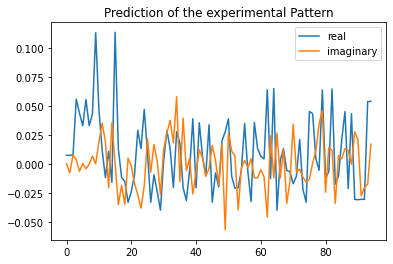

Applied shift of unit cell origin (fractional coordinates): -9.744928003441484e-08 -0.01133987280042103 0.12705418527158274
Ug[ 0 ]: 0.0073 0.0  =>  0.0073 0.0
Ug[ 1 ]: 0.01075 -0.7983  =>  0.01075 0.0
Ug[ 2 ]: 0.01075 0.7983  =>  0.01075 0.0
Ug[ 3 ]: 0.05572 0.07125  =>  0.05572 -0.0
Ug[ 4 ]: 0.04383 -0.15179  =>  0.04383 0.57526
Ug[ 5 ]: 0.03285 0.01015  =>  0.03285 -0.8594
Ug[ 6 ]: 0.05572 -0.07125  =>  0.05572 0.0
Ug[ 7 ]: 0.03285 -0.01015  =>  0.03285 0.8594
Ug[ 8 ]: 0.04383 0.15179  =>  0.04383 -0.57526
Ug[ 9 ]: 0.11322 0.0  =>  0.11322 0.0
Ug[ 10 ]: 0.05061 0.38385  =>  0.05061 1.18215
Ug[ 11 ]: 0.03726 1.23432  =>  0.03726 0.43601
Ug[ 12 ]: 0.02228 2.13252  =>  0.02228 2.20377
Ug[ 13 ]: 0.02342 -1.11542  =>  0.02342 -0.24587
Ug[ 14 ]: 0.03856 1.98901  =>  0.03856 1.26196
Ug[ 15 ]: 0.11322 -0.0  =>  0.11322 0.0
Ug[ 16 ]: 0.03726 -1.23432  =>  0.03726 -0.43601
Ug[ 17 ]: 0.02228 -2.13252  =>  0.02228 -2.20377
Ug[ 18 ]: 0.03856 -1.98901  =>  0.03856 -1.26196
Ug[ 19 ]: 0.03384 2.961

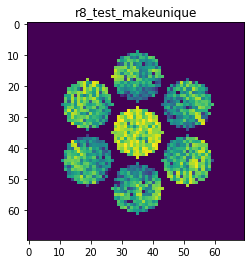

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8351152730154515
>>>replaced the 91. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 724ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


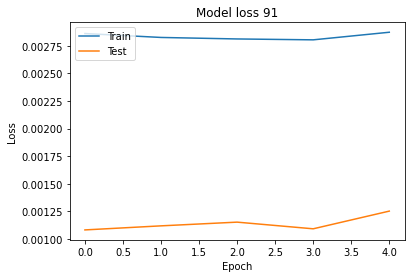

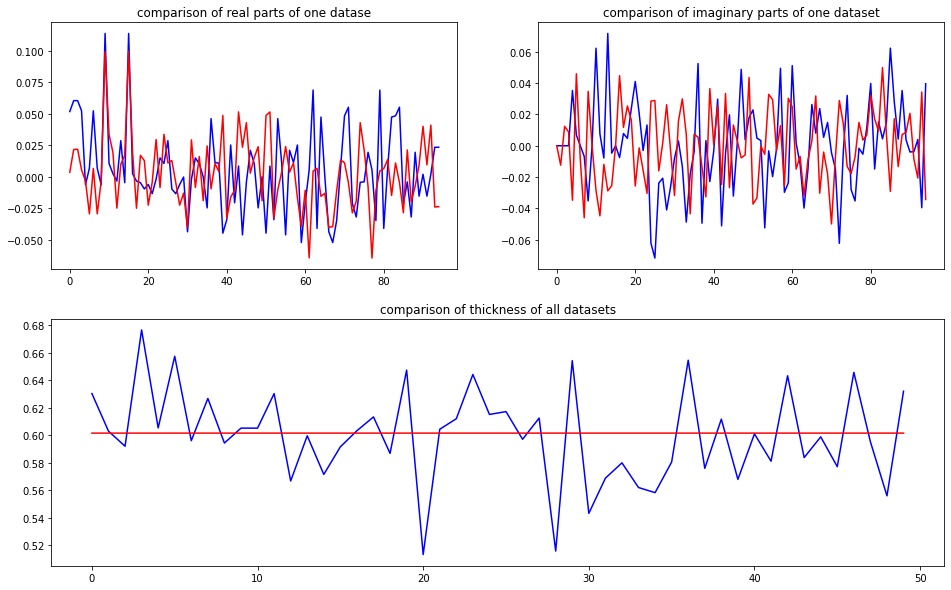

predicted thickness: 0.6015263


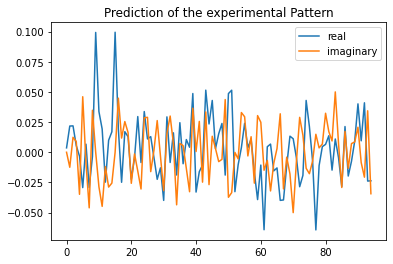

Applied shift of unit cell origin (fractional coordinates): 1.1643628336296925e-06 -0.1542109628092777 0.08243878557597178
Ug[ 0 ]: 0.00364 0.0  =>  0.00364 0.0
Ug[ 1 ]: 0.02509 -0.51798  =>  0.02509 -0.0
Ug[ 2 ]: 0.02509 0.51798  =>  0.02509 0.0
Ug[ 3 ]: 0.01083 0.96894  =>  0.01083 0.0
Ug[ 4 ]: 0.03499 -1.66646  =>  0.03499 -2.11742
Ug[ 5 ]: 0.05457 2.13743  =>  0.05457 0.65052
Ug[ 6 ]: 0.01083 -0.96894  =>  0.01083 -0.0
Ug[ 7 ]: 0.05457 -2.13743  =>  0.05457 -0.65052
Ug[ 8 ]: 0.03499 1.66646  =>  0.03499 2.11742
Ug[ 9 ]: 0.09937 -1e-05  =>  0.09937 0.0
Ug[ 10 ]: 0.04423 -0.70342  =>  0.04423 -0.18544
Ug[ 11 ]: 0.04884 -1.1632  =>  0.04884 -1.68117
Ug[ 12 ]: 0.0275 -2.69705  =>  0.0275 -1.72811
Ug[ 13 ]: 0.03074 -1.22299  =>  0.03074 0.26393
Ug[ 14 ]: 0.03065 -0.9822  =>  0.03065 -0.53123
Ug[ 15 ]: 0.09937 1e-05  =>  0.09937 0.0
Ug[ 16 ]: 0.04884 1.1632  =>  0.04884 1.68117
Ug[ 17 ]: 0.0275 2.69705  =>  0.0275 1.72811
Ug[ 18 ]: 0.03065 0.9822  =>  0.03065 0.53123
Ug[ 19 ]: 0.02072 0.

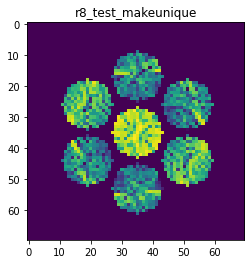

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9780288675566733
>>>replaced the 92. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 761ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


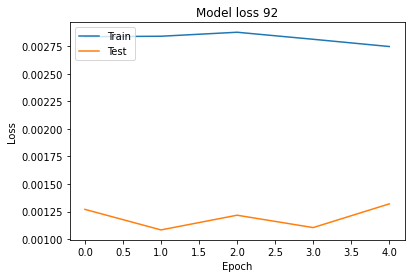

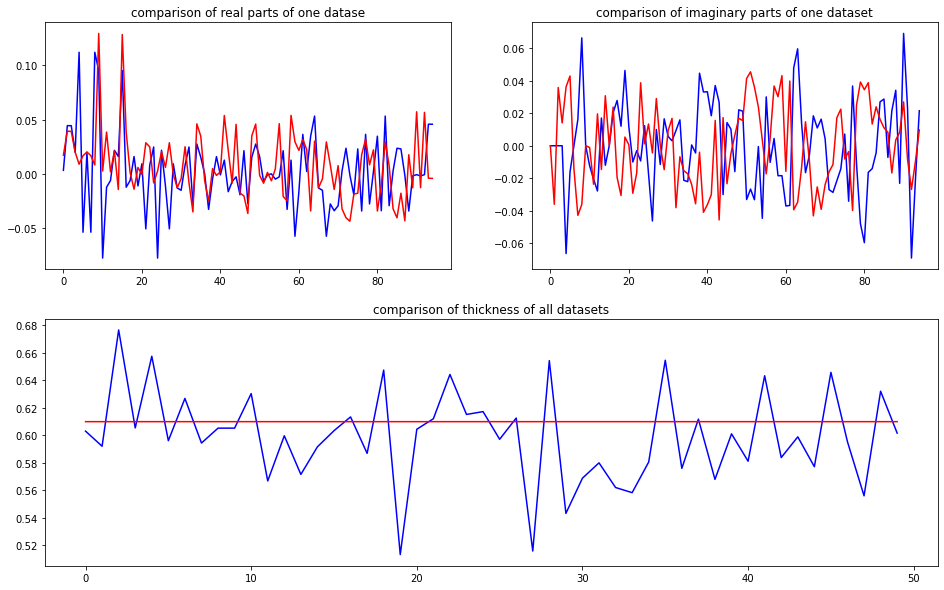

predicted thickness: 0.6098509


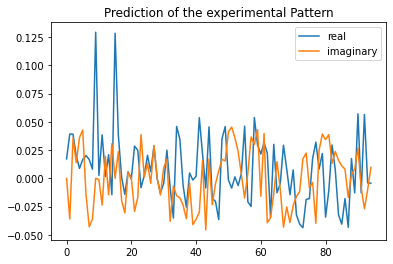

Applied shift of unit cell origin (fractional coordinates): -4.243062838084452e-05 -0.09712796438594828 0.11792671943903671
Ug[ 0 ]: 0.01721 0.0  =>  0.01721 0.0
Ug[ 1 ]: 0.05315 -0.74096  =>  0.05315 -0.0
Ug[ 2 ]: 0.05315 0.74096  =>  0.05315 0.0
Ug[ 3 ]: 0.02452 0.61027  =>  0.02452 0.0
Ug[ 4 ]: 0.03715 1.33943  =>  0.03715 1.47012
Ug[ 5 ]: 0.04595 1.19899  =>  0.04595 -0.15223
Ug[ 6 ]: 0.02452 -0.61027  =>  0.02452 0.0
Ug[ 7 ]: 0.04595 -1.19899  =>  0.04595 0.15223
Ug[ 8 ]: 0.03715 -1.33943  =>  0.03715 -1.47012
Ug[ 9 ]: 0.12886 0.00027  =>  0.12886 0.0
Ug[ 10 ]: 0.00284 -0.40721  =>  0.00284 0.33348
Ug[ 11 ]: 0.04509 -0.55299  =>  0.04509 -1.29421
Ug[ 12 ]: 0.01958 1.49701  =>  0.01958 2.10701
Ug[ 13 ]: 0.02498 -0.59347  =>  0.02498 0.75749
Ug[ 14 ]: 0.03381 2.00712  =>  0.03381 1.87617
Ug[ 15 ]: 0.12886 -0.00027  =>  0.12886 0.0
Ug[ 16 ]: 0.04509 0.55299  =>  0.04509 1.29421
Ug[ 17 ]: 0.01958 -1.49701  =>  0.01958 -2.10701
Ug[ 18 ]: 0.03381 -2.00712  =>  0.03381 -1.87617
Ug[ 19 ]:

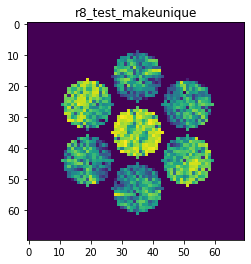

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9257172984752894
>>>replaced the 93. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 744ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


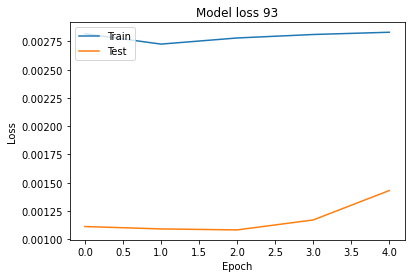

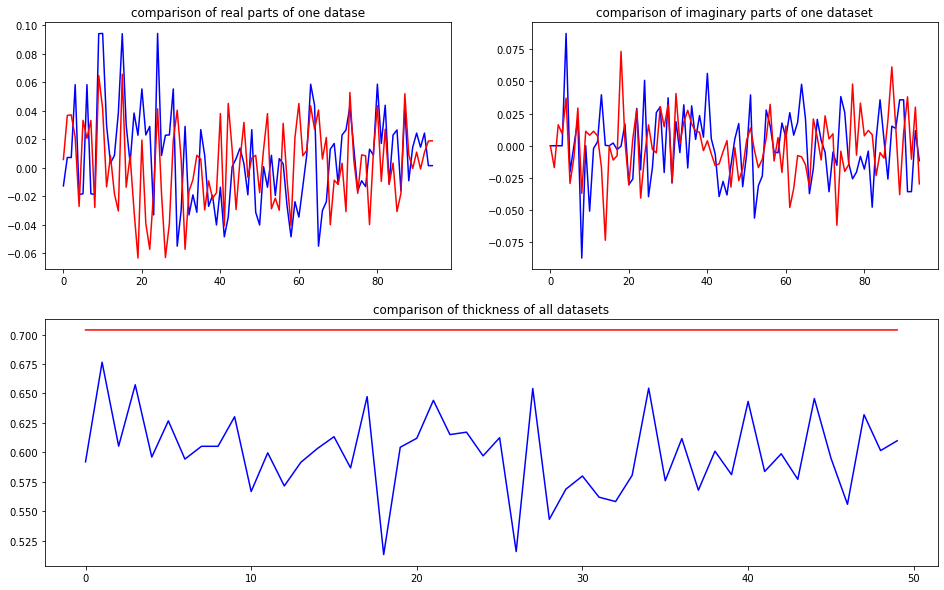

predicted thickness: 0.7038788


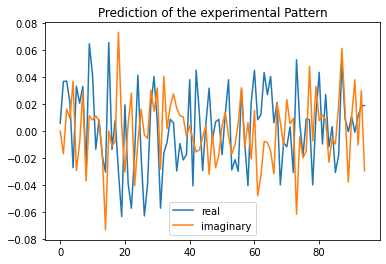

Applied shift of unit cell origin (fractional coordinates): -0.01372416161969328 -0.066223911720059 0.06726342481612402
Ug[ 0 ]: 0.00579 0.0  =>  0.00579 0.0
Ug[ 1 ]: 0.04054 -0.42263  =>  0.04054 0.0
Ug[ 2 ]: 0.04054 0.42263  =>  0.04054 0.0
Ug[ 3 ]: 0.023 0.4161  =>  0.023 0.0
Ug[ 4 ]: 0.04614 2.2106  =>  0.04614 2.21714
Ug[ 5 ]: 0.04433 -0.72299  =>  0.04433 -1.56171
Ug[ 6 ]: 0.023 -0.4161  =>  0.023 -0.0
Ug[ 7 ]: 0.04433 0.72299  =>  0.04433 1.56171
Ug[ 8 ]: 0.04614 -2.2106  =>  0.04614 -2.21714
Ug[ 9 ]: 0.06552 0.08623  =>  0.06552 0.0
Ug[ 10 ]: 0.04225 0.19449  =>  0.04225 0.53088
Ug[ 11 ]: 0.01759 2.45114  =>  0.01759 1.94228
Ug[ 12 ]: 0.01132 0.7555  =>  0.01132 1.08537
Ug[ 13 ]: 0.02447 -2.4108  =>  0.02447 -1.6583
Ug[ 14 ]: 0.07944 -1.96296  =>  0.07944 -2.05572
Ug[ 15 ]: 0.06552 -0.08623  =>  0.06552 0.0
Ug[ 16 ]: 0.01759 -2.45114  =>  0.01759 -1.94228
Ug[ 17 ]: 0.01132 -0.7555  =>  0.01132 -1.08537
Ug[ 18 ]: 0.07944 1.96296  =>  0.07944 2.05572
Ug[ 19 ]: 0.06337 3.09026  =>

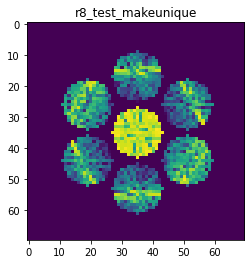

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9595900786209579
>>>replaced the 94. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 756ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


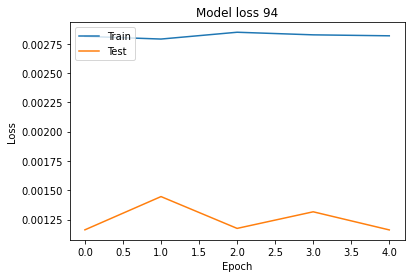

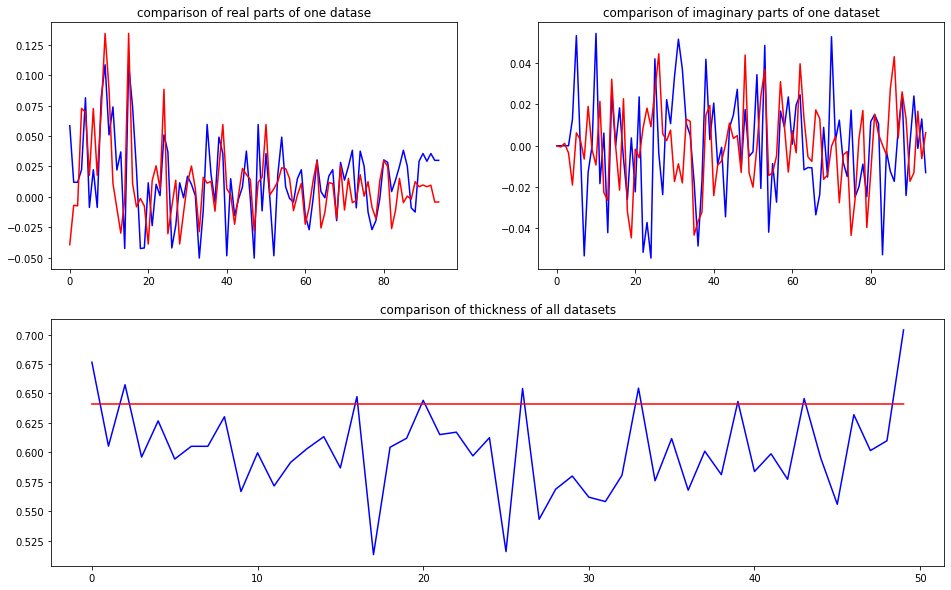

predicted thickness: 0.64105034


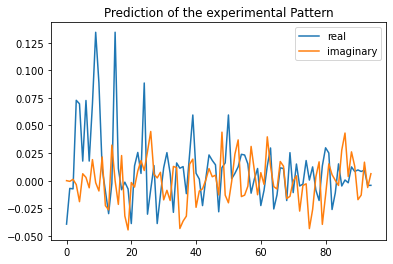

Applied shift of unit cell origin (fractional coordinates): 0.0011011287659073604 0.007070765763435277 0.4799903488857373
Ug[ 0 ]: 0.03937 3.14159  =>  0.03937 3.14159
Ug[ 1 ]: 0.00726 -3.01587  =>  0.00726 -0.0
Ug[ 2 ]: 0.00726 3.01587  =>  0.00726 0.0
Ug[ 3 ]: 0.07277 -0.04443  =>  0.07277 0.0
Ug[ 4 ]: 0.07217 -0.26714  =>  0.07217 2.79316
Ug[ 5 ]: 0.01884 0.34417  =>  0.01884 -2.62727
Ug[ 6 ]: 0.07277 0.04443  =>  0.07277 0.0
Ug[ 7 ]: 0.01884 -0.34417  =>  0.01884 2.62727
Ug[ 8 ]: 0.07217 0.26714  =>  0.07217 -2.79316
Ug[ 9 ]: 0.13442 -0.00692  =>  0.13442 0.0
Ug[ 10 ]: 0.08896 -0.10443  =>  0.08896 2.91836
Ug[ 11 ]: 0.02415 1.09715  =>  0.02415 -1.9118
Ug[ 12 ]: 0.02434 -1.94088  =>  0.02434 -1.97839
Ug[ 13 ]: 0.04005 -2.42207  =>  0.04005 0.55629
Ug[ 14 ]: 0.03211 1.62651  =>  0.03211 -1.42687
Ug[ 15 ]: 0.13442 0.00692  =>  0.13442 0.0
Ug[ 16 ]: 0.02415 -1.09715  =>  0.02415 1.9118
Ug[ 17 ]: 0.02434 1.94088  =>  0.02434 1.97839
Ug[ 18 ]: 0.03211 -1.62651  =>  0.03211 1.42687
Ug[ 1

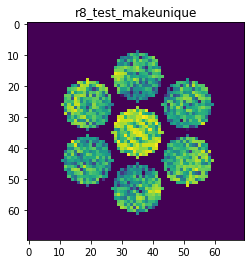

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.875025454857378
>>>replaced the 95. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 741ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


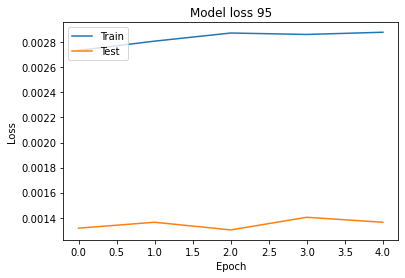

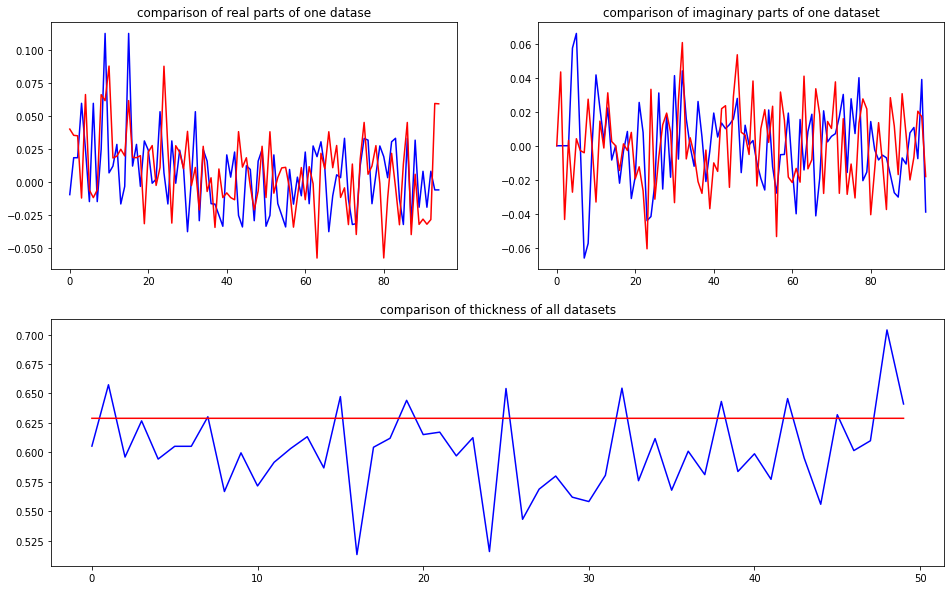

predicted thickness: 0.6289064


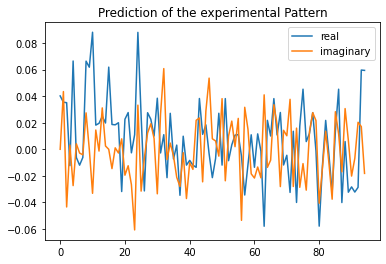

Applied shift of unit cell origin (fractional coordinates): 0.0001292979327039375 -0.46101339462392293 -0.14144957720675191
Ug[ 0 ]: 0.04018 0.0  =>  0.04018 0.0
Ug[ 1 ]: 0.05594 0.88875  =>  0.05594 0.0
Ug[ 2 ]: 0.05594 -0.88875  =>  0.05594 -0.0
Ug[ 3 ]: 0.01248 2.89663  =>  0.01248 0.0
Ug[ 4 ]: 0.07183 -0.39102  =>  0.07183 2.10678
Ug[ 5 ]: 0.00741 2.549  =>  0.00741 0.54112
Ug[ 6 ]: 0.01248 -2.89663  =>  0.01248 -0.0
Ug[ 7 ]: 0.00741 -2.549  =>  0.00741 -0.54112
Ug[ 8 ]: 0.07183 0.39102  =>  0.07183 -2.10678
Ug[ 9 ]: 0.06182 -0.00081  =>  0.06182 0.0
Ug[ 10 ]: 0.0941 -0.36041  =>  0.0941 -1.24835
Ug[ 11 ]: 0.02347 0.66718  =>  0.02347 1.55675
Ug[ 12 ]: 0.01903 -0.064  =>  0.01903 2.83344
Ug[ 13 ]: 0.04012 0.8956  =>  0.04012 2.90429
Ug[ 14 ]: 0.02008 0.13189  =>  0.02008 -2.3651
Ug[ 15 ]: 0.06182 0.00081  =>  0.06182 -0.0
Ug[ 16 ]: 0.02347 -0.66718  =>  0.02347 -1.55675
Ug[ 17 ]: 0.01903 0.064  =>  0.01903 -2.83344
Ug[ 18 ]: 0.02008 -0.13189  =>  0.02008 2.3651
Ug[ 19 ]: 0.03238 2.

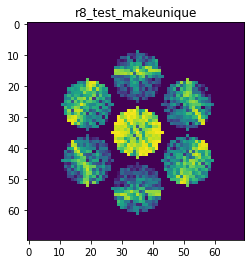

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9766919794415186
>>>replaced the 96. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0029 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000


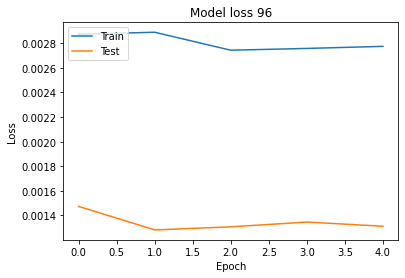

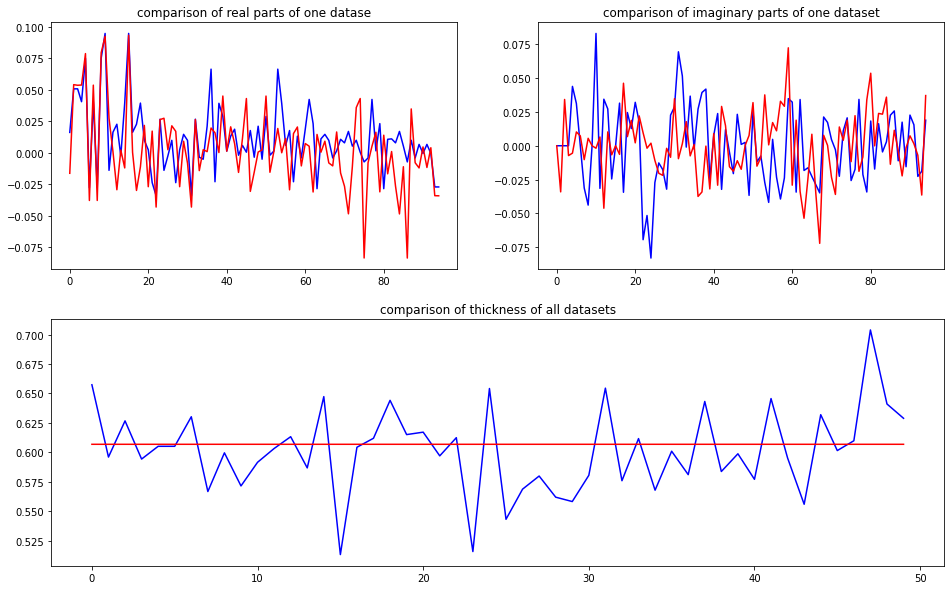

predicted thickness: 0.6068541


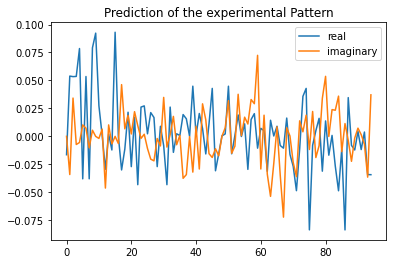

Applied shift of unit cell origin (fractional coordinates): 1.4786102802996807e-05 0.021503836010760582 0.09028926662074768
Ug[ 0 ]: 0.01641 3.14159  =>  0.01641 3.14159
Ug[ 1 ]: 0.06361 -0.5673  =>  0.06361 0.0
Ug[ 2 ]: 0.06361 0.5673  =>  0.06361 -0.0
Ug[ 3 ]: 0.05404 -0.13511  =>  0.05404 0.0
Ug[ 4 ]: 0.07904 -0.06954  =>  0.07904 0.63288
Ug[ 5 ]: 0.03932 2.87785  =>  0.03932 2.44566
Ug[ 6 ]: 0.05404 0.13511  =>  0.05404 -0.0
Ug[ 7 ]: 0.03932 -2.87785  =>  0.03932 -2.44566
Ug[ 8 ]: 0.07904 0.06954  =>  0.07904 -0.63288
Ug[ 9 ]: 0.09268 -9e-05  =>  0.09268 0.0
Ug[ 10 ]: 0.02734 -0.06821  =>  0.02734 0.49919
Ug[ 11 ]: 0.00645 1.48383  =>  0.00645 0.91662
Ug[ 12 ]: 0.05497 -2.14229  =>  0.05497 -2.27731
Ug[ 13 ]: 0.01076 1.36839  =>  0.01076 1.80068
Ug[ 14 ]: 0.01351 -2.61974  =>  0.01351 2.96112
Ug[ 15 ]: 0.09268 9e-05  =>  0.09268 0.0
Ug[ 16 ]: 0.00645 -1.48383  =>  0.00645 -0.91662
Ug[ 17 ]: 0.05497 2.14229  =>  0.05497 2.27731
Ug[ 18 ]: 0.01351 2.61974  =>  0.01351 -2.96112
Ug[ 19 

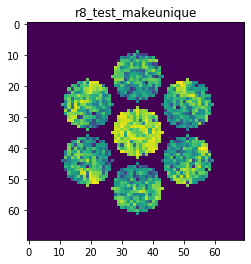

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8531985262154999
>>>replaced the 97. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 800ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 750ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


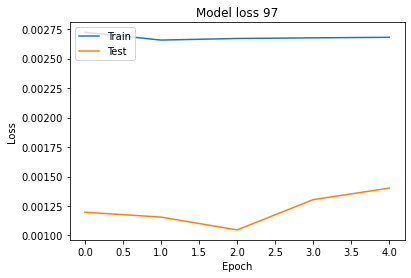

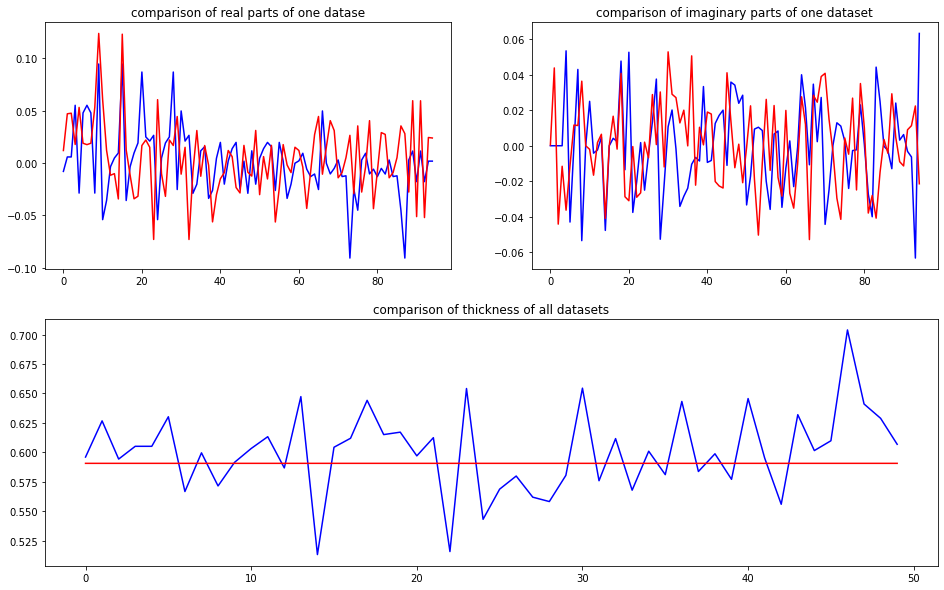

predicted thickness: 0.590688


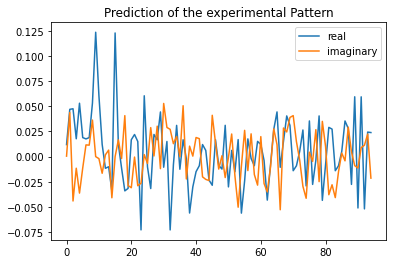

Applied shift of unit cell origin (fractional coordinates): 8.486762204697073e-06 0.09243996634997051 -0.11920977946655885
Ug[ 0 ]: 0.01197 0.0  =>  0.01197 0.0
Ug[ 1 ]: 0.06464 0.74902  =>  0.06464 0.0
Ug[ 2 ]: 0.06464 -0.74902  =>  0.06464 -0.0
Ug[ 3 ]: 0.02115 -0.58082  =>  0.02115 0.0
Ug[ 4 ]: 0.06442 -0.59942  =>  0.06442 -0.76762
Ug[ 5 ]: 0.02207 -0.53998  =>  0.02207 0.78985
Ug[ 6 ]: 0.02115 0.58082  =>  0.02115 -0.0
Ug[ 7 ]: 0.02207 0.53998  =>  0.02207 -0.78985
Ug[ 8 ]: 0.06442 0.59942  =>  0.06442 0.76762
Ug[ 9 ]: 0.12343 -5e-05  =>  0.12343 0.0
Ug[ 10 ]: 0.0606 -0.03324  =>  0.0606 -0.7822
Ug[ 11 ]: 0.02071 -0.93136  =>  0.02071 -0.18229
Ug[ 12 ]: 0.01171 2.98353  =>  0.01171 2.40277
Ug[ 13 ]: 0.01215 2.56297  =>  0.01215 1.23319
Ug[ 14 ]: 0.05328 -2.26733  =>  0.05328 -2.09907
Ug[ 15 ]: 0.12343 5e-05  =>  0.12343 0.0
Ug[ 16 ]: 0.02071 0.93136  =>  0.02071 0.18229
Ug[ 17 ]: 0.01171 -2.98353  =>  0.01171 -2.40277
Ug[ 18 ]: 0.05328 2.26733  =>  0.05328 2.09907
Ug[ 19 ]: 0.0428

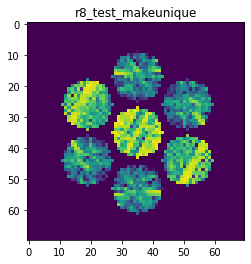

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9583678681597967
>>>replaced the 98. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 719ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000


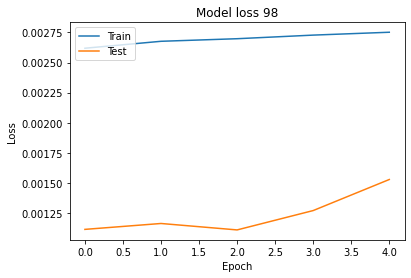

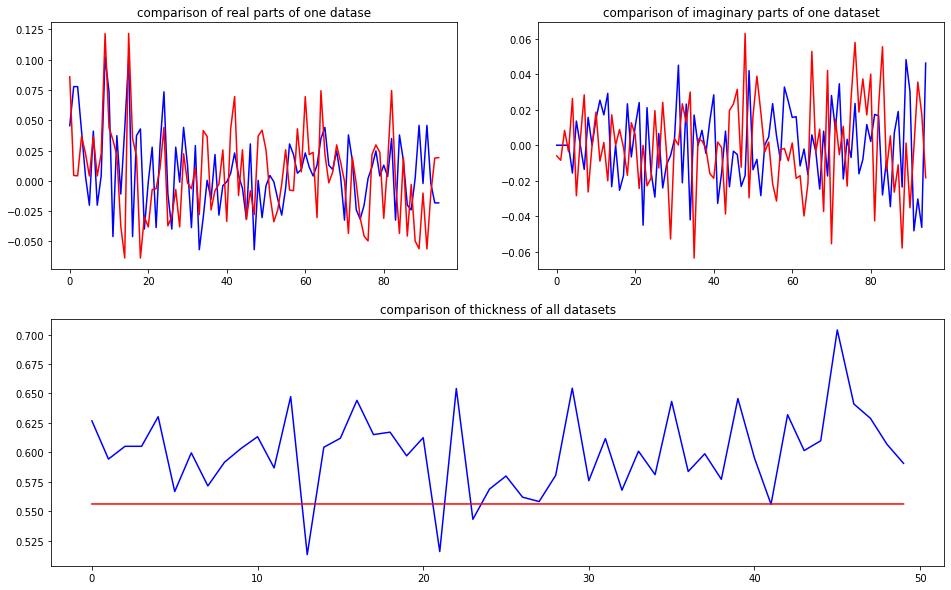

predicted thickness: 0.55622286


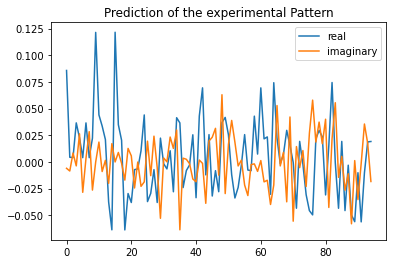

Applied shift of unit cell origin (fractional coordinates): 1.836557788216408e-05 0.015189369581181817 0.17543166108548952
Ug[ 0 ]: 0.08579 0.0  =>  0.08579 0.0
Ug[ 1 ]: 0.00944 -1.10227  =>  0.00944 0.0
Ug[ 2 ]: 0.00944 1.10227  =>  0.00944 -0.0
Ug[ 3 ]: 0.03679 -0.09544  =>  0.03679 0.0
Ug[ 4 ]: 0.03466 0.86441  =>  0.03466 2.06212
Ug[ 5 ]: 0.02872 -1.43058  =>  0.02872 -2.43742
Ug[ 6 ]: 0.03679 0.09544  =>  0.03679 0.0
Ug[ 7 ]: 0.02872 1.43058  =>  0.02872 2.43742
Ug[ 8 ]: 0.03466 -0.86441  =>  0.03466 -2.06212
Ug[ 9 ]: 0.12155 -0.00012  =>  0.12155 0.0
Ug[ 10 ]: 0.04789 0.40045  =>  0.04789 1.50284
Ug[ 11 ]: 0.03546 -0.25472  =>  0.03546 -1.35688
Ug[ 12 ]: 0.02071 0.06638  =>  0.02071 -0.02894
Ug[ 13 ]: 0.04225 -2.65433  =>  0.04225 -1.64738
Ug[ 14 ]: 0.06594 2.87947  =>  0.06594 1.68188
Ug[ 15 ]: 0.12155 0.00012  =>  0.12155 -0.0
Ug[ 16 ]: 0.03546 0.25472  =>  0.03546 1.35688
Ug[ 17 ]: 0.02071 -0.06638  =>  0.02071 0.02894
Ug[ 18 ]: 0.06594 -2.87947  =>  0.06594 -1.68188
Ug[ 19 ]:

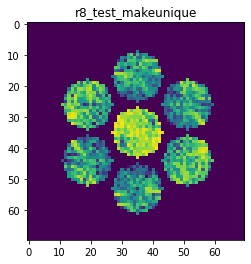

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9440242022803869
>>>replaced the 99. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0028 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 722ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


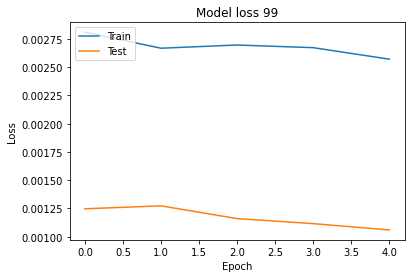

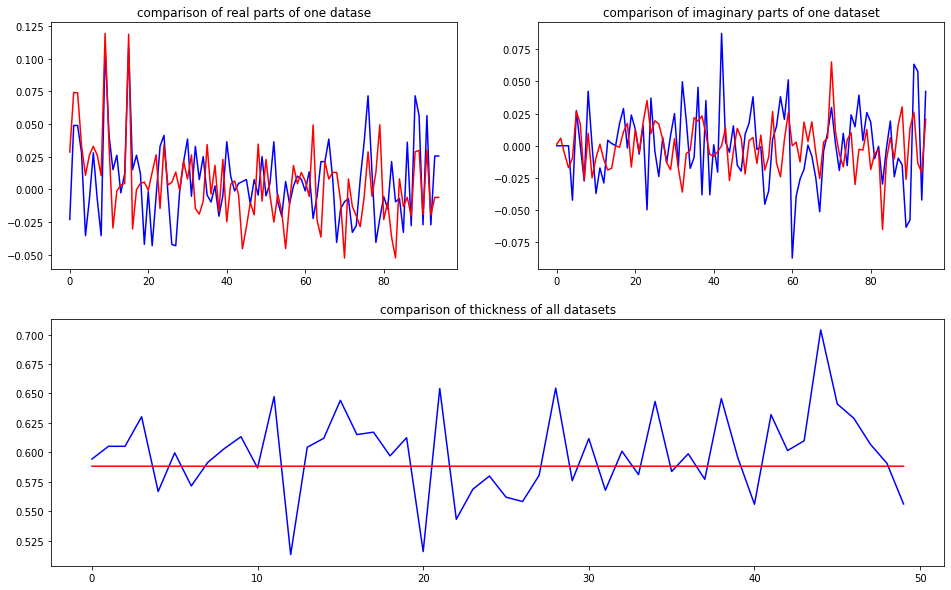

predicted thickness: 0.58826435


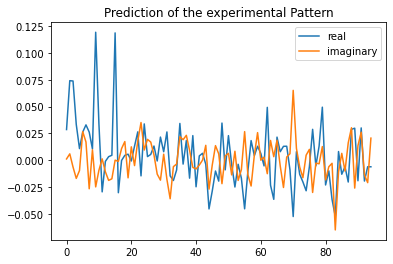

Applied shift of unit cell origin (fractional coordinates): 0.01661035843324865 0.07538640241222812 -0.013153662891111657
Ug[ 0 ]: 0.02854 0.0  =>  0.02854 0.0
Ug[ 1 ]: 0.07423 0.08265  =>  0.07423 0.0
Ug[ 2 ]: 0.07423 -0.08265  =>  0.07423 0.0
Ug[ 3 ]: 0.0372 -0.47367  =>  0.0372 0.0
Ug[ 4 ]: 0.01436 -0.73994  =>  0.01436 -0.34892
Ug[ 5 ]: 0.03735 0.79364  =>  0.03735 1.34995
Ug[ 6 ]: 0.0372 0.47367  =>  0.0372 -0.0
Ug[ 7 ]: 0.03735 -0.79364  =>  0.03735 -1.34995
Ug[ 8 ]: 0.01436 0.73994  =>  0.01436 0.34892
Ug[ 9 ]: 0.11965 -0.10437  =>  0.11965 0.0
Ug[ 10 ]: 0.03509 -0.27122  =>  0.03509 -0.2495
Ug[ 11 ]: 0.03001 3.10231  =>  0.03001 -2.99386
Ug[ 12 ]: 0.01089 -1.63433  =>  0.01089 -2.00363
Ug[ 13 ]: 0.01942 -1.40156  =>  0.01942 -1.85351
Ug[ 14 ]: 0.01794 -1.3165  =>  0.01794 -1.60315
Ug[ 15 ]: 0.11965 0.10437  =>  0.11965 0.0
Ug[ 16 ]: 0.03001 -3.10231  =>  0.03001 2.99386
Ug[ 17 ]: 0.01089 1.63433  =>  0.01089 2.00363
Ug[ 18 ]: 0.01794 1.3165  =>  0.01794 1.60315
Ug[ 19 ]: 0.0175

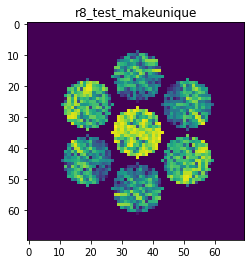

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9767496222096408
>>>replaced the 100. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 762ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0027 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


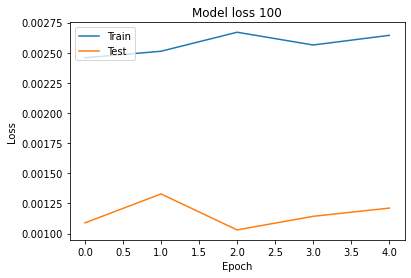

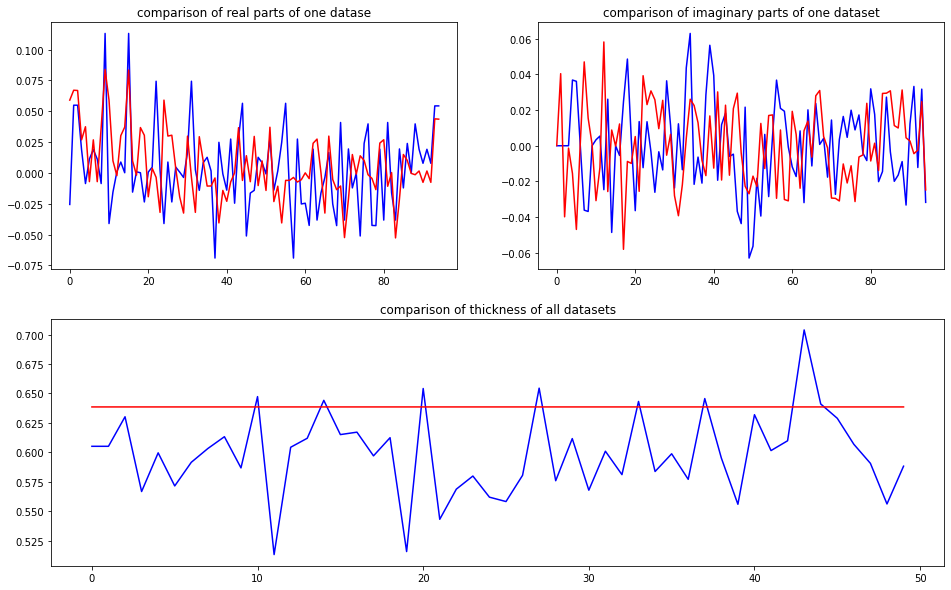

predicted thickness: 0.63855433


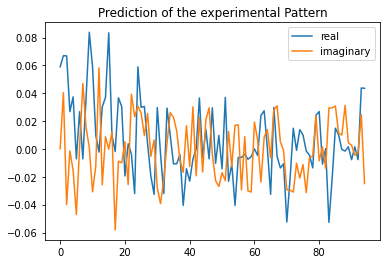

Applied shift of unit cell origin (fractional coordinates): -0.0010253786476767089 0.008198493533190613 -0.08608004760515989
Ug[ 0 ]: 0.05898 0.0  =>  0.05898 0.0
Ug[ 1 ]: 0.07804 0.54086  =>  0.07804 0.0
Ug[ 2 ]: 0.07804 -0.54086  =>  0.07804 0.0
Ug[ 3 ]: 0.02681 -0.05151  =>  0.02681 0.0
Ug[ 4 ]: 0.04021 -0.39604  =>  0.04021 -0.88538
Ug[ 5 ]: 0.04756 -1.72104  =>  0.04756 -1.12867
Ug[ 6 ]: 0.02681 0.05151  =>  0.02681 -0.0
Ug[ 7 ]: 0.04756 1.72104  =>  0.04756 1.12867
Ug[ 8 ]: 0.04021 0.39604  =>  0.04021 0.88538
Ug[ 9 ]: 0.0836 0.00644  =>  0.0836 -0.0
Ug[ 10 ]: 0.06654 -0.48141  =>  0.06654 -1.02871
Ug[ 11 ]: 0.01564 -0.89829  =>  0.01564 -0.36387
Ug[ 12 ]: 0.05824 1.60604  =>  0.05824 1.54808
Ug[ 13 ]: 0.03957 -0.70923  =>  0.03957 -1.30804
Ug[ 14 ]: 0.03797 0.23428  =>  0.03797 0.71718
Ug[ 15 ]: 0.0836 -0.00644  =>  0.0836 0.0
Ug[ 16 ]: 0.01564 0.89829  =>  0.01564 0.36387
Ug[ 17 ]: 0.05824 -1.60604  =>  0.05824 -1.54808
Ug[ 18 ]: 0.03797 -0.23428  =>  0.03797 -0.71718
Ug[ 19 ]:

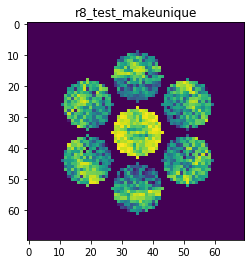

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8206203976723948
>>>replaced the 101. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 784ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 748ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


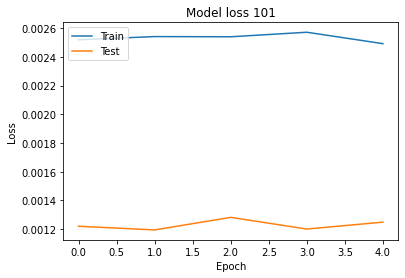

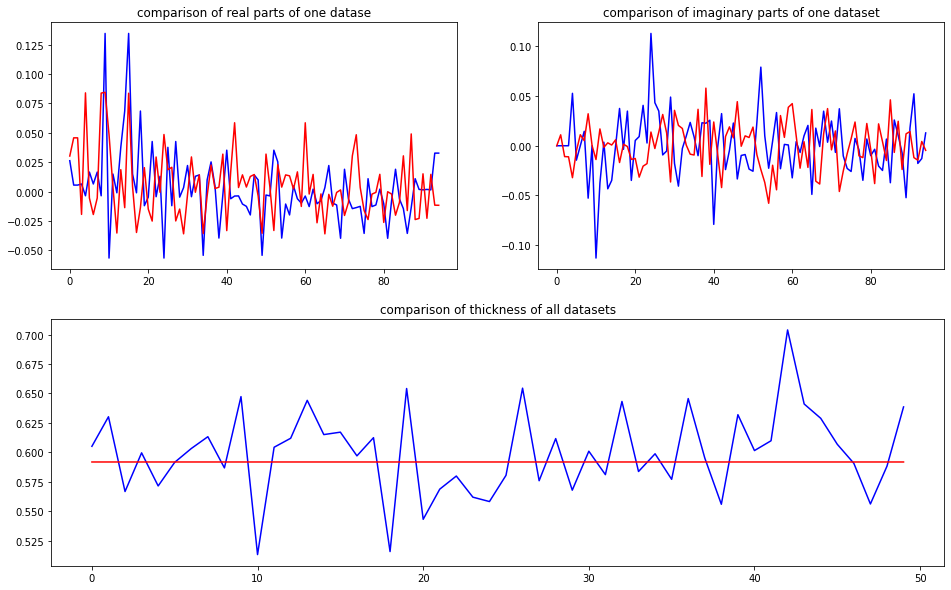

predicted thickness: 0.5918463


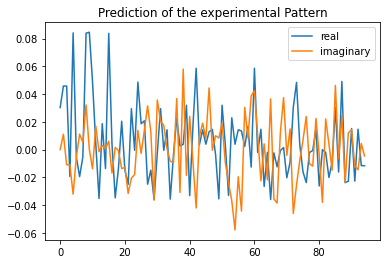

Applied shift of unit cell origin (fractional coordinates): 0.005496001384820506 0.4174765612922245 -0.03741584794528366
Ug[ 0 ]: 0.03026 0.0  =>  0.03026 0.0
Ug[ 1 ]: 0.04705 0.23509  =>  0.04705 0.0
Ug[ 2 ]: 0.04705 -0.23509  =>  0.04705 0.0
Ug[ 3 ]: 0.02241 -2.62308  =>  0.02241 -0.0
Ug[ 4 ]: 0.08989 -0.36587  =>  0.08989 2.02212
Ug[ 5 ]: 0.00751 -2.38151  =>  0.00751 0.47666
Ug[ 6 ]: 0.02241 2.62308  =>  0.02241 0.0
Ug[ 7 ]: 0.00751 2.38151  =>  0.00751 -0.47666
Ug[ 8 ]: 0.08989 0.36587  =>  0.08989 -2.02212
Ug[ 9 ]: 0.08417 -0.03453  =>  0.08417 0.0
Ug[ 10 ]: 0.05055 -0.27716  =>  0.05055 -0.47771
Ug[ 11 ]: 0.01738 1.33545  =>  0.01738 1.60507
Ug[ 12 ]: 0.03508 -3.09732  =>  0.03508 0.59732
Ug[ 13 ]: 0.01886 0.15214  =>  0.01886 -2.6715
Ug[ 14 ]: 0.01367 3.08689  =>  0.01367 0.73343
Ug[ 15 ]: 0.08417 0.03453  =>  0.08417 0.0
Ug[ 16 ]: 0.01738 -1.33545  =>  0.01738 -1.60507
Ug[ 17 ]: 0.03508 3.09732  =>  0.03508 -0.59732
Ug[ 18 ]: 0.01367 -3.08689  =>  0.01367 -0.73343
Ug[ 19 ]: 0.

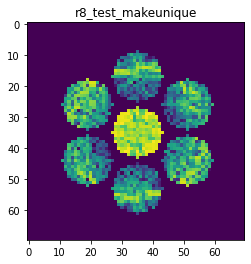

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9749945999499108
>>>replaced the 102. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 752ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0026 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


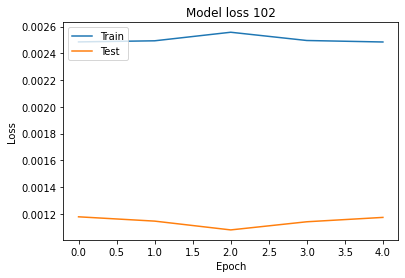

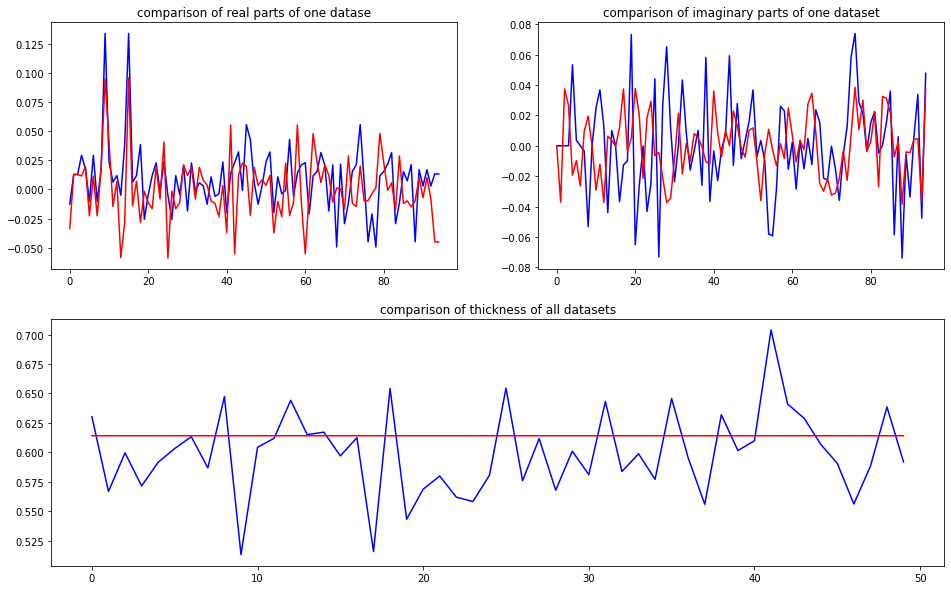

predicted thickness: 0.6141116


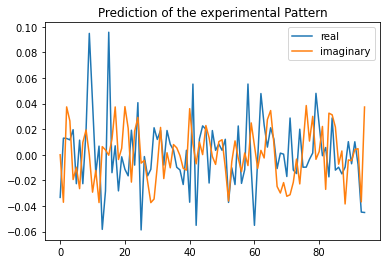

Applied shift of unit cell origin (fractional coordinates): -0.0003038286362064704 -0.1845798249328513 0.19714098493683632
Ug[ 0 ]: 0.03333 3.14159  =>  0.03333 3.14159
Ug[ 1 ]: 0.03943 -1.23867  =>  0.03943 -0.0
Ug[ 2 ]: 0.03943 1.23867  =>  0.03943 0.0
Ug[ 3 ]: 0.02885 1.15975  =>  0.02885 0.0
Ug[ 4 ]: 0.02748 -0.78296  =>  0.02748 -0.70404
Ug[ 5 ]: 0.02462 -2.7356  =>  0.02462 1.14916
Ug[ 6 ]: 0.02885 -1.15975  =>  0.02885 -0.0
Ug[ 7 ]: 0.02462 2.7356  =>  0.02462 -1.14916
Ug[ 8 ]: 0.02748 0.78296  =>  0.02748 0.70404
Ug[ 9 ]: 0.09532 0.00191  =>  0.09532 0.0
Ug[ 10 ]: 0.05014 -0.6228  =>  0.05014 0.61396
Ug[ 11 ]: 0.01879 -2.43297  =>  0.01879 2.60964
Ug[ 12 ]: 0.038 -1.38893  =>  0.038 -0.23109
Ug[ 13 ]: 0.05889 3.03176  =>  0.05889 -0.85492
Ug[ 14 ]: 0.02849 3.0098  =>  0.02849 2.92896
Ug[ 15 ]: 0.09532 -0.00191  =>  0.09532 0.0
Ug[ 16 ]: 0.01879 2.43297  =>  0.01879 -2.60964
Ug[ 17 ]: 0.038 1.38893  =>  0.038 0.23109
Ug[ 18 ]: 0.02849 -3.0098  =>  0.02849 -2.92896
Ug[ 19 ]: 0.00

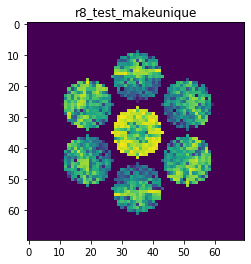

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9117575829317304
>>>replaced the 103. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 756ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


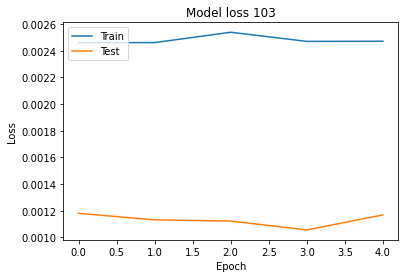

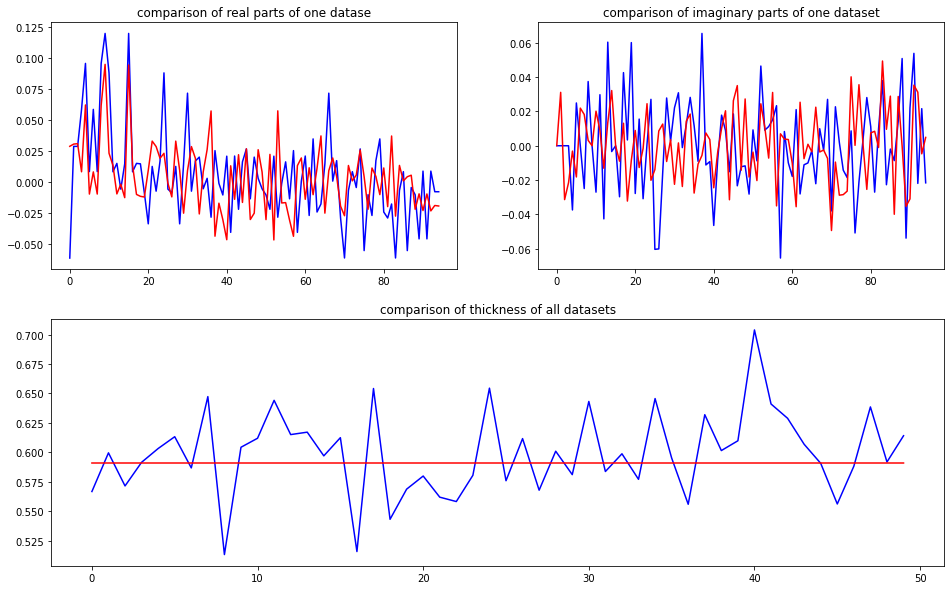

predicted thickness: 0.5909788


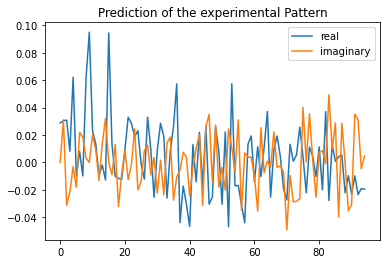

Applied shift of unit cell origin (fractional coordinates): -4.9543696699491206e-05 0.19335646209958546 -0.12633366563854811
Ug[ 0 ]: 0.02874 0.0  =>  0.02874 0.0
Ug[ 1 ]: 0.04378 0.79378  =>  0.04378 0.0
Ug[ 2 ]: 0.04378 -0.79378  =>  0.04378 -0.0
Ug[ 3 ]: 0.02318 -1.21489  =>  0.02318 0.0
Ug[ 4 ]: 0.0621 -0.05037  =>  0.0621 0.37075
Ug[ 5 ]: 0.02071 -2.06958  =>  0.02071 -0.0609
Ug[ 6 ]: 0.02318 1.21489  =>  0.02318 -0.0
Ug[ 7 ]: 0.02071 2.06958  =>  0.02071 0.0609
Ug[ 8 ]: 0.0621 0.05037  =>  0.0621 -0.37075
Ug[ 9 ]: 0.09482 0.00031  =>  0.09482 0.0
Ug[ 10 ]: 0.03063 0.71638  =>  0.03063 -0.0777
Ug[ 11 ]: 0.01609 0.59188  =>  0.01609 1.38535
Ug[ 12 ]: 0.01648 -2.2228  =>  0.01648 2.84518
Ug[ 13 ]: 0.01376 1.68045  =>  0.01376 -0.32853
Ug[ 14 ]: 0.03443 1.93555  =>  0.03443 1.51412
Ug[ 15 ]: 0.09482 -0.00031  =>  0.09482 0.0
Ug[ 16 ]: 0.01609 -0.59188  =>  0.01609 -1.38535
Ug[ 17 ]: 0.01648 2.2228  =>  0.01648 -2.84518
Ug[ 18 ]: 0.03443 -1.93555  =>  0.03443 -1.51412
Ug[ 19 ]: 0.0149

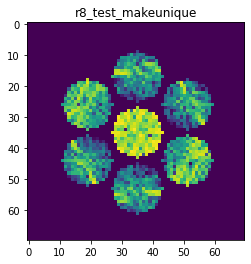

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8978201340830813
>>>replaced the 104. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 755ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


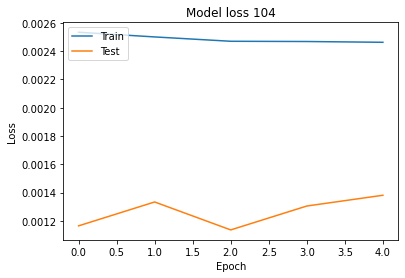

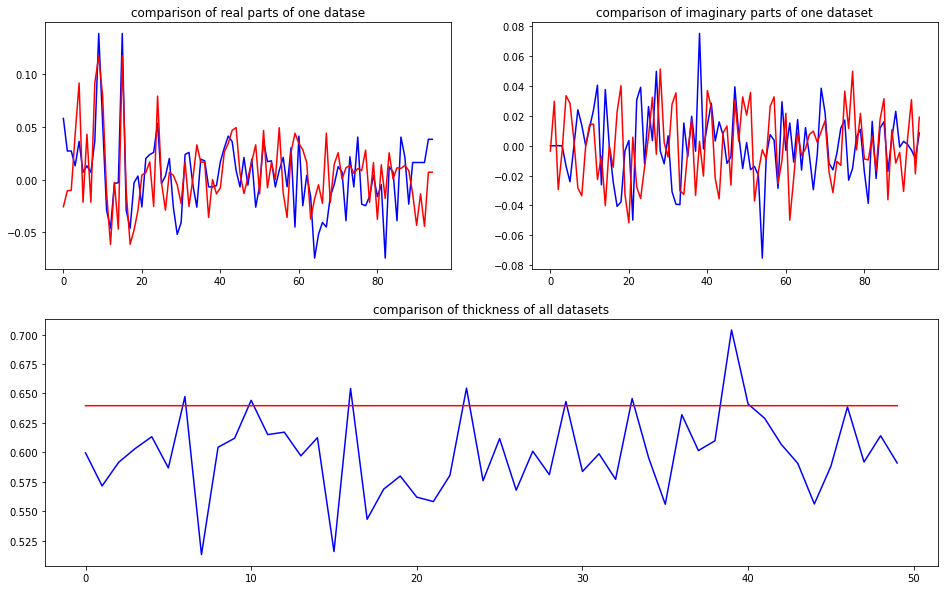

predicted thickness: 0.63961226


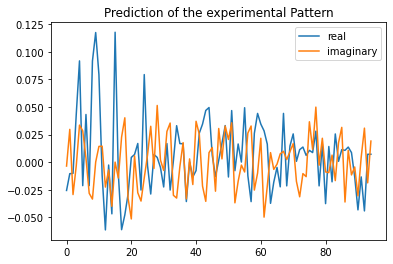

Applied shift of unit cell origin (fractional coordinates): -4.558667165065421e-05 0.012628590754917549 -0.30348783159797665
Ug[ 0 ]: 0.02571 3.14159  =>  0.02571 3.14159
Ug[ 1 ]: 0.03132 1.90687  =>  0.03132 0.0
Ug[ 2 ]: 0.03132 -1.90687  =>  0.03132 -0.0
Ug[ 3 ]: 0.04343 -0.07935  =>  0.04343 0.0
Ug[ 4 ]: 0.0977 0.35042  =>  0.0977 -1.4771
Ug[ 5 ]: 0.03551 2.21582  =>  0.03551 -2.08115
Ug[ 6 ]: 0.04343 0.07935  =>  0.04343 -0.0
Ug[ 7 ]: 0.03551 -2.21582  =>  0.03551 2.08115
Ug[ 8 ]: 0.0977 -0.35042  =>  0.0977 1.4771
Ug[ 9 ]: 0.11768 0.00029  =>  0.11768 0.0
Ug[ 10 ]: 0.08069 0.17761  =>  0.08069 -1.72954
Ug[ 11 ]: 0.01846 2.24341  =>  0.01846 -2.13319
Ug[ 12 ]: 0.06545 -2.78775  =>  0.06545 -2.86738
Ug[ 13 ]: 0.00714 -1.96409  =>  0.00714 2.33259
Ug[ 14 ]: 0.06213 -2.43873  =>  0.06213 -0.6115
Ug[ 15 ]: 0.11768 -0.00029  =>  0.11768 0.0
Ug[ 16 ]: 0.01846 -2.24341  =>  0.01846 2.13319
Ug[ 17 ]: 0.06545 2.78775  =>  0.06545 2.86738
Ug[ 18 ]: 0.06213 2.43873  =>  0.06213 0.6115
Ug[ 19 

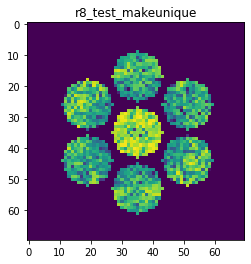

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8476717332758408
>>>replaced the 105. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 766ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


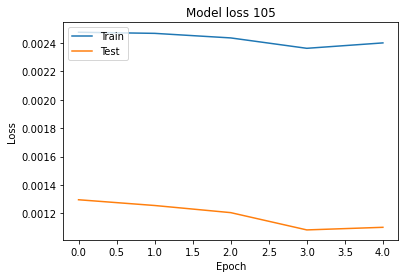

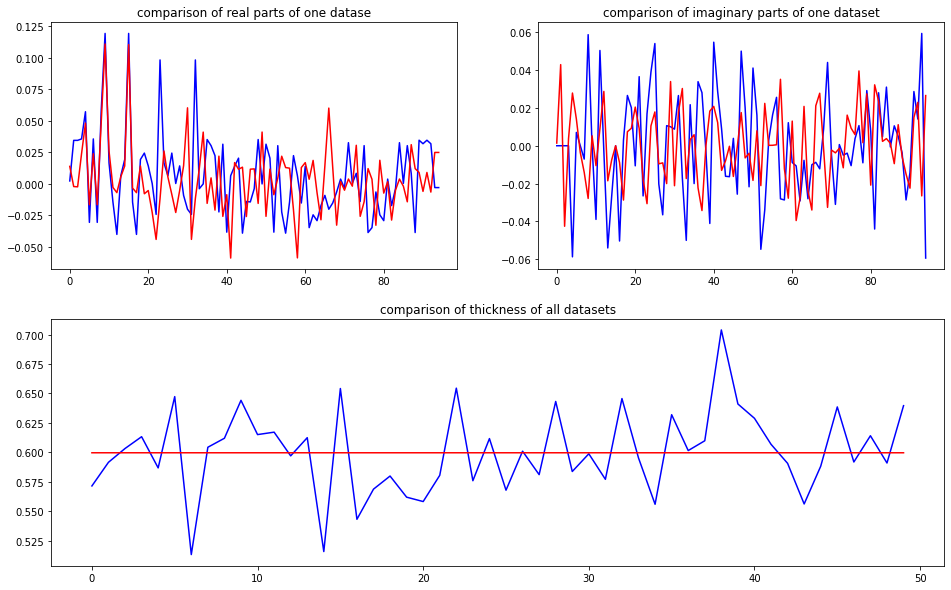

predicted thickness: 0.59965765


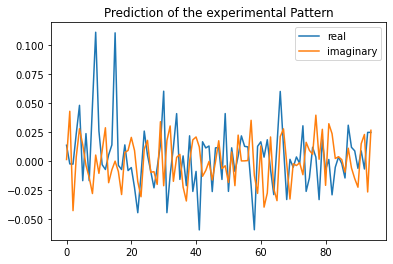

Applied shift of unit cell origin (fractional coordinates): -0.003768315855221636 -0.024384001378513542 -0.25917655067096373
Ug[ 0 ]: 0.01367 0.0  =>  0.01367 0.0
Ug[ 1 ]: 0.0428 1.62845  =>  0.0428 0.0
Ug[ 2 ]: 0.0428 -1.62845  =>  0.0428 -0.0
Ug[ 3 ]: 0.02398 0.15321  =>  0.02398 -0.0
Ug[ 4 ]: 0.05544 0.52664  =>  0.05544 -1.25503
Ug[ 5 ]: 0.02194 2.44349  =>  0.02194 -2.36445
Ug[ 6 ]: 0.02398 -0.15321  =>  0.02398 0.0
Ug[ 7 ]: 0.02194 -2.44349  =>  0.02194 2.36445
Ug[ 8 ]: 0.05544 -0.52664  =>  0.05544 1.25503
Ug[ 9 ]: 0.11066 0.02368  =>  0.11066 0.0
Ug[ 10 ]: 0.02794 -0.38592  =>  0.02794 -2.03805
Ug[ 11 ]: 0.00953 1.92537  =>  0.00953 -2.75303
Ug[ 12 ]: 0.02961 1.81634  =>  0.02961 1.94587
Ug[ 13 ]: 0.01895 -1.28783  =>  0.01895 -2.78675
Ug[ 14 ]: 0.01584 -0.48853  =>  0.01584 1.26945
Ug[ 15 ]: 0.11066 -0.02368  =>  0.11066 0.0
Ug[ 16 ]: 0.00953 -1.92537  =>  0.00953 2.75303
Ug[ 17 ]: 0.02961 -1.81634  =>  0.02961 -1.94587
Ug[ 18 ]: 0.01584 0.48853  =>  0.01584 -1.26945
Ug[ 19 ]:

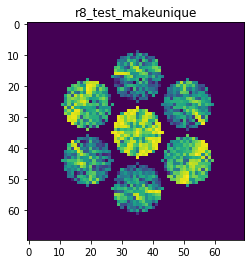

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8740949688160394
>>>replaced the 106. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 759ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 724ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 722ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


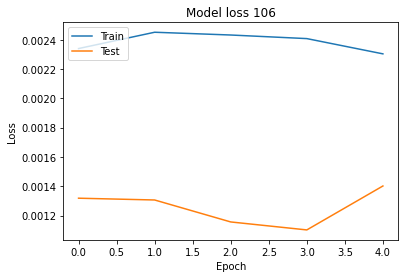

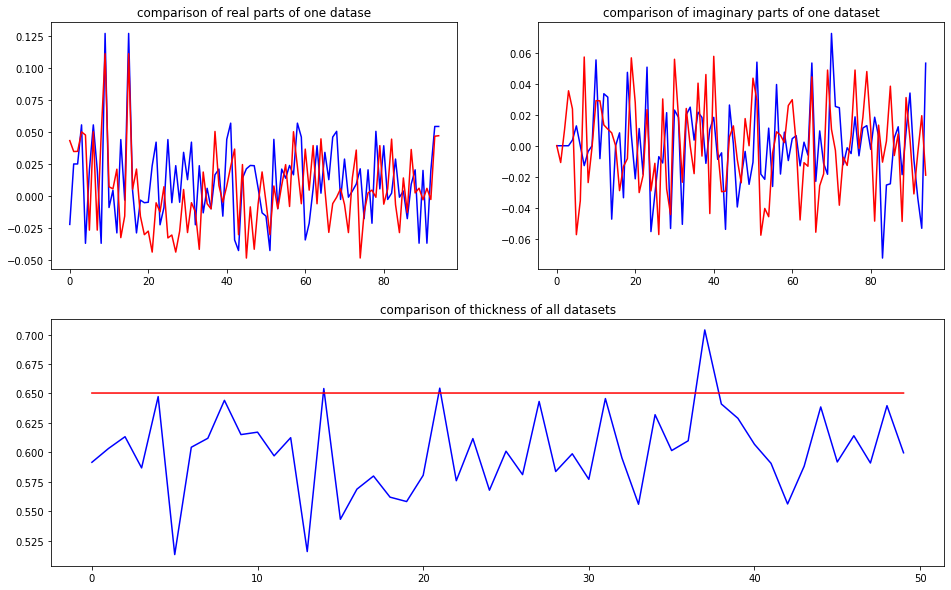

predicted thickness: 0.6503472


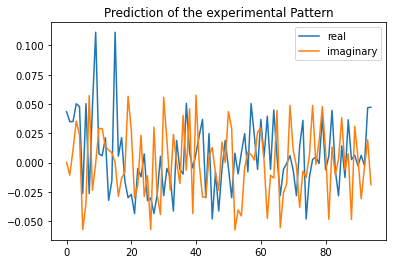

Applied shift of unit cell origin (fractional coordinates): 0.00045082016327003583 -0.09758850043404056 0.04741214803895496
Ug[ 0 ]: 0.04342 0.0  =>  0.04342 0.0
Ug[ 1 ]: 0.03656 -0.2979  =>  0.03656 0.0
Ug[ 2 ]: 0.03656 0.2979  =>  0.03656 0.0
Ug[ 3 ]: 0.06148 0.61317  =>  0.06148 0.0
Ug[ 4 ]: 0.05336 0.4603  =>  0.05336 0.14503
Ug[ 5 ]: 0.06301 -2.0046  =>  0.06301 -2.91566
Ug[ 6 ]: 0.06148 -0.61317  =>  0.06148 -0.0
Ug[ 7 ]: 0.06301 2.0046  =>  0.06301 2.91566
Ug[ 8 ]: 0.05336 -0.4603  =>  0.05336 -0.14503
Ug[ 9 ]: 0.11127 -0.00283  =>  0.11127 0.0
Ug[ 10 ]: 0.02998 1.32197  =>  0.02998 1.6227
Ug[ 11 ]: 0.02944 1.38018  =>  0.02944 1.08511
Ug[ 12 ]: 0.02501 0.5635  =>  0.02501 1.1795
Ug[ 13 ]: 0.03429 2.8145  =>  0.03429 -2.55479
Ug[ 14 ]: 0.01766 2.65204  =>  0.01766 2.97014
Ug[ 15 ]: 0.11127 0.00283  =>  0.11127 0.0
Ug[ 16 ]: 0.02944 -1.38018  =>  0.02944 -1.08511
Ug[ 17 ]: 0.02501 -0.5635  =>  0.02501 -1.1795
Ug[ 18 ]: 0.01766 -2.65204  =>  0.01766 -2.97014
Ug[ 19 ]: 0.06439 2.05

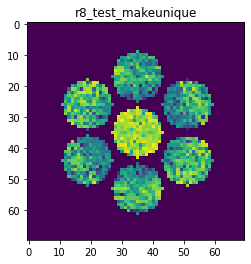

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9387117172071728
>>>replaced the 107. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 768ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 721ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000


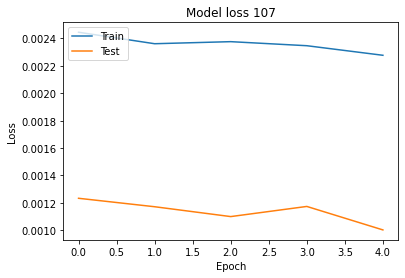

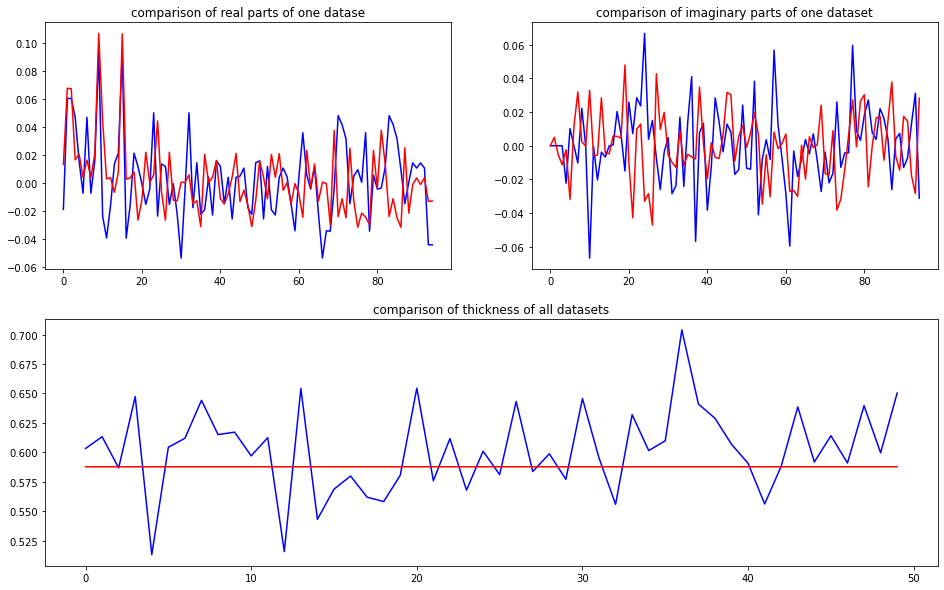

predicted thickness: 0.58776456


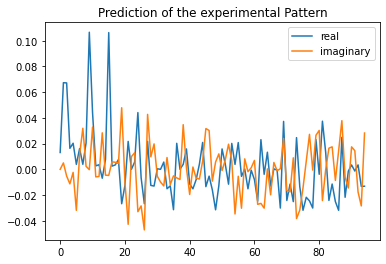

Applied shift of unit cell origin (fractional coordinates): -0.0033576408573378746 0.09689918650864499 -0.012080180398491194
Ug[ 0 ]: 0.0131 0.0  =>  0.0131 0.0
Ug[ 1 ]: 0.06748 0.0759  =>  0.06748 0.0
Ug[ 2 ]: 0.06748 -0.0759  =>  0.06748 0.0
Ug[ 3 ]: 0.0198 -0.60884  =>  0.0198 0.0
Ug[ 4 ]: 0.02054 -0.11515  =>  0.02054 0.41778
Ug[ 5 ]: 0.03215 -1.44911  =>  0.03215 -0.76437
Ug[ 6 ]: 0.0198 0.60884  =>  0.0198 0.0
Ug[ 7 ]: 0.03215 1.44911  =>  0.03215 0.76437
Ug[ 8 ]: 0.02054 0.11515  =>  0.02054 -0.41778
Ug[ 9 ]: 0.10649 0.0211  =>  0.10649 -0.0
Ug[ 10 ]: 0.05505 0.64028  =>  0.05505 0.54328
Ug[ 11 ]: 0.00641 -1.15236  =>  0.00641 -1.09756
Ug[ 12 ]: 0.00655 -1.00658  =>  0.00655 -1.63651
Ug[ 13 ]: 0.02918 1.80175  =>  0.02918 1.09591
Ug[ 14 ]: 0.00888 -0.53439  =>  0.00888 -1.08842
Ug[ 15 ]: 0.10649 -0.0211  =>  0.10649 0.0
Ug[ 16 ]: 0.00641 1.15236  =>  0.00641 1.09756
Ug[ 17 ]: 0.00655 1.00658  =>  0.00655 1.63651
Ug[ 18 ]: 0.00888 0.53439  =>  0.00888 1.08842
Ug[ 19 ]: 0.05451 2.

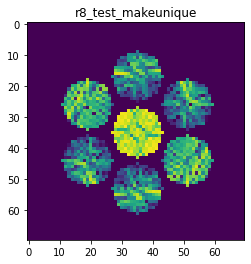

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9681754705442567
>>>replaced the 108. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 801ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 745ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 740ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000


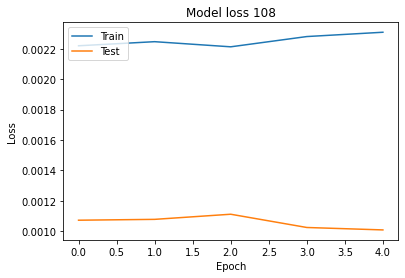

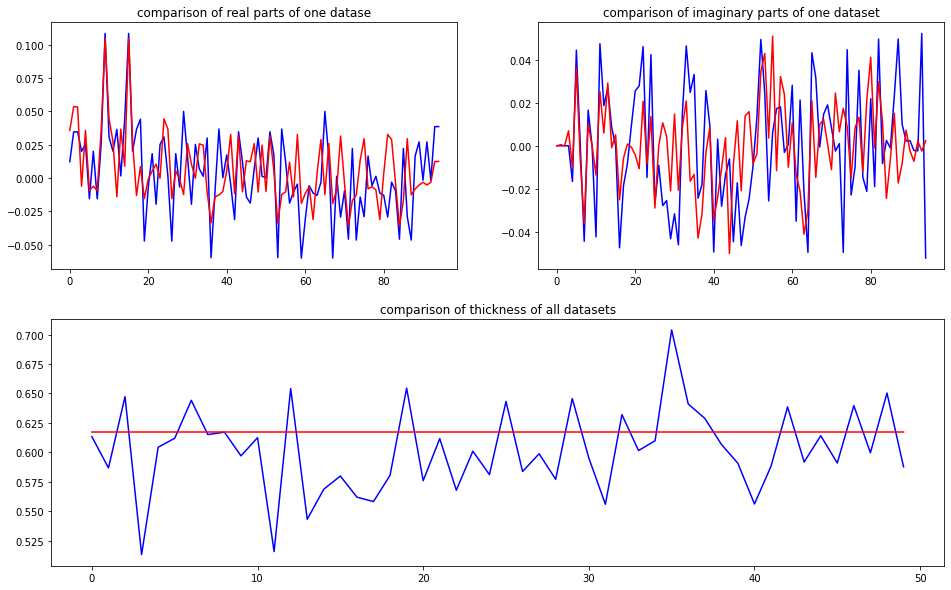

predicted thickness: 0.61727107


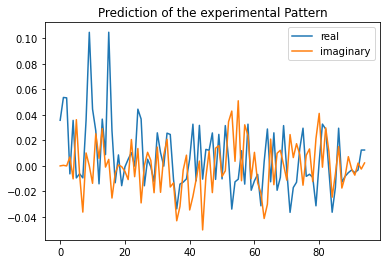

Applied shift of unit cell origin (fractional coordinates): 0.0038636892684442963 -0.3672072871264235 -0.0007223578566268723
Ug[ 0 ]: 0.03571 0.0  =>  0.03571 0.0
Ug[ 1 ]: 0.05341 0.00454  =>  0.05341 -0.0
Ug[ 2 ]: 0.05341 -0.00454  =>  0.05341 0.0
Ug[ 3 ]: 0.00926 2.30723  =>  0.00926 0.0
Ug[ 4 ]: 0.0371 -0.27677  =>  0.0371 -2.58854
Ug[ 5 ]: 0.03736 1.82461  =>  0.03736 -0.47808
Ug[ 6 ]: 0.00926 -2.30723  =>  0.00926 -0.0
Ug[ 7 ]: 0.03736 -1.82461  =>  0.03736 0.47808
Ug[ 8 ]: 0.0371 0.27677  =>  0.0371 2.58854
Ug[ 9 ]: 0.1046 -0.02428  =>  0.1046 -0.0
Ug[ 10 ]: 0.04645 -0.2976  =>  0.04645 -0.27787
Ug[ 11 ]: 0.03729 0.7401  =>  0.03729 0.76892
Ug[ 12 ]: 0.01483 2.73344  =>  0.01483 -1.21824
Ug[ 13 ]: 0.04679 0.6708  =>  0.04679 2.99777
Ug[ 14 ]: 0.00875 -0.098  =>  0.00875 2.23805
Ug[ 15 ]: 0.1046 0.02428  =>  0.1046 0.0
Ug[ 16 ]: 0.03729 -0.7401  =>  0.03729 -0.76892
Ug[ 17 ]: 0.01483 -2.73344  =>  0.01483 1.21824
Ug[ 18 ]: 0.00875 0.098  =>  0.00875 -2.23805
Ug[ 19 ]: 0.01553 -3.1

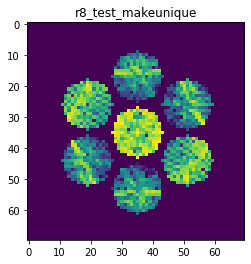

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8905178492460484
>>>replaced the 109. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 757ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 724ms/step - loss: 0.0025 - acc: 1.0000 - val_loss: 0.0014 - val_acc: 1.0000


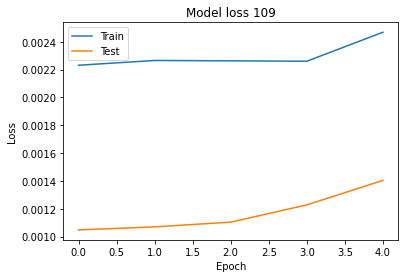

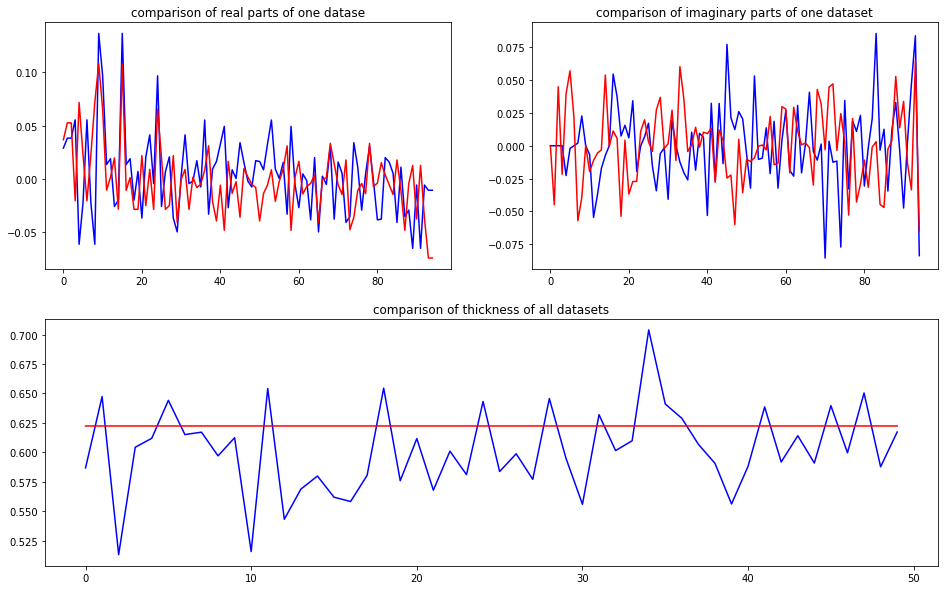

predicted thickness: 0.622391


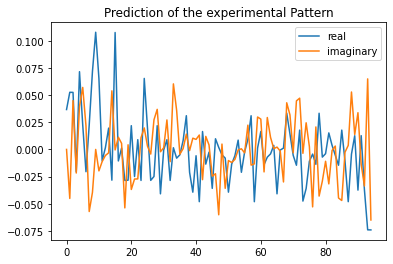

Applied shift of unit cell origin (fractional coordinates): -0.000334609780608364 0.37023315988893196 0.11273196517900681
Ug[ 0 ]: 0.03671 0.0  =>  0.03671 0.0
Ug[ 1 ]: 0.06918 -0.70832  =>  0.06918 0.0
Ug[ 2 ]: 0.06918 0.70832  =>  0.06918 0.0
Ug[ 3 ]: 0.02983 -2.32624  =>  0.02983 -0.0
Ug[ 4 ]: 0.0818 0.50468  =>  0.0818 -2.74394
Ug[ 5 ]: 0.06134 1.19668  =>  0.06134 2.81461
Ug[ 6 ]: 0.02983 2.32624  =>  0.02983 0.0
Ug[ 7 ]: 0.06134 -1.19668  =>  0.06134 -2.81461
Ug[ 8 ]: 0.0818 -0.50468  =>  0.0818 2.74394
Ug[ 9 ]: 0.1077 0.0021  =>  0.1077 0.0
Ug[ 10 ]: 0.06825 -0.29354  =>  0.06825 0.41268
Ug[ 11 ]: 0.01538 -2.325  =>  0.01538 -3.03542
Ug[ 12 ]: 0.00577 -1.31539  =>  0.00577 2.63945
Ug[ 13 ]: 0.0198 -0.15572  =>  0.0198 -1.77575
Ug[ 14 ]: 0.06089 2.05632  =>  0.06089 -0.98034
Ug[ 15 ]: 0.1077 -0.0021  =>  0.1077 0.0
Ug[ 16 ]: 0.01538 2.325  =>  0.01538 3.03542
Ug[ 17 ]: 0.00577 1.31539  =>  0.00577 -2.63945
Ug[ 18 ]: 0.06089 -2.05632  =>  0.06089 0.98034
Ug[ 19 ]: 0.02871 2.99249 

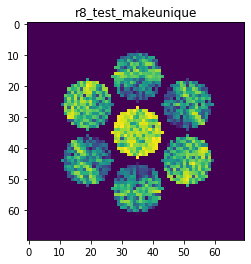

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.875720968989727
>>>replaced the 110. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 752ms/step - loss: 0.0024 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0023 - acc: 1.0000 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 9.4113e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 724ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


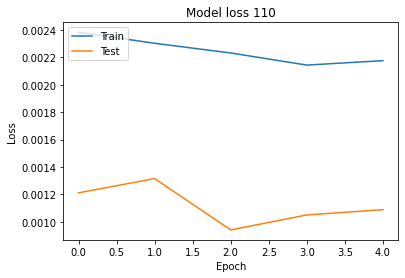

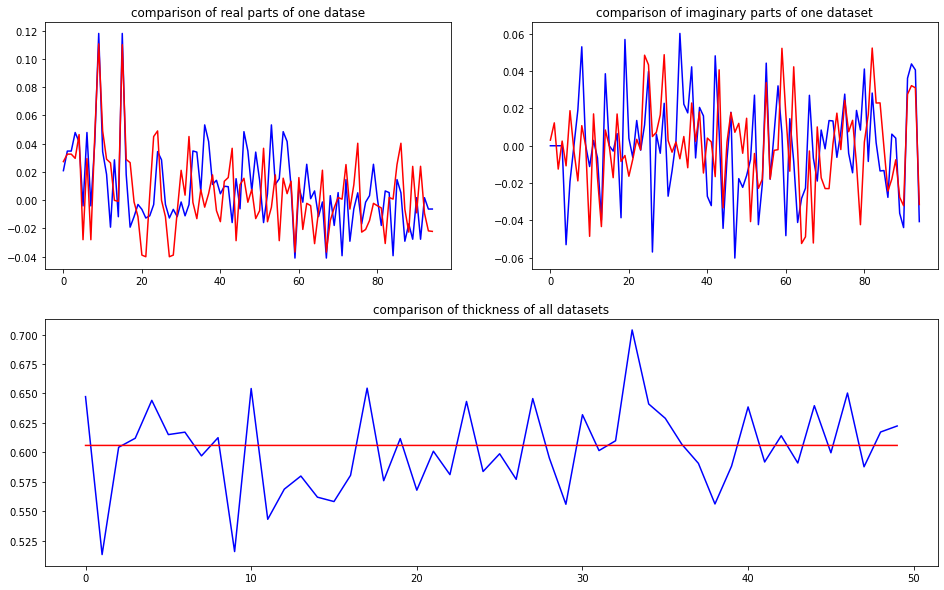

predicted thickness: 0.60588765


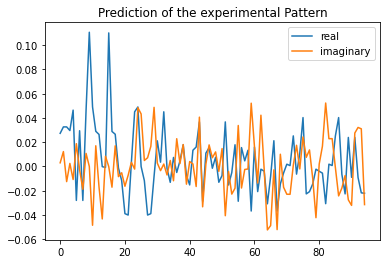

Applied shift of unit cell origin (fractional coordinates): -7.197897556046224e-05 -0.013855057510794687 -0.05771243434795122
Ug[ 0 ]: 0.02732 0.0  =>  0.02732 0.0
Ug[ 1 ]: 0.03489 0.36262  =>  0.03489 0.0
Ug[ 2 ]: 0.03489 -0.36262  =>  0.03489 -0.0
Ug[ 3 ]: 0.02965 0.08705  =>  0.02965 0.0
Ug[ 4 ]: 0.04767 -0.22761  =>  0.04767 -0.67729
Ug[ 5 ]: 0.03374 2.55056  =>  0.03374 2.82613
Ug[ 6 ]: 0.02965 -0.08705  =>  0.02965 -0.0
Ug[ 7 ]: 0.03374 -2.55056  =>  0.03374 -2.82613
Ug[ 8 ]: 0.04767 0.22761  =>  0.04767 0.67729
Ug[ 9 ]: 0.11042 0.00045  =>  0.11042 0.0
Ug[ 10 ]: 0.06899 -0.7796  =>  0.06899 -1.14267
Ug[ 11 ]: 0.0336 0.53321  =>  0.0336 0.89538
Ug[ 12 ]: 0.03148 -0.57086  =>  0.03148 -0.48426
Ug[ 13 ]: 0.04331 -1.57307  =>  0.04331 -1.84909
Ug[ 14 ]: 0.00847 1.69248  =>  0.00847 2.1417
Ug[ 15 ]: 0.11042 -0.00045  =>  0.11042 0.0
Ug[ 16 ]: 0.0336 -0.53321  =>  0.0336 -0.89538
Ug[ 17 ]: 0.03148 0.57086  =>  0.03148 0.48426
Ug[ 18 ]: 0.00847 -1.69248  =>  0.00847 -2.1417
Ug[ 19 ]: 0

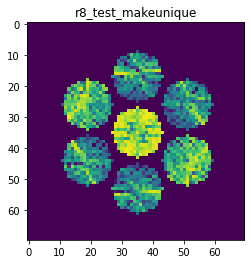

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.901866393872188
>>>replaced the 111. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 755ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000


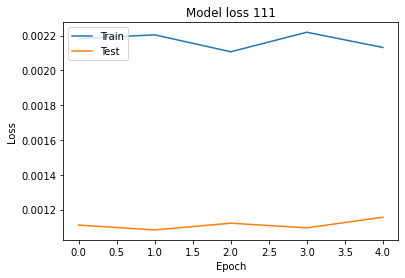

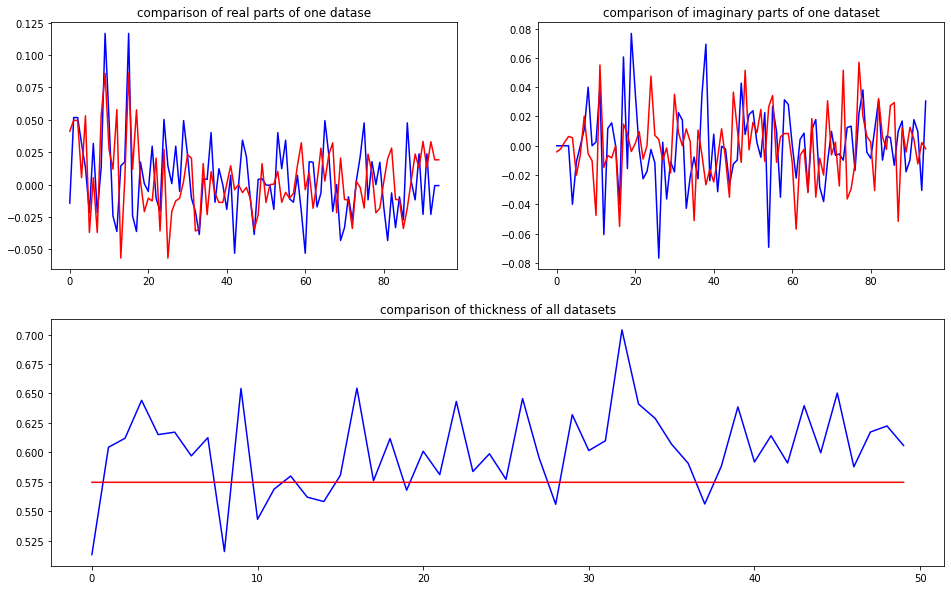

predicted thickness: 0.57460415


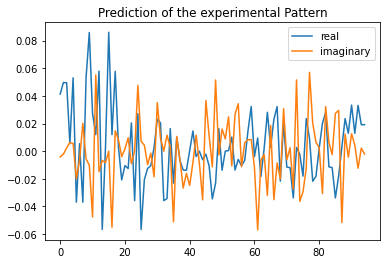

Applied shift of unit cell origin (fractional coordinates): 0.009460375929122642 -0.1370957035523128 0.0072901355939450916
Ug[ 0 ]: 0.04127 0.0  =>  0.04127 0.0
Ug[ 1 ]: 0.0496 -0.04581  =>  0.0496 0.0
Ug[ 2 ]: 0.0496 0.04581  =>  0.0496 0.0
Ug[ 3 ]: 0.0083 0.8614  =>  0.0083 0.0
Ug[ 4 ]: 0.05336 0.10377  =>  0.05336 -0.71183
Ug[ 5 ]: 0.04205 -2.64191  =>  0.04205 2.73407
Ug[ 6 ]: 0.0083 -0.8614  =>  0.0083 -0.0
Ug[ 7 ]: 0.04205 2.64191  =>  0.04205 -2.73407
Ug[ 8 ]: 0.05336 -0.10377  =>  0.05336 0.71183
Ug[ 9 ]: 0.08607 -0.05944  =>  0.08607 0.0
Ug[ 10 ]: 0.05476 -1.05251  =>  0.05476 -0.94727
Ug[ 11 ]: 0.05638 1.3573  =>  0.05638 1.37093
Ug[ 12 ]: 0.05966 -0.25022  =>  0.05966 0.67062
Ug[ 13 ]: 0.05704 -3.02042  =>  0.05704 -2.05377
Ug[ 14 ]: 0.00878 -1.22469  =>  0.00878 -0.34965
Ug[ 15 ]: 0.08607 0.05944  =>  0.08607 -0.0
Ug[ 16 ]: 0.05638 -1.3573  =>  0.05638 -1.37093
Ug[ 17 ]: 0.05966 0.25022  =>  0.05966 -0.67062
Ug[ 18 ]: 0.00878 1.22469  =>  0.00878 0.34965
Ug[ 19 ]: 0.02113 -

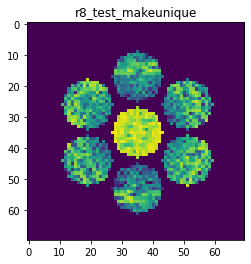

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9236222073226282
>>>replaced the 112. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 757ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 9.8403e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 721ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 9.9199e-04 - val_acc: 1.0000


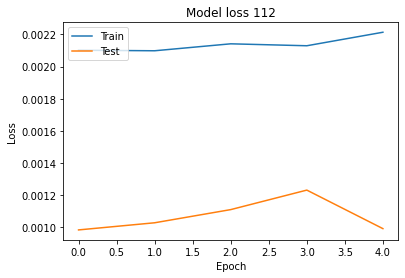

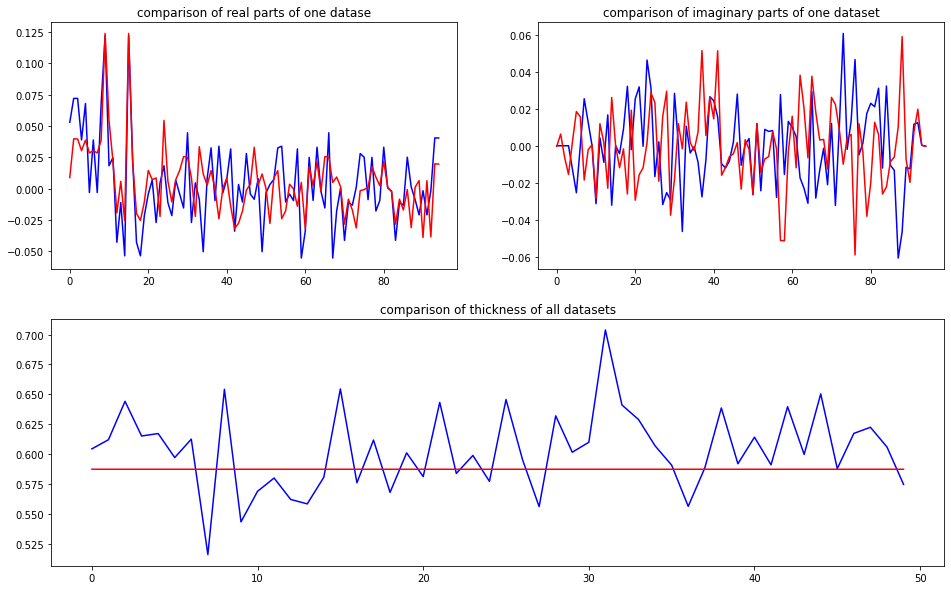

predicted thickness: 0.5872597


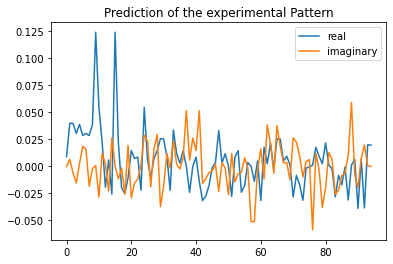

Applied shift of unit cell origin (fractional coordinates): -0.00034902005113225865 0.07559853566144346 -0.02496685994414072
Ug[ 0 ]: 0.00876 0.0  =>  0.00876 0.0
Ug[ 1 ]: 0.04011 0.15687  =>  0.04011 0.0
Ug[ 2 ]: 0.04011 -0.15687  =>  0.04011 0.0
Ug[ 3 ]: 0.03401 -0.475  =>  0.03401 0.0
Ug[ 4 ]: 0.03867 0.05692  =>  0.03867 0.37505
Ug[ 5 ]: 0.03388 0.57785  =>  0.03388 1.20972
Ug[ 6 ]: 0.03401 0.475  =>  0.03401 -0.0
Ug[ 7 ]: 0.03388 -0.57785  =>  0.03388 -1.20972
Ug[ 8 ]: 0.03867 -0.05692  =>  0.03867 -0.37505
Ug[ 9 ]: 0.12386 0.00219  =>  0.12386 0.0
Ug[ 10 ]: 0.06145 -0.48452  =>  0.06145 -0.64358
Ug[ 11 ]: 0.0251 0.4943  =>  0.0251 0.64898
Ug[ 12 ]: 0.01978 3.05779  =>  0.01978 2.5806
Ug[ 13 ]: 0.02388 -1.32488  =>  0.02388 -1.95895
Ug[ 14 ]: 0.03653 2.3478  =>  0.03653 2.02748
Ug[ 15 ]: 0.12386 -0.00219  =>  0.12386 -0.0
Ug[ 16 ]: 0.0251 -0.4943  =>  0.0251 -0.64898
Ug[ 17 ]: 0.01978 -3.05779  =>  0.01978 -2.5806
Ug[ 18 ]: 0.03653 -2.3478  =>  0.03653 -2.02748
Ug[ 19 ]: 0.02198 2

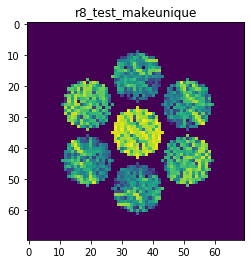

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9337623733014199
>>>replaced the 113. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 750ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 9.7500e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0022 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 9.9504e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000


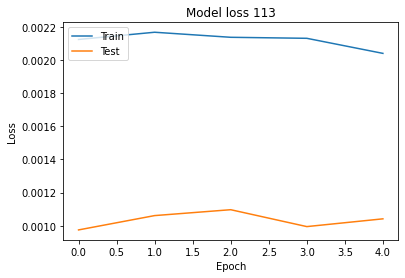

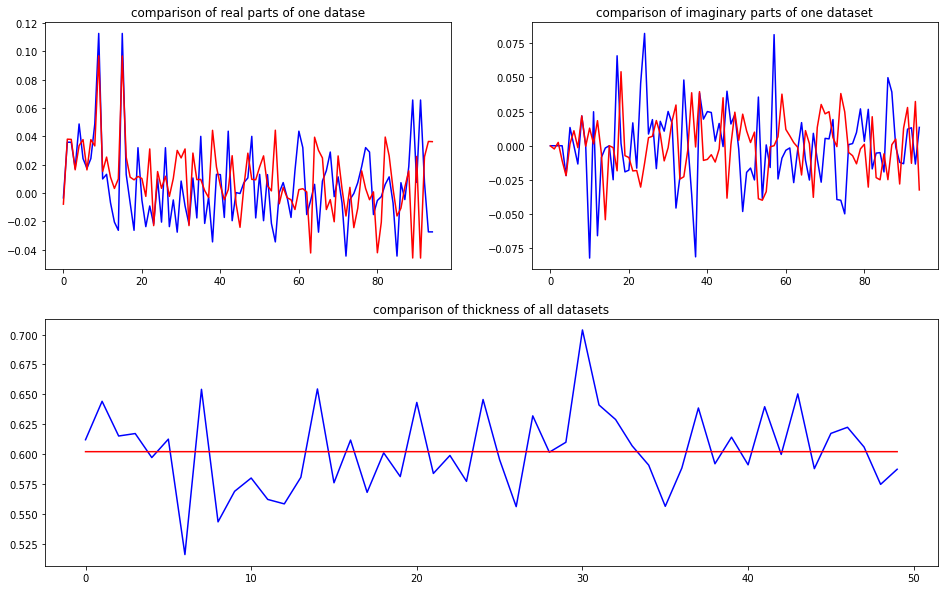

predicted thickness: 0.6019748


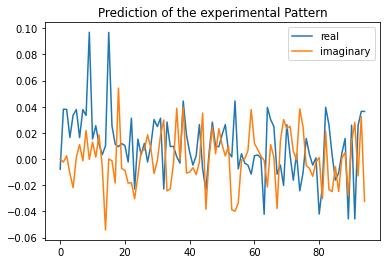

Applied shift of unit cell origin (fractional coordinates): 0.00028572601512356184 0.09365960434223544 0.010042469418629756
Ug[ 0 ]: 0.00779 3.14159  =>  0.00779 3.14159
Ug[ 1 ]: 0.03808 -0.0631  =>  0.03808 0.0
Ug[ 2 ]: 0.03808 0.0631  =>  0.03808 0.0
Ug[ 3 ]: 0.01975 -0.58848  =>  0.01975 0.0
Ug[ 4 ]: 0.03994 -0.57932  =>  0.03994 0.07226
Ug[ 5 ]: 0.0378 0.03716  =>  0.0378 0.56255
Ug[ 6 ]: 0.01975 0.58848  =>  0.01975 -0.0
Ug[ 7 ]: 0.0378 -0.03716  =>  0.0378 -0.56255
Ug[ 8 ]: 0.03994 0.57932  =>  0.03994 -0.07226
Ug[ 9 ]: 0.09685 -0.0018  =>  0.09685 0.0
Ug[ 10 ]: 0.01995 0.70173  =>  0.01995 0.76663
Ug[ 11 ]: 0.02546 0.05442  =>  0.02546 -0.00689
Ug[ 12 ]: 0.02158 1.01875  =>  0.02158 0.43207
Ug[ 13 ]: 0.00671 -1.04783  =>  0.00671 -1.57142
Ug[ 14 ]: 0.05507 -1.39355  =>  0.05507 -2.04333
Ug[ 15 ]: 0.09685 0.0018  =>  0.09685 0.0
Ug[ 16 ]: 0.02546 -0.05442  =>  0.02546 0.00689
Ug[ 17 ]: 0.02158 -1.01875  =>  0.02158 -0.43207
Ug[ 18 ]: 0.05507 1.39355  =>  0.05507 2.04333
Ug[ 19 ]:

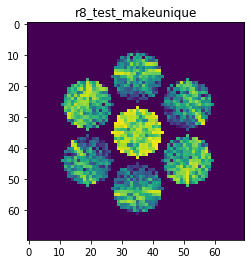

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.944109049358714
>>>replaced the 114. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 753ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.0281e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 9.7905e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.8363e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 8.4128e-04 - val_acc: 1.0000


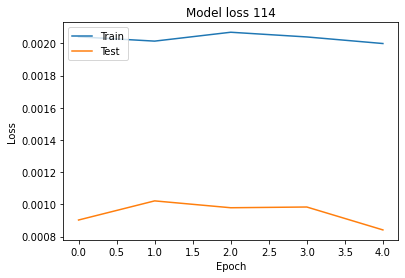

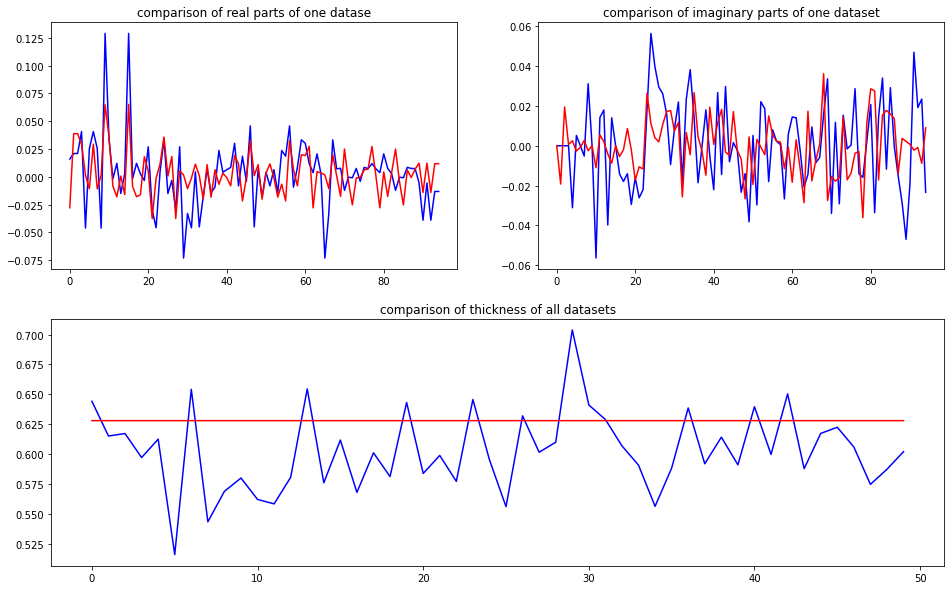

predicted thickness: 0.6279594


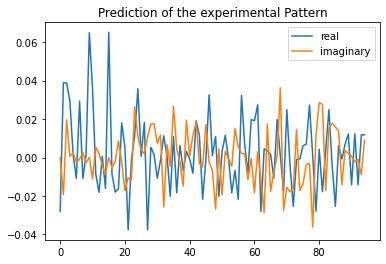

Applied shift of unit cell origin (fractional coordinates): -6.968744085251477e-05 -0.003959338143350525 0.07375602023872821
Ug[ 0 ]: 0.0279 3.14159  =>  0.0279 3.14159
Ug[ 1 ]: 0.04335 -0.46342  =>  0.04335 0.0
Ug[ 2 ]: 0.04335 0.46342  =>  0.04335 0.0
Ug[ 3 ]: 0.02926 0.02488  =>  0.02926 0.0
Ug[ 4 ]: 0.00287 1.06345  =>  0.00287 1.50199
Ug[ 5 ]: 0.01117 -2.90266  =>  0.01117 2.89222
Ug[ 6 ]: 0.02926 -0.02488  =>  0.02926 -0.0
Ug[ 7 ]: 0.01117 2.90266  =>  0.01117 -2.89222
Ug[ 8 ]: 0.00287 -1.06345  =>  0.00287 -1.50199
Ug[ 9 ]: 0.06495 0.00044  =>  0.06495 0.0
Ug[ 10 ]: 0.0374 -0.30012  =>  0.0374 0.16287
Ug[ 11 ]: 0.01022 2.57936  =>  0.01022 2.1155
Ug[ 12 ]: 0.01815 3.03012  =>  0.01815 3.05456
Ug[ 13 ]: 0.0041 -1.41437  =>  0.0041 -0.9265
Ug[ 14 ]: 0.01833 -2.64737  =>  0.01833 -3.08636
Ug[ 15 ]: 0.06495 -0.00044  =>  0.06495 0.0
Ug[ 16 ]: 0.01022 -2.57936  =>  0.01022 -2.1155
Ug[ 17 ]: 0.01815 -3.03012  =>  0.01815 -3.05456
Ug[ 18 ]: 0.01833 2.64737  =>  0.01833 3.08636
Ug[ 19 ]

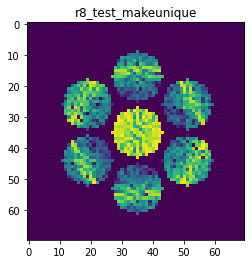

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9463382663261805
>>>replaced the 115. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 782ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.7485e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 744ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 742ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 744ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


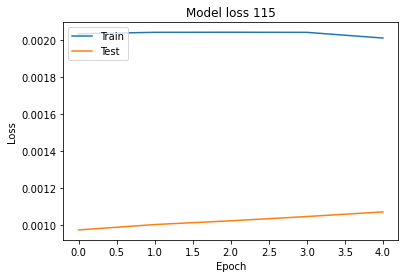

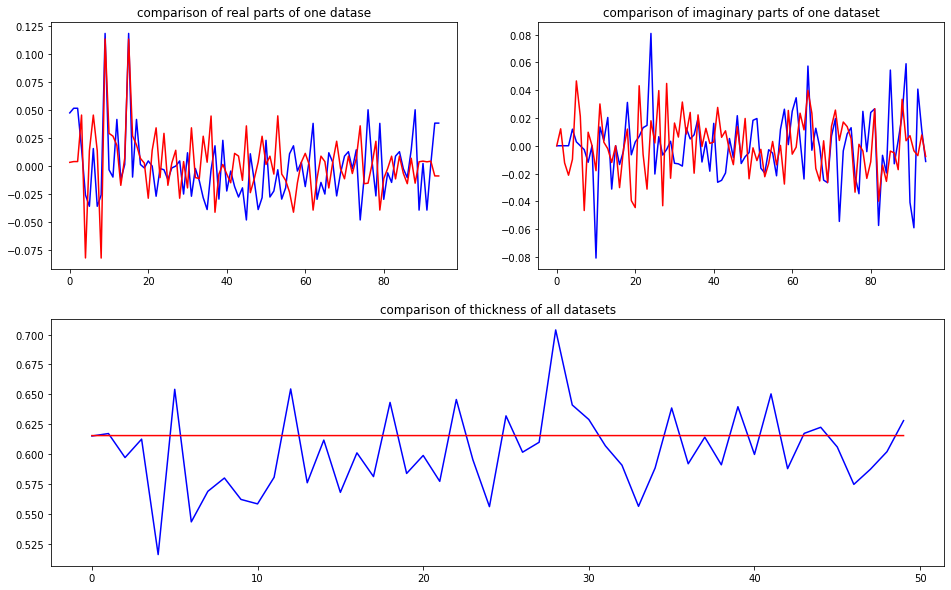

predicted thickness: 0.6154461


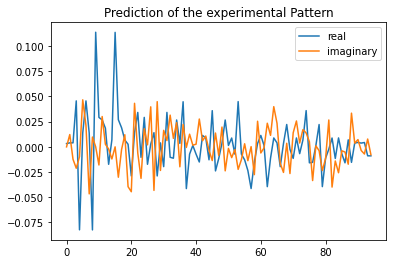

Applied shift of unit cell origin (fractional coordinates): -5.815071245625849e-06 0.06928379873683296 -0.20024595255889008
Ug[ 0 ]: 0.00327 0.0  =>  0.00327 0.0
Ug[ 1 ]: 0.01289 1.25818  =>  0.01289 -0.0
Ug[ 2 ]: 0.01289 -1.25818  =>  0.01289 0.0
Ug[ 3 ]: 0.05026 -0.43532  =>  0.05026 0.0
Ug[ 4 ]: 0.08288 -3.0238  =>  0.08288 2.43652
Ug[ 5 ]: 0.04859 1.28579  =>  0.04859 2.9793
Ug[ 6 ]: 0.05026 0.43532  =>  0.05026 0.0
Ug[ 7 ]: 0.04859 -1.28579  =>  0.04859 -2.9793
Ug[ 8 ]: 0.08288 3.0238  =>  0.08288 -2.43652
Ug[ 9 ]: 0.11358 4e-05  =>  0.11358 -0.0
Ug[ 10 ]: 0.0343 -0.55153  =>  0.0343 -1.80974
Ug[ 11 ]: 0.04031 0.84285  =>  0.04031 2.10099
Ug[ 12 ]: 0.01888 0.13578  =>  0.01888 -0.29958
Ug[ 13 ]: 0.01741 -3.02242  =>  0.01741 1.56723
Ug[ 14 ]: 0.01384 -1.05166  =>  0.01384 -0.22884
Ug[ 15 ]: 0.11358 -4e-05  =>  0.11358 0.0
Ug[ 16 ]: 0.04031 -0.84285  =>  0.04031 -2.10099
Ug[ 17 ]: 0.01888 -0.13578  =>  0.01888 0.29958
Ug[ 18 ]: 0.01384 1.05166  =>  0.01384 0.22884
Ug[ 19 ]: 0.03967

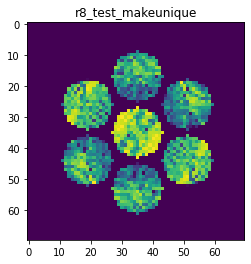

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8983286448131471
>>>replaced the 116. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 751ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0021 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.3752e-04 - val_acc: 1.0000


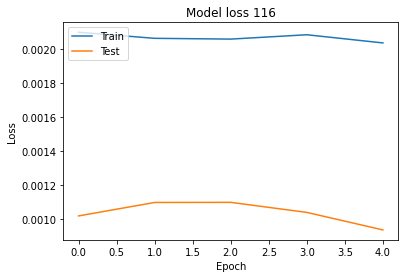

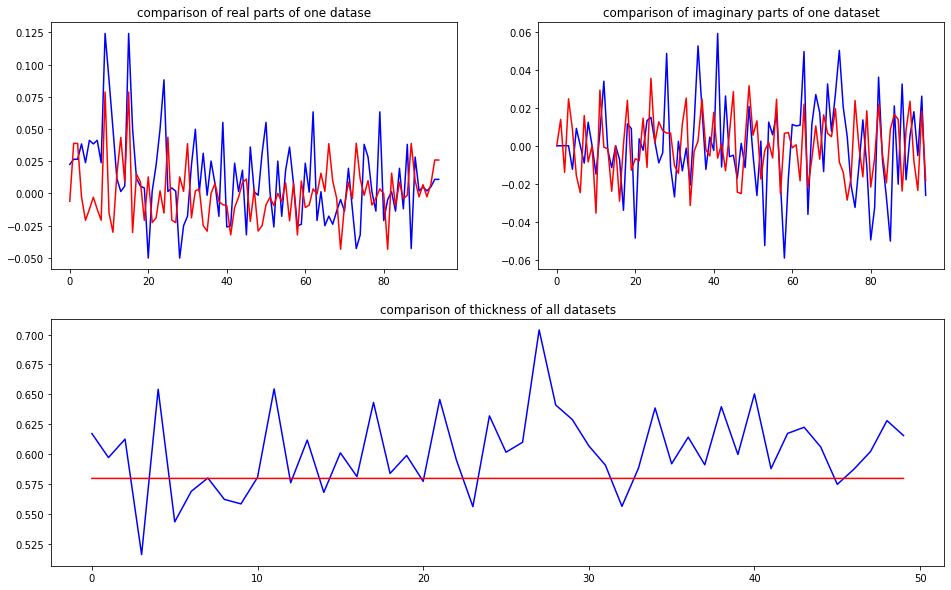

predicted thickness: 0.57958496


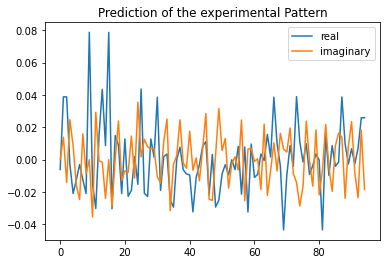

Applied shift of unit cell origin (fractional coordinates): 1.736776805917402e-07 -0.2690936578169259 -0.05485407477003096
Ug[ 0 ]: 0.00609 3.14159  =>  0.00609 3.14159
Ug[ 1 ]: 0.04125 0.34466  =>  0.04125 0.0
Ug[ 2 ]: 0.04125 -0.34466  =>  0.04125 0.0
Ug[ 3 ]: 0.0249 1.69077  =>  0.0249 0.0
Ug[ 4 ]: 0.02256 2.75532  =>  0.02256 0.71989
Ug[ 5 ]: 0.02016 -2.23312  =>  0.02016 2.70395
Ug[ 6 ]: 0.0249 -1.69077  =>  0.0249 -0.0
Ug[ 7 ]: 0.02016 2.23312  =>  0.02016 -2.70395
Ug[ 8 ]: 0.02256 -2.75532  =>  0.02256 -0.71989
Ug[ 9 ]: 0.07873 -0.0  =>  0.07873 0.0
Ug[ 10 ]: 0.03866 -1.97706  =>  0.03866 -2.32172
Ug[ 11 ]: 0.04211 2.37342  =>  0.04211 2.71807
Ug[ 12 ]: 0.01491 -0.04969  =>  0.01491 1.64108
Ug[ 13 ]: 0.04361 -0.03745  =>  0.04361 1.30866
Ug[ 14 ]: 0.02554 -1.21767  =>  0.02554 0.81775
Ug[ 15 ]: 0.07873 0.0  =>  0.07873 -0.0
Ug[ 16 ]: 0.04211 -2.37342  =>  0.04211 -2.71807
Ug[ 17 ]: 0.01491 0.04969  =>  0.01491 -1.64108
Ug[ 18 ]: 0.02554 1.21767  =>  0.02554 -0.81775
Ug[ 19 ]: 0.

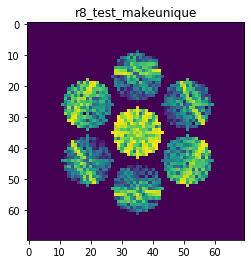

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9096511210374388
>>>replaced the 117. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 754ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.6802e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.8472e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.4506e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.4884e-04 - val_acc: 1.0000


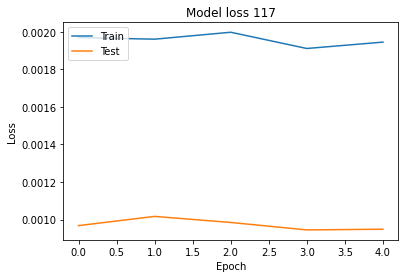

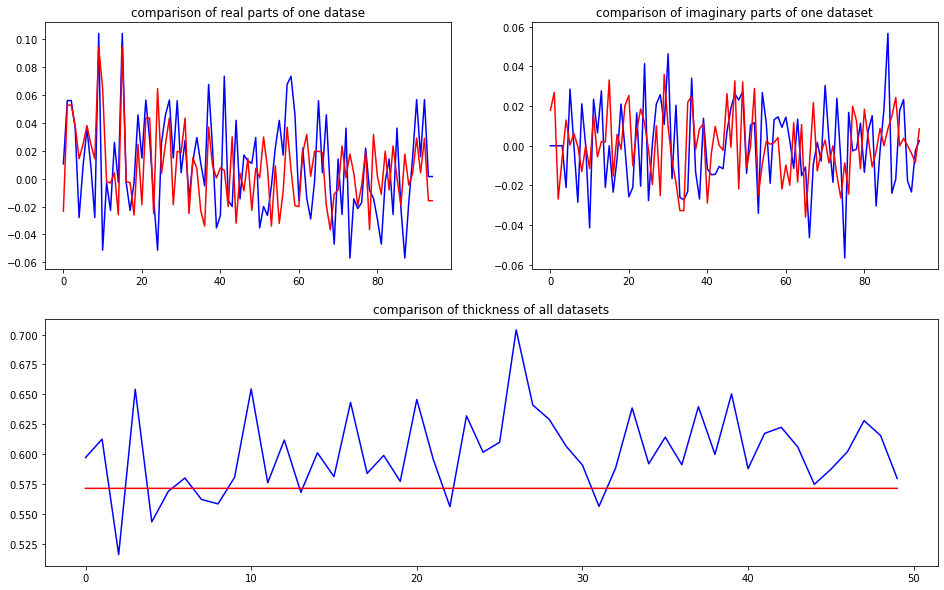

predicted thickness: 0.57126844


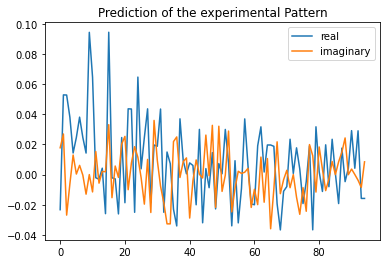

Applied shift of unit cell origin (fractional coordinates): 0.02763306417645245 0.025457150756856766 -0.07495724576440273
Ug[ 0 ]: 0.02328 3.14159  =>  0.02328 3.14159
Ug[ 1 ]: 0.05928 0.47097  =>  0.05928 0.0
Ug[ 2 ]: 0.05928 -0.47097  =>  0.05928 -0.0
Ug[ 3 ]: 0.03858 -0.15995  =>  0.03858 0.0
Ug[ 4 ]: 0.01932 0.73625  =>  0.01932 0.42523
Ug[ 5 ]: 0.02463 0.01464  =>  0.02463 0.64557
Ug[ 6 ]: 0.03858 0.15995  =>  0.03858 0.0
Ug[ 7 ]: 0.02463 -0.01464  =>  0.02463 -0.64557
Ug[ 8 ]: 0.01932 -0.73625  =>  0.01932 -0.42523
Ug[ 9 ]: 0.09584 -0.17362  =>  0.09584 0.0
Ug[ 10 ]: 0.06569 -0.17583  =>  0.06569 -0.47318
Ug[ 11 ]: 0.01545 1.70712  =>  0.01545 2.35171
Ug[ 12 ]: 0.00641 -2.05135  =>  0.00641 -2.03768
Ug[ 13 ]: 0.00454 0.47178  =>  0.00454 0.01448
Ug[ 14 ]: 0.02607 3.06963  =>  0.02607 -2.72892
Ug[ 15 ]: 0.09584 0.17362  =>  0.09584 -0.0
Ug[ 16 ]: 0.01545 -1.70712  =>  0.01545 -2.35171
Ug[ 17 ]: 0.00641 2.05135  =>  0.00641 2.03768
Ug[ 18 ]: 0.02607 -3.06963  =>  0.02607 2.72892
Ug

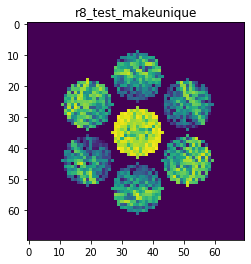

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9268883993041975
>>>replaced the 118. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 754ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 9.7116e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.6049e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 723ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000


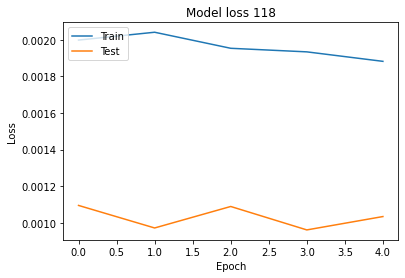

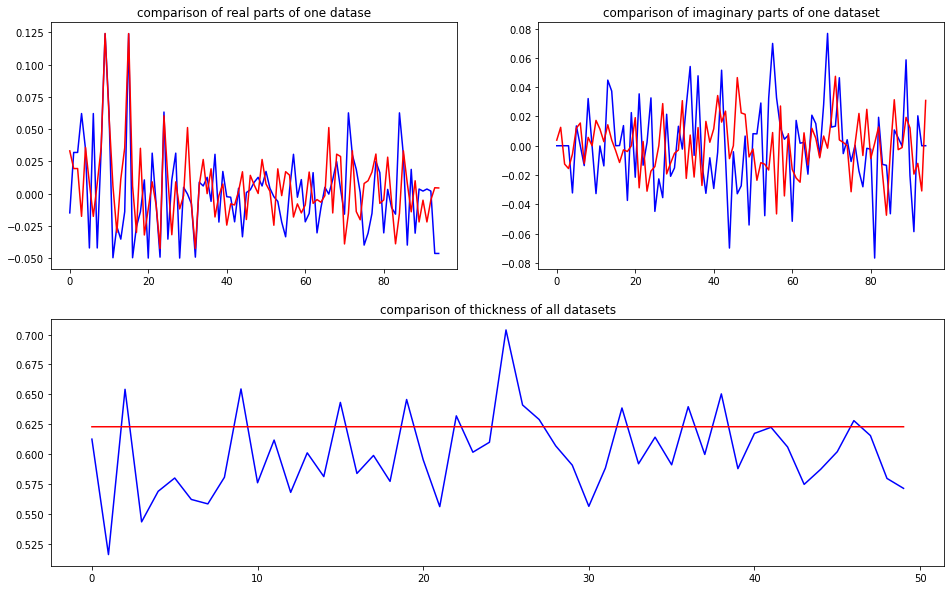

predicted thickness: 0.6228425


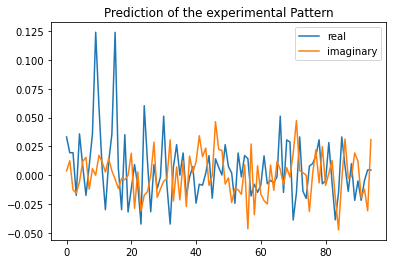

Applied shift of unit cell origin (fractional coordinates): -0.002103781020609111 0.3841581926372507 -0.09080427012642348
Ug[ 0 ]: 0.03322 0.0  =>  0.03322 0.0
Ug[ 1 ]: 0.02322 0.57054  =>  0.02322 0.0
Ug[ 2 ]: 0.02322 -0.57054  =>  0.02322 -0.0
Ug[ 3 ]: 0.02338 -2.41374  =>  0.02338 -0.0
Ug[ 4 ]: 0.03638 -0.15727  =>  0.03638 1.68593
Ug[ 5 ]: 0.01454 0.97792  =>  0.01454 -2.32099
Ug[ 6 ]: 0.02338 2.41374  =>  0.02338 0.0
Ug[ 7 ]: 0.01454 -0.97792  =>  0.01454 2.32099
Ug[ 8 ]: 0.03638 0.15727  =>  0.03638 -1.68593
Ug[ 9 ]: 0.12406 0.01322  =>  0.12406 0.0
Ug[ 10 ]: 0.0628 0.2792  =>  0.0628 -0.30456
Ug[ 11 ]: 0.0129 1.08744  =>  0.0129 1.64476
Ug[ 12 ]: 0.03003 3.04853  =>  0.03003 0.62158
Ug[ 13 ]: 0.01828 0.89483  =>  0.01828 -2.10266
Ug[ 14 ]: 0.03561 0.11045  =>  0.03561 -1.74596
Ug[ 15 ]: 0.12406 -0.01322  =>  0.12406 0.0
Ug[ 16 ]: 0.0129 -1.08744  =>  0.0129 -1.64476
Ug[ 17 ]: 0.03003 -3.04853  =>  0.03003 -0.62158
Ug[ 18 ]: 0.03561 -0.11045  =>  0.03561 1.74596
Ug[ 19 ]: 0.03176

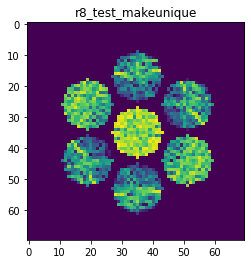

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9477633229553761
>>>replaced the 119. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 767ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.4251e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.8533e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0020 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000


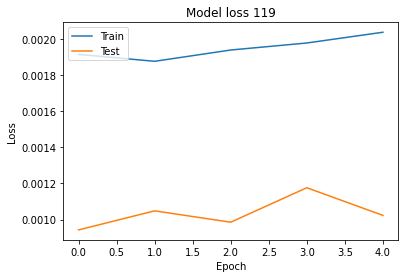

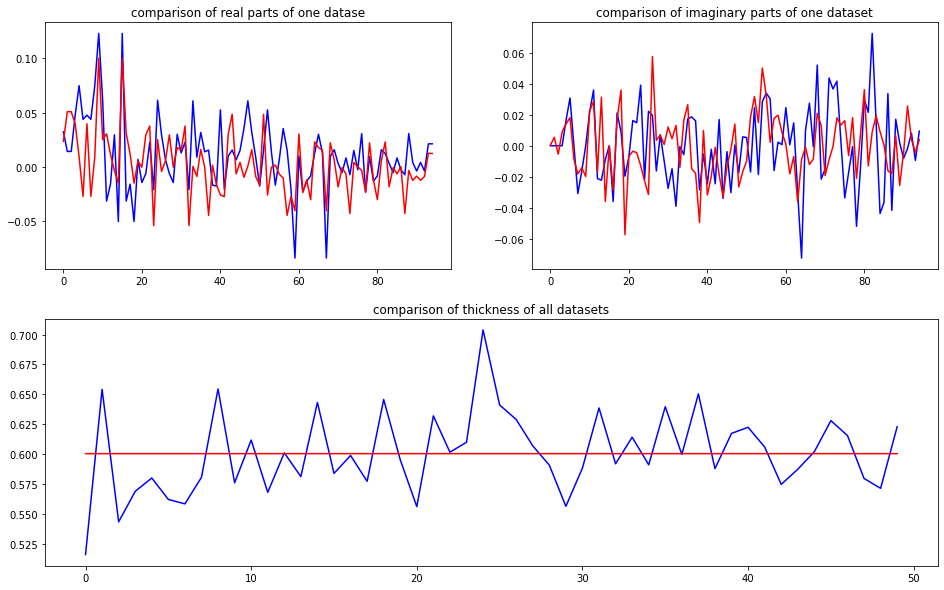

predicted thickness: 0.600305


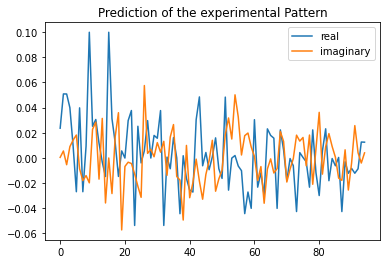

Applied shift of unit cell origin (fractional coordinates): 0.01569588334843906 -0.03471826669819931 -0.01702864866007091
Ug[ 0 ]: 0.02359 0.0  =>  0.02359 0.0
Ug[ 1 ]: 0.05116 0.10699  =>  0.05116 0.0
Ug[ 2 ]: 0.05116 -0.10699  =>  0.05116 0.0
Ug[ 3 ]: 0.04081 0.21814  =>  0.04081 0.0
Ug[ 4 ]: 0.01696 0.9864  =>  0.01696 0.66126
Ug[ 5 ]: 0.03255 2.55005  =>  0.03255 2.43891
Ug[ 6 ]: 0.04081 -0.21814  =>  0.04081 -0.0
Ug[ 7 ]: 0.03255 -2.55005  =>  0.03255 -2.43891
Ug[ 8 ]: 0.01696 -0.9864  =>  0.01696 -0.66126
Ug[ 9 ]: 0.1005 -0.09862  =>  0.1005 0.0
Ug[ 10 ]: 0.03385 0.7338  =>  0.03385 0.72542
Ug[ 11 ]: 0.04197 0.74482  =>  0.04197 0.95043
Ug[ 12 ]: 0.02066 -0.96457  =>  0.02066 -0.64781
Ug[ 13 ]: 0.03165 1.68915  =>  0.03165 1.89892
Ug[ 14 ]: 0.0389 -1.96317  =>  0.0389 -1.53942
Ug[ 15 ]: 0.1005 0.09862  =>  0.1005 0.0
Ug[ 16 ]: 0.04197 -0.74482  =>  0.04197 -0.95043
Ug[ 17 ]: 0.02066 0.96457  =>  0.02066 0.64781
Ug[ 18 ]: 0.0389 1.96317  =>  0.0389 1.53942
Ug[ 19 ]: 0.05777 -1.474

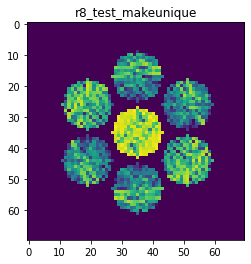

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9275426736713114
>>>replaced the 120. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 752ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.5566e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 724ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


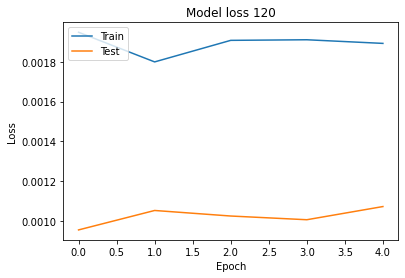

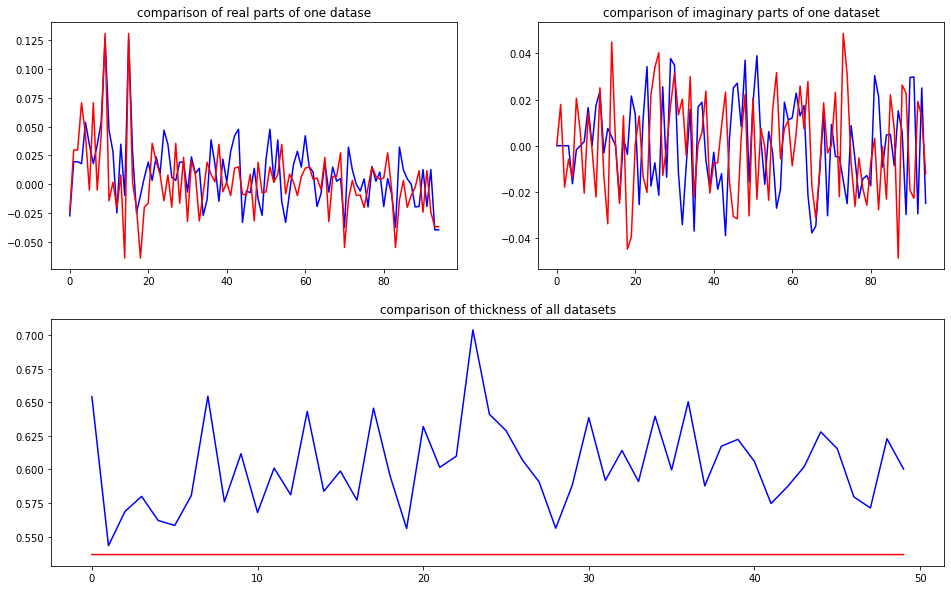

predicted thickness: 0.53660065


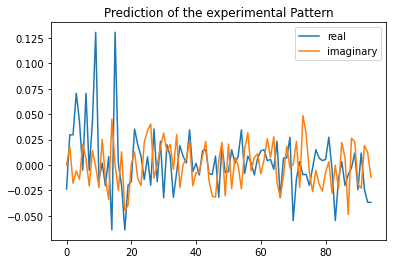

Applied shift of unit cell origin (fractional coordinates): 0.0008341249253895672 0.0133433069131453 -0.0865281626211042
Ug[ 0 ]: 0.02364 3.14159  =>  0.02364 3.14159
Ug[ 1 ]: 0.03467 0.54367  =>  0.03467 -0.0
Ug[ 2 ]: 0.03467 -0.54367  =>  0.03467 0.0
Ug[ 3 ]: 0.07079 -0.08384  =>  0.07079 0.0
Ug[ 4 ]: 0.04494 -0.31816  =>  0.04494 -0.778
Ug[ 5 ]: 0.0212 1.81511  =>  0.0212 2.44262
Ug[ 6 ]: 0.07079 0.08384  =>  0.07079 0.0
Ug[ 7 ]: 0.0212 -1.81511  =>  0.0212 -2.44262
Ug[ 8 ]: 0.04494 0.31816  =>  0.04494 0.778
Ug[ 9 ]: 0.13054 -0.00524  =>  0.13054 0.0
Ug[ 10 ]: 0.02646 -2.14308  =>  0.02646 -2.68151
Ug[ 11 ]: 0.02511 1.50962  =>  0.02511 2.05853
Ug[ 12 ]: 0.02422 -2.57796  =>  0.02422 -2.65656
Ug[ 13 ]: 0.03478 -1.33734  =>  0.03478 -1.95961
Ug[ 14 ]: 0.07808 2.5294  =>  0.07808 2.99447
Ug[ 15 ]: 0.13054 0.00524  =>  0.13054 0.0
Ug[ 16 ]: 0.02511 -1.50962  =>  0.02511 -2.05853
Ug[ 17 ]: 0.02422 2.57796  =>  0.02422 2.65656
Ug[ 18 ]: 0.07808 -2.5294  =>  0.07808 -2.99447
Ug[ 19 ]: 0.

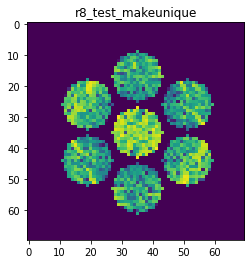

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.933522446951645
>>>replaced the 121. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 757ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 8.8980e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0019 - acc: 1.0000 - val_loss: 9.8680e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.5177e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 8.2672e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 723ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.4903e-04 - val_acc: 1.0000


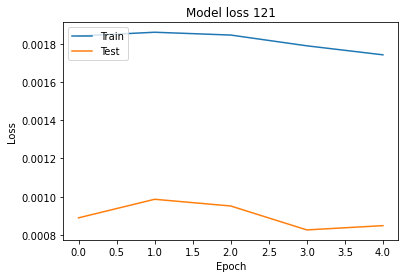

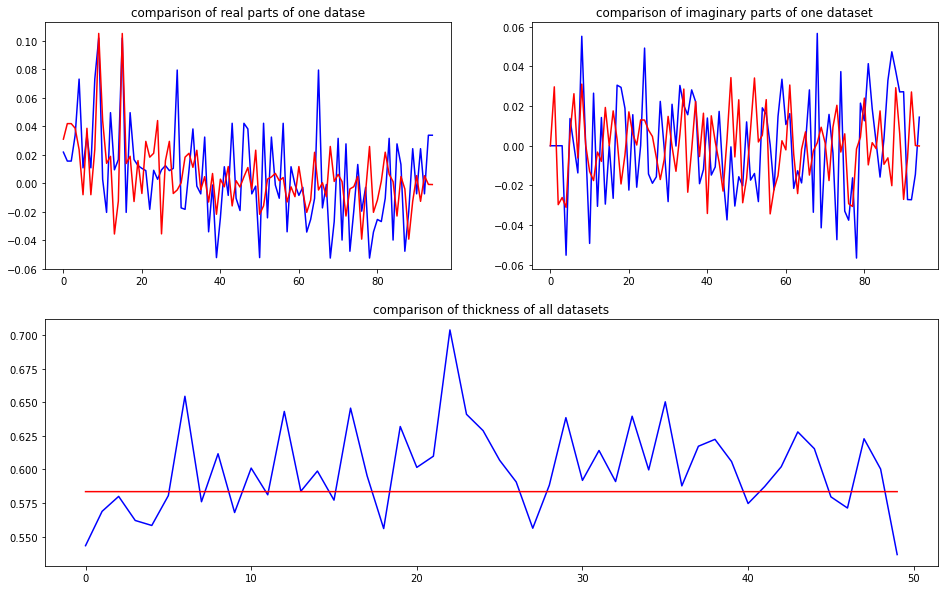

predicted thickness: 0.58346456


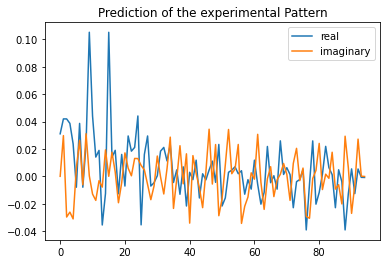

Applied shift of unit cell origin (fractional coordinates): -0.0002604228050772872 0.09481755341612291 -0.09817743344724357
Ug[ 0 ]: 0.03103 0.0  =>  0.03103 0.0
Ug[ 1 ]: 0.05139 0.61687  =>  0.05139 -0.0
Ug[ 2 ]: 0.05139 -0.61687  =>  0.05139 0.0
Ug[ 3 ]: 0.04669 -0.59576  =>  0.04669 0.0
Ug[ 4 ]: 0.03914 -0.91844  =>  0.03914 -0.93955
Ug[ 5 ]: 0.01009 2.4819  =>  0.01009 -2.58866
Ug[ 6 ]: 0.04669 0.59576  =>  0.04669 -0.0
Ug[ 7 ]: 0.01009 -2.4819  =>  0.01009 2.58866
Ug[ 8 ]: 0.03914 0.91844  =>  0.03914 0.93955
Ug[ 9 ]: 0.10518 0.00164  =>  0.10518 0.0
Ug[ 10 ]: 0.04593 -0.28611  =>  0.04593 -0.90461
Ug[ 11 ]: 0.02247 -0.89885  =>  0.02247 -0.28362
Ug[ 12 ]: 0.01922 -0.16685  =>  0.01922 -0.76425
Ug[ 13 ]: 0.03637 -2.92244  =>  0.03637 2.14649
Ug[ 14 ]: 0.02306 2.14927  =>  0.02306 2.16875
Ug[ 15 ]: 0.10518 -0.00164  =>  0.10518 0.0
Ug[ 16 ]: 0.02247 0.89885  =>  0.02247 0.28362
Ug[ 17 ]: 0.01922 0.16685  =>  0.01922 0.76425
Ug[ 18 ]: 0.02306 -2.14927  =>  0.02306 -2.16875
Ug[ 19 ]:

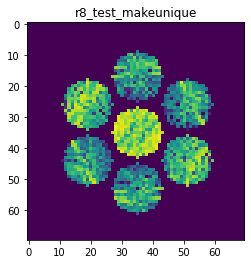

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9664349372056961
>>>replaced the 122. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 765ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.4831e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.9315e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.0896e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.5024e-04 - val_acc: 1.0000


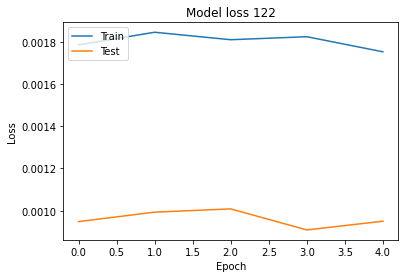

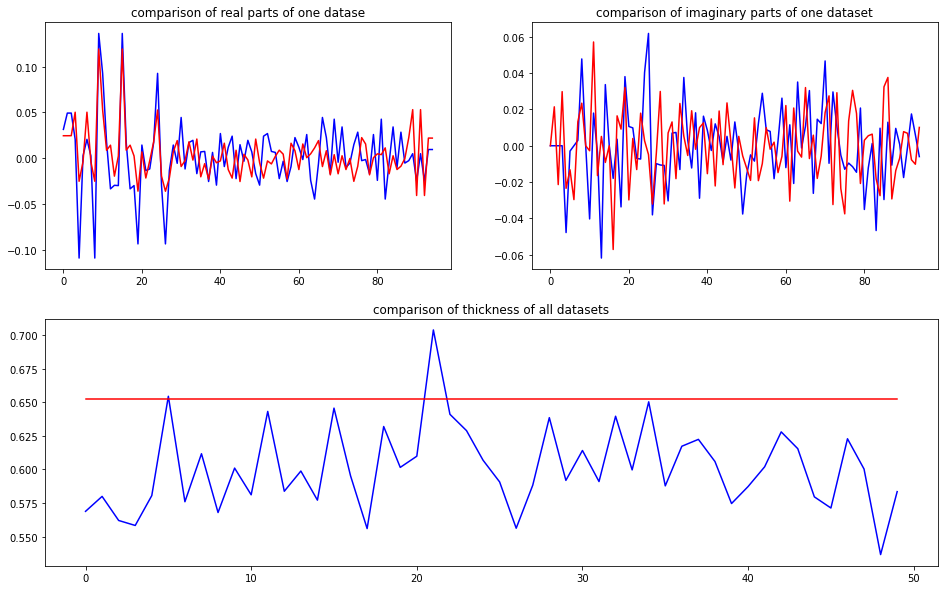

predicted thickness: 0.6525228


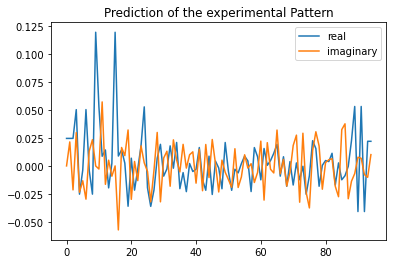

Applied shift of unit cell origin (fractional coordinates): 5.278141684071362e-06 -0.08499790811168194 -0.11402052275493288
Ug[ 0 ]: 0.02457 0.0  =>  0.02457 0.0
Ug[ 1 ]: 0.03261 0.71641  =>  0.03261 0.0
Ug[ 2 ]: 0.03261 -0.71641  =>  0.03261 0.0
Ug[ 3 ]: 0.05842 0.53406  =>  0.05842 0.0
Ug[ 4 ]: 0.03443 -2.39241  =>  0.03443 2.64031
Ug[ 5 ]: 0.01379 -1.85353  =>  0.01379 -1.67118
Ug[ 6 ]: 0.05842 -0.53406  =>  0.05842 -0.0
Ug[ 7 ]: 0.01379 1.85353  =>  0.01379 1.67118
Ug[ 8 ]: 0.03443 2.39241  =>  0.03443 -2.64031
Ug[ 9 ]: 0.11936 -3e-05  =>  0.11936 -0.0
Ug[ 10 ]: 0.0528 -0.05218  =>  0.0528 -0.76856
Ug[ 11 ]: 0.05781 1.41912  =>  0.05781 2.13557
Ug[ 12 ]: 0.02177 -0.85656  =>  0.02177 -0.32247
Ug[ 13 ]: 0.02019 2.89099  =>  0.02019 2.70867
Ug[ 14 ]: 0.00948 -1.31558  =>  0.00948 -0.06508
Ug[ 15 ]: 0.11936 3e-05  =>  0.11936 0.0
Ug[ 16 ]: 0.05781 -1.41912  =>  0.05781 -2.13557
Ug[ 17 ]: 0.02177 0.85656  =>  0.02177 0.32247
Ug[ 18 ]: 0.00948 1.31558  =>  0.00948 0.06508
Ug[ 19 ]: 0.04

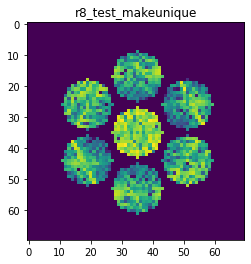

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9202732879797967
>>>replaced the 123. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 772ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.5381e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.0736e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 8.8256e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


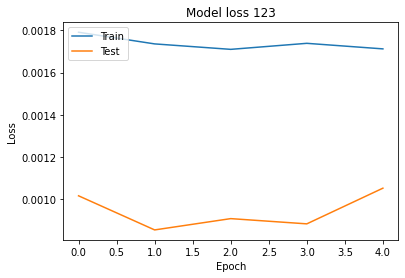

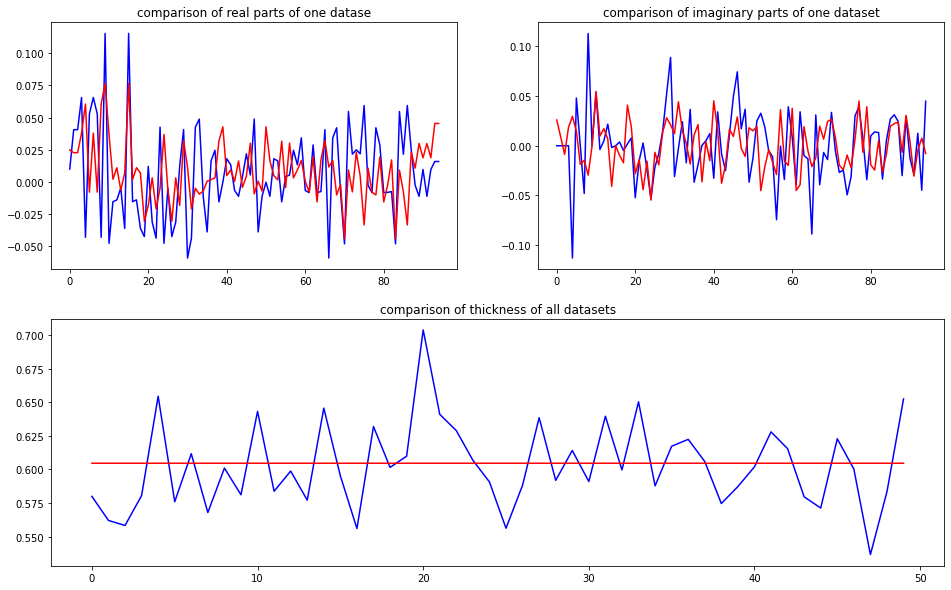

predicted thickness: 0.6046199


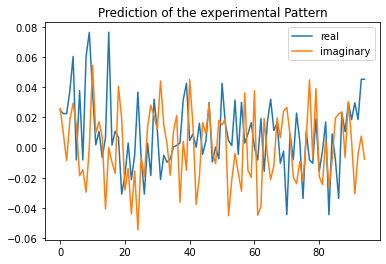

Applied shift of unit cell origin (fractional coordinates): -3.1769325534233266e-06 -0.07293085092877696 -0.059323466023993965
Ug[ 0 ]: 0.02469 0.0  =>  0.02469 0.0
Ug[ 1 ]: 0.02423 0.37274  =>  0.02423 0.0
Ug[ 2 ]: 0.02423 -0.37274  =>  0.02423 -0.0
Ug[ 3 ]: 0.04218 0.45824  =>  0.04218 0.0
Ug[ 4 ]: 0.06737 0.45436  =>  0.06737 -0.37662
Ug[ 5 ]: 0.01686 2.07967  =>  0.01686 1.99418
Ug[ 6 ]: 0.04218 -0.45824  =>  0.04218 0.0
Ug[ 7 ]: 0.01686 -2.07967  =>  0.01686 -1.99418
Ug[ 8 ]: 0.06737 -0.45436  =>  0.06737 0.37662
Ug[ 9 ]: 0.07656 2e-05  =>  0.07656 0.0
Ug[ 10 ]: 0.06592 0.97776  =>  0.06592 0.605
Ug[ 11 ]: 0.00986 1.39307  =>  0.00986 1.76579
Ug[ 12 ]: 0.02026 1.00727  =>  0.02026 1.46549
Ug[ 13 ]: 0.00946 2.35149  =>  0.00946 2.43697
Ug[ 14 ]: 0.04141 -1.40683  =>  0.04141 -0.57587
Ug[ 15 ]: 0.07656 -2e-05  =>  0.07656 0.0
Ug[ 16 ]: 0.00986 -1.39307  =>  0.00986 -1.76579
Ug[ 17 ]: 0.02026 -1.00727  =>  0.02026 -1.46549
Ug[ 18 ]: 0.04141 1.40683  =>  0.04141 0.57587
Ug[ 19 ]: 0.03

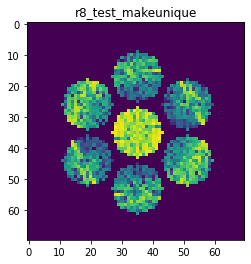

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9691555996324144
>>>replaced the 124. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 759ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.0398e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 8.9450e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.1614e-04 - val_acc: 1.0000


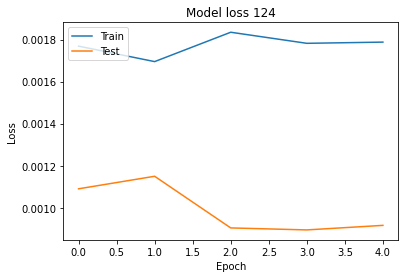

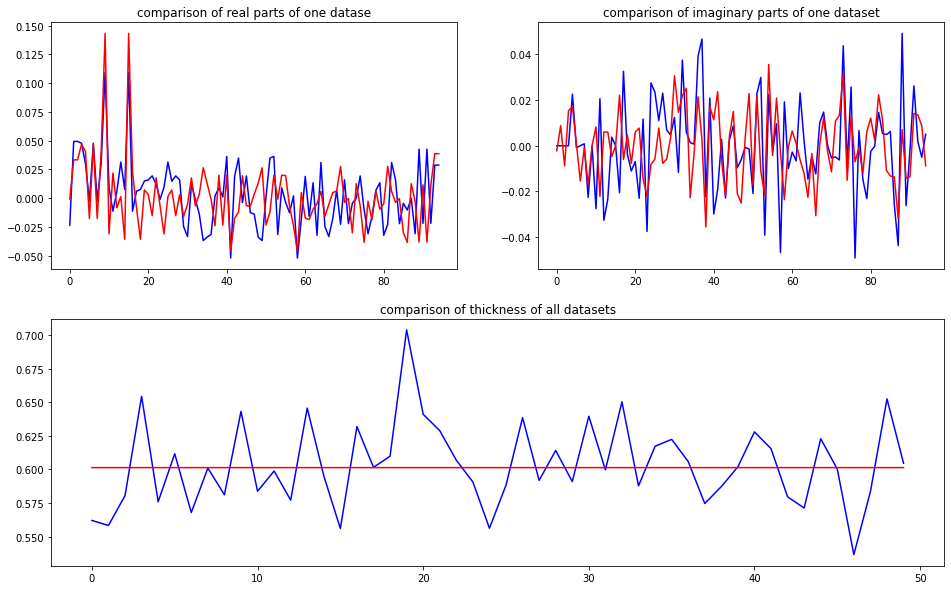

predicted thickness: 0.60135365


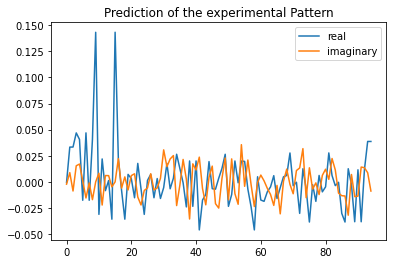

Applied shift of unit cell origin (fractional coordinates): 6.695167087636656e-07 -0.05062848452442204 -0.041071943069379786
Ug[ 0 ]: 0.00063 3.14159  =>  0.00063 3.14159
Ug[ 1 ]: 0.03445 0.25806  =>  0.03445 0.0
Ug[ 2 ]: 0.03445 -0.25806  =>  0.03445 0.0
Ug[ 3 ]: 0.04936 0.31811  =>  0.04936 0.0
Ug[ 4 ]: 0.04409 0.39661  =>  0.04409 -0.17956
Ug[ 5 ]: 0.01767 3.08518  =>  0.01767 3.02513
Ug[ 6 ]: 0.04936 -0.31811  =>  0.04936 -0.0
Ug[ 7 ]: 0.01767 -3.08518  =>  0.01767 -3.02513
Ug[ 8 ]: 0.04409 -0.39661  =>  0.04409 0.17956
Ug[ 9 ]: 0.14327 -0.0  =>  0.14327 -0.0
Ug[ 10 ]: 0.03222 2.88214  =>  0.03222 2.62408
Ug[ 11 ]: 0.03128 -0.78949  =>  0.03128 -0.53142
Ug[ 12 ]: 0.01033 2.51781  =>  0.01033 2.83592
Ug[ 13 ]: 0.00606 1.34446  =>  0.00606 1.40451
Ug[ 14 ]: 0.03608 -3.00891  =>  0.03608 -2.43273
Ug[ 15 ]: 0.14327 0.0  =>  0.14327 0.0
Ug[ 16 ]: 0.03128 0.78949  =>  0.03128 0.53142
Ug[ 17 ]: 0.01033 -2.51781  =>  0.01033 -2.83592
Ug[ 18 ]: 0.03608 3.00891  =>  0.03608 2.43273
Ug[ 19 ]:

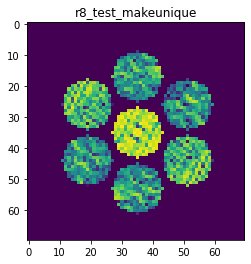

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8626444805019547
>>>replaced the 125. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 761ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.0185e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.5430e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.2318e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


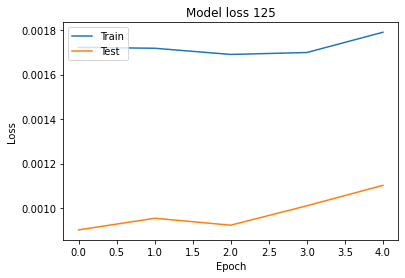

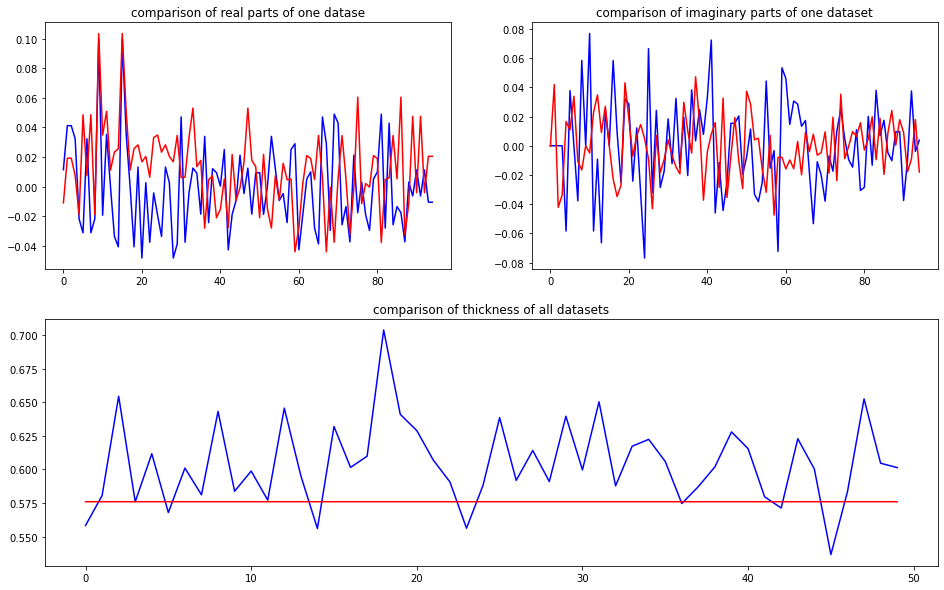

predicted thickness: 0.57595664


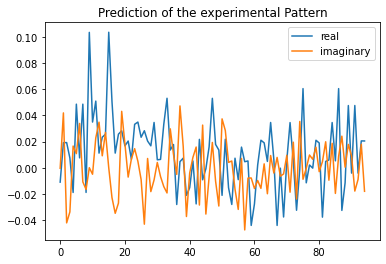

Applied shift of unit cell origin (fractional coordinates): -1.5545526794966333e-05 0.21531943048217106 -0.1818144461955449
Ug[ 0 ]: 0.011 3.14159  =>  0.011 3.14159
Ug[ 1 ]: 0.0462 1.14237  =>  0.0462 -0.0
Ug[ 2 ]: 0.0462 -1.14237  =>  0.0462 0.0
Ug[ 3 ]: 0.03463 -1.35289  =>  0.03463 0.0
Ug[ 4 ]: 0.02513 2.42121  =>  0.02513 2.63173
Ug[ 5 ]: 0.04978 0.21868  =>  0.04978 2.71395
Ug[ 6 ]: 0.03463 1.35289  =>  0.03463 -0.0
Ug[ 7 ]: 0.04978 -0.21868  =>  0.04978 -2.71395
Ug[ 8 ]: 0.02513 -2.42121  =>  0.02513 -2.63173
Ug[ 9 ]: 0.10351 0.0001  =>  0.10351 0.0
Ug[ 10 ]: 0.03527 -0.14122  =>  0.03527 -1.28369
Ug[ 11 ]: 0.05572 0.42191  =>  0.05572 1.56418
Ug[ 12 ]: 0.03657 1.2602  =>  0.03657 -0.09279
Ug[ 13 ]: 0.025 0.37116  =>  0.025 -2.12421
Ug[ 14 ]: 0.03725 0.81109  =>  0.03725 0.60048
Ug[ 15 ]: 0.10351 -0.0001  =>  0.10351 0.0
Ug[ 16 ]: 0.05572 -0.42191  =>  0.05572 -1.56418
Ug[ 17 ]: 0.03657 -1.2602  =>  0.03657 0.09279
Ug[ 18 ]: 0.03725 -0.81109  =>  0.03725 -0.60048
Ug[ 19 ]: 0.051

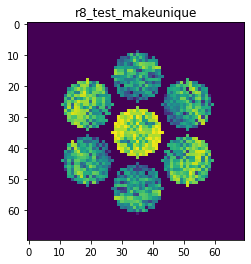

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8946388613441838
>>>replaced the 126. dataset and train: 
Epoch 1/5
8/8 [==============================] - 8s 758ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.1845e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.4957e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 749ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.5598e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.2451e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000


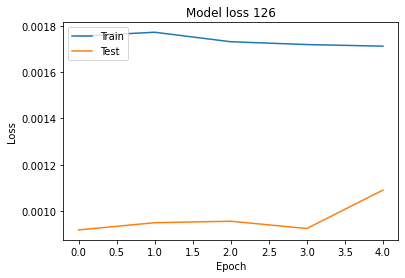

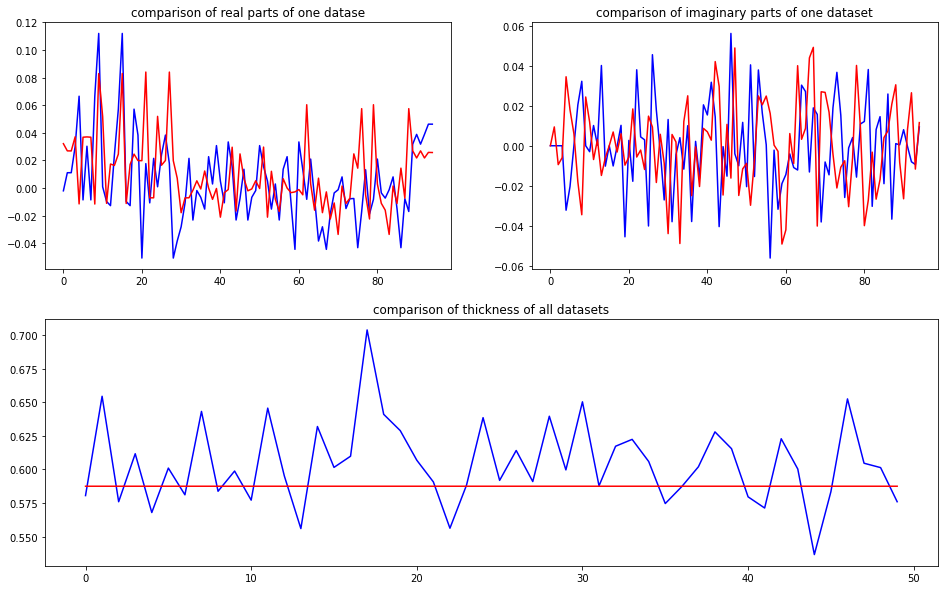

predicted thickness: 0.58749264


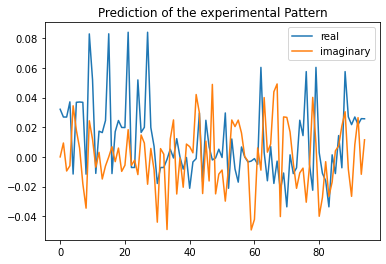

Applied shift of unit cell origin (fractional coordinates): -0.02321949614888991 0.025379885021608883 -0.053640665507712494
Ug[ 0 ]: 0.03216 0.0  =>  0.03216 0.0
Ug[ 1 ]: 0.02852 0.33703  =>  0.02852 0.0
Ug[ 2 ]: 0.02852 -0.33703  =>  0.02852 -0.0
Ug[ 3 ]: 0.03757 -0.15947  =>  0.03757 0.0
Ug[ 4 ]: 0.03639 1.89396  =>  0.03639 1.71639
Ug[ 5 ]: 0.04102 0.45522  =>  0.04102 0.95172
Ug[ 6 ]: 0.03757 0.15947  =>  0.03757 -0.0
Ug[ 7 ]: 0.04102 -0.45522  =>  0.04102 -0.95172
Ug[ 8 ]: 0.03639 -1.89396  =>  0.03639 -1.71639
Ug[ 9 ]: 0.08388 0.14589  =>  0.08388 0.0
Ug[ 10 ]: 0.05329 0.22458  =>  0.05329 -0.25835
Ug[ 11 ]: 0.01309 -2.58753  =>  0.01309 -2.39639
Ug[ 12 ]: 0.01751 0.18037  =>  0.01751 -0.12499
Ug[ 13 ]: 0.02217 -0.7325  =>  0.02217 -1.37489
Ug[ 14 ]: 0.02531 -0.2398  =>  0.02531 -0.20812
Ug[ 15 ]: 0.08388 -0.14589  =>  0.08388 0.0
Ug[ 16 ]: 0.01309 2.58753  =>  0.01309 2.39639
Ug[ 17 ]: 0.01751 -0.18037  =>  0.01751 0.12499
Ug[ 18 ]: 0.02531 0.2398  =>  0.02531 0.20812
Ug[ 19 ]: 

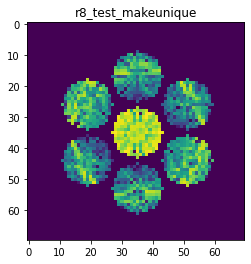

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9629615555228408
>>>replaced the 127. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.4840e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 730ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 9.2738e-04 - val_acc: 1.0000


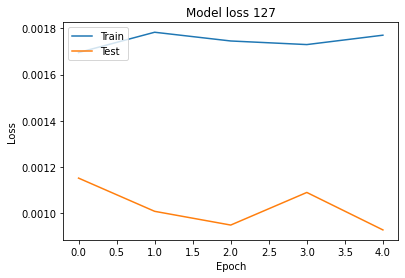

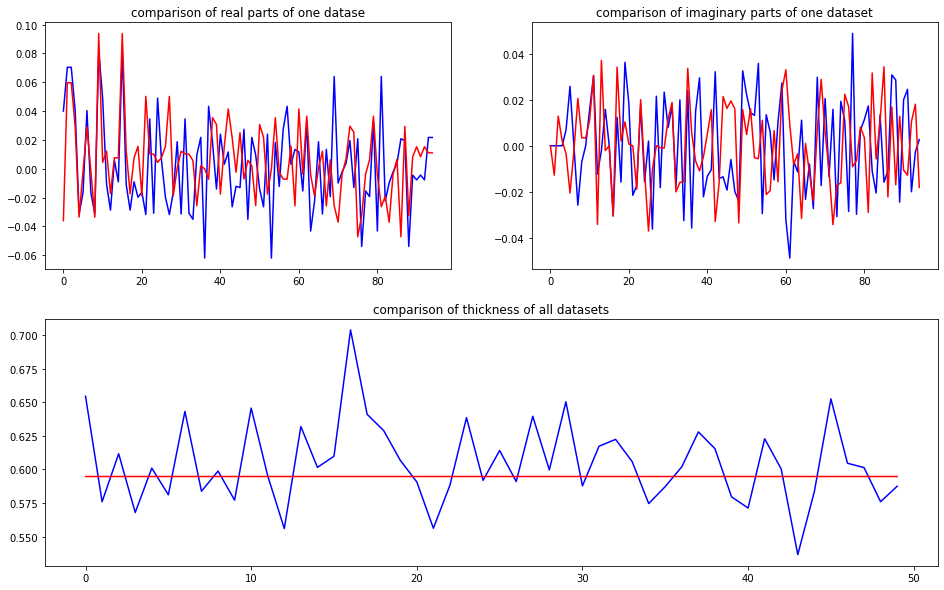

predicted thickness: 0.59473497


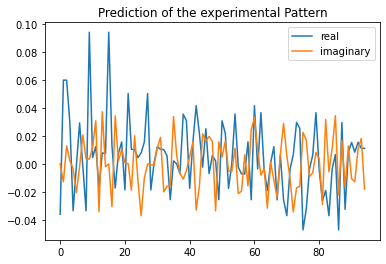

Applied shift of unit cell origin (fractional coordinates): -0.002817969902370861 -0.011643422424133621 0.03368726437315042
Ug[ 0 ]: 0.03601 3.14159  =>  0.03601 3.14159
Ug[ 1 ]: 0.06106 -0.21166  =>  0.06106 0.0
Ug[ 2 ]: 0.06106 0.21166  =>  0.06106 0.0
Ug[ 3 ]: 0.02928 0.07316  =>  0.02928 -0.0
Ug[ 4 ]: 0.03373 -3.03794  =>  0.03373 -2.89943
Ug[ 5 ]: 0.02068 -1.65841  =>  0.02068 -1.94323
Ug[ 6 ]: 0.02928 -0.07316  =>  0.02928 0.0
Ug[ 7 ]: 0.02068 1.65841  =>  0.02068 1.94323
Ug[ 8 ]: 0.03373 3.03794  =>  0.03373 2.89943
Ug[ 9 ]: 0.09389 0.01771  =>  0.09389 -0.0
Ug[ 10 ]: 0.01202 1.19688  =>  0.01202 1.39084
Ug[ 11 ]: 0.03308 1.18521  =>  0.03308 0.95584
Ug[ 12 ]: 0.03828 -2.03687  =>  0.03828 -1.98142
Ug[ 13 ]: 0.03792 1.36513  =>  0.03792 1.63224
Ug[ 14 ]: 0.00775 -0.27274  =>  0.00775 -0.42895
Ug[ 15 ]: 0.09389 -0.01771  =>  0.09389 0.0
Ug[ 16 ]: 0.03308 -1.18521  =>  0.03308 -0.95584
Ug[ 17 ]: 0.03828 2.03687  =>  0.03828 1.98142
Ug[ 18 ]: 0.00775 0.27274  =>  0.00775 0.42895
Ug

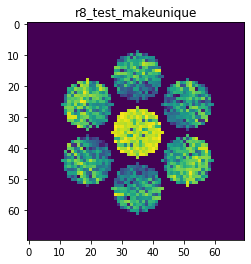

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8931464893838942
>>>replaced the 128. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 748ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 8.7033e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.9465e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 8.9764e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.3360e-04 - val_acc: 1.0000


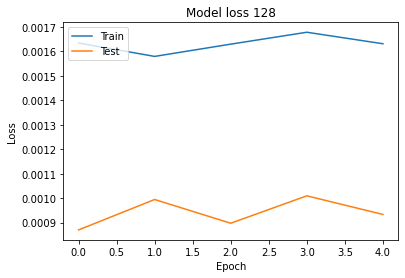

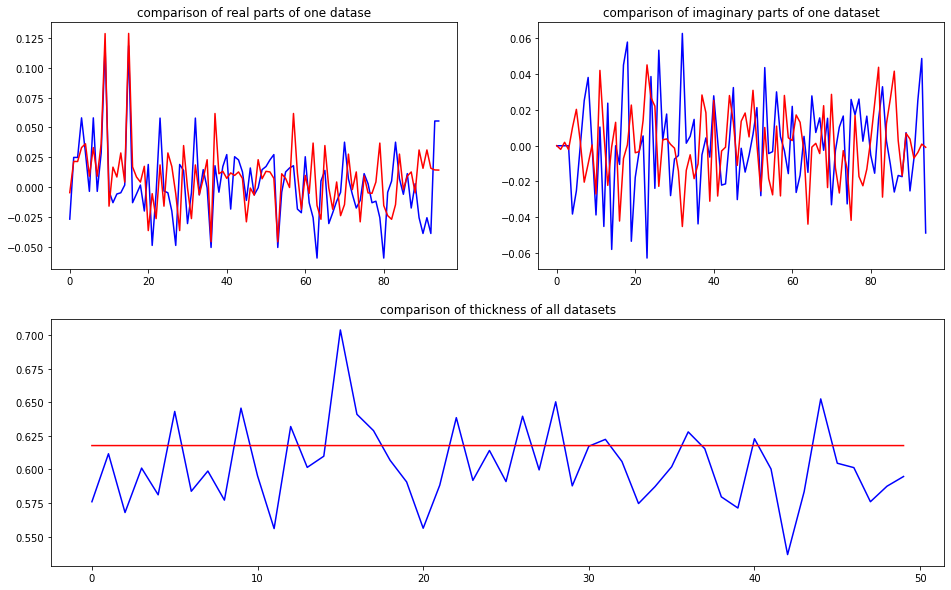

predicted thickness: 0.6177718


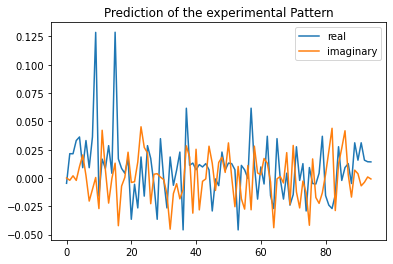

Applied shift of unit cell origin (fractional coordinates): 0.00783394545465541 0.010316457618396507 0.014689901071341875
Ug[ 0 ]: 0.00468 3.14159  =>  0.00468 3.14159
Ug[ 1 ]: 0.02153 -0.0923  =>  0.02153 0.0
Ug[ 2 ]: 0.02153 0.0923  =>  0.02153 -0.0
Ug[ 3 ]: 0.03315 -0.06482  =>  0.03315 0.0
Ug[ 4 ]: 0.03762 0.27156  =>  0.03762 0.42868
Ug[ 5 ]: 0.0223 1.1508  =>  0.0223 1.12332
Ug[ 6 ]: 0.03315 0.06482  =>  0.03315 0.0
Ug[ 7 ]: 0.0223 -1.1508  =>  0.0223 -1.12332
Ug[ 8 ]: 0.03762 -0.27156  =>  0.03762 -0.42868
Ug[ 9 ]: 0.1288 -0.04922  =>  0.1288 -0.0
Ug[ 10 ]: 0.03139 -2.10567  =>  0.03139 -1.96414
Ug[ 11 ]: 0.04536 1.19157  =>  0.04536 1.1485
Ug[ 12 ]: 0.01107 0.7034  =>  0.01107 0.6878
Ug[ 13 ]: 0.03616 -0.65944  =>  0.03616 -0.58274
Ug[ 14 ]: 0.0042 -0.12363  =>  0.0042 -0.23153
Ug[ 15 ]: 0.1288 0.04922  =>  0.1288 0.0
Ug[ 16 ]: 0.04536 -1.19157  =>  0.04536 -1.1485
Ug[ 17 ]: 0.01107 -0.7034  =>  0.01107 -0.6878
Ug[ 18 ]: 0.0042 0.12363  =>  0.0042 0.23153
Ug[ 19 ]: 0.02858 0.91

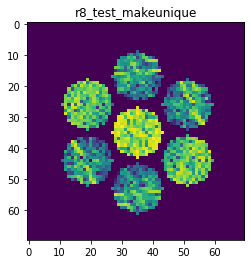

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8258340343141111
>>>replaced the 129. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 747ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.4099e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.3233e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 8.1047e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.7224e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0017 - acc: 1.0000 - val_loss: 9.7393e-04 - val_acc: 1.0000


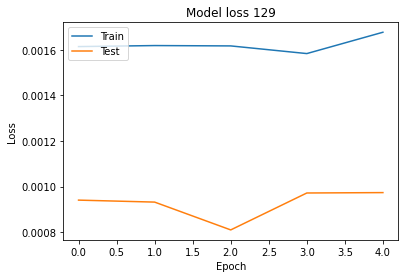

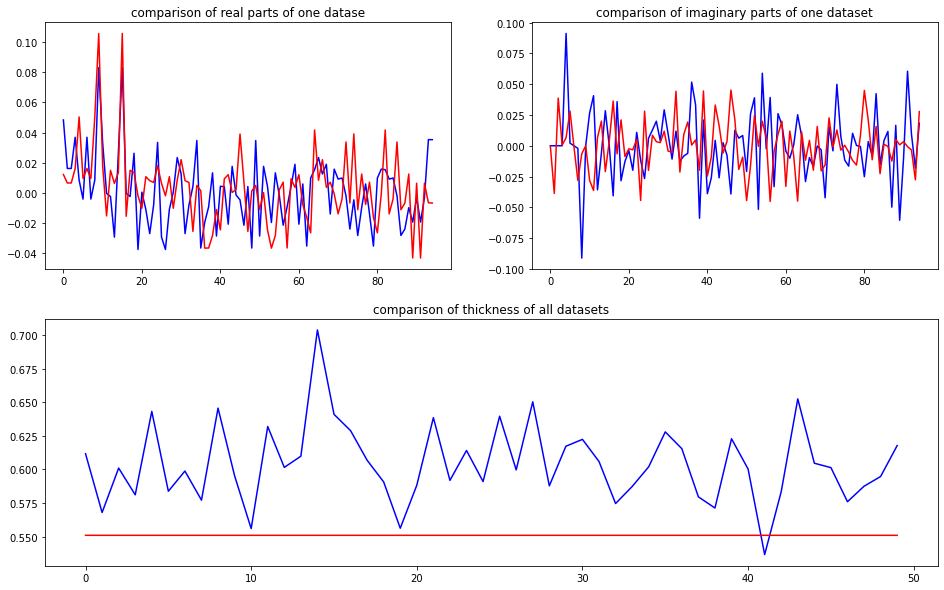

predicted thickness: 0.55093473


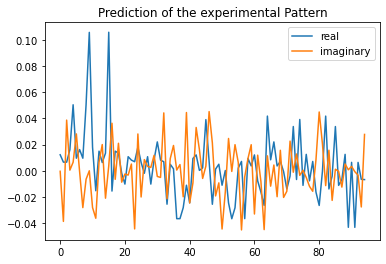

Applied shift of unit cell origin (fractional coordinates): 0.002735700718881408 -0.005200706053943386 0.22319887946930522
Ug[ 0 ]: 0.01221 0.0  =>  0.01221 0.0
Ug[ 1 ]: 0.03926 -1.4024  =>  0.03926 0.0
Ug[ 2 ]: 0.03926 1.4024  =>  0.03926 -0.0
Ug[ 3 ]: 0.01616 0.03268  =>  0.01616 0.0
Ug[ 4 ]: 0.05083 0.1283  =>  0.05083 1.49802
Ug[ 5 ]: 0.02975 1.24267  =>  0.02975 -0.1924
Ug[ 6 ]: 0.01616 -0.03268  =>  0.01616 0.0
Ug[ 7 ]: 0.02975 -1.24267  =>  0.02975 0.1924
Ug[ 8 ]: 0.05083 -0.1283  =>  0.05083 -1.49802
Ug[ 9 ]: 0.10581 -0.01719  =>  0.10581 0.0
Ug[ 10 ]: 0.03337 -1.00134  =>  0.03337 0.41824
Ug[ 11 ]: 0.03943 -1.97215  =>  0.03943 2.92582
Ug[ 12 ]: 0.01634 0.4122  =>  0.01634 0.46207
Ug[ 13 ]: 0.021 1.26534  =>  0.021 2.7176
Ug[ 14 ]: 0.02494 -0.99968  =>  0.02494 -2.35221
Ug[ 15 ]: 0.10581 0.01719  =>  0.10581 0.0
Ug[ 16 ]: 0.03943 1.97215  =>  0.03943 -2.92582
Ug[ 17 ]: 0.01634 -0.4122  =>  0.01634 -0.46207
Ug[ 18 ]: 0.02494 0.99968  =>  0.02494 2.35221
Ug[ 19 ]: 0.00883 -1.788

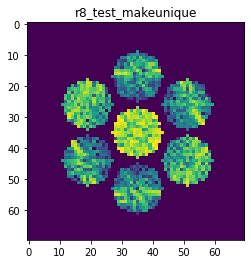

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9241791376889062
>>>replaced the 130. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 830ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.9425e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 738ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.8713e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 7.7235e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 8.8722e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 8.0883e-04 - val_acc: 1.0000


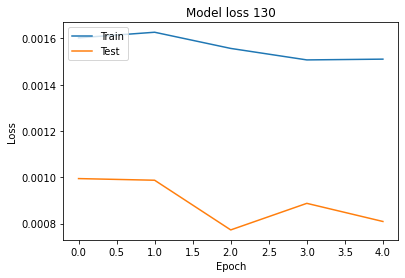

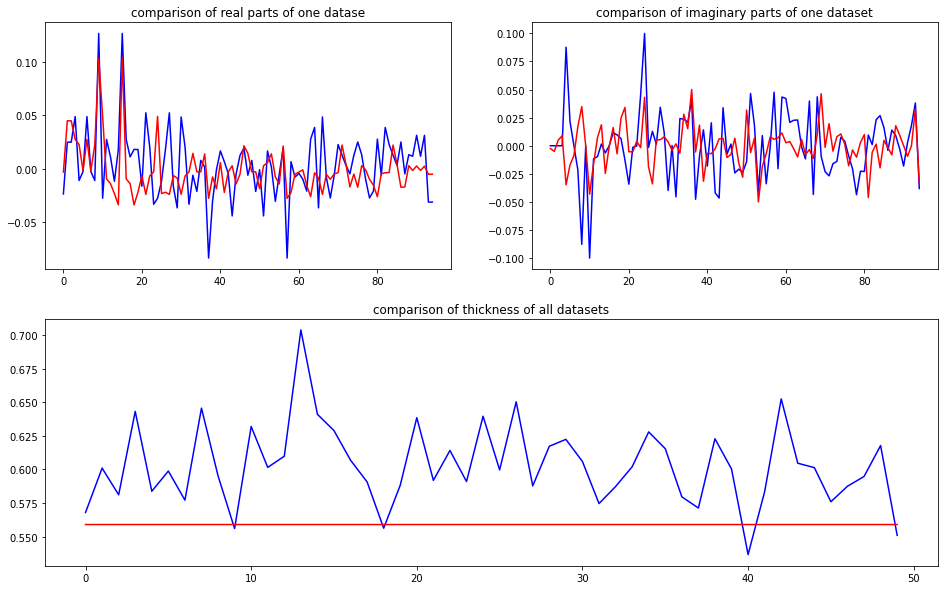

predicted thickness: 0.55896735


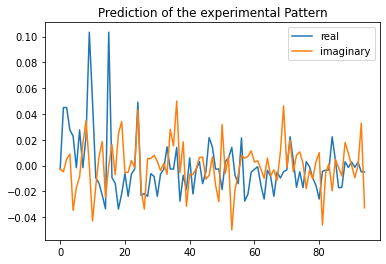

Applied shift of unit cell origin (fractional coordinates): -0.0002774136776842321 -0.04928631109533845 0.01763015977569879
Ug[ 0 ]: 0.003 3.14159  =>  0.003 3.14159
Ug[ 1 ]: 0.04526 -0.11077  =>  0.04526 0.0
Ug[ 2 ]: 0.04526 0.11077  =>  0.04526 0.0
Ug[ 3 ]: 0.02896 0.30968  =>  0.02896 0.0
Ug[ 4 ]: 0.04156 -0.99098  =>  0.04156 -1.18988
Ug[ 5 ]: 0.01713 -1.67076  =>  0.01713 -2.09121
Ug[ 6 ]: 0.02896 -0.30968  =>  0.02896 0.0
Ug[ 7 ]: 0.01713 1.67076  =>  0.01713 2.09121
Ug[ 8 ]: 0.04156 0.99098  =>  0.04156 1.18988
Ug[ 9 ]: 0.10333 0.00174  =>  0.10333 -0.0
Ug[ 10 ]: 0.06534 -0.71968  =>  0.06534 -0.61065
Ug[ 11 ]: 0.01873 -2.09809  =>  0.01873 -2.21061
Ug[ 12 ]: 0.01555 2.66401  =>  0.01555 2.97194
Ug[ 13 ]: 0.0297 2.46168  =>  0.0297 2.88038
Ug[ 14 ]: 0.04173 -2.50983  =>  0.04173 -2.31267
Ug[ 15 ]: 0.10333 -0.00174  =>  0.10333 0.0
Ug[ 16 ]: 0.01873 2.09809  =>  0.01873 2.21061
Ug[ 17 ]: 0.01555 -2.66401  =>  0.01555 -2.97194
Ug[ 18 ]: 0.04173 2.50983  =>  0.04173 2.31267
Ug[ 19 

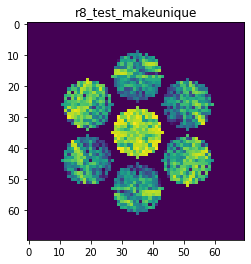

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9415267767628549
>>>replaced the 131. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 752ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 8.5830e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 9.1105e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.4645e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0016 - acc: 1.0000 - val_loss: 9.3275e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 8.4224e-04 - val_acc: 1.0000


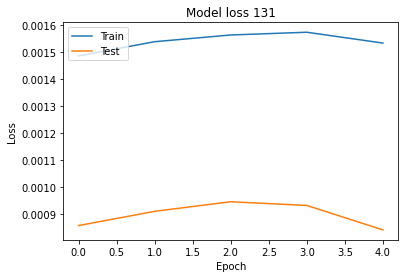

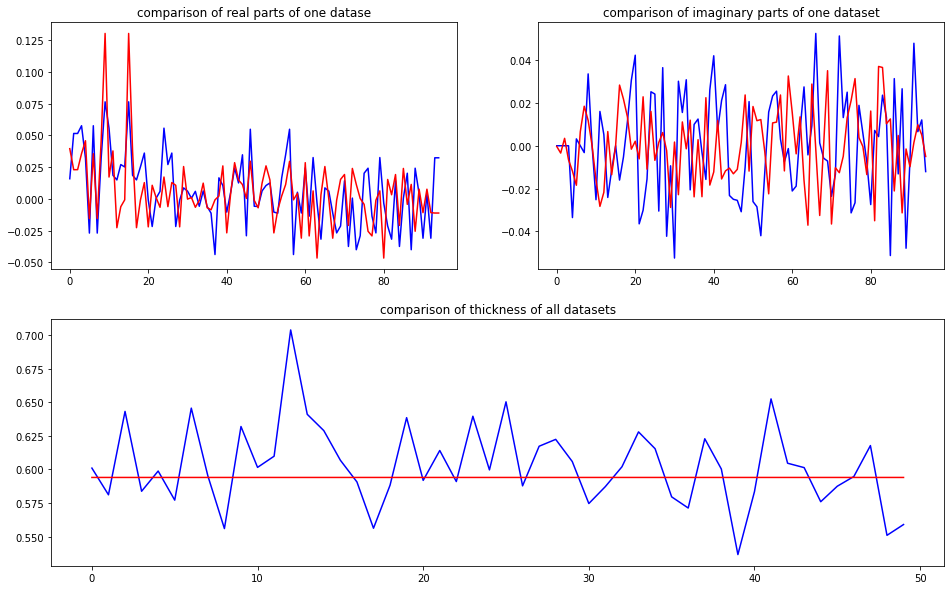

predicted thickness: 0.5940346


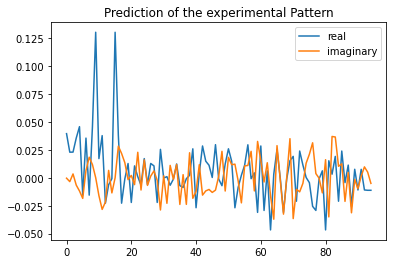

Applied shift of unit cell origin (fractional coordinates): -8.072561464429485e-05 0.028994495329504363 0.02364407010932515
Ug[ 0 ]: 0.03961 0.0  =>  0.03961 0.0
Ug[ 1 ]: 0.02326 -0.14856  =>  0.02326 0.0
Ug[ 2 ]: 0.02326 0.14856  =>  0.02326 0.0
Ug[ 3 ]: 0.03626 -0.18218  =>  0.03626 0.0
Ug[ 4 ]: 0.04737 -0.25267  =>  0.04737 0.07807
Ug[ 5 ]: 0.02415 -2.2705  =>  0.02415 -2.23689
Ug[ 6 ]: 0.03626 0.18218  =>  0.03626 0.0
Ug[ 7 ]: 0.02415 2.2705  =>  0.02415 2.23689
Ug[ 8 ]: 0.04737 0.25267  =>  0.04737 -0.07807
Ug[ 9 ]: 0.13055 0.00051  =>  0.13055 0.0
Ug[ 10 ]: 0.02353 -0.75001  =>  0.02353 -0.60196
Ug[ 11 ]: 0.04733 -0.64235  =>  0.04733 -0.79142
Ug[ 12 ]: 0.03153 -2.37851  =>  0.03153 -2.56119
Ug[ 13 ]: 0.00913 2.31336  =>  0.00913 2.27924
Ug[ 14 ]: 0.01358 -1.6345  =>  0.01358 -1.96575
Ug[ 15 ]: 0.13055 -0.00051  =>  0.13055 0.0
Ug[ 16 ]: 0.04733 0.64235  =>  0.04733 0.79142
Ug[ 17 ]: 0.03153 2.37851  =>  0.03153 2.56119
Ug[ 18 ]: 0.01358 1.6345  =>  0.01358 1.96575
Ug[ 19 ]: 0.01

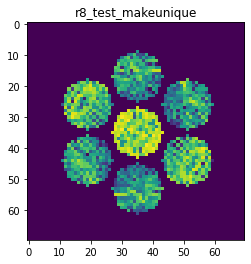

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8831938393542584
>>>replaced the 132. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 761ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 8.8218e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.1207e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 7.9725e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.9095e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 724ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 9.5360e-04 - val_acc: 1.0000


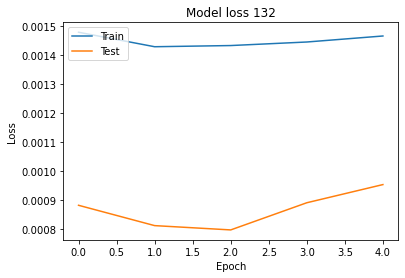

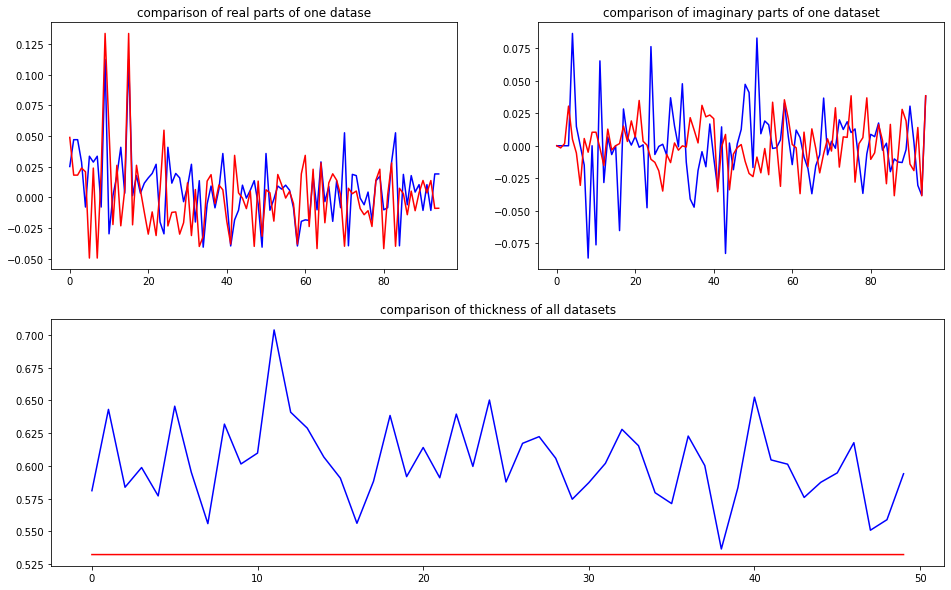

predicted thickness: 0.53233117


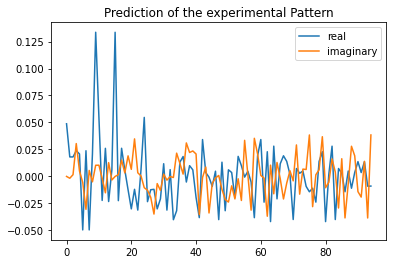

Applied shift of unit cell origin (fractional coordinates): -0.00618013890214612 -0.14424365806992553 0.014495696666692882
Ug[ 0 ]: 0.04882 0.0  =>  0.04882 0.0
Ug[ 1 ]: 0.01816 -0.09108  =>  0.01816 0.0
Ug[ 2 ]: 0.01816 0.09108  =>  0.01816 0.0
Ug[ 3 ]: 0.03869 0.90631  =>  0.03869 -0.0
Ug[ 4 ]: 0.02143 0.23447  =>  0.02143 -0.58076
Ug[ 5 ]: 0.04983 -3.02998  =>  0.04983 2.25581
Ug[ 6 ]: 0.03869 -0.90631  =>  0.03869 0.0
Ug[ 7 ]: 0.04983 3.02998  =>  0.04983 -2.25581
Ug[ 8 ]: 0.02143 -0.23447  =>  0.02143 0.58076
Ug[ 9 ]: 0.13367 0.03883  =>  0.13367 0.0
Ug[ 10 ]: 0.0557 0.18808  =>  0.0557 0.24033
Ug[ 11 ]: 0.02238 -3.06674  =>  0.02238 3.08654
Ug[ 12 ]: 0.03016 -0.52582  =>  0.03016 0.34166
Ug[ 13 ]: 0.02657 2.63969  =>  0.02657 -2.68494
Ug[ 14 ]: 0.00679 -0.50356  =>  0.00679 0.27284
Ug[ 15 ]: 0.13367 -0.03883  =>  0.13367 0.0
Ug[ 16 ]: 0.02238 3.06674  =>  0.02238 -3.08654
Ug[ 17 ]: 0.03016 0.52582  =>  0.03016 -0.34166
Ug[ 18 ]: 0.00679 0.50356  =>  0.00679 -0.27284
Ug[ 19 ]: 0.0

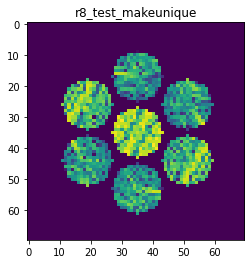

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9429051505692364
>>>replaced the 133. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 755ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 7.1649e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 7.5591e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.6605e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.4152e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0015 - acc: 1.0000 - val_loss: 8.8747e-04 - val_acc: 1.0000


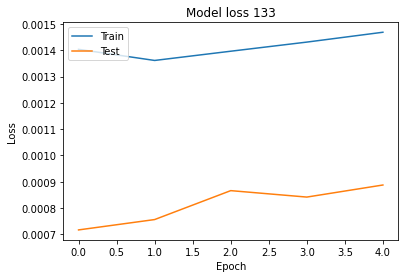

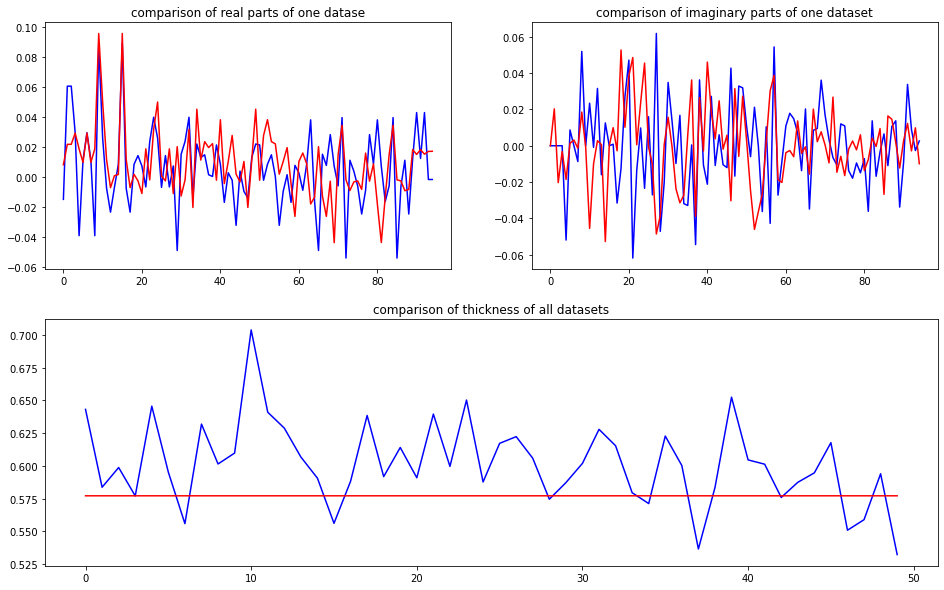

predicted thickness: 0.57720506


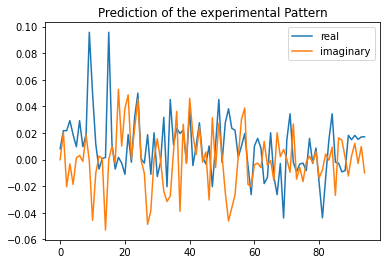

Applied shift of unit cell origin (fractional coordinates): 0.0007963575726915621 0.01705469161715515 -0.11946980685613665
Ug[ 0 ]: 0.0082 0.0  =>  0.0082 0.0
Ug[ 1 ]: 0.0298 0.75065  =>  0.0298 0.0
Ug[ 2 ]: 0.0298 -0.75065  =>  0.0298 -0.0
Ug[ 3 ]: 0.02949 -0.10716  =>  0.02949 0.0
Ug[ 4 ]: 0.02639 -0.78103  =>  0.02639 -1.42453
Ug[ 5 ]: 0.00982 0.14127  =>  0.00982 0.99908
Ug[ 6 ]: 0.02949 0.10716  =>  0.02949 0.0
Ug[ 7 ]: 0.00982 -0.14127  =>  0.00982 -0.99908
Ug[ 8 ]: 0.02639 0.78103  =>  0.02639 1.42453
Ug[ 9 ]: 0.09576 -0.005  =>  0.09576 -0.0
Ug[ 10 ]: 0.06767 -0.73906  =>  0.06767 -1.48471
Ug[ 11 ]: 0.01532 -0.70913  =>  0.01532 0.04653
Ug[ 12 ]: 0.00761 2.7686  =>  0.00761 2.66644
Ug[ 13 ]: 0.00101 0.69585  =>  0.00101 -0.15695
Ug[ 14 ]: 0.05284 -1.53854  =>  0.05284 -0.89004
Ug[ 15 ]: 0.09576 0.005  =>  0.09576 0.0
Ug[ 16 ]: 0.01532 0.70913  =>  0.01532 -0.04653
Ug[ 17 ]: 0.00761 -2.7686  =>  0.00761 -2.66644
Ug[ 18 ]: 0.05284 1.53854  =>  0.05284 0.89004
Ug[ 19 ]: 0.01056 1.

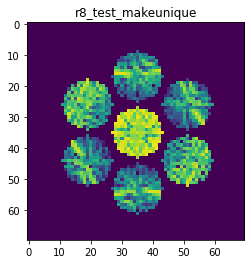

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9268700353404791
>>>replaced the 134. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 753ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.1830e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.8248e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.1634e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 8.8220e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.3859e-04 - val_acc: 1.0000


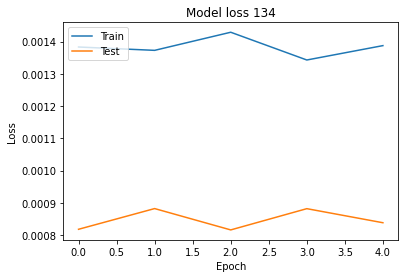

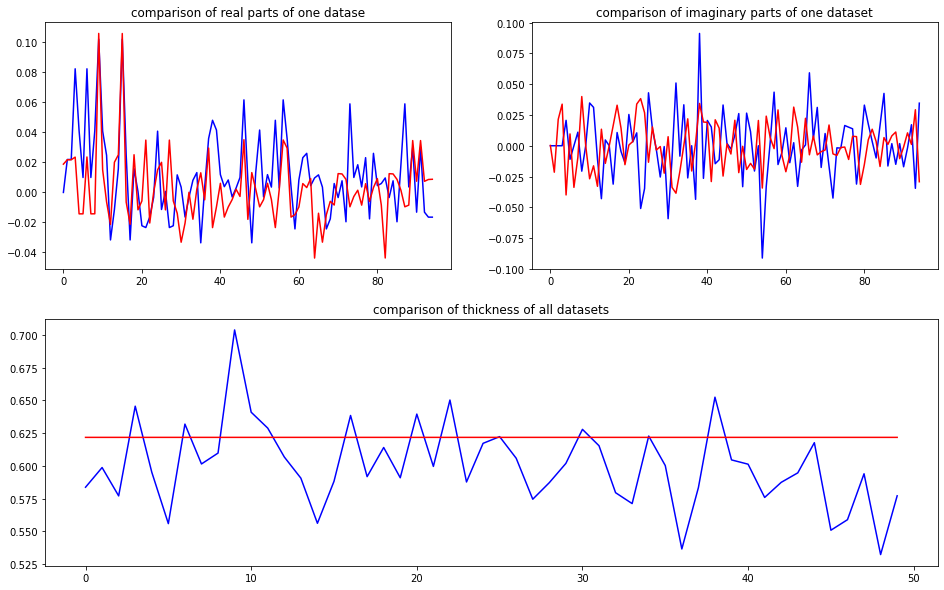

predicted thickness: 0.62183875


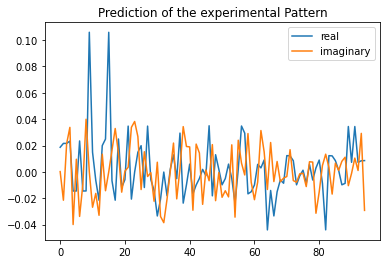

Applied shift of unit cell origin (fractional coordinates): -4.577003158661892e-05 -0.15351004937339596 0.12441908362430822
Ug[ 0 ]: 0.01866 0.0  =>  0.01866 0.0
Ug[ 1 ]: 0.03044 -0.78175  =>  0.03044 0.0
Ug[ 2 ]: 0.03044 0.78175  =>  0.03044 0.0
Ug[ 3 ]: 0.04108 0.96453  =>  0.04108 0.0
Ug[ 4 ]: 0.04247 -1.91893  =>  0.04247 -2.10172
Ug[ 5 ]: 0.01739 2.55656  =>  0.01739 0.81028
Ug[ 6 ]: 0.04108 -0.96453  =>  0.04108 -0.0
Ug[ 7 ]: 0.01739 -2.55656  =>  0.01739 -0.81028
Ug[ 8 ]: 0.04247 1.91893  =>  0.04247 2.10172
Ug[ 9 ]: 0.10588 0.00029  =>  0.10588 -0.0
Ug[ 10 ]: 0.03066 -1.06378  =>  0.03066 -0.28232
Ug[ 11 ]: 0.01758 -1.95376  =>  0.01758 -2.7358
Ug[ 12 ]: 0.03932 -2.14958  =>  0.03932 -1.18534
Ug[ 13 ]: 0.024 0.59261  =>  0.024 2.3386
Ug[ 14 ]: 0.02872 -0.52059  =>  0.02872 -0.33809
Ug[ 15 ]: 0.10588 -0.00029  =>  0.10588 0.0
Ug[ 16 ]: 0.01758 1.95376  =>  0.01758 2.7358
Ug[ 17 ]: 0.03932 2.14958  =>  0.03932 1.18534
Ug[ 18 ]: 0.02872 0.52059  =>  0.02872 0.33809
Ug[ 19 ]: 0.019

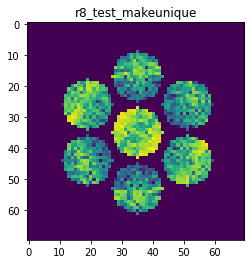

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.965636553968052
>>>replaced the 135. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 757ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.8841e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 729ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 7.9363e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 724ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.1751e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.0093e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 8.3084e-04 - val_acc: 1.0000


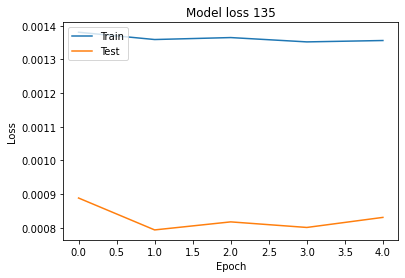

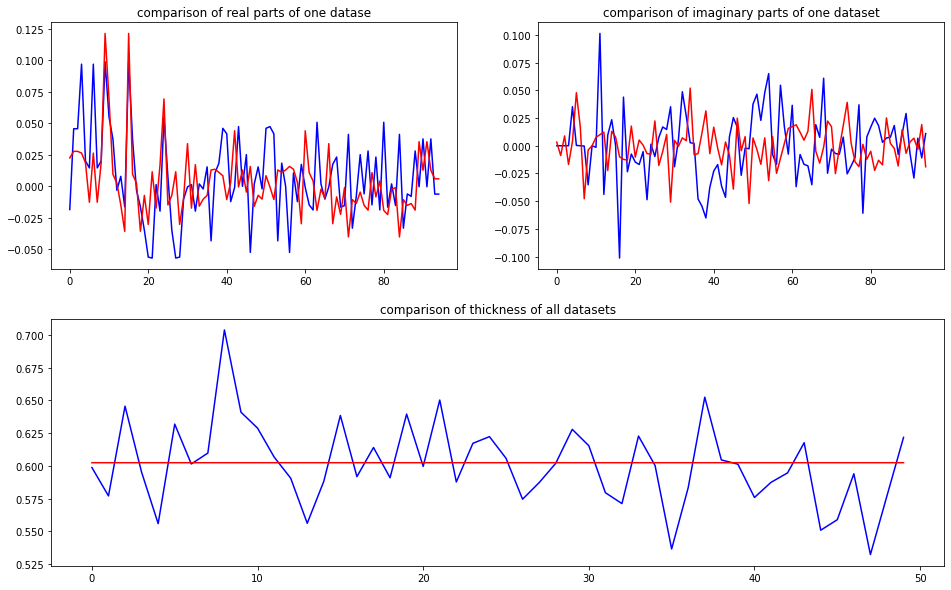

predicted thickness: 0.6024909


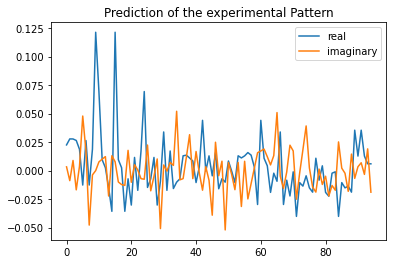

Applied shift of unit cell origin (fractional coordinates): 0.005088519029702528 0.09066369440234016 0.0491194153278559
Ug[ 0 ]: 0.02251 0.0  =>  0.02251 0.0
Ug[ 1 ]: 0.02912 -0.30863  =>  0.02912 0.0
Ug[ 2 ]: 0.02912 0.30863  =>  0.02912 0.0
Ug[ 3 ]: 0.03132 -0.56966  =>  0.03132 0.0
Ug[ 4 ]: 0.01909 0.2018  =>  0.01909 1.08008
Ug[ 5 ]: 0.04948 1.8303  =>  0.04948 2.09133
Ug[ 6 ]: 0.03132 0.56966  =>  0.03132 0.0
Ug[ 7 ]: 0.04948 -1.8303  =>  0.04948 -2.09133
Ug[ 8 ]: 0.01909 -0.2018  =>  0.01909 -1.08008
Ug[ 9 ]: 0.12138 -0.03197  =>  0.12138 0.0
Ug[ 10 ]: 0.06972 0.10908  =>  0.06972 0.44968
Ug[ 11 ]: 0.01382 0.80931  =>  0.01382 0.53265
Ug[ 12 ]: 0.01251 1.37051  =>  0.01251 0.83282
Ug[ 13 ]: 0.02681 -2.15582  =>  0.02681 -2.38488
Ug[ 14 ]: 0.03803 2.79265  =>  0.03803 1.94634
Ug[ 15 ]: 0.12138 0.03197  =>  0.12138 -0.0
Ug[ 16 ]: 0.01382 -0.80931  =>  0.01382 -0.53265
Ug[ 17 ]: 0.01251 -1.37051  =>  0.01251 -0.83282
Ug[ 18 ]: 0.03803 -2.79265  =>  0.03803 -1.94634
Ug[ 19 ]: 0.01916

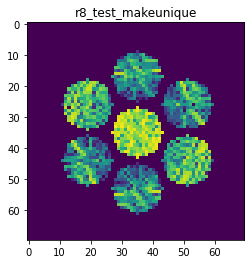

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9374414776446048
>>>replaced the 136. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 761ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 7.6005e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 8.2902e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 7.1744e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 8.1233e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 735ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 7.5004e-04 - val_acc: 1.0000


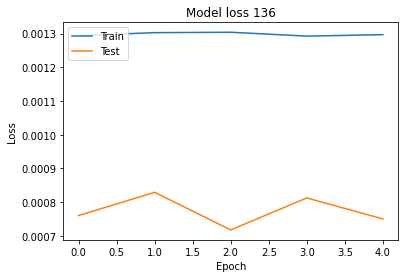

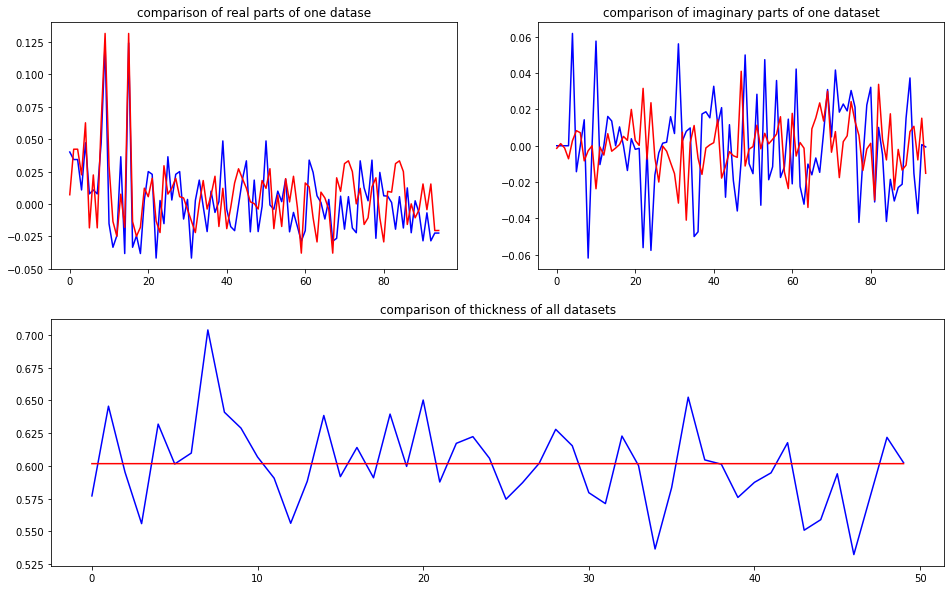

predicted thickness: 0.6017636


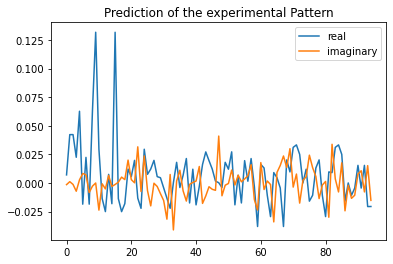

Applied shift of unit cell origin (fractional coordinates): -0.0007776755034091222 0.049292074198223304 -0.004496393379850945
Ug[ 0 ]: 0.0071 0.0  =>  0.0071 0.0
Ug[ 1 ]: 0.04229 0.02825  =>  0.04229 -0.0
Ug[ 2 ]: 0.04229 -0.02825  =>  0.04229 0.0
Ug[ 3 ]: 0.02355 -0.30971  =>  0.02355 0.0
Ug[ 4 ]: 0.06277 0.04393  =>  0.06277 0.32539
Ug[ 5 ]: 0.02027 2.71931  =>  0.02027 3.05728
Ug[ 6 ]: 0.02355 0.30971  =>  0.02355 0.0
Ug[ 7 ]: 0.02027 -2.71931  =>  0.02027 -3.05728
Ug[ 8 ]: 0.06277 -0.04393  =>  0.06277 -0.32539
Ug[ 9 ]: 0.13169 0.00489  =>  0.13169 0.0
Ug[ 10 ]: 0.03783 -0.67645  =>  0.03783 -0.70959
Ug[ 11 ]: 0.01364 -3.09126  =>  0.01364 -3.06789
Ug[ 12 ]: 0.02552 -2.93878  =>  0.02552 3.02981
Ug[ 13 ]: 0.01006 0.71914  =>  0.01006 0.3763
Ug[ 14 ]: 0.0183 -2.97695  =>  0.0183 3.01989
Ug[ 15 ]: 0.13169 -0.00489  =>  0.13169 -0.0
Ug[ 16 ]: 0.01364 3.09126  =>  0.01364 3.06789
Ug[ 17 ]: 0.02552 2.93878  =>  0.02552 -3.02981
Ug[ 18 ]: 0.0183 2.97695  =>  0.0183 -3.01989
Ug[ 19 ]: 0.0

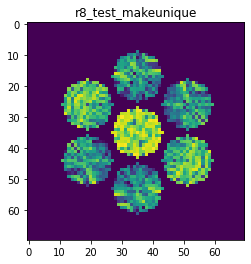

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9133594927872378
>>>replaced the 137. dataset and train: 
Epoch 1/5
8/8 [==============================] - 8s 787ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 7.6067e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 743ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 8.0149e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 746ms/step - loss: 0.0013 - acc: 1.0000 - val_loss: 7.6864e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 744ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.6319e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.5920e-04 - val_acc: 1.0000


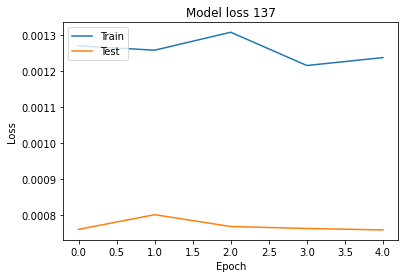

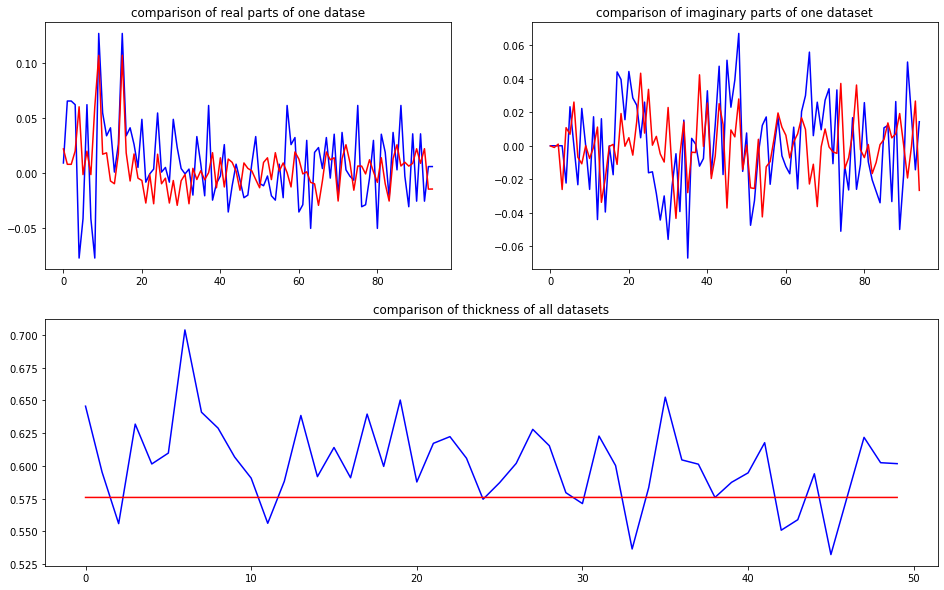

predicted thickness: 0.5759608


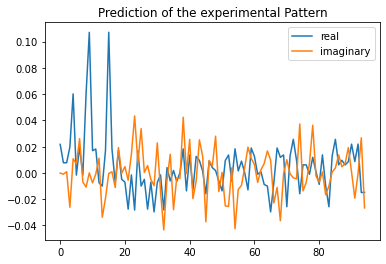

Applied shift of unit cell origin (fractional coordinates): -0.00033928987734400755 0.1470378116917176 0.02050535065193418
Ug[ 0 ]: 0.02174 0.0  =>  0.02174 0.0
Ug[ 1 ]: 0.0078 -0.12884  =>  0.0078 0.0
Ug[ 2 ]: 0.0078 0.12884  =>  0.0078 0.0
Ug[ 3 ]: 0.03276 -0.92387  =>  0.03276 0.0
Ug[ 4 ]: 0.06116 0.17756  =>  0.06116 1.23026
Ug[ 5 ]: 0.00707 1.80703  =>  0.00707 2.60205
Ug[ 6 ]: 0.03276 0.92387  =>  0.03276 0.0
Ug[ 7 ]: 0.00707 -1.80703  =>  0.00707 -2.60205
Ug[ 8 ]: 0.06116 -0.17756  =>  0.06116 -1.23026
Ug[ 9 ]: 0.10712 0.00213  =>  0.10712 0.0
Ug[ 10 ]: 0.01856 -0.42069  =>  0.01856 -0.29398
Ug[ 11 ]: 0.01819 -0.04538  =>  0.01819 -0.17636
Ug[ 12 ]: 0.01343 2.16108  =>  0.01343 1.23508
Ug[ 13 ]: 0.03523 -1.85864  =>  0.03523 -2.6558
Ug[ 14 ]: 0.02582 -0.84317  =>  0.02582 -1.89801
Ug[ 15 ]: 0.10712 -0.00213  =>  0.10712 0.0
Ug[ 16 ]: 0.01819 0.04538  =>  0.01819 0.17636
Ug[ 17 ]: 0.01343 -2.16108  =>  0.01343 -1.23508
Ug[ 18 ]: 0.02582 0.84317  =>  0.02582 1.89801
Ug[ 19 ]: 0.00

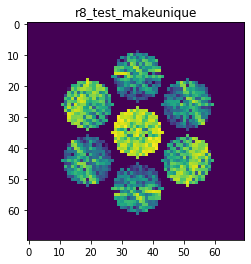

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8964288828760779
>>>replaced the 138. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 739ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.3306e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.3521e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.9600e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 722ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.8983e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 720ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.4312e-04 - val_acc: 1.0000


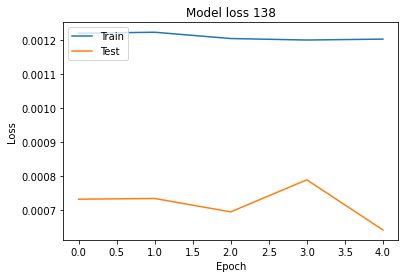

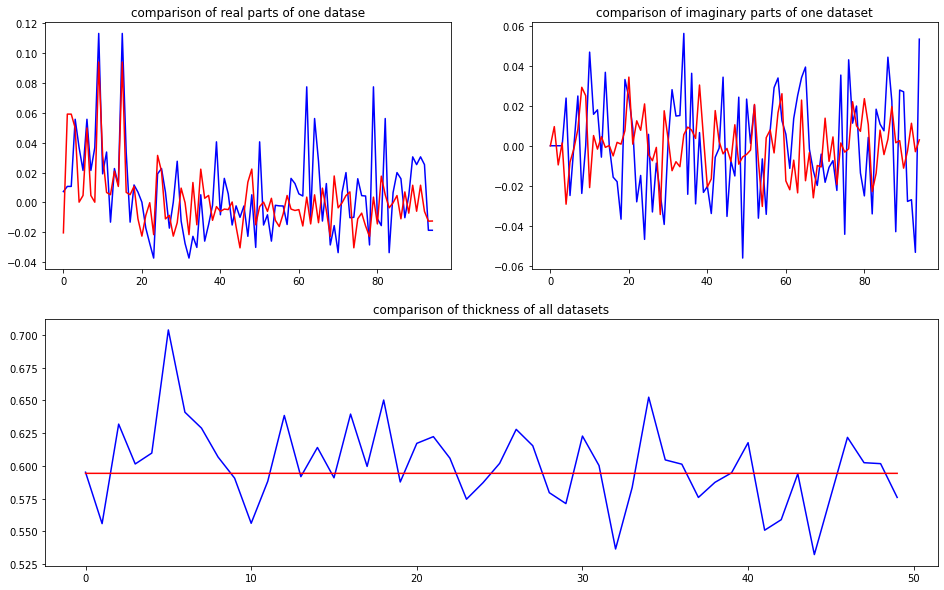

predicted thickness: 0.5943612


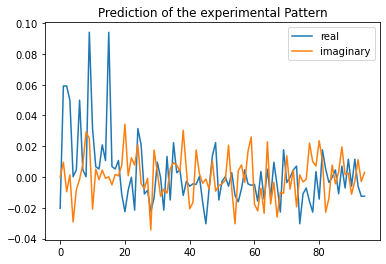

Applied shift of unit cell origin (fractional coordinates): -0.020970456853165825 -0.004500502045503341 -0.025536978115204927
Ug[ 0 ]: 0.02035 3.14159  =>  0.02035 3.14159
Ug[ 1 ]: 0.05995 0.16045  =>  0.05995 0.0
Ug[ 2 ]: 0.05995 -0.16045  =>  0.05995 0.0
Ug[ 3 ]: 0.0499 0.02828  =>  0.0499 0.0
Ug[ 4 ]: 0.02924 -1.56429  =>  0.02924 -1.75302
Ug[ 5 ]: 0.00943 -1.05412  =>  0.00943 -0.92195
Ug[ 6 ]: 0.0499 -0.02828  =>  0.0499 -0.0
Ug[ 7 ]: 0.00943 1.05412  =>  0.00943 0.92195
Ug[ 8 ]: 0.02924 1.56429  =>  0.02924 1.75302
Ug[ 9 ]: 0.09489 0.13176  =>  0.09489 -0.0
Ug[ 10 ]: 0.03782 -0.58612  =>  0.03782 -0.87833
Ug[ 11 ]: 0.00842 0.6489  =>  0.00842 0.67759
Ug[ 12 ]: 0.00549 -0.31408  =>  0.00549 -0.41757
Ug[ 13 ]: 0.02133 0.21065  =>  0.02133 -0.05329
Ug[ 14 ]: 0.01078 -0.07394  =>  0.01078 -0.01697
Ug[ 15 ]: 0.09489 -0.13176  =>  0.09489 0.0
Ug[ 16 ]: 0.00842 -0.6489  =>  0.00842 -0.67759
Ug[ 17 ]: 0.00549 0.31408  =>  0.00549 0.41757
Ug[ 18 ]: 0.01078 0.07394  =>  0.01078 0.01697
Ug[

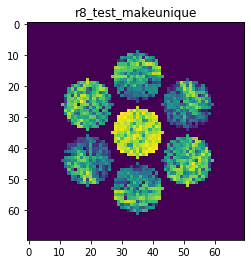

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9037161555271743
>>>replaced the 139. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 758ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 7.0617e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.9394e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.8398e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 8.0144e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.8319e-04 - val_acc: 1.0000


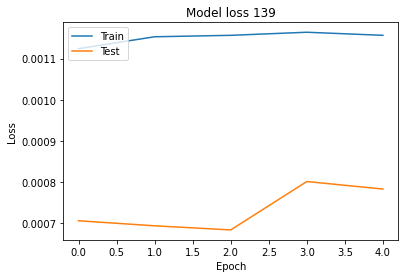

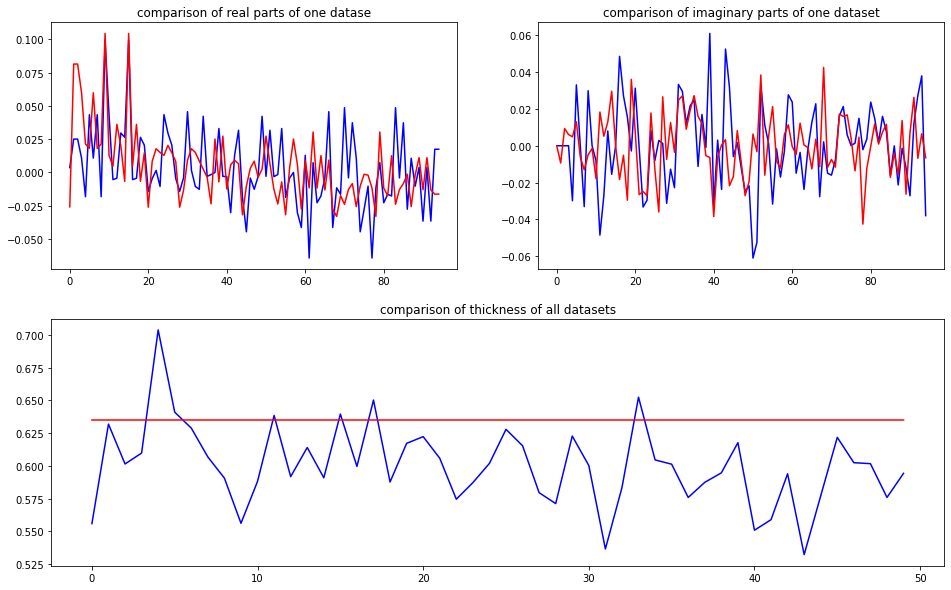

predicted thickness: 0.63510406


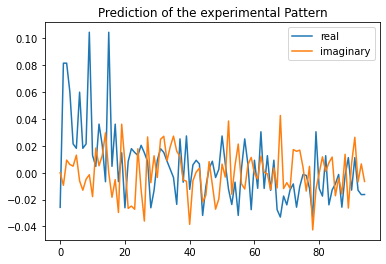

Applied shift of unit cell origin (fractional coordinates): 0.0011539503594240345 -0.01613596085150234 0.018232756544867283
Ug[ 0 ]: 0.02578 3.14159  =>  0.02578 3.14159
Ug[ 1 ]: 0.08199 -0.11456  =>  0.08199 0.0
Ug[ 2 ]: 0.08199 0.11456  =>  0.08199 0.0
Ug[ 3 ]: 0.06019 0.10139  =>  0.06019 0.0
Ug[ 4 ]: 0.02193 0.22364  =>  0.02193 0.23682
Ug[ 5 ]: 0.02233 0.62261  =>  0.02233 0.40666
Ug[ 6 ]: 0.06019 -0.10139  =>  0.06019 -0.0
Ug[ 7 ]: 0.02233 -0.62261  =>  0.02233 -0.40666
Ug[ 8 ]: 0.02193 -0.22364  =>  0.02193 -0.23682
Ug[ 9 ]: 0.10445 -0.00725  =>  0.10445 0.0
Ug[ 10 ]: 0.02196 -0.94466  =>  0.02196 -0.82285
Ug[ 11 ]: 0.01891 1.3198  =>  0.01891 1.21249
Ug[ 12 ]: 0.03649 0.14184  =>  0.03649 0.25047
Ug[ 13 ]: 0.02403 0.56162  =>  0.02403 0.78481
Ug[ 14 ]: 0.03033 1.79255  =>  0.03033 1.78663
Ug[ 15 ]: 0.10445 0.00725  =>  0.10445 0.0
Ug[ 16 ]: 0.01891 -1.3198  =>  0.01891 -1.21249
Ug[ 17 ]: 0.03649 -0.14184  =>  0.03649 -0.25047
Ug[ 18 ]: 0.03033 -1.79255  =>  0.03033 -1.78663
Ug[

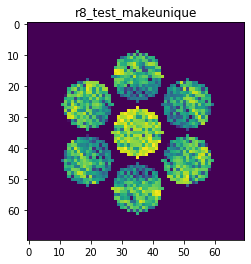

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.861237038658501
>>>replaced the 140. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 760ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.5184e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 6.5534e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 7.3976e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 725ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 8.9125e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 6.8928e-04 - val_acc: 1.0000


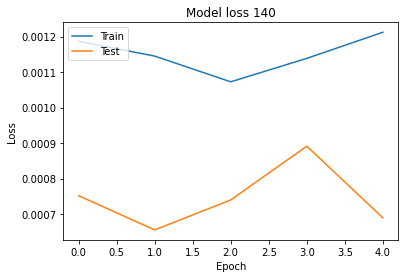

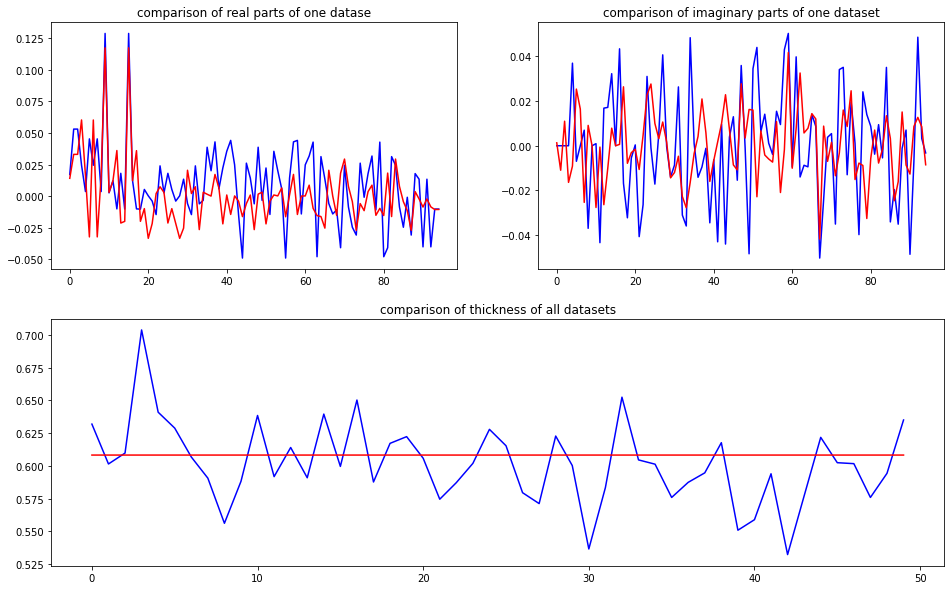

predicted thickness: 0.6083232


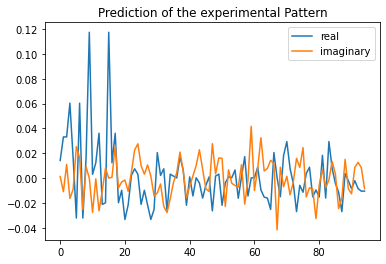

Applied shift of unit cell origin (fractional coordinates): 3.25027520192005e-05 0.0422135203496328 0.05083341546935044
Ug[ 0 ]: 0.0142 0.0  =>  0.0142 0.0
Ug[ 1 ]: 0.03493 -0.3194  =>  0.03493 0.0
Ug[ 2 ]: 0.03493 0.3194  =>  0.03493 -0.0
Ug[ 3 ]: 0.06256 -0.26524  =>  0.06256 0.0
Ug[ 4 ]: 0.01871 -0.50842  =>  0.01871 0.07621
Ug[ 5 ]: 0.04096 2.47417  =>  0.04096 2.42001
Ug[ 6 ]: 0.06256 0.26524  =>  0.06256 0.0
Ug[ 7 ]: 0.04096 -2.47417  =>  0.04096 -2.42001
Ug[ 8 ]: 0.01871 0.50842  =>  0.01871 -0.07621
Ug[ 9 ]: 0.11748 -0.0002  =>  0.11748 0.0
Ug[ 10 ]: 0.0278 -1.46039  =>  0.0278 -1.14079
Ug[ 11 ]: 0.01227 -0.04929  =>  0.01227 -0.36848
Ug[ 12 ]: 0.04475 -0.63043  =>  0.04475 -0.89546
Ug[ 13 ]: 0.02343 -2.69974  =>  0.02343 -2.64537
Ug[ 14 ]: 0.02136 2.76453  =>  0.02136 2.18011
Ug[ 15 ]: 0.11748 0.0002  =>  0.11748 -0.0
Ug[ 16 ]: 0.01227 0.04929  =>  0.01227 0.36848
Ug[ 17 ]: 0.04475 0.63043  =>  0.04475 0.89546
Ug[ 18 ]: 0.02136 -2.76453  =>  0.02136 -2.18011
Ug[ 19 ]: 0.01027 

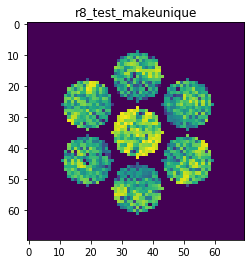

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8319267333294079
>>>replaced the 141. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 758ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 7.5996e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 736ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 7.6571e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 737ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 6.2890e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 7.4058e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 7.1499e-04 - val_acc: 1.0000


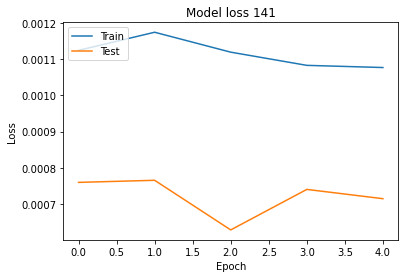

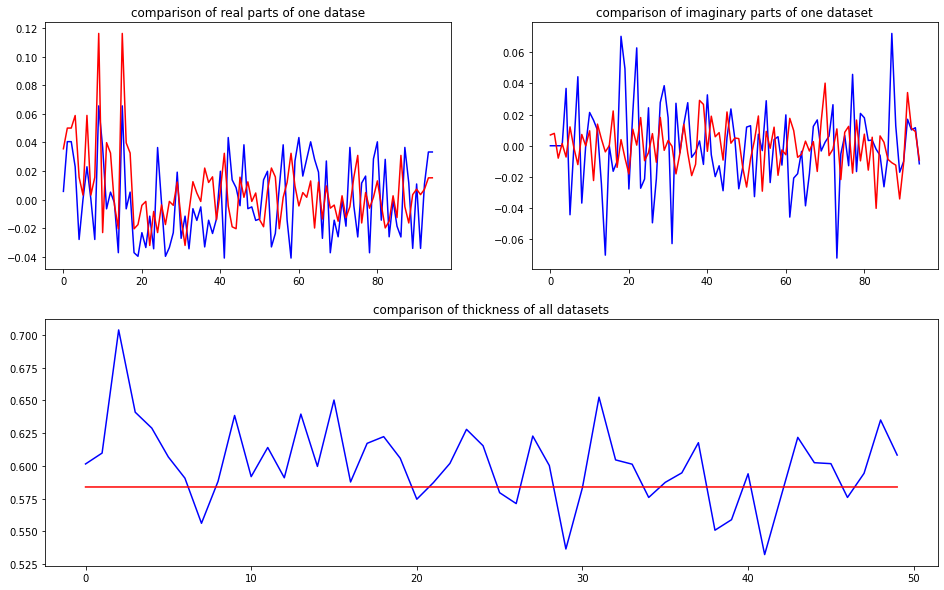

predicted thickness: 0.58395


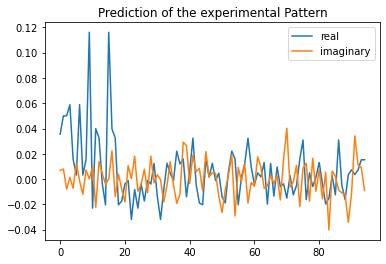

Applied shift of unit cell origin (fractional coordinates): 2.6025075205944905e-05 -0.0037792942838367418 -0.025110290629880044
Ug[ 0 ]: 0.03556 0.0  =>  0.03556 0.0
Ug[ 1 ]: 0.05066 0.15777  =>  0.05066 0.0
Ug[ 2 ]: 0.05066 -0.15777  =>  0.05066 0.0
Ug[ 3 ]: 0.05885 0.02375  =>  0.05885 0.0
Ug[ 4 ]: 0.01726 -0.43342  =>  0.01726 -0.61494
Ug[ 5 ]: 0.01253 1.31142  =>  0.01253 1.44545
Ug[ 6 ]: 0.05885 -0.02375  =>  0.05885 0.0
Ug[ 7 ]: 0.01253 -1.31142  =>  0.01253 -1.44545
Ug[ 8 ]: 0.01726 0.43342  =>  0.01726 0.61494
Ug[ 9 ]: 0.11613 -0.00016  =>  0.11613 0.0
Ug[ 10 ]: 0.02491 2.74587  =>  0.02491 2.58826
Ug[ 11 ]: 0.04562 -0.51194  =>  0.04562 -0.354
Ug[ 12 ]: 0.03542 0.40297  =>  0.03542 0.42688
Ug[ 13 ]: 0.00568 2.25131  =>  0.00568 2.11745
Ug[ 14 ]: 0.02075 -2.95091  =>  0.02075 -2.76923
Ug[ 15 ]: 0.11613 0.00016  =>  0.11613 0.0
Ug[ 16 ]: 0.04562 0.51194  =>  0.04562 0.354
Ug[ 17 ]: 0.03542 -0.40297  =>  0.03542 -0.42688
Ug[ 18 ]: 0.02075 2.95091  =>  0.02075 2.76923
Ug[ 19 ]: 0.

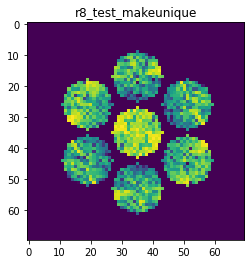

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.7344463417847747
>>>replaced the 142. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 761ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 6.9852e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 6.1887e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 726ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 6.2808e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 6.8973e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 723ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 7.1672e-04 - val_acc: 1.0000


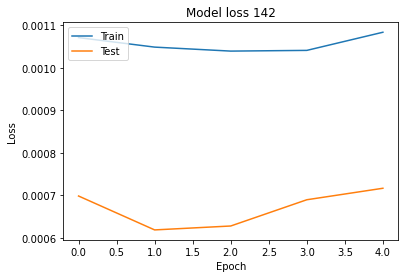

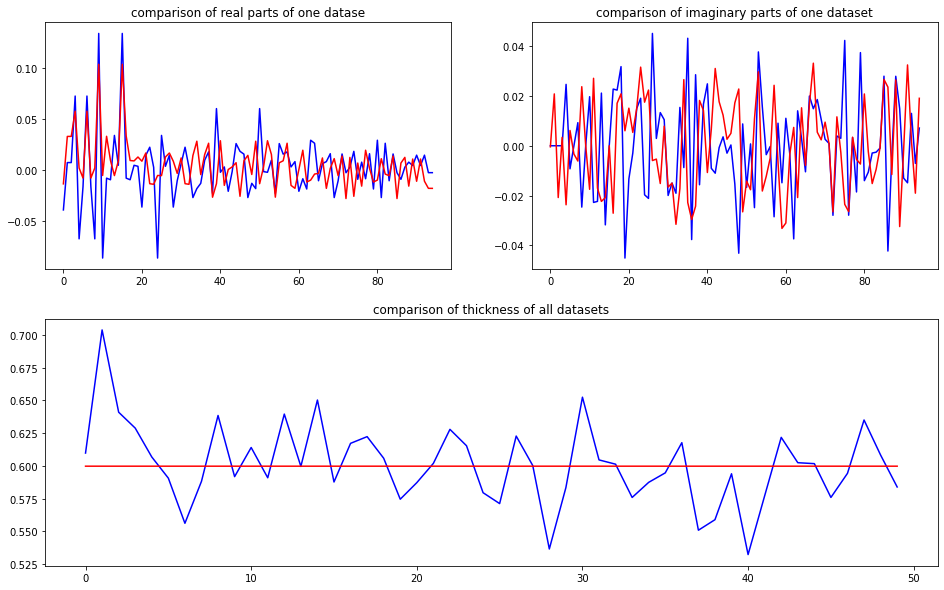

predicted thickness: 0.5998304


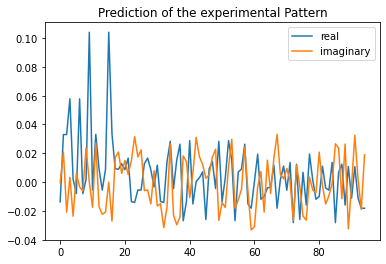

Applied shift of unit cell origin (fractional coordinates): -8.995639479054287e-06 -0.00923267396336459 -0.08948848020990278
Ug[ 0 ]: 0.01368 3.14159  =>  0.01368 3.14159
Ug[ 1 ]: 0.03903 0.56227  =>  0.03903 0.0
Ug[ 2 ]: 0.03903 -0.56227  =>  0.03903 0.0
Ug[ 3 ]: 0.05793 0.05801  =>  0.05793 0.0
Ug[ 4 ]: 0.02379 -1.48946  =>  0.02379 -2.10974
Ug[ 5 ]: 0.01005 2.48497  =>  0.01005 2.98923
Ug[ 6 ]: 0.05793 -0.05801  =>  0.05793 0.0
Ug[ 7 ]: 0.01005 -2.48497  =>  0.01005 -2.98923
Ug[ 8 ]: 0.02379 1.48946  =>  0.02379 2.10974
Ug[ 9 ]: 0.10402 6e-05  =>  0.10402 0.0
Ug[ 10 ]: 0.01832 -1.87279  =>  0.01832 -2.43511
Ug[ 11 ]: 0.04291 0.68328  =>  0.04291 1.2455
Ug[ 12 ]: 0.01943 -1.07046  =>  0.01943 -1.0125
Ug[ 13 ]: 0.02303 -1.81401  =>  0.02303 -2.31833
Ug[ 14 ]: 0.02265 -1.16866  =>  0.02265 -0.54843
Ug[ 15 ]: 0.10402 -6e-05  =>  0.10402 -0.0
Ug[ 16 ]: 0.04291 -0.68328  =>  0.04291 -1.2455
Ug[ 17 ]: 0.01943 1.07046  =>  0.01943 1.0125
Ug[ 18 ]: 0.02265 1.16866  =>  0.02265 0.54843
Ug[ 19

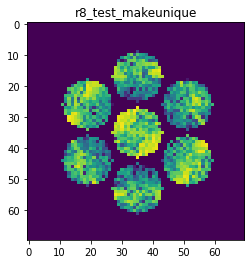

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8625441084992065
>>>replaced the 143. dataset and train: 
Epoch 1/5
8/8 [==============================] - 6s 757ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 7.2257e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 6.5880e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 733ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 7.1695e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 732ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 7.3630e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 727ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 7.7735e-04 - val_acc: 1.0000


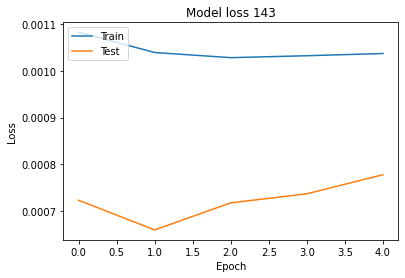

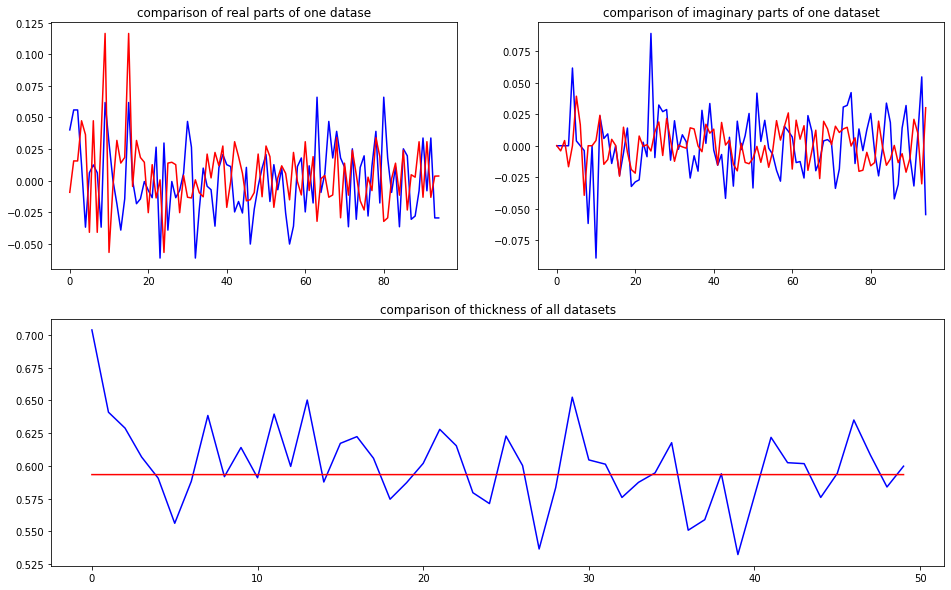

predicted thickness: 0.59339875


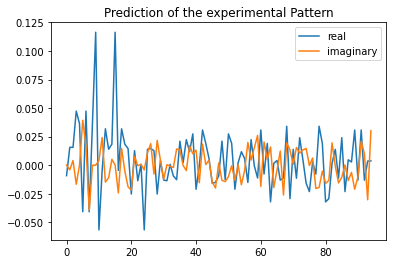

Applied shift of unit cell origin (fractional coordinates): 0.00018055697559657904 0.053910028210126075 0.04081151252846211
Ug[ 0 ]: 0.00915 3.14159  =>  0.00915 3.14159
Ug[ 1 ]: 0.01618 -0.25643  =>  0.01618 0.0
Ug[ 2 ]: 0.01618 0.25643  =>  0.01618 0.0
Ug[ 3 ]: 0.05024 -0.33873  =>  0.05024 0.0
Ug[ 4 ]: 0.03641 -0.00012  =>  0.03641 0.59503
Ug[ 5 ]: 0.05667 2.3733  =>  0.05667 2.4556
Ug[ 6 ]: 0.05024 0.33873  =>  0.05024 -0.0
Ug[ 7 ]: 0.05667 -2.3733  =>  0.05667 -2.4556
Ug[ 8 ]: 0.03641 0.00012  =>  0.03641 -0.59503
Ug[ 9 ]: 0.11638 -0.00113  =>  0.11638 0.0
Ug[ 10 ]: 0.05679 3.06797  =>  0.05679 -2.95765
Ug[ 11 ]: 0.02464 1.75489  =>  0.02464 1.49959
Ug[ 12 ]: 0.03513 -0.43347  =>  0.03513 -0.77106
Ug[ 13 ]: 0.01776 -0.66707  =>  0.01776 -0.74824
Ug[ 14 ]: 0.01908 0.2711  =>  0.01908 -0.32292
Ug[ 15 ]: 0.11638 0.00113  =>  0.11638 -0.0
Ug[ 16 ]: 0.02464 -1.75489  =>  0.02464 -1.49959
Ug[ 17 ]: 0.03513 0.43347  =>  0.03513 0.77106
Ug[ 18 ]: 0.01908 -0.2711  =>  0.01908 0.32292
Ug[ 1

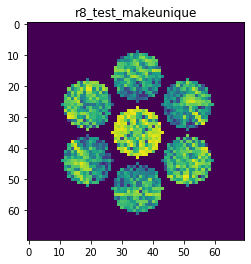

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8626414365434141
>>>replaced the 144. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 762ms/step - loss: 0.0011 - acc: 1.0000 - val_loss: 6.7660e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 732ms/step - loss: 9.8205e-04 - acc: 1.0000 - val_loss: 6.5288e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 728ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 6.3920e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 731ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 6.7168e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 730ms/step - loss: 9.9306e-04 - acc: 1.0000 - val_loss: 7.0579e-04 - val_acc: 1.0000


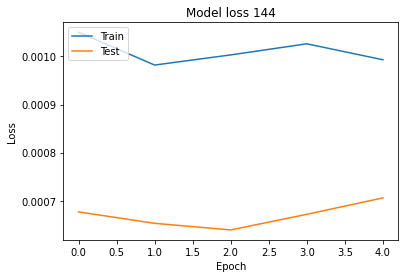

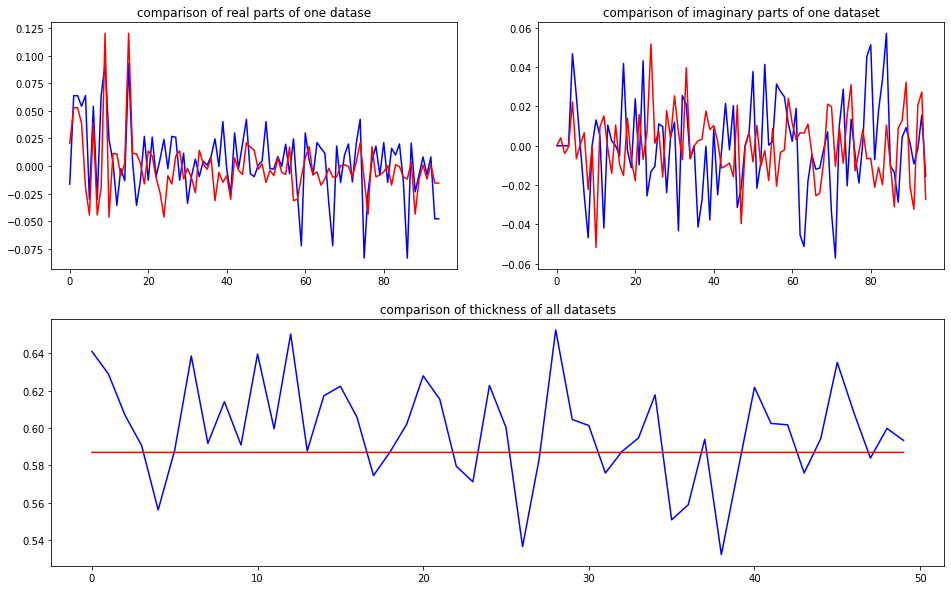

predicted thickness: 0.586998


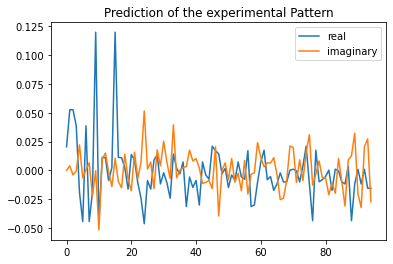

Applied shift of unit cell origin (fractional coordinates): 0.007189459563646662 0.0021160571082957935 -0.01192704143321744
Ug[ 0 ]: 0.02046 0.0  =>  0.02046 0.0
Ug[ 1 ]: 0.05282 0.07494  =>  0.05282 0.0
Ug[ 2 ]: 0.05282 -0.07494  =>  0.05282 0.0
Ug[ 3 ]: 0.03867 -0.0133  =>  0.03867 0.0
Ug[ 4 ]: 0.02934 2.28318  =>  0.02934 2.22154
Ug[ 5 ]: 0.04489 -2.99449  =>  0.04489 -2.90625
Ug[ 6 ]: 0.03867 0.0133  =>  0.03867 -0.0
Ug[ 7 ]: 0.04489 2.99449  =>  0.04489 2.90625
Ug[ 8 ]: 0.02934 -2.28318  =>  0.02934 -2.22154
Ug[ 9 ]: 0.1201 -0.04517  =>  0.1201 0.0
Ug[ 10 ]: 0.06938 -2.30154  =>  0.06938 -2.33131
Ug[ 11 ]: 0.01486 0.70087  =>  0.01486 0.82099
Ug[ 12 ]: 0.01873 0.94106  =>  0.01873 0.97294
Ug[ 13 ]: 0.00892 -2.99747  =>  0.00892 -3.04053
Ug[ 14 ]: 0.01427 -1.39842  =>  0.01427 -1.2916
Ug[ 15 ]: 0.1201 0.04517  =>  0.1201 0.0
Ug[ 16 ]: 0.01486 -0.70087  =>  0.01486 -0.82099
Ug[ 17 ]: 0.01873 -0.94106  =>  0.01873 -0.97294
Ug[ 18 ]: 0.01427 1.39842  =>  0.01427 1.2916
Ug[ 19 ]: 0.017

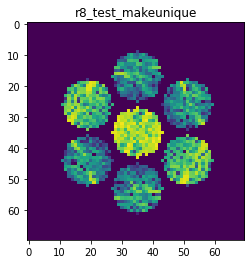

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9828615694909665
>>>replaced the 145. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 776ms/step - loss: 9.6508e-04 - acc: 1.0000 - val_loss: 6.7463e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 732ms/step - loss: 9.5712e-04 - acc: 1.0000 - val_loss: 6.3511e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 744ms/step - loss: 9.3900e-04 - acc: 1.0000 - val_loss: 6.6276e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 733ms/step - loss: 9.7582e-04 - acc: 1.0000 - val_loss: 6.8057e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 730ms/step - loss: 9.6163e-04 - acc: 1.0000 - val_loss: 6.7796e-04 - val_acc: 1.0000


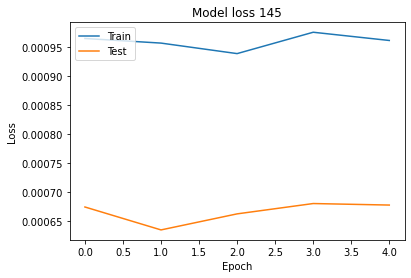

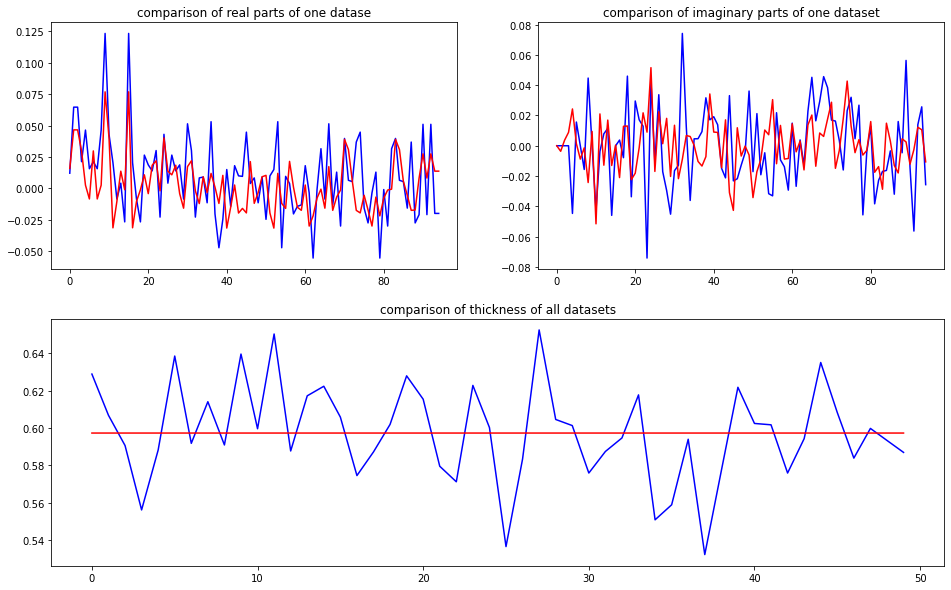

predicted thickness: 0.59735274


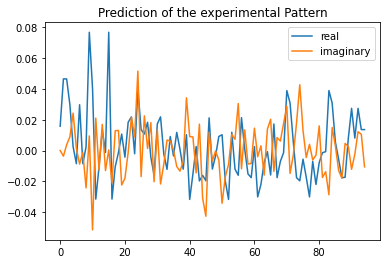

Applied shift of unit cell origin (fractional coordinates): -0.009394913686091586 -0.04590535179087993 0.012553771114929033
Ug[ 0 ]: 0.01578 0.0  =>  0.01578 0.0
Ug[ 1 ]: 0.04666 -0.07888  =>  0.04666 0.0
Ug[ 2 ]: 0.04666 0.07888  =>  0.04666 0.0
Ug[ 3 ]: 0.03103 0.28843  =>  0.03103 0.0
Ug[ 4 ]: 0.02444 1.47152  =>  0.02444 1.26197
Ug[ 5 ]: 0.00868 2.97853  =>  0.00868 2.61122
Ug[ 6 ]: 0.03103 -0.28843  =>  0.03103 -0.0
Ug[ 7 ]: 0.00868 -2.97853  =>  0.00868 -2.61122
Ug[ 8 ]: 0.02444 -1.47152  =>  0.02444 -1.26197
Ug[ 9 ]: 0.07699 0.05903  =>  0.07699 0.0
Ug[ 10 ]: 0.06538 -0.90983  =>  0.06538 -0.88998
Ug[ 11 ]: 0.03795 2.55395  =>  0.03795 2.41604
Ug[ 12 ]: 0.01667 -2.26048  =>  0.01667 -2.03108
Ug[ 13 ]: 0.02171 0.89685  =>  0.02171 1.20513
Ug[ 14 ]: 0.01311 -1.66546  =>  0.01311 -1.51494
Ug[ 15 ]: 0.07699 -0.05903  =>  0.07699 -0.0
Ug[ 16 ]: 0.03795 -2.55395  =>  0.03795 -2.41604
Ug[ 17 ]: 0.01667 2.26048  =>  0.01667 2.03108
Ug[ 18 ]: 0.01311 1.66546  =>  0.01311 1.51494
Ug[ 19 ]

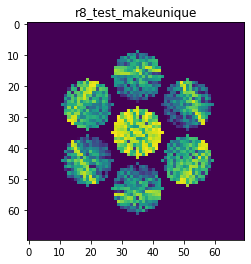

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9382741157162459
>>>replaced the 146. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 760ms/step - loss: 9.5680e-04 - acc: 1.0000 - val_loss: 5.9447e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 727ms/step - loss: 9.3710e-04 - acc: 1.0000 - val_loss: 5.8640e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 733ms/step - loss: 9.0078e-04 - acc: 1.0000 - val_loss: 6.6473e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 728ms/step - loss: 9.0307e-04 - acc: 1.0000 - val_loss: 6.1682e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 729ms/step - loss: 9.0579e-04 - acc: 1.0000 - val_loss: 6.2051e-04 - val_acc: 1.0000


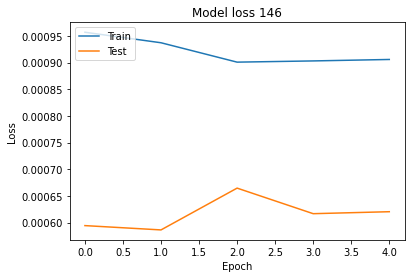

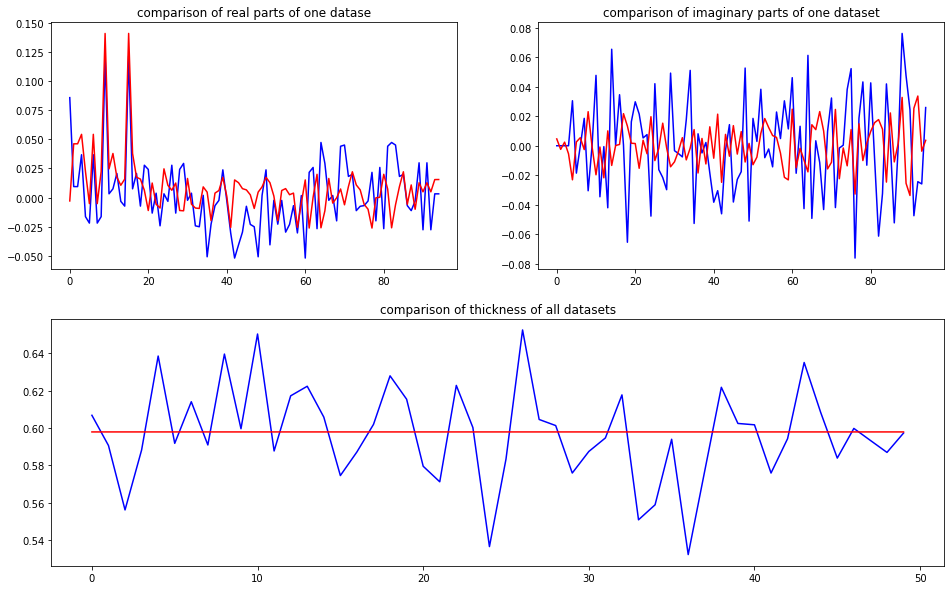

predicted thickness: 0.5979529


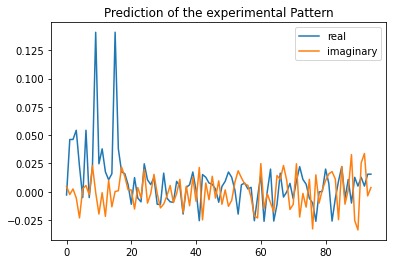

Applied shift of unit cell origin (fractional coordinates): 0.000476339050212444 0.0160022118996971 0.008421699889927367
Ug[ 0 ]: 0.00287 3.14159  =>  0.00287 3.14159
Ug[ 1 ]: 0.04622 -0.05292  =>  0.04622 0.0
Ug[ 2 ]: 0.04622 0.05292  =>  0.04622 0.0
Ug[ 3 ]: 0.05457 -0.10054  =>  0.05457 0.0
Ug[ 4 ]: 0.03214 -0.80321  =>  0.03214 -0.64975
Ug[ 5 ]: 0.00578 2.67421  =>  0.00578 2.72184
Ug[ 6 ]: 0.05457 0.10054  =>  0.05457 0.0
Ug[ 7 ]: 0.00578 -2.67421  =>  0.00578 -2.72184
Ug[ 8 ]: 0.03214 0.80321  =>  0.03214 0.64975
Ug[ 9 ]: 0.1409 -0.00299  =>  0.1409 0.0
Ug[ 10 ]: 0.03158 -0.67401  =>  0.03158 -0.61811
Ug[ 11 ]: 0.03789 -0.02303  =>  0.03789 -0.07295
Ug[ 12 ]: 0.02797 -0.89254  =>  0.02797 -0.9901
Ug[ 13 ]: 0.0146 0.76296  =>  0.0146 0.71832
Ug[ 14 ]: 0.02076 -0.6998  =>  0.02076 -0.85027
Ug[ 15 ]: 0.1409 0.00299  =>  0.1409 0.0
Ug[ 16 ]: 0.03789 0.02303  =>  0.03789 0.07295
Ug[ 17 ]: 0.02797 0.89254  =>  0.02797 0.9901
Ug[ 18 ]: 0.02076 0.6998  =>  0.02076 0.85027
Ug[ 19 ]: 0.006

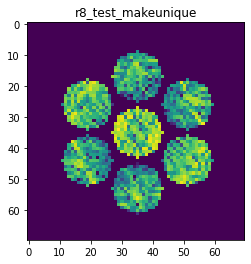

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8770095777061936
>>>replaced the 147. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 761ms/step - loss: 8.7686e-04 - acc: 1.0000 - val_loss: 5.9946e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 733ms/step - loss: 8.7544e-04 - acc: 1.0000 - val_loss: 5.8710e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 732ms/step - loss: 9.1358e-04 - acc: 1.0000 - val_loss: 6.2461e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 725ms/step - loss: 9.0558e-04 - acc: 1.0000 - val_loss: 6.2801e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 726ms/step - loss: 8.6341e-04 - acc: 1.0000 - val_loss: 5.0857e-04 - val_acc: 1.0000


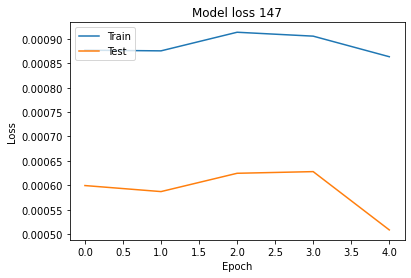

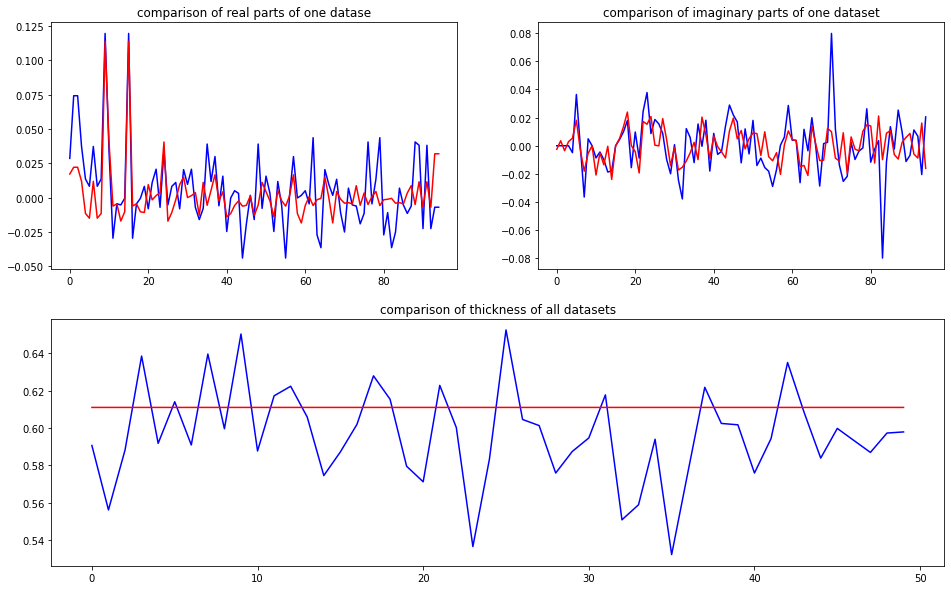

predicted thickness: 0.6110657


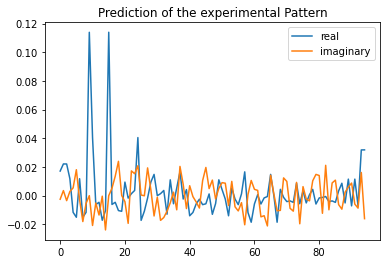

Applied shift of unit cell origin (fractional coordinates): -2.821860670161738e-06 -0.03842494362037097 -0.02504411053971027
Ug[ 0 ]: 0.01712 0.0  =>  0.01712 0.0
Ug[ 1 ]: 0.02235 0.15736  =>  0.02235 0.0
Ug[ 2 ]: 0.02235 -0.15736  =>  0.02235 -0.0
Ug[ 3 ]: 0.01215 0.24143  =>  0.01215 0.0
Ug[ 4 ]: 0.01285 2.70799  =>  0.01285 2.3092
Ug[ 5 ]: 0.02355 2.26629  =>  0.02355 2.18221
Ug[ 6 ]: 0.01215 -0.24143  =>  0.01215 0.0
Ug[ 7 ]: 0.02355 -2.26629  =>  0.02355 -2.18221
Ug[ 8 ]: 0.01285 -2.70799  =>  0.01285 -2.3092
Ug[ 9 ]: 0.11391 2e-05  =>  0.11391 -0.0
Ug[ 10 ]: 0.04552 -0.47486  =>  0.04552 -0.63223
Ug[ 11 ]: 0.00807 -2.44955  =>  0.00807 -2.29221
Ug[ 12 ]: 0.0143 -1.90225  =>  0.0143 -1.66083
Ug[ 13 ]: 0.01721 -3.11763  =>  0.01721 -3.03357
Ug[ 14 ]: 0.02608 -1.98178  =>  0.02608 -1.58301
Ug[ 15 ]: 0.11391 -2e-05  =>  0.11391 0.0
Ug[ 16 ]: 0.00807 2.44955  =>  0.00807 2.29221
Ug[ 17 ]: 0.0143 1.90225  =>  0.0143 1.66083
Ug[ 18 ]: 0.02608 1.98178  =>  0.02608 1.58301
Ug[ 19 ]: 0.010

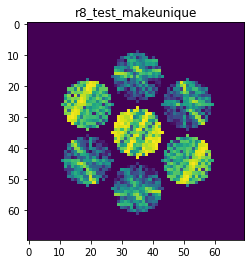

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.8992114962075655
>>>replaced the 148. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 791ms/step - loss: 8.1258e-04 - acc: 1.0000 - val_loss: 5.7085e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 732ms/step - loss: 8.3307e-04 - acc: 1.0000 - val_loss: 5.9165e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 732ms/step - loss: 8.5306e-04 - acc: 1.0000 - val_loss: 5.9460e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 724ms/step - loss: 8.6648e-04 - acc: 1.0000 - val_loss: 5.8462e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 734ms/step - loss: 8.7088e-04 - acc: 1.0000 - val_loss: 6.2726e-04 - val_acc: 1.0000


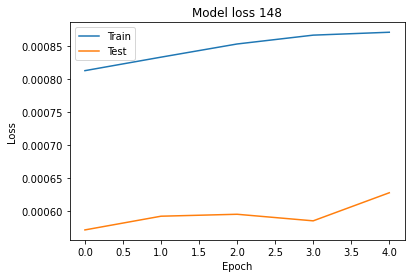

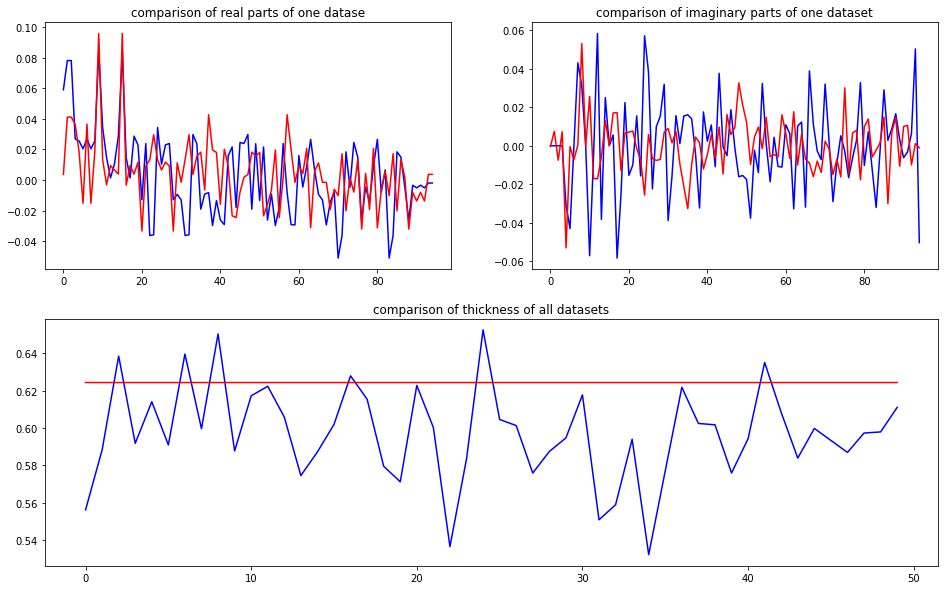

predicted thickness: 0.62438387


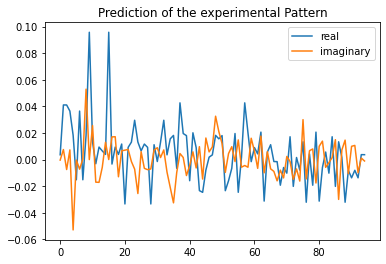

Applied shift of unit cell origin (fractional coordinates): 2.328509880912859e-05 -0.031212396357665092 -0.02879636256765582
Ug[ 0 ]: 0.00357 0.0  =>  0.00357 0.0
Ug[ 1 ]: 0.04174 0.18093  =>  0.04174 0.0
Ug[ 2 ]: 0.04174 -0.18093  =>  0.04174 -0.0
Ug[ 3 ]: 0.03717 0.19611  =>  0.03717 0.0
Ug[ 4 ]: 0.05602 -1.2383  =>  0.05602 -1.61534
Ug[ 5 ]: 0.01523 -3.11422  =>  0.01523 -3.1294
Ug[ 6 ]: 0.03717 -0.19611  =>  0.03717 0.0
Ug[ 7 ]: 0.01523 3.11422  =>  0.01523 3.1294
Ug[ 8 ]: 0.05602 1.2383  =>  0.05602 1.61534
Ug[ 9 ]: 0.09577 -0.00015  =>  0.09577 0.0
Ug[ 10 ]: 0.02875 1.09574  =>  0.02875 0.91496
Ug[ 11 ]: 0.01735 -1.7619  =>  0.01735 -1.58082
Ug[ 12 ]: 0.01955 -1.07062  =>  0.01955 -0.87436
Ug[ 13 ]: 0.00878 -0.73362  =>  0.00878 -0.71829
Ug[ 14 ]: 0.01353 1.28219  =>  0.01353 1.65938
Ug[ 15 ]: 0.09577 0.00015  =>  0.09577 -0.0
Ug[ 16 ]: 0.01735 1.7619  =>  0.01735 1.58082
Ug[ 17 ]: 0.01955 1.07062  =>  0.01955 0.87436
Ug[ 18 ]: 0.01353 -1.28219  =>  0.01353 -1.65938
Ug[ 19 ]: 0.0

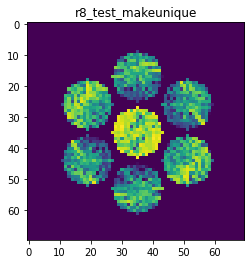

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9297060888275593
>>>replaced the 149. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 759ms/step - loss: 8.1737e-04 - acc: 1.0000 - val_loss: 5.4079e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 732ms/step - loss: 7.8356e-04 - acc: 1.0000 - val_loss: 5.7553e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 745ms/step - loss: 8.1605e-04 - acc: 1.0000 - val_loss: 6.0326e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 737ms/step - loss: 8.1674e-04 - acc: 1.0000 - val_loss: 6.1313e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 735ms/step - loss: 8.2064e-04 - acc: 1.0000 - val_loss: 6.1946e-04 - val_acc: 1.0000


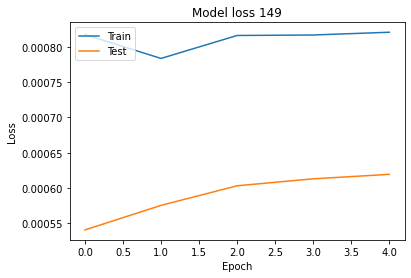

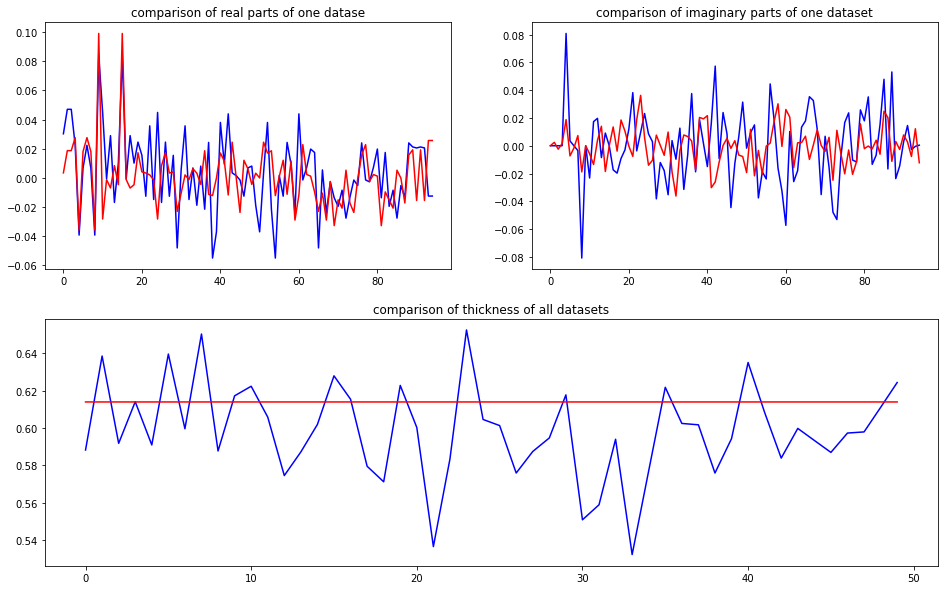

predicted thickness: 0.613994


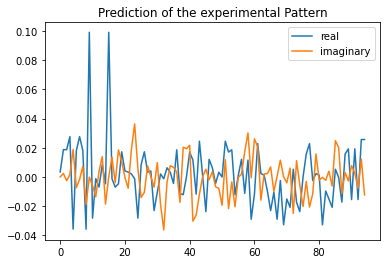

Applied shift of unit cell origin (fractional coordinates): 9.75943621617328e-07 -0.009347923111355757 -0.02102380734595093
Ug[ 0 ]: 0.00347 0.0  =>  0.00347 0.0
Ug[ 1 ]: 0.01888 0.1321  =>  0.01888 0.0
Ug[ 2 ]: 0.01888 -0.1321  =>  0.01888 0.0
Ug[ 3 ]: 0.02766 0.05873  =>  0.02766 -0.0
Ug[ 4 ]: 0.04036 2.65582  =>  0.04036 2.46499
Ug[ 5 ]: 0.01954 -0.38422  =>  0.01954 -0.31086
Ug[ 6 ]: 0.02766 -0.05873  =>  0.02766 0.0
Ug[ 7 ]: 0.01954 0.38422  =>  0.01954 0.31086
Ug[ 8 ]: 0.04036 -2.65582  =>  0.04036 -2.46499
Ug[ 9 ]: 0.09907 -1e-05  =>  0.09907 0.0
Ug[ 10 ]: 0.02877 -2.93732  =>  0.02877 -3.06941
Ug[ 11 ]: 0.01358 -1.65473  =>  0.01358 -1.52262
Ug[ 12 ]: 0.00793 2.631  =>  0.00793 2.68974
Ug[ 13 ]: 0.01635 1.02999  =>  0.01635 0.95664
Ug[ 14 ]: 0.01913 -1.81625  =>  0.01913 -1.62541
Ug[ 15 ]: 0.09907 1e-05  =>  0.09907 0.0
Ug[ 16 ]: 0.01358 1.65473  =>  0.01358 1.52262
Ug[ 17 ]: 0.00793 -2.631  =>  0.00793 -2.68974
Ug[ 18 ]: 0.01913 1.81625  =>  0.01913 1.62541
Ug[ 19 ]: 0.02022 0

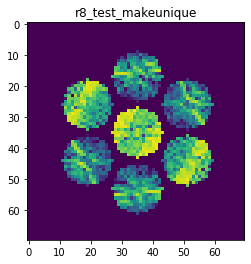

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9580250381329668
>>>replaced the 150. dataset and train: 
Epoch 1/5
8/8 [==============================] - 7s 759ms/step - loss: 7.6860e-04 - acc: 1.0000 - val_loss: 5.9325e-04 - val_acc: 1.0000
Epoch 2/5
8/8 [==============================] - 6s 731ms/step - loss: 7.6486e-04 - acc: 1.0000 - val_loss: 5.5790e-04 - val_acc: 1.0000
Epoch 3/5
8/8 [==============================] - 6s 728ms/step - loss: 7.6816e-04 - acc: 1.0000 - val_loss: 5.4827e-04 - val_acc: 1.0000
Epoch 4/5
8/8 [==============================] - 6s 731ms/step - loss: 7.6845e-04 - acc: 1.0000 - val_loss: 5.7717e-04 - val_acc: 1.0000
Epoch 5/5
8/8 [==============================] - 6s 733ms/step - loss: 7.6695e-04 - acc: 1.0000 - val_loss: 5.4447e-04 - val_acc: 1.0000


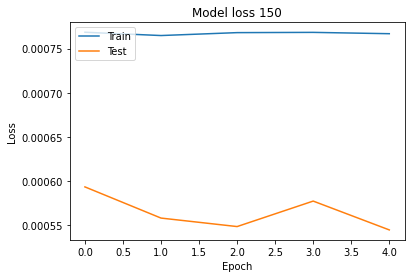

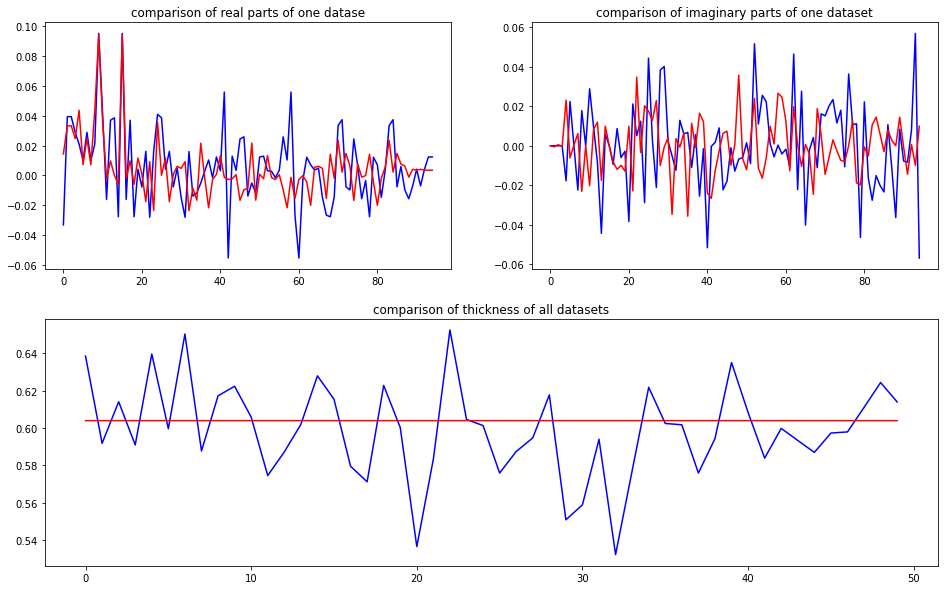

predicted thickness: 0.60398644


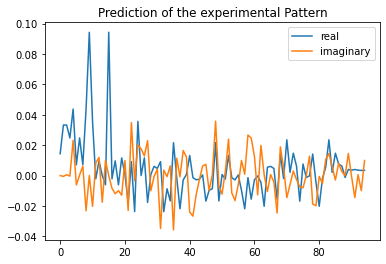

Applied shift of unit cell origin (fractional coordinates): -1.0023435535591173e-05 0.002227957795270678 0.002587144252784605
Ug[ 0 ]: 0.01436 0.0  =>  0.01436 0.0
Ug[ 1 ]: 0.03323 -0.01626  =>  0.03323 0.0
Ug[ 2 ]: 0.03323 0.01626  =>  0.03323 0.0
Ug[ 3 ]: 0.02476 -0.014  =>  0.02476 0.0
Ug[ 4 ]: 0.04948 0.48676  =>  0.04948 0.51701
Ug[ 5 ]: 0.0094 -0.71579  =>  0.0094 -0.71805
Ug[ 6 ]: 0.02476 0.014  =>  0.02476 0.0
Ug[ 7 ]: 0.0094 0.71579  =>  0.0094 0.71805
Ug[ 8 ]: 0.04948 -0.48676  =>  0.04948 -0.51701
Ug[ 9 ]: 0.09423 6e-05  =>  0.09423 0.0
Ug[ 10 ]: 0.04096 -0.51719  =>  0.04096 -0.50099
Ug[ 11 ]: 0.00861 1.82284  =>  0.00861 1.80652
Ug[ 12 ]: 0.01537 0.89164  =>  0.01537 0.87757
Ug[ 13 ]: 0.01755 -1.57014  =>  0.01755 -1.56794
Ug[ 14 ]: 0.01164 2.11934  =>  0.01164 2.08903
Ug[ 15 ]: 0.09423 -6e-05  =>  0.09423 0.0
Ug[ 16 ]: 0.00861 -1.82284  =>  0.00861 -1.80652
Ug[ 17 ]: 0.01537 -0.89164  =>  0.01537 -0.87757
Ug[ 18 ]: 0.01164 -2.11934  =>  0.01164 -2.08903
Ug[ 19 ]: 0.01738 

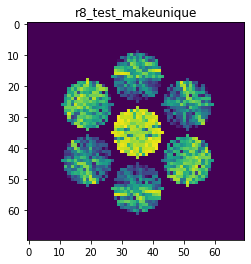

Number of Tilts:  197
Number of Beams:  95
shape of sim_Intensity:  (197, 95)
X_sim.max(): 0.9634944348812028
Time:  6266.603896967999


In [13]:
Ug_t_exp_pred_matrix = [] #matrix to save the predicted {Ug,t} of the experimental pattern
Ug_exp_pred_matrix = [] #matrix to save the predicted Ug of the experimental pattern
t_exp_pred_matrix = [] #matrix to save the predicted t of the experimental pattern
simulation_pattern = [] #matrix to save the simulation pattern produced by predicted {Ug,t}
sim_Intensity_matrix = []
scale = 0.1 # scale of random offset 

DoDiverse = False
MakeUniqueUg = True

start = timeit.default_timer()
for i in range(0,trainsize+1):
    
    if i == 0:
        print('>>>train the initial training set:')
        Epochs = 20
    else:
        print('>>>replaced the {0:d}. dataset and train: '.format(i))
        Epochs = 5
    
    # load and compile the model
    model = load_model(name+"_ANN.h5")
    

    # train the model
    model.fit(X_train, y_train, validation_data=(X_test, y_test), batch_size=20, epochs=Epochs)
    #model.fit(X, y, batch_size=40, epochs=20, validation_split=0.2)
    
    # save the trained weigths of the model, delete the existing model
    model.save(name+"_ANN.h5")


    # plot the model loss
    plt.plot(model.history.history['loss'])
    plt.plot(model.history.history['val_loss'])
    plt.title('Model loss {0:d}'.format(i))
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Test'], loc='upper left')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Model_Loss' + '/' + 'Model_Loss{0:d}.png'.format(i))
    plt.show()
    plt.close()
    

    # Prediction of the testing set
    y_test_pred = model.predict(X_test)    
    Ug_test_pred_complex = y_test_pred[:,:2*numUg].reshape(-1,numUg,2)
    Ug_test_complex = y_test[:,:2*numUg].reshape(-1,numUg,2)    
    t_test_pred = y_test_pred[:,2*numUg]
    t_test = y_test[:,2*numUg]
    
    # plot the comparison of imaginary parts, real parts and thickness
    gs = gridspec.GridSpec(2, 2)
    fig = plt.figure(figsize=(16,10))
    
    ax1 = fig.add_subplot(gs[0, 0]) 
    ax1.plot(Ug_test_complex[2,:,0],'b')
    ax1.plot(Ug_test_pred_complex[2,:,0],'r')
    ax1.set_title('comparison of real parts of one datase')
    
    ax2 = fig.add_subplot(gs[0, 1]) 
    ax2.plot(Ug_test_complex[2,:,1],'b')
    ax2.plot(Ug_test_pred_complex[2,:,1],'r')
    ax2.set_title('comparison of imaginary parts of one dataset')
    
    ax3 = fig.add_subplot(gs[1, :])
    ax3.plot(t_test[:],'b')
    ax3.plot(t_test_pred[:],'r')
    ax3.set_title('comparison of thickness of all datasets')
    #plt.savefig(trainingFolder  + 'My_Model_ZnO' + '/' + 'My_Comparison' + '/' + 'My_Comparison{0:d}.png'.format(i))
    plt.show()
    plt.close()
    
    
    # Prediction of the experimental Pattern
    y_exp_pred = model.predict(X_exp)
    Ug_t_exp_pred = y_exp_pred[0,:]
    Ug_exp_pred = Ug_t_exp_pred[0:-1]
    t_exp_pred = Ug_t_exp_pred[-1]
    
    Ug_t_exp_pred_matrix.append(Ug_t_exp_pred)
    Ug_exp_pred_matrix.append(Ug_exp_pred)
    t_exp_pred_matrix.append(t_exp_pred)
    
    if t_exp_pred < 0:
        t_exp_pred = np.random.randint(200,1001)/1000
        print("negative thickness, use random thickness: ", t_exp_pred)
        t_exp_pred = np.random.randint(200,1001)/1000
        Ug_t_exp_pred[-1] = t_exp_pred
    else:
        print("predicted thickness:", t_exp_pred)
 
    
    # plot the results
    plt.plot(Ug_t_exp_pred[0:-1:2],label='real')
    plt.plot(Ug_t_exp_pred[1:-1:2],label='imaginary')
    plt.legend()
    plt.title('Prediction of the experimental Pattern')
    plt.show()
    plt.close()
    
    # diverse the predicted Ug and thickness
    if DoDiverse == True:
        # scale will be reduced by iterations
        scale *= 0.99
        offset_Ug = (np.random.random()*2-1)*scale
        for j in range(len(Ug_t_exp_pred)-1):
            # for real part of Ug
            if j%2 == 0:
                # the offset if propotional to the magnitude of the Ug
                Ug_t_exp_pred[j] += offset_Ug*(Ug_t_exp_pred[j]**2 + Ug_t_exp_pred[j+1]**2)
            # for imag part of Ug
            else:
                Ug_t_exp_pred[j] += offset_Ug*(Ug_t_exp_pred[j-1]**2 + Ug_t_exp_pred[j]**2)
    
    # normalization
    Ug_pred = np.array(range( np.int((Ug_t_exp_pred.size - 1)/2) ), dtype=complex)
    Ug_pred.real = Ug_t_exp_pred[0:-1:2]
    Ug_pred.imag = Ug_t_exp_pred[1:-1:2]
    Ug_pred_normalized = nf.normalization(file=File, origin_Ug=Ug_pred)
    Ug_pred_normalized = np.asarray(Ug_pred_normalized)
    
    # Make unique Ug (for new training set)
    # if i < trainsize:
    if MakeUniqueUg == True:
            UgUnique, r0 = mu_3D.makeUniqueUgVector(Ug_pred_normalized,1,6,9,file = File)
            Ug_pred_normalized = UgUnique

    # reshape
    Ug_pred_normalized_2real = np.concatenate((np.array(Ug_pred_normalized.real,ndmin=2).T, np.array(Ug_pred_normalized.imag,ndmin=2).T),axis=1)  
    Ug_pred_normalized_2real = np.asarray(Ug_pred_normalized_2real)
    Ug_t_pred_normalized_2real = np.append(Ug_pred_normalized_2real.reshape(-1), Ug_t_exp_pred[-1])
    
    
    # Compute the LARBED pattern: X_sim, from the predicted {Ug,t}: Y_exp_pred
    file = File+".qed"
    X_sim = pf.pyQEDA(filename=file, UseInputUgMasterList=True, InputUg=Ug_t_pred_normalized_2real, InputUgdoFlip=False)
    X_sim = X_sim.reshape(-1)
    #nlogf_X_sim = nlogf(X_sim)
    
    #load the intensities of simulation pattern from txt.files
    sim_Intensity = lif.LoadIntensity(file = File, test_simulation=True)
    sim_Intensity = sim_Intensity.reshape(-1)
    
    simulation_pattern.append(X_sim)
    sim_Intensity_matrix.append(sim_Intensity)
    print("X_sim.max():",X_sim.max())
    #print("nlogf_X_sim.max():",nlogf_X_sim.max())
        
    
    # replace the training set & testing set with new training set
    if LoadIntensityAsInput == True:
        X_train_new = sim_Intensity
    else:
        X_train_new = X_sim
        
    if i < trainsize:
        X_train[i] = X_train_new               
        y_train[i] = Ug_t_pred_normalized_2real

        if i < testsize: 
            X_test = X_train[:testsize]
            y_test = y_train[:testsize]
        else:
            X_test = X_train[i+1-testsize:i+1]
            y_test = y_train[i+1-testsize:i+1]

stop = timeit.default_timer()
print('Time: ', stop - start)

# IV. Compare

1. diffraction pattern:

Text(0.5, 1.0, 'experimental Pattern')

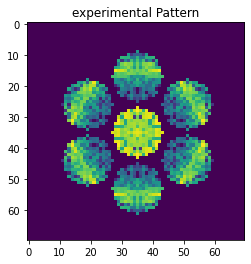

In [14]:
# plot the experimental Pattern:
plt.imshow(nlogf_exp_I[0])
plt.title('experimental Pattern')

Text(0.5, 1.0, 'simulation pattern')

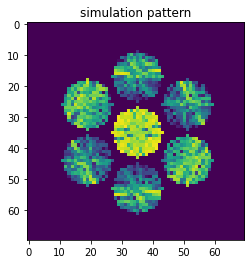

In [15]:
# plot the final simulated Pattern:
simulation_pattern = np.asarray(simulation_pattern)
plt.imshow(nlogf(simulation_pattern[-1].reshape(Nx,Nx,1)))
plt.title("simulation pattern")

2. thickness:

Text(0.5, 0, 'iteration')

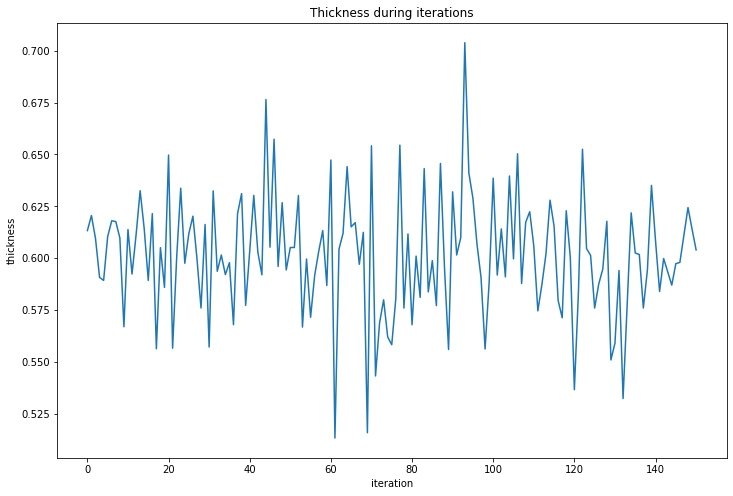

In [16]:
# plot the prediction of thickness during iterations:
plt.figure(figsize=(12,8))
plt.plot(t_exp_pred_matrix)
plt.title("Thickness during iterations")
plt.ylabel("thickness")
plt.xlabel("iteration")

3. R-factors:

In [17]:
exp_I.shape

(4900,)

In [18]:
exp_Intensity.shape

(197, 95)

Text(0.5, 0, 'Iteration')

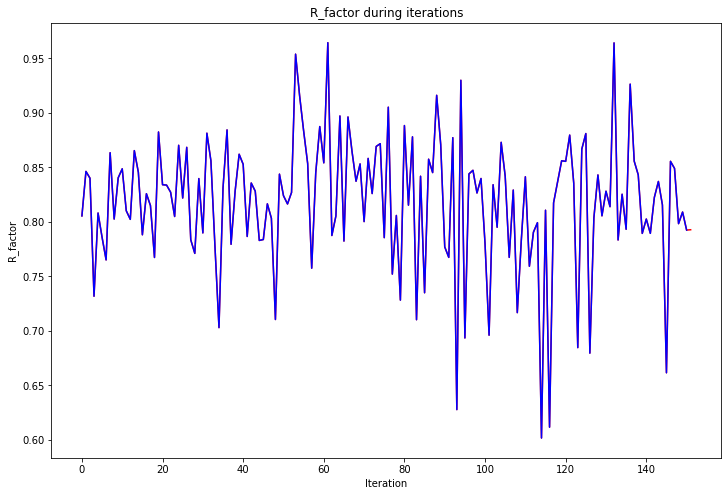

In [19]:
# plot the R-factors during iterations
sim_Intensities = []
R_factors = []
R_factors_integrated = []
    
for i in range(len(simulation_pattern)):
    sim_I_int = simulation_pattern[i].reshape(-1)
    sim_I = sim_Intensity_matrix[i].reshape(-1)
    
    R_integrated = np.sum(np.abs(sim_I_int - exp_I))/np.sum(exp_I)
    R_factors_integrated = np.append(R_factors_integrated, R_integrated)
    
    R = np.sum(np.abs(sim_I - exp_Intensity.reshape(-1)))/np.sum(exp_Intensity.reshape(-1))
    R_factors = np.append(R_factors_integrated, R)

plt.figure(figsize=(12,8))
plt.plot(R_factors[:], "r", label="R_factor")
plt.plot(R_factors_integrated[:], "b", label="R_factor_integrated")
plt.title('R_factor during iterations')
plt.ylabel('R_factor')
plt.xlabel('Iteration')

R_min: 0.6016983442868832


Text(0.5, 1.0, 'simulation pattern')

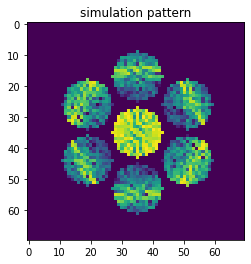

In [20]:
R_argmin = R_factors.argmin()
R_min = R_factors.min()
print("R_min:", R_min)
plt.imshow(nlogf(simulation_pattern[R_argmin].reshape(Nx,Nx,1)))
plt.title("simulation pattern")

In [21]:
t_exp_pred_matrix[R_argmin]

0.6279594